In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [2]:
from termcolor import colored
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt
from natsort import natsorted

import seaborn as sns

In [3]:
# Display pandas df without truncation
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

In [4]:
# Globally setting font sizes via rcParams should be done with 

params = {
    'font.size': 11,
    'figure.figsize': (10,3),
    'figure.dpi': 80,
    'savefig.dpi': 300,
    'legend.fontsize': 11,
    'xtick.labelsize': 11,
    'ytick.labelsize': 11,
    'axes.labelsize': 11,
    'axes.axisbelow': True
         }
plt.rcParams.update(params)


# The defaults can be restored using
# plt.rcParams.update(plt.rcParamsDefault)

In [5]:
main_folder = os.getcwd() #attenzione pycharm scprits not in the same dir

baseline_folder = 'results/ALL/pos_pkl/Simulated/baseline'
simpleExperiment_folder = 'results/ALL/pos_pkl/Simulated/simple_experiment_100_runs'
biasExperiment_folder = 'results/ALL/pos_pkl/Simulated/bias_experiment_100_runs'
randomAngle_folder = 'results/ALL/pos_pkl/Simulated/random_angle_100_runs'
bouncingAngle_folder = 'results/ALL/pos_pkl/Simulated/bouncing_angle_100_runs'

windows = np.array([1, 2, 3, 4, 5, 6, 9, 10, 12, 15, 18, 20, 30, 45, 60])


In [15]:
Ncolors = 5
colormap = plt.cm.viridis  # LinearSegmentedColormap
Ncolors = min(colormap.N, Ncolors)
mapcolors = [colormap(int(x * colormap.N / (Ncolors-1))) for x in range(Ncolors)]

In [7]:
def load_pd_positions(dirPath, experiment_type):
    if experiment_type != "experiment" and experiment_type != "baseline":
        print("experiment_type could be only $experiment or $baseline")
        exit(-1)

    num_experiment = len([name for name in os.listdir(dirPath) if
                          (os.path.isfile(os.path.join(dirPath, name)) and (name.endswith('position.tsv')))])

    if os.path.exists(dirPath + "/" + experiment_type + ".pkl"):
        # print("Loading pickle positions file in " + dirPath + "/" + experiment_type + ".pkl")
        return num_experiment, pd.read_pickle(dirPath + "/" + experiment_type + ".pkl")
    # else:
    #     print("Baseline:"+dirPath+" not an existing path")
    #     exit(-1)

    print("Generating pickle positions file in " + dirPath + "/" + experiment_type + ".pkl")
    df = pd.DataFrame()
    for filename in os.listdir(dirPath):
        if filename.endswith('position.tsv'):
            if not os.path.getsize(os.path.join(dirPath, filename)) > 0:
                print("Error, empty file at:" + os.path.join(dirPath, filename))
                continue
            df_single = pd.read_csv(dirPath + "/" + filename, sep="\t")
            df = df.append(df_single)

    df.to_pickle(dirPath + "/" + experiment_type + ".pkl")
    return num_experiment, df


In [8]:
def get_connections(positions):
    connection_number_history = np.zeros((positions.shape[0], positions.shape[1]))
#     print('\t connection_number_history.shape', connection_number_history.shape)
#     print('\t positions.transpose(1, 0, 2).shape', positions.transpose(1, 0, 2).shape)
    for index, pos_t in enumerate(positions.transpose(1, 0, 2)):
        connection_number = np.zeros(positions.shape[0])
#         print('\t connection_number.shape',connection_number.shape)
#         print('\t pos_t.shape',pos_t.shape)
        for idx, elem in enumerate(pos_t):
#             print('\t elem.shape',elem.shape)
            robot_distance = np.sqrt(np.sum((pos_t - elem) ** 2, axis=1))
#             print('\t robot_distance.shape',robot_distance.shape)
            connection_number[idx] = robot_distance[np.where(robot_distance <= 0.1)].size - 1
        connection_number_history[:, index] = connection_number
    return connection_number_history

###  Different pop sizes

In [9]:
alpha_array = [1.2, 1.4, 1.6, 1.8, 2.0]
rho_array = [0.0, 0.3, 0.6, 0.9]

In [29]:
# Average connection plots among different population sizes
def avg_connection_plot_different_population_sizes(folder_experiment, avg_connection_degree_dir):
    for a in alpha_array:
        for r in rho_array:
            #         print("a",a,"r",r)
            robot_arr = []
            fig = plt.figure()

            #         for dirName, subdirList, fileList in os.walk(folder_experiment):
            for dirName in natsorted(os.listdir(folder_experiment)):
#                 print(colored("DirName:", 'blue'), dirName)
                dirPath = os.path.join(folder_experiment, dirName)

                num_robots = "-1"
                elements = dirName.split("_")
                for e in elements:
                    if e.startswith("robots"):
                        num_robots = e.split("#")[-1]
                    if e.startswith("rho"):
                        rho = float(e.split("#")[-1])
                    if e.startswith("alpha"):
                        alpha = float(e.split("#")[-1])

                #         print(num_robots+' '+str(rho)+' '+str(alpha))
                #             print(alpha, rho)
                if num_robots == "-1" or rho != r or alpha != a:
                    continue
                else:
                    print(colored("DirName:", 'blue'), dirName)

                    robot_arr += [int(num_robots)]
                    #                 print(num_robots, int(num_robots))
                    runs = len([f for f in os.listdir(dirPath) if
                                (os.path.isfile(os.path.join(dirPath, f)) and f.endswith('position.tsv'))])
                #         print(runs)

                rho_str = str(rho)
                alpha_str = str(alpha)

                [_, df_experiment] = load_pd_positions(dirPath, "experiment")

                positions_concatenated = df_experiment.values[:, 1:]
                [num_robot, num_times] = positions_concatenated.shape
                positions_concatenated = np.array([x.split(',') for x in positions_concatenated.ravel()], dtype=float)
                positions_concatenated = positions_concatenated.reshape(num_robot, num_times, 2)

                print("\truns", runs)
                print("\tpositions_concatenated.shape:", positions_concatenated.shape)
                position_concatenated_split = np.split(positions_concatenated, runs)

                connection_number_history = np.array([])
                for single_run in position_concatenated_split:
#                     print('single_run.shape:', single_run.shape)
                    connection_number_history = np.vstack((connection_number_history, get_connections(
                        single_run))) if connection_number_history.size else get_connections(single_run)
#                     print('connection_number_history.shape:', connection_number_history.shape)
                    if (connection_number_history.shape[0]==30):
                        print("Something happened")
                        break

#                 print(' final connection_number_history.shape: ', connection_number_history.shape)
                connection_number_history_mean = np.mean(connection_number_history, axis=0)
                #             print(num_times)
                #             print(connection_number_history_mean.shape)
                #             print(len(robot_arr))
                plt.plot(np.arange(num_times), connection_number_history_mean, linewidth=2, label=num_robots,
                         color=mapcolors[len(robot_arr)])
                

            plt.title("Average connection with " + r" $\bf{\rho}:$" + rho_str + " and " + r"$\bf{\alpha}:$" + alpha_str)
            plt.ylabel('mean connection link')
            plt.xlabel('time')
            #     plt.legend(loc='lower right')
            if not open_space_flag:
                plt.yticks(np.arange(0, 9, 0.5))
            else:
                plt.yticks(np.arange(0, 20, 1))
            #     plt.grid(which='minor')
            plt.grid()
            plt.legend(loc=2)  # , bbox_to_anchor=(0.95, 0.5))
            file_name = "average_connection_plot_rho_%s_alpha_%s.png" % (rho_str, alpha_str)
            plt.savefig(avg_connection_degree_dir + '/' + file_name)
#             plt.close(fig)
            print(f"Saving fig: {file_name}")
            plt.show()
    
    

DirName: 2020-07-01_robots#10_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.2.png


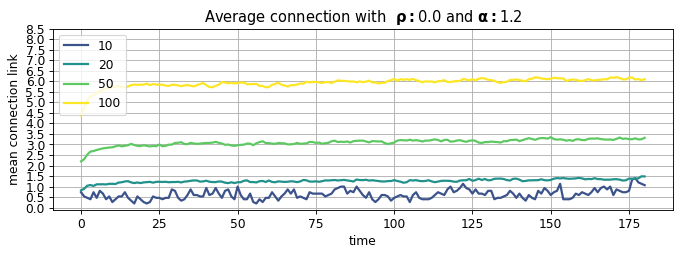

DirName: 2020-07-01_robots#10_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.2.png


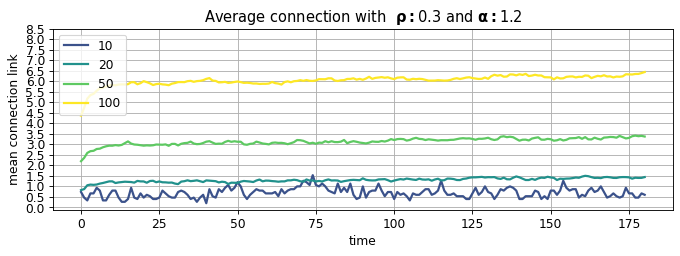

DirName: 2020-07-01_robots#10_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.2.png


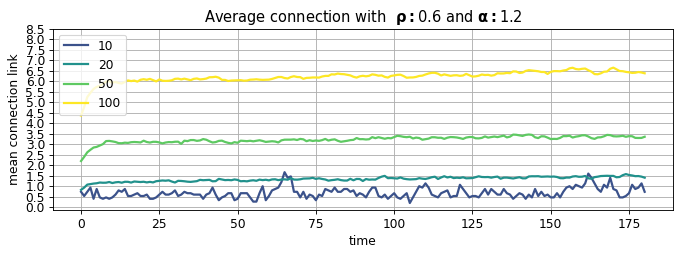

DirName: 2020-07-01_robots#10_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.2.png


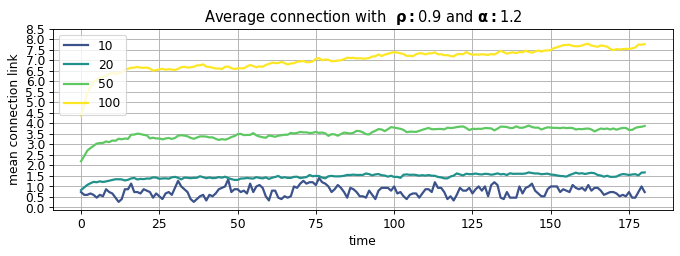

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.0_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.0_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.0_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.4.png


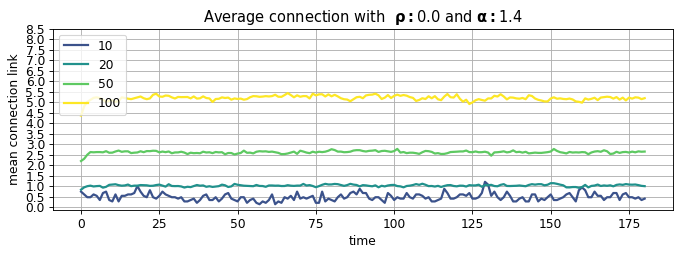

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.3_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.3_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.3_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.4.png


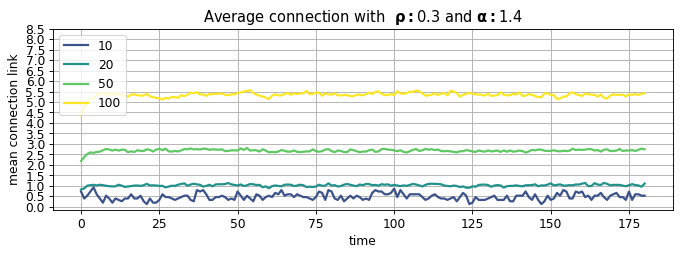

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.6_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.6_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.6_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.4.png


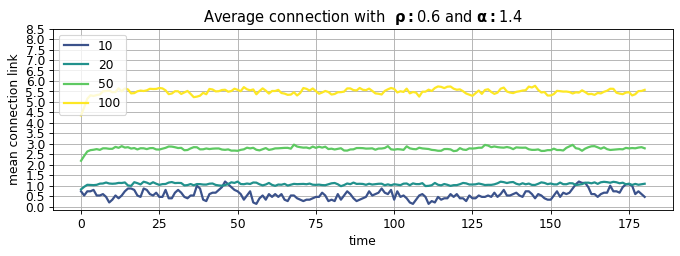

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.9_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.9_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.9_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.4.png


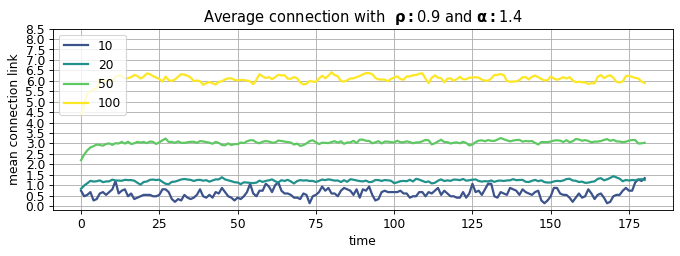

DirName: 2020-07-01_robots#10_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.6.png


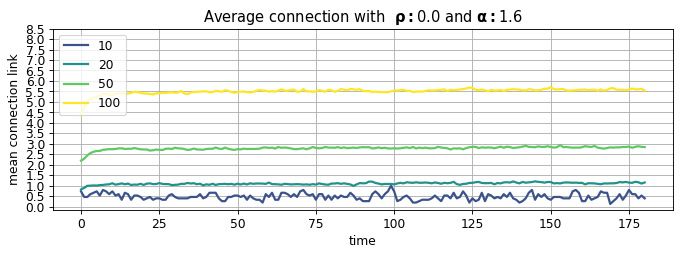

DirName: 2020-07-01_robots#10_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.6.png


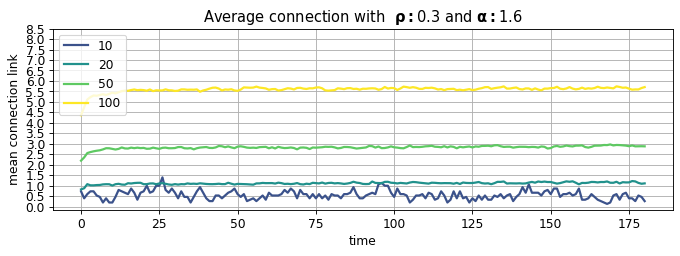

DirName: 2020-07-01_robots#10_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.6.png


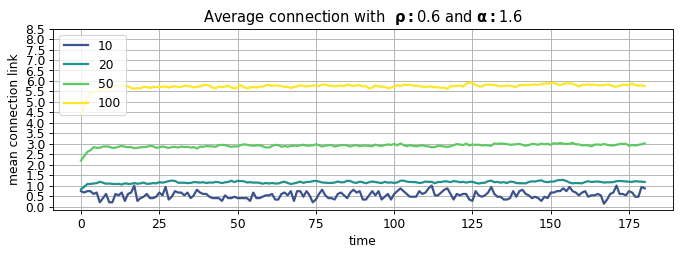

DirName: 2020-07-01_robots#10_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.6.png


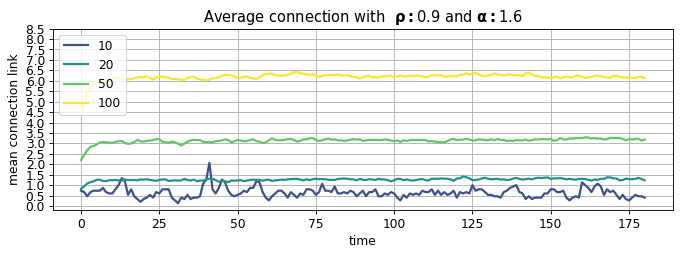

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.0_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.0_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.0_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.8.png


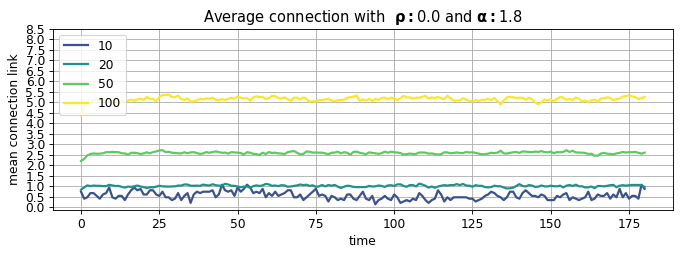

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.3_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.3_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.3_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.8.png


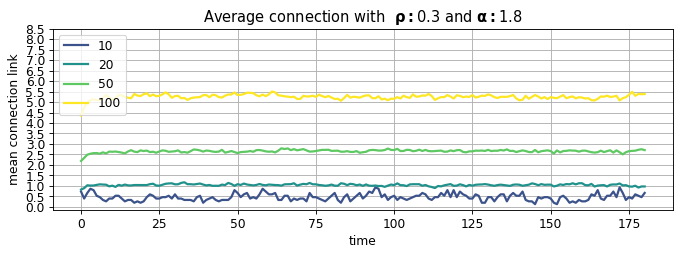

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.6_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.6_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.6_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.8.png


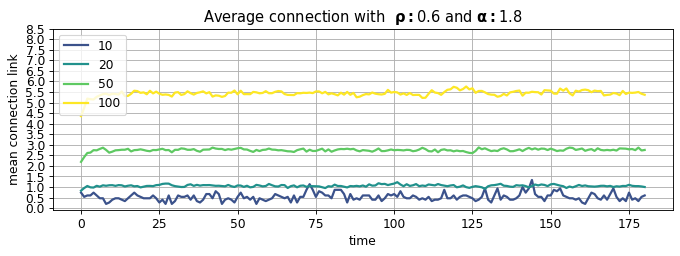

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.9_1800
	runs 50
	positions_concatenated.shape: (500, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.9_1800
	runs 50
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.9_1800
	runs 50
	positions_concatenated.shape: (2500, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
	runs 20
	positions_concatenated.shape: (2000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.8.png


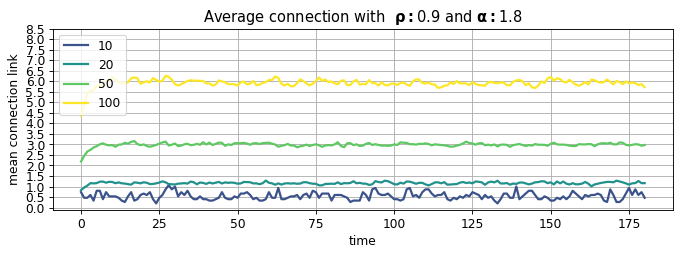

DirName: 2020-07-01_robots#10_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_2.0.png


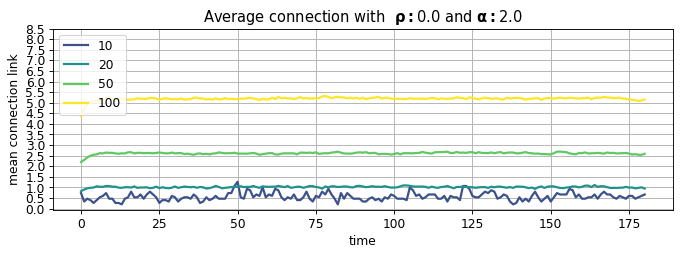

DirName: 2020-07-01_robots#10_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_2.0.png


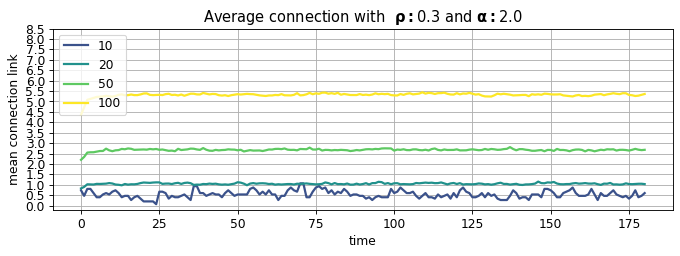

DirName: 2020-07-01_robots#10_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_2.0.png


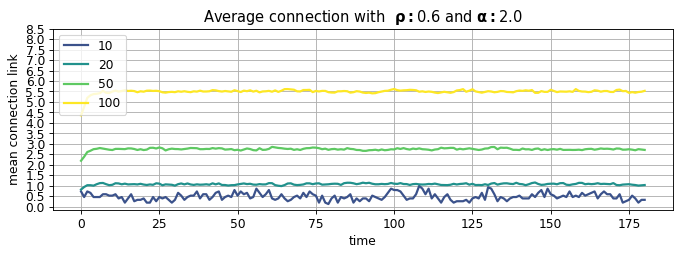

DirName: 2020-07-01_robots#10_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-01_robots#20_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-01_robots#50_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-01_robots#100_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_2.0.png


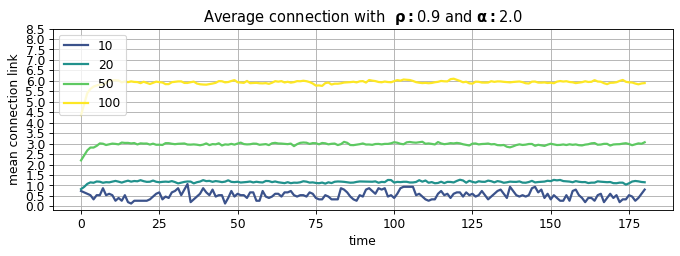

In [19]:
open_space_flag = False
bouncingAngle_folder = './results/ALL/Simulated/bouncing_angle_100_runs'
avg_connection_plot_different_population_sizes(bouncingAngle_folder, './')

DirName: 2020-07-03_robots#10_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.2.png


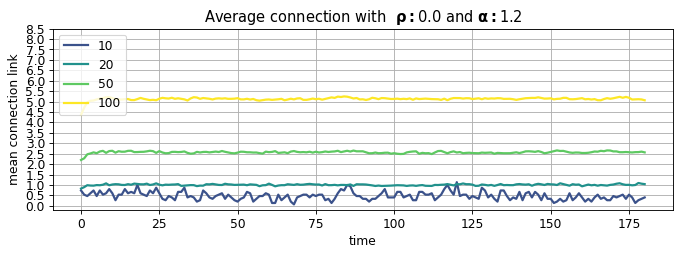

DirName: 2020-07-03_robots#10_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.2.png


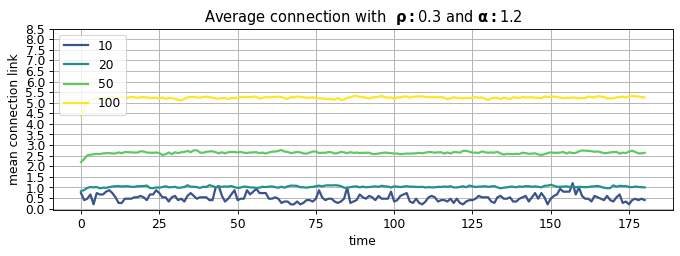

DirName: 2020-07-03_robots#10_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.2.png


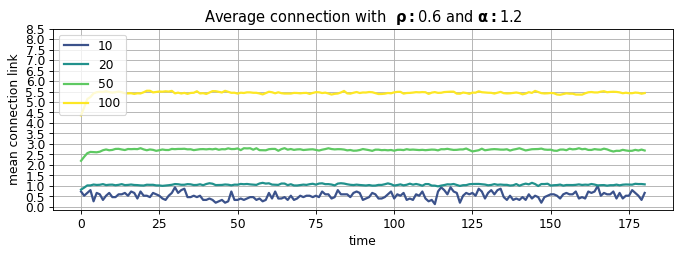

DirName: 2020-07-03_robots#10_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.2.png


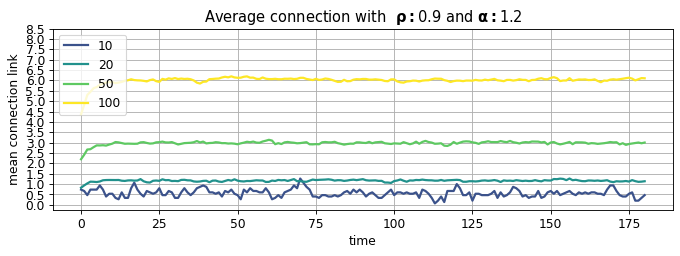

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

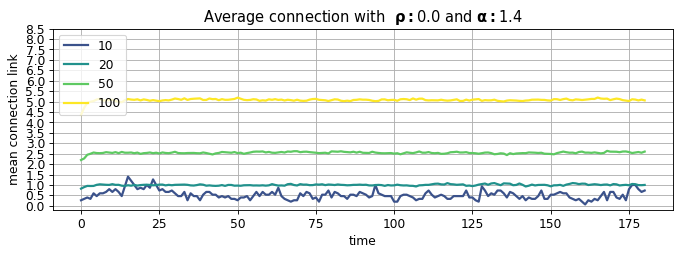

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

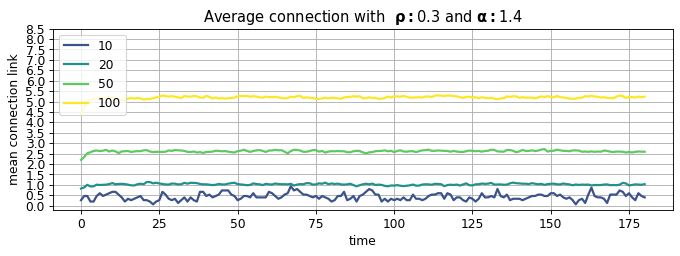

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

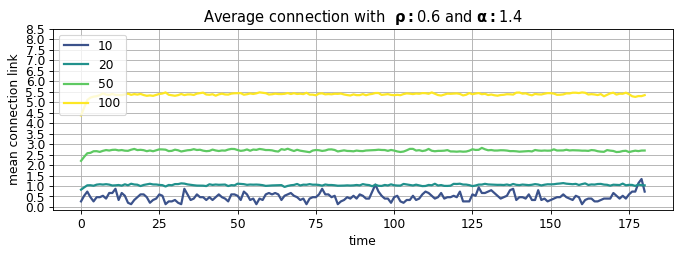

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

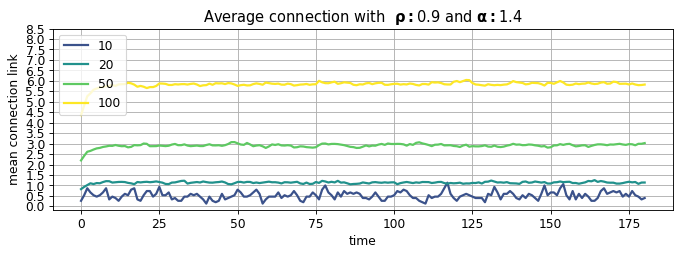

DirName: 2020-07-03_robots#10_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.6.png


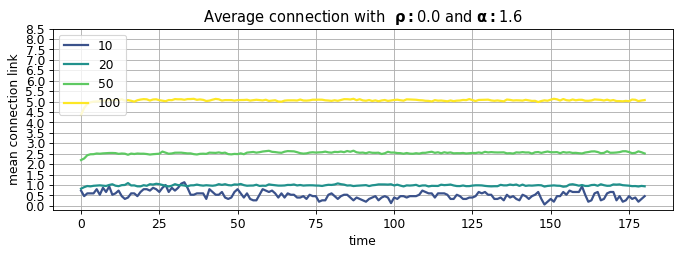

DirName: 2020-07-03_robots#10_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.6.png


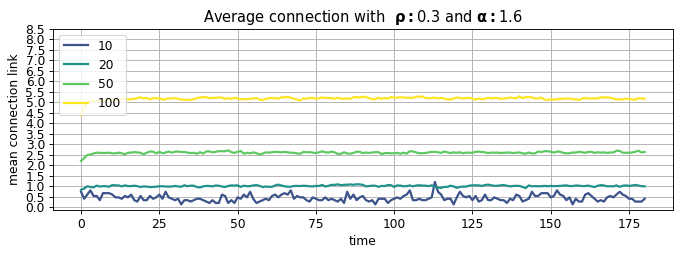

DirName: 2020-07-03_robots#10_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.6.png


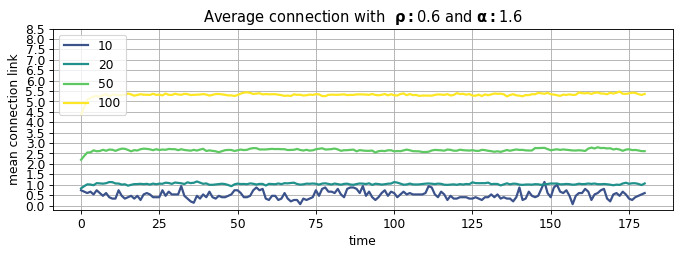

DirName: 2020-07-03_robots#10_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.6.png


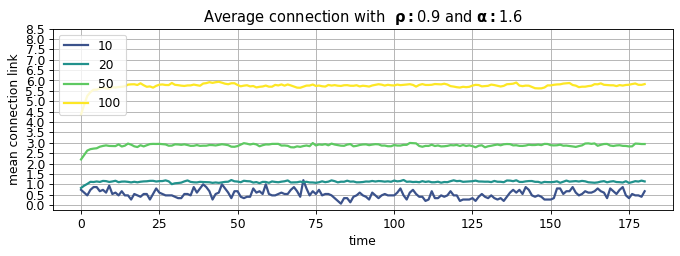

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

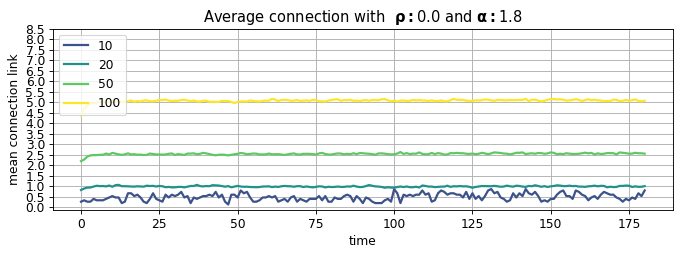

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

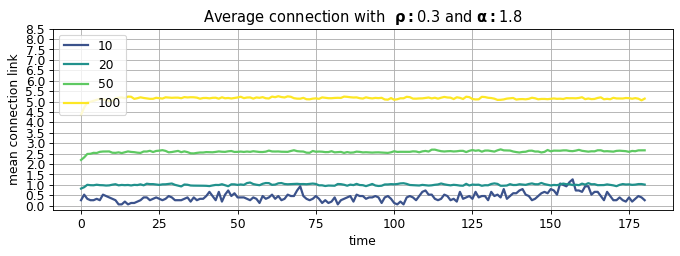

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

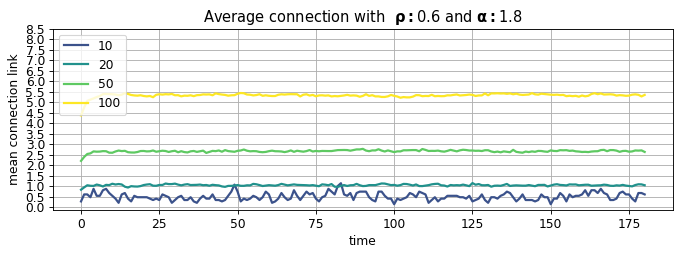

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (10000, 181, 

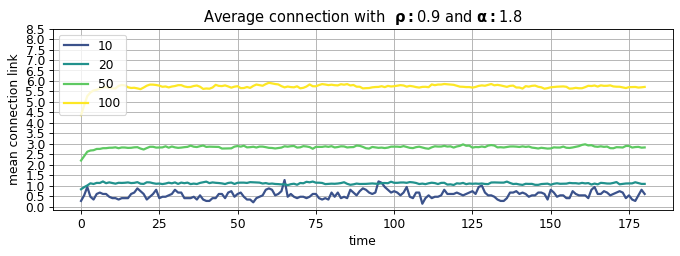

DirName: 2020-07-03_robots#10_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_2.0.png


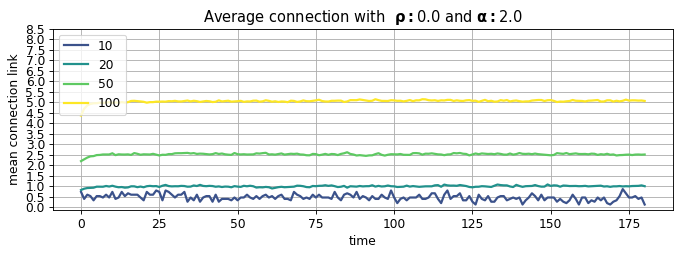

DirName: 2020-07-03_robots#10_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_2.0.png


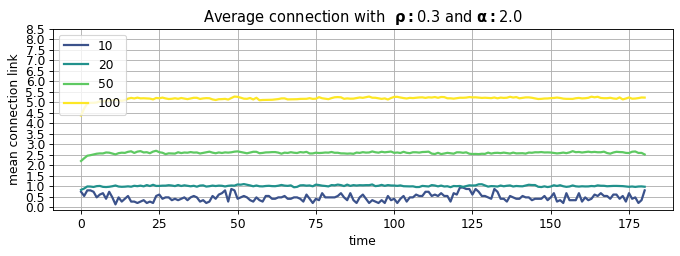

DirName: 2020-07-03_robots#10_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_2.0.png


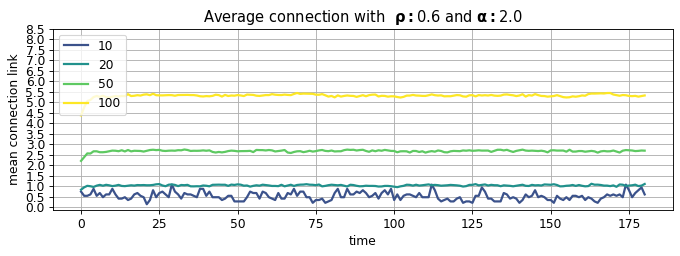

DirName: 2020-07-03_robots#10_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-07-03_robots#20_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-03_robots#50_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-03_robots#100_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_2.0.png


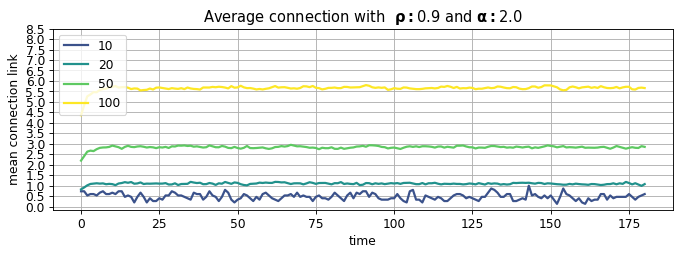

In [20]:
open_space_flag = False
randomAngle_folder = './results/ALL/Simulated/random_angle_100_runs'
avg_connection_plot_different_population_sizes(randomAngle_folder, './')

DirName: 2020-06-03_robots#10_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.2.png


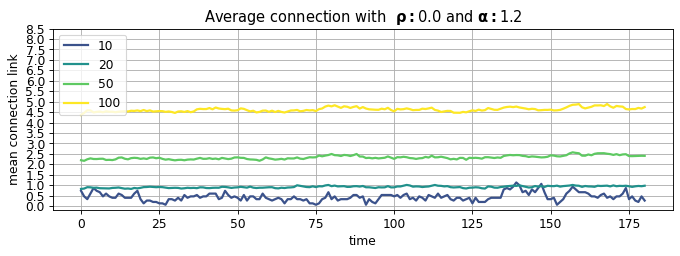

DirName: 2020-06-03_robots#10_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.2.png


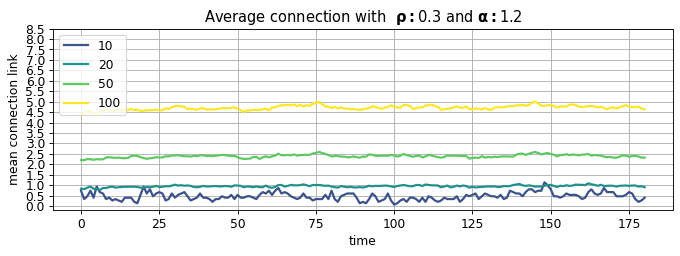

DirName: 2020-06-03_robots#10_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.2.png


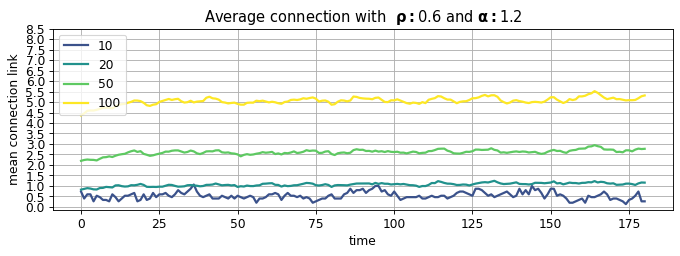

DirName: 2020-06-03_robots#10_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.2.png


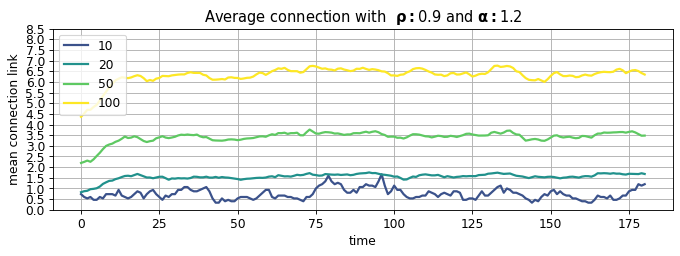

DirName: 2021-09-20_robots#10_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.

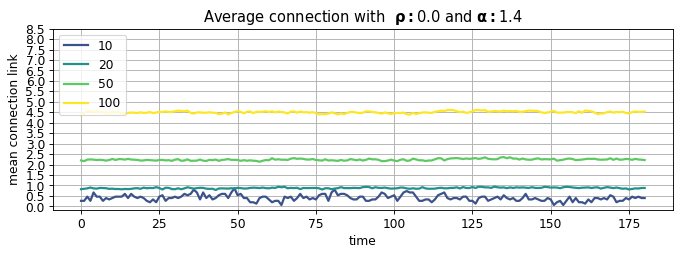

DirName: 2021-09-20_robots#10_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.

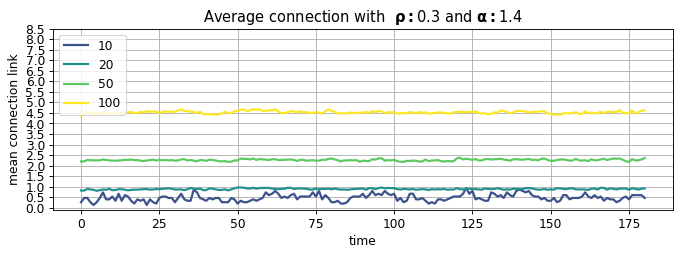

DirName: 2021-09-20_robots#10_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.

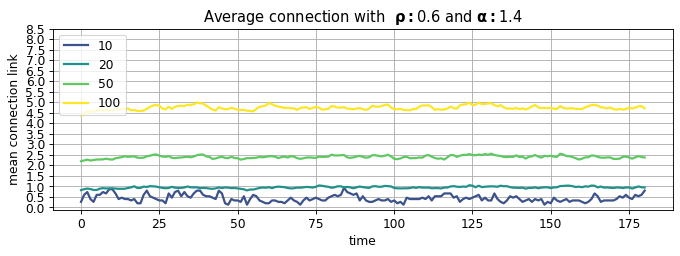

DirName: 2021-09-20_robots#10_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.

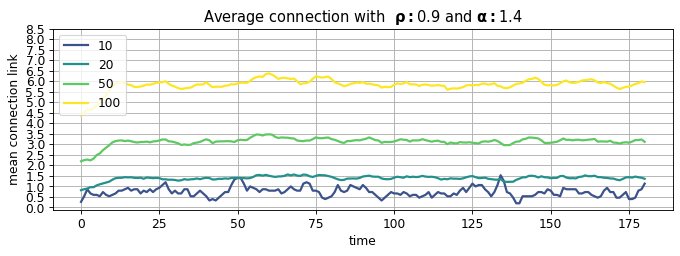

DirName: 2020-06-03_robots#10_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.6.png


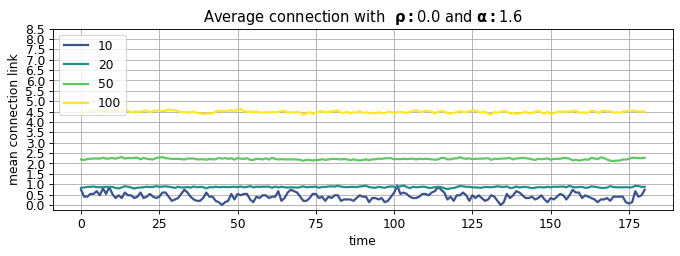

DirName: 2020-06-03_robots#10_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.6.png


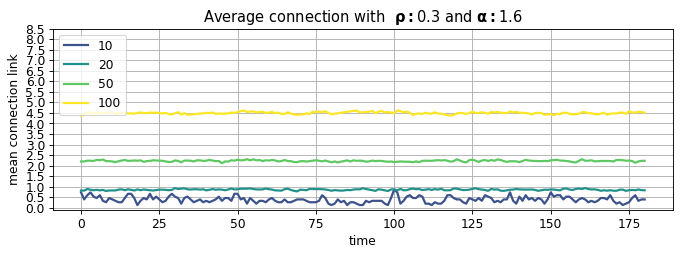

DirName: 2020-06-03_robots#10_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.6.png


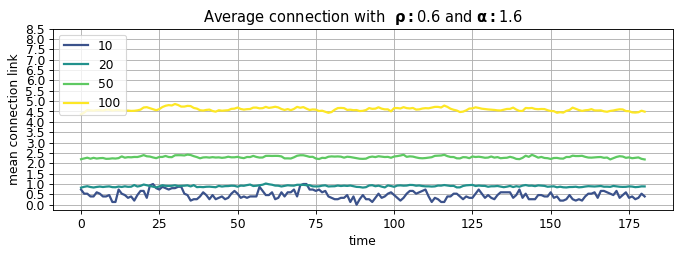

DirName: 2020-06-03_robots#10_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.6.png


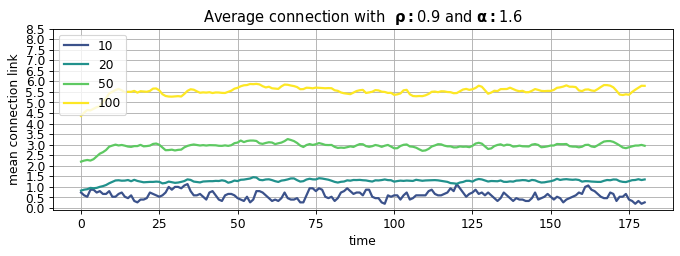

DirName: 2021-09-20_robots#10_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.0_1800/experiment.pkl
	runs 100
	positions_concatenated.

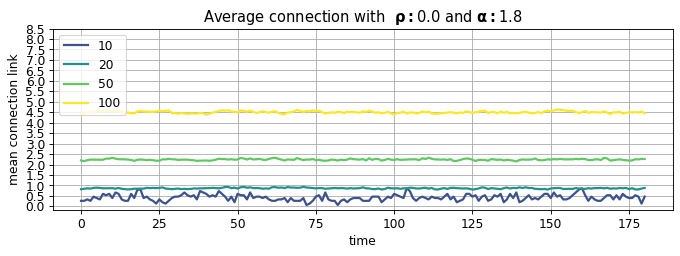

DirName: 2021-09-20_robots#10_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.3_1800/experiment.pkl
	runs 100
	positions_concatenated.

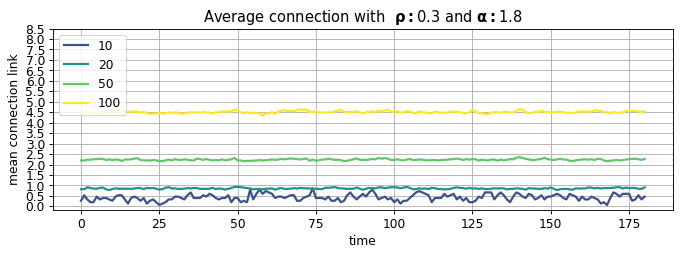

DirName: 2021-09-20_robots#10_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.6_1800/experiment.pkl
	runs 100
	positions_concatenated.

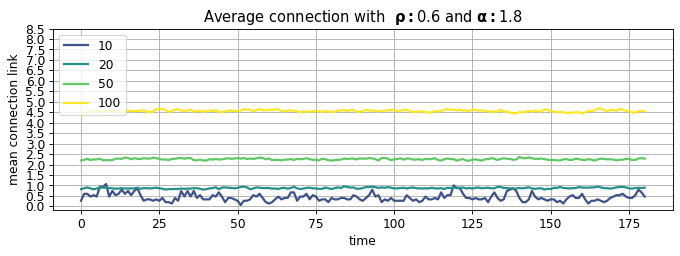

DirName: 2021-09-20_robots#10_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2021-09-20_robots#20_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-20_robots#50_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
Generating pickle positions file in ./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.9_1800/experiment.pkl
	runs 100
	positions_concatenated.

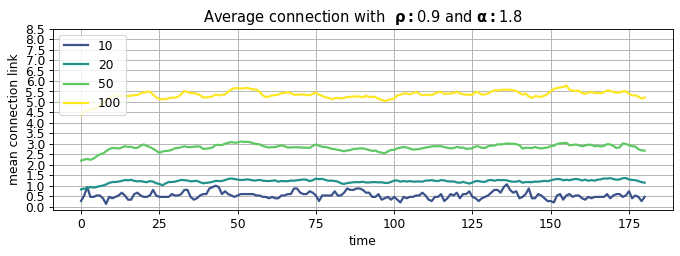

DirName: 2020-06-03_robots#10_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_2.0.png


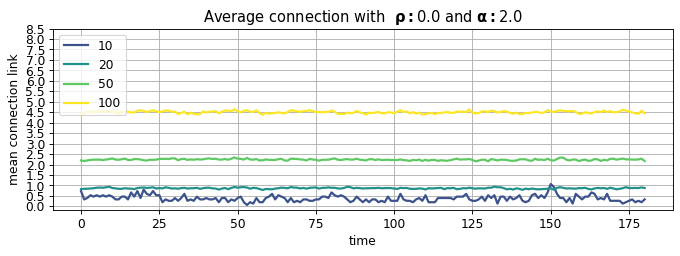

DirName: 2020-06-03_robots#10_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_2.0.png


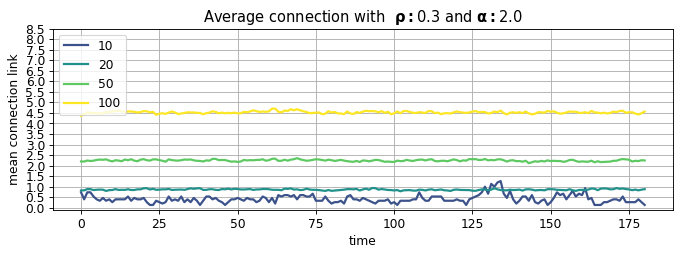

DirName: 2020-06-03_robots#10_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_2.0.png


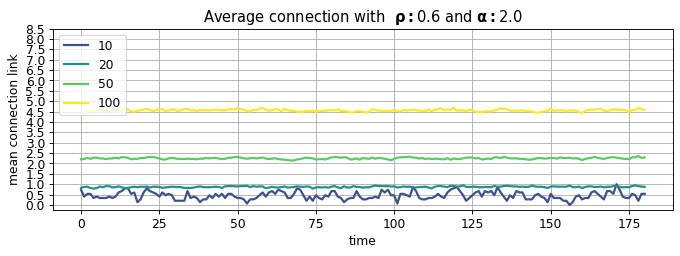

DirName: 2020-06-03_robots#10_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
DirName: 2020-06-03_robots#20_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-06-03_robots#50_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-06-03_robots#100_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_2.0.png


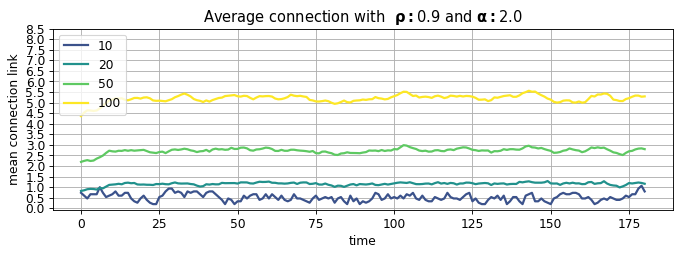

In [21]:
open_space_flag = False
simpleExperiment_folder = './results/ALL/Simulated/simple_experiment_100_runs'
avg_connection_plot_different_population_sizes(simpleExperiment_folder, './')

DirName: 2020-07-09_robots#10_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.2_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.2.png


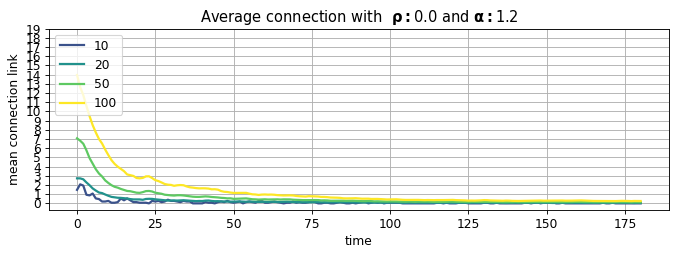

DirName: 2020-07-09_robots#10_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.2_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.2.png


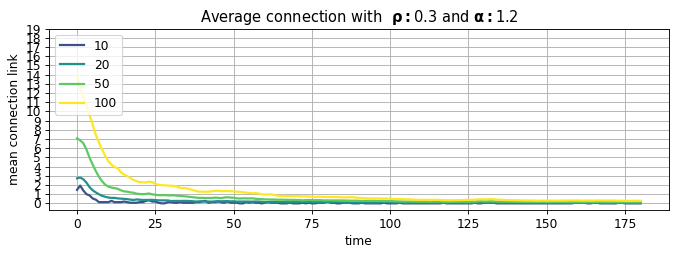

DirName: 2020-07-09_robots#10_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.2_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.2.png


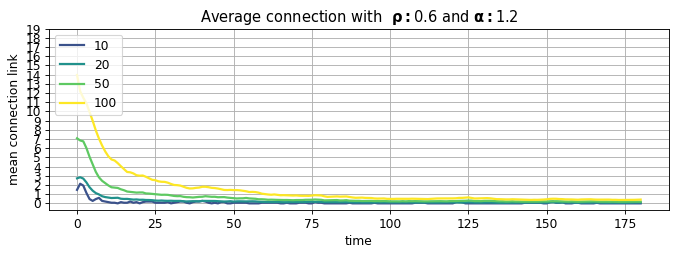

DirName: 2020-07-09_robots#10_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.2_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.2.png


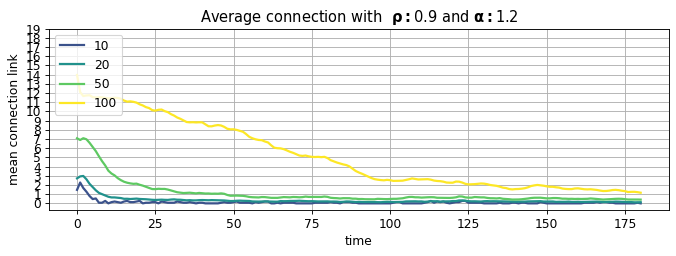

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.4.png


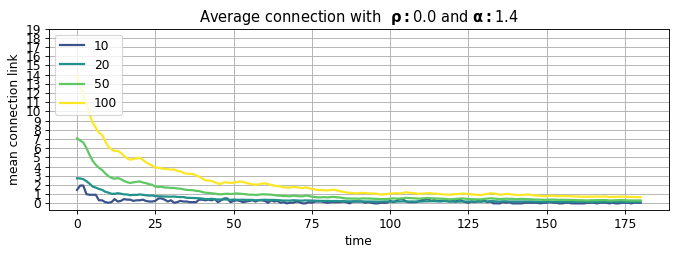

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.4.png


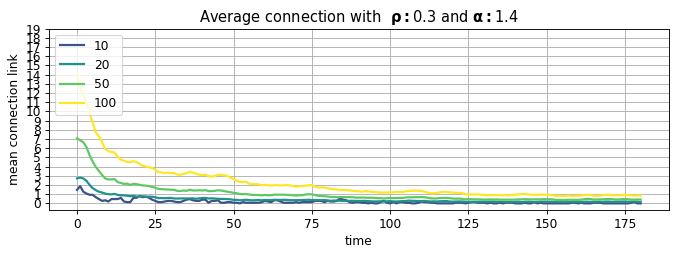

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.4.png


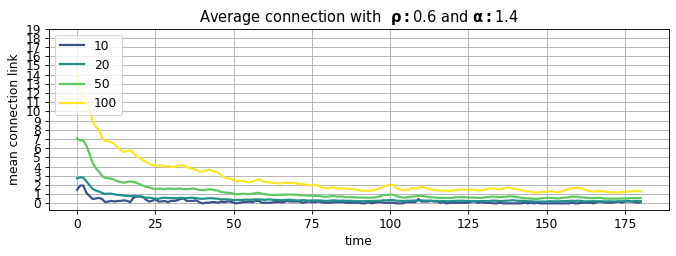

DirName: 2021-09-22_robots#10_alpha#1.4_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.4_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.4_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.4.png


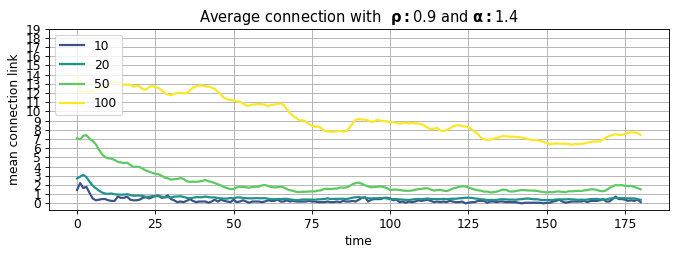

DirName: 2020-07-09_robots#10_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.6_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.6.png


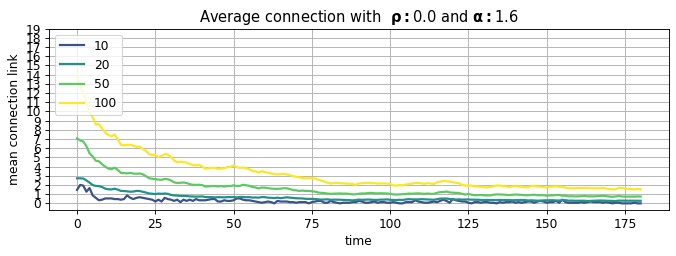

DirName: 2020-07-09_robots#10_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.6_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.6.png


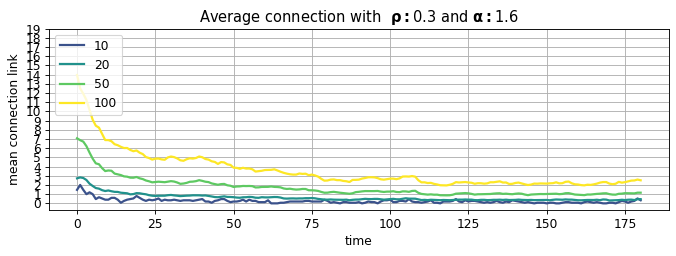

DirName: 2020-07-09_robots#10_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.6_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.6.png


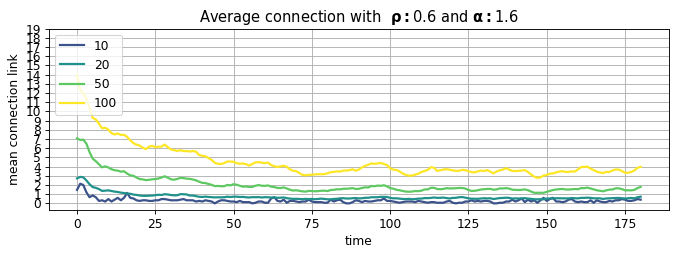

DirName: 2020-07-09_robots#10_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#1.6_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.6.png


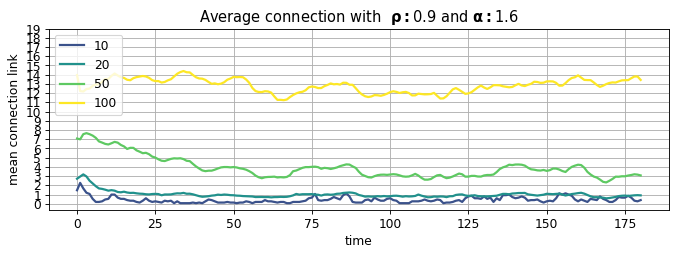

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_1.8.png


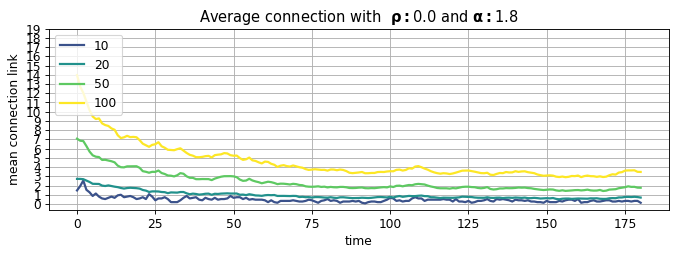

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_1.8.png


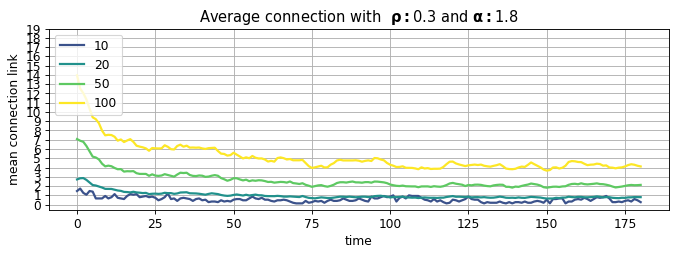

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_1.8.png


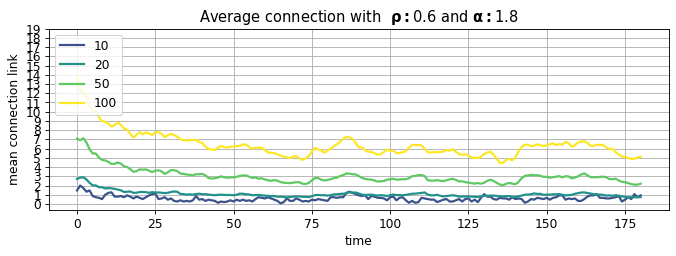

DirName: 2021-09-22_robots#10_alpha#1.8_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2021-09-22_robots#20_alpha#1.8_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2021-09-22_robots#50_alpha#1.8_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_1.8.png


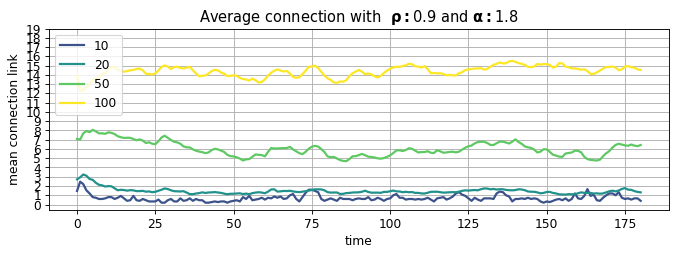

DirName: 2020-07-09_robots#10_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#2.0_rho#0.0_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.0_alpha_2.0.png


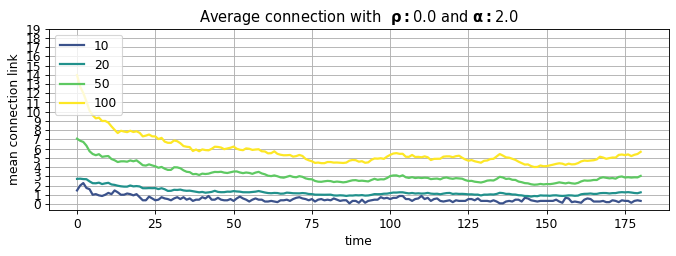

DirName: 2020-07-09_robots#10_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#2.0_rho#0.3_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.3_alpha_2.0.png


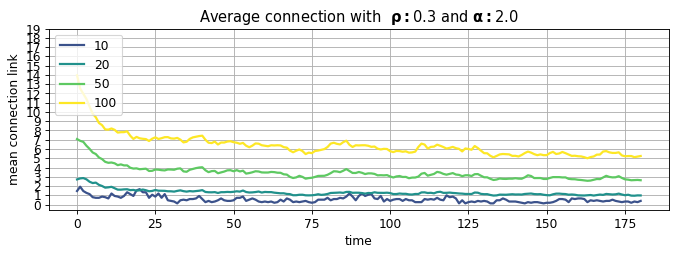

DirName: 2020-07-09_robots#10_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#2.0_rho#0.6_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.6_alpha_2.0.png


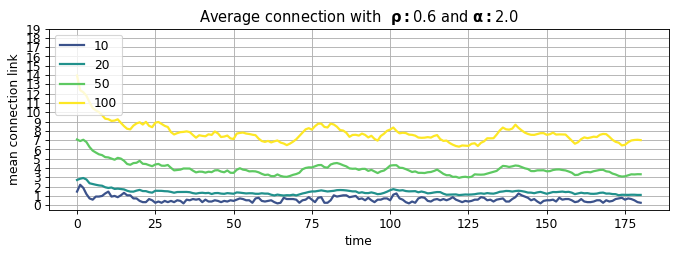

DirName: 2020-07-09_robots#10_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (1000, 181, 2)
Something happened
DirName: 2020-07-09_robots#20_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (2000, 181, 2)
DirName: 2020-07-09_robots#50_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (5000, 181, 2)
DirName: 2020-07-09_robots#100_alpha#2.0_rho#0.9_1800
	runs 100
	positions_concatenated.shape: (10000, 181, 2)
Saving fig: average_connection_plot_rho_0.9_alpha_2.0.png


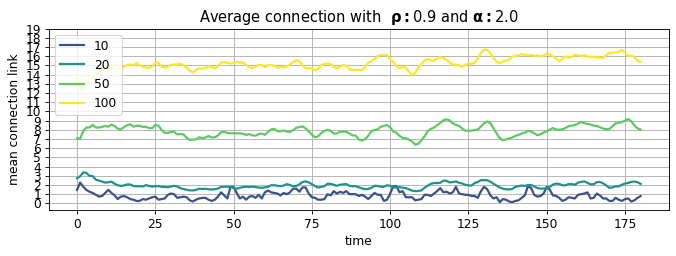

In [30]:
open_space_flag = True
openSpace_folder = './results/ALL/Simulated/bias_experiment_100_runs'
avg_connection_plot_different_population_sizes(openSpace_folder, './')

###  Heatmaps

In [31]:
def distance_from_the_origin(df_values):
    print('\t df_values.shape:', df_values.shape)
    distances = np.array([])
    # df_values1 = df_values[:3,:4]
    for i in range(df_values.shape[1]):
        #     print(i)
        x_pos = df_values[:, i, 0]
        y_pos = df_values[:, i, 1]
        distances = np.vstack([distances, np.sqrt(x_pos ** 2 + y_pos ** 2)]) if distances.size else np.sqrt(
            x_pos ** 2 + y_pos ** 2)
        
        
    # print(distances)
    print("distances shape", distances.shape)
    return distances

In [32]:
def connection_heatmap(edges, time_connections, alpha, rho, num_robots, avg_connection_degree_dir):
    y_edges = edges[1:].round(decimals=3)
    fig = plt.figure(figsize=(10, 5), dpi=160)
    yticks = y_edges
    ax = sns.heatmap(time_connections, yticklabels=yticks, cmap="viridis")
    ax.set_title(
        "Average connection from the origin with " + r"$\bf{Robots}$:" + num_robots + r" $\bf{\rho}:$" + rho + " and " + r"$\bf{\alpha}:$" + alpha)
    ax.set_ylabel('distance from the origin')
    ax.set_xlabel('time')
    file_name = "average_connection_heatmap_robots_%s_rho_%s_alpha_%s.png" % (num_robots, rho, alpha)
    plt.savefig(avg_connection_degree_dir + '/' + file_name)
    print(f"Saving fig: {avg_connection_degree_dir + '/' + file_name}")
#     plt.close(fig)
    plt.show()

In [34]:
# Average connection degree distribuited over different circular section positions (using Heatmaps)
def avg_connection_degree_heatmap(folder_experiment):
    for dirName, subdirList, fileList in os.walk(folder_experiment):

        num_robots = "-1"
        rho = -1.0
        alpha = -1.0
        elements = dirName.split("_")
        for e in elements:
            if e.startswith("robots"):
                num_robots = e.split("#")[-1]
            if (e.startswith("rho")):
                rho = float(e.split("#")[-1])
            if (e.startswith("alpha")):
                alpha = float(e.split("#")[-1])

        #         print(num_robots+' '+str(rho)+' '+str(alpha))
        if (num_robots == "-1" or rho == -1.0 or alpha == -1):
            continue
        else:
            print(dirName)
            runs = len([f for f in fileList if f.endswith('position.tsv')])
        #         print(runs)

        [_, df_experiment] = load_pd_positions(dirName, "experiment")

        positions_concatenated = df_experiment.values[:, 1:]
        [num_robot, num_times] = positions_concatenated.shape
        positions_concatenated = np.array([x.split(',') for x in positions_concatenated.ravel()], dtype=float)
        positions_concatenated = positions_concatenated.reshape(num_robot, num_times, 2)
        position_concatenated_split = np.split(positions_concatenated, runs)
        # print("positions_concatenated.shape: ", positions_concatenated.shape)

        # CONNECTIONS
        connection_number_history = np.array([])
        for single_run in position_concatenated_split:
            connection_number_history = np.vstack((connection_number_history, get_connections(
                single_run))) if connection_number_history.size else get_connections(single_run)

        print(connection_number_history.shape)

        # ORIGIN DISTANCE
        origin_distance = distance_from_the_origin(positions_concatenated).T

        connection_in_time = np.ones((bin_edges.size - 1, origin_distance.shape[1])) * -1

        print('origin_distance.shape', origin_distance.shape)
        print('origin_distance.T.shape', origin_distance.T.shape)
        for idx, distance_t in enumerate(origin_distance.T):
            #     print(distance_t)
            for edge_idx in range(bin_edges.size - 1):
                #         print(bin_edges[edge_idx],bin_edges[edge_idx+1])
                #         print("\t",edge_idx)

                if edge_idx < bin_edges.size - 1 or not open_space_flag:
                    where_index = np.where(
                        np.logical_and(distance_t >= bin_edges[edge_idx],
                                       distance_t < bin_edges[edge_idx + 1]))
                    connection_in_time[edge_idx, idx] = np.mean(connection_number_history[where_index])

                else:
                    where_index = np.where(distance_t >= bin_edges[edge_idx])
                    connection_in_time[edge_idx, idx] = np.mean(connection_number_history[where_index])

        connection_heatmap(bin_edges, connection_in_time, str(alpha), str(rho), num_robots,'./')

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.4.png


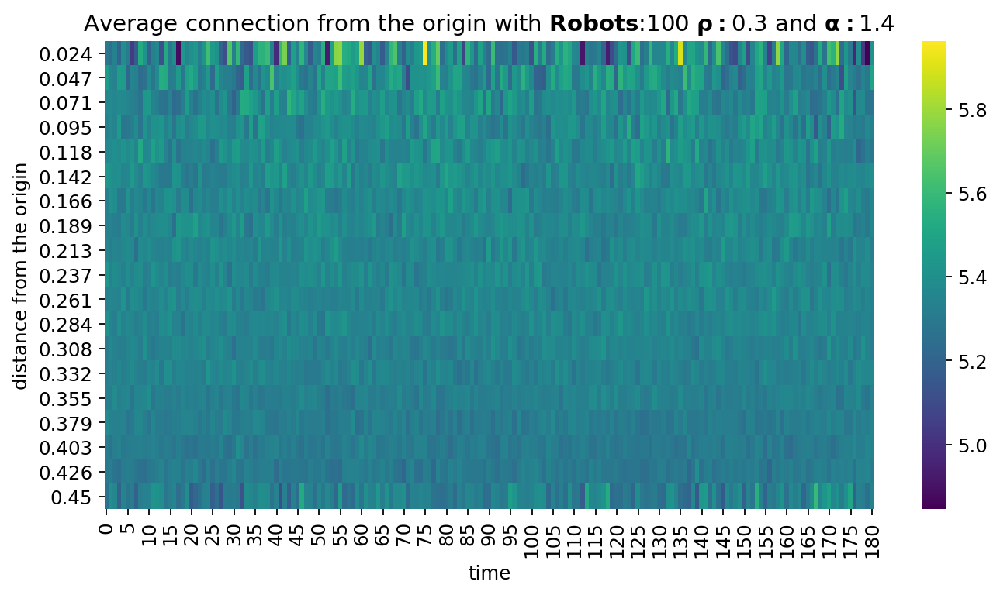

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.6_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.6.png


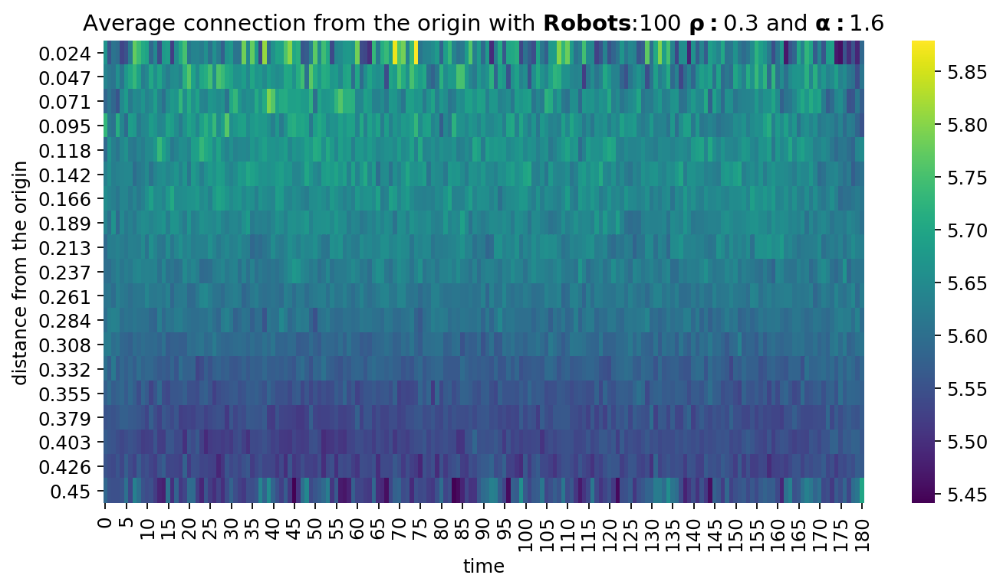

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.4.png


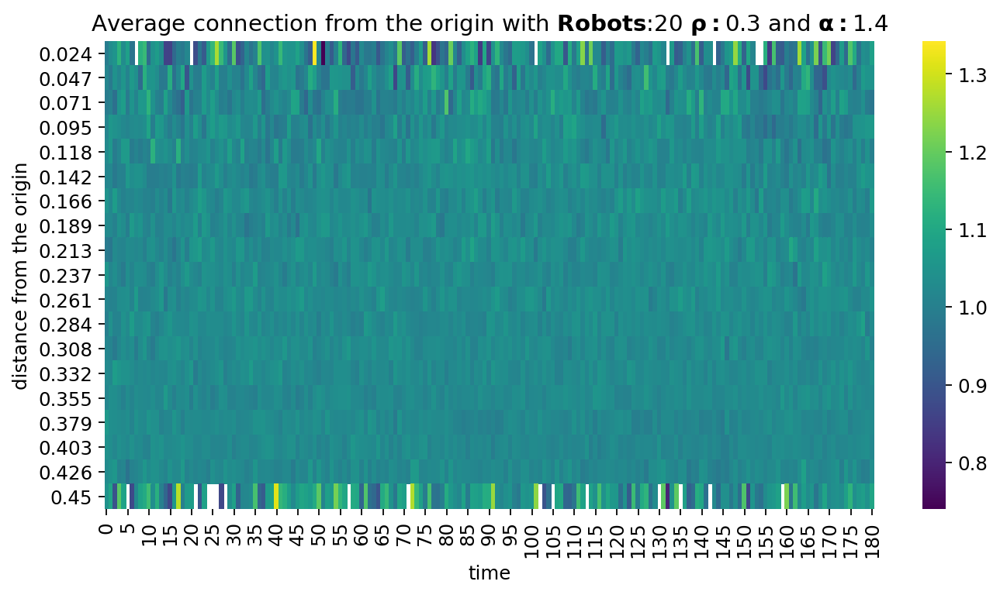

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.0_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.8.png


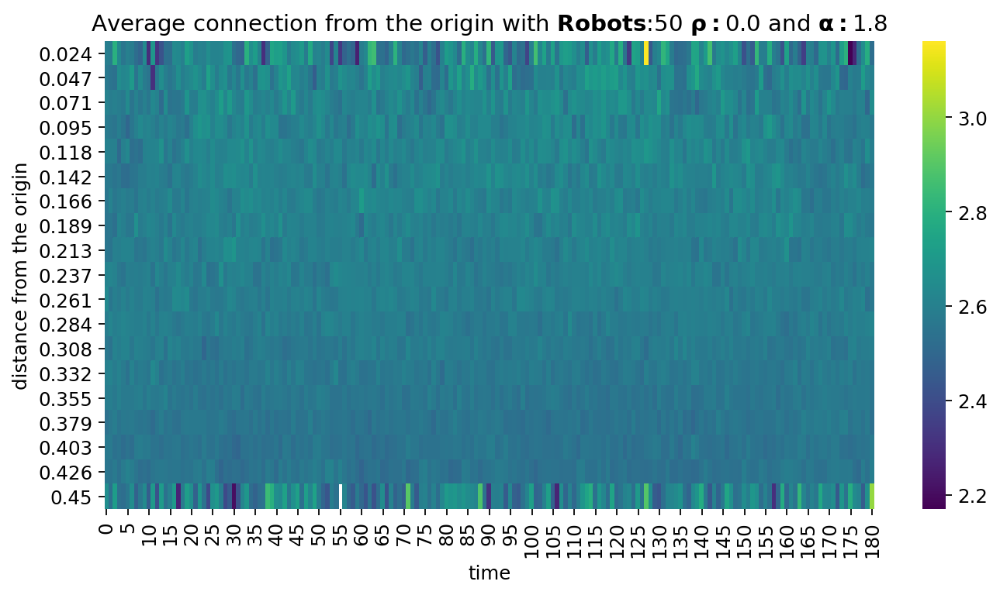

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.8.png


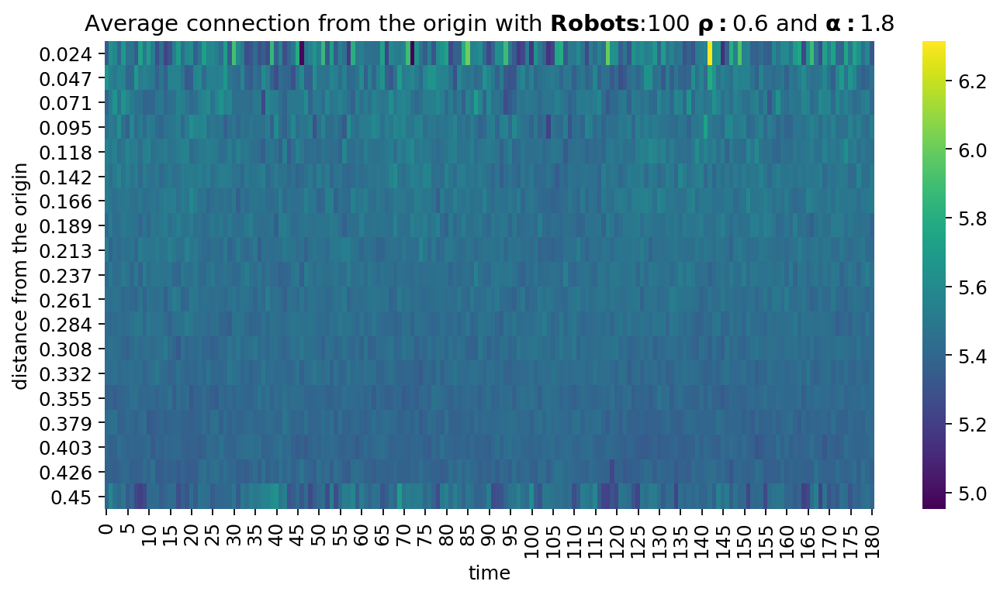

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.2_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.2.png


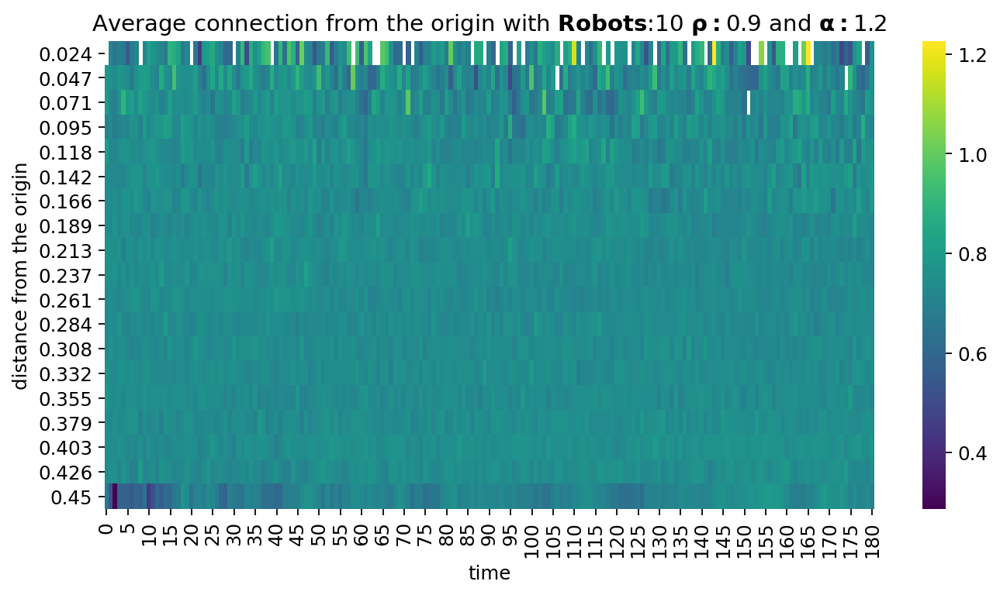

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.2_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.2.png


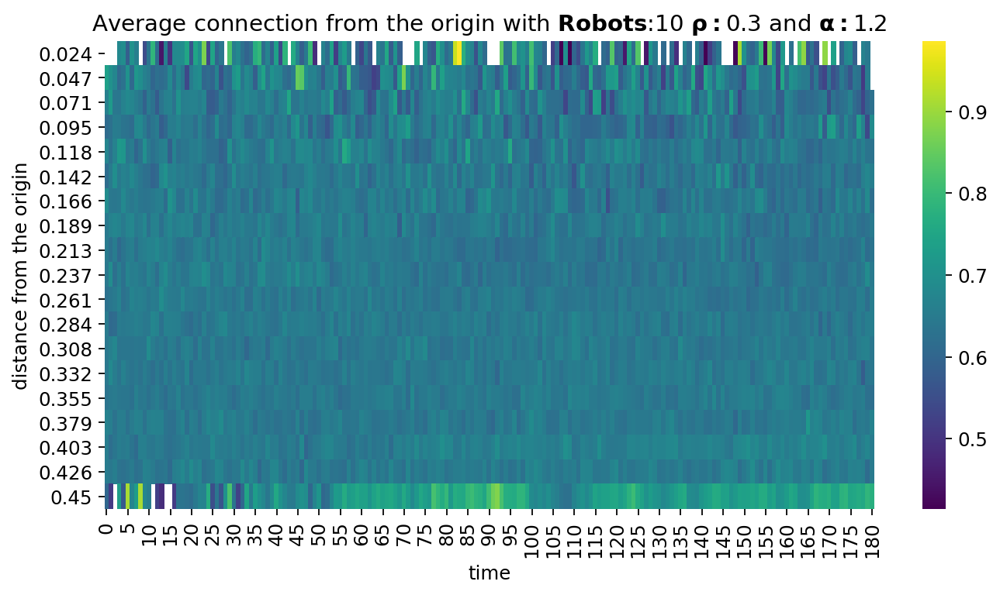

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.2_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.2.png


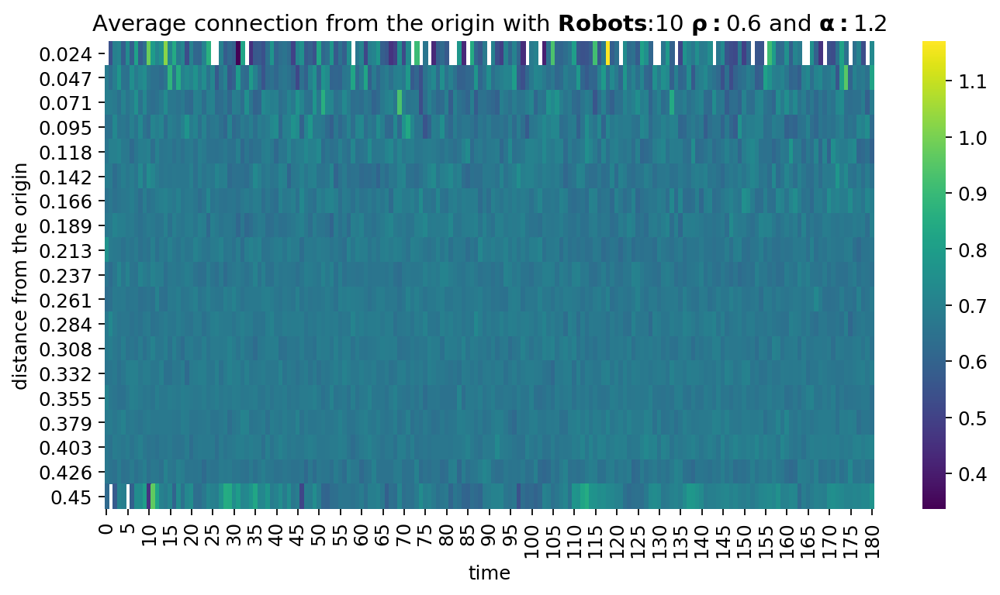

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#2.0_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_2.0.png


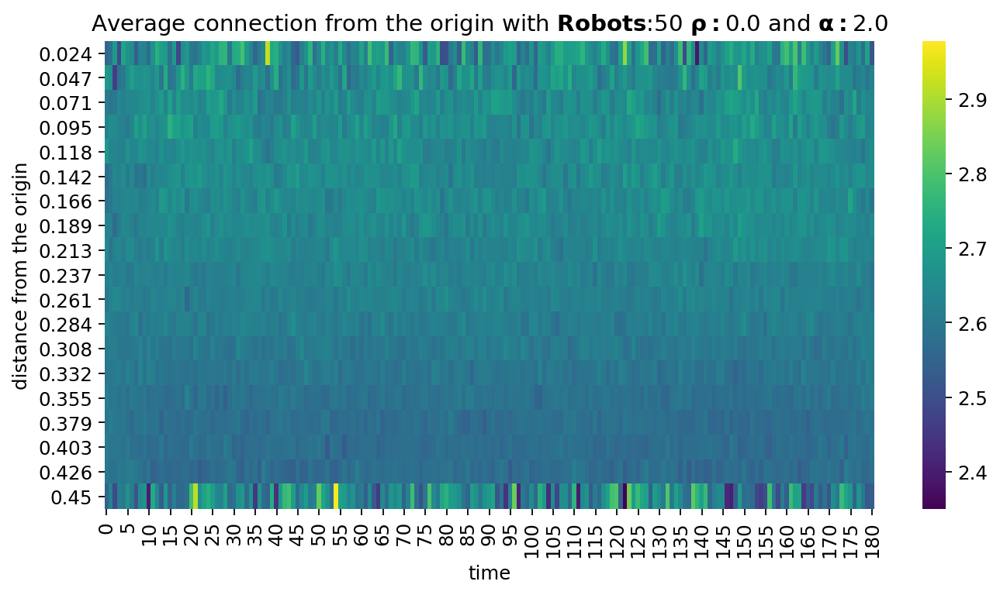

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.2_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.2.png


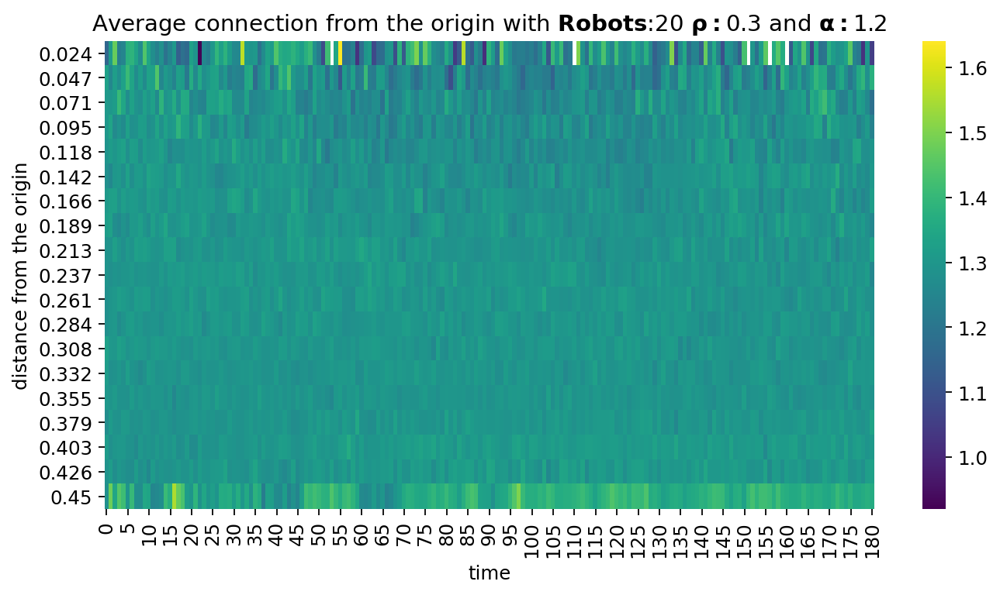

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.2_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.2.png


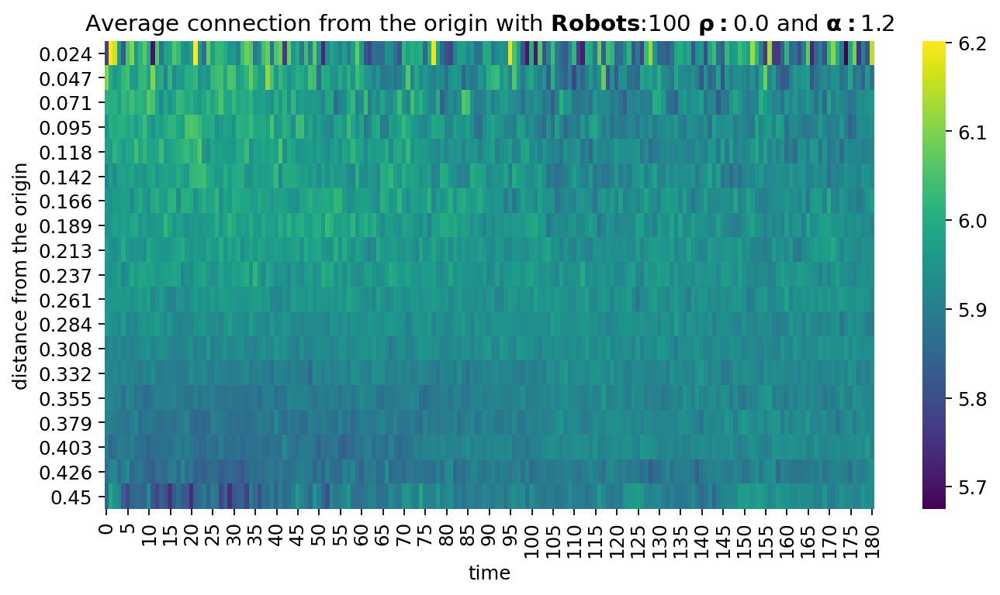

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.6_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.6.png


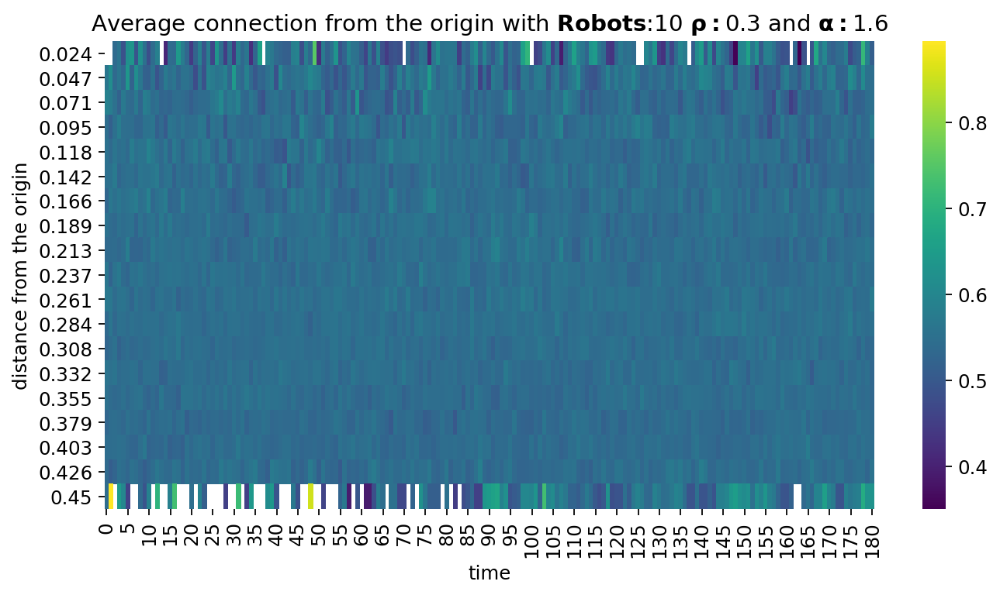

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.4.png


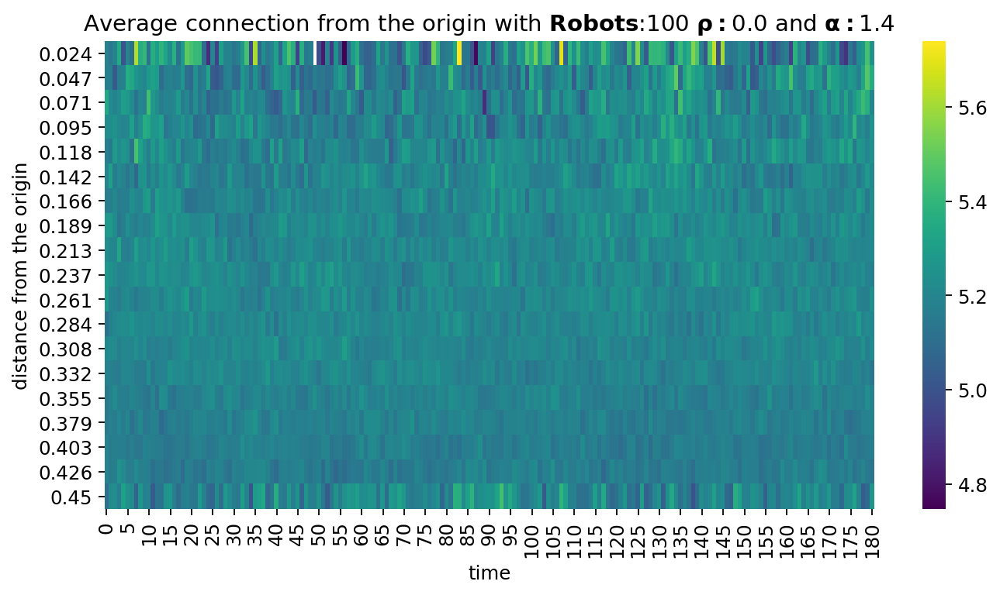

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.4.png


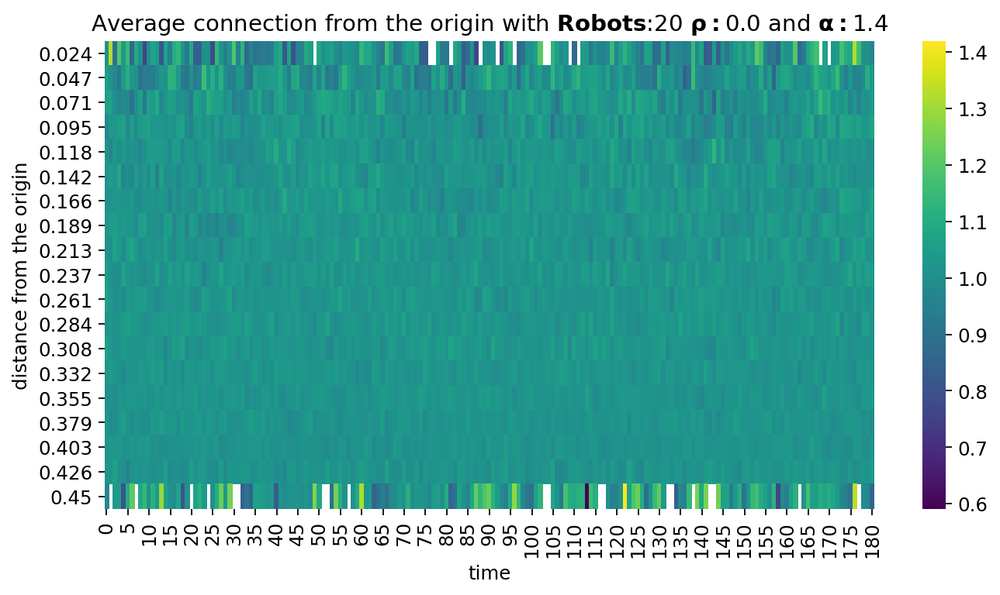

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.6_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.6.png


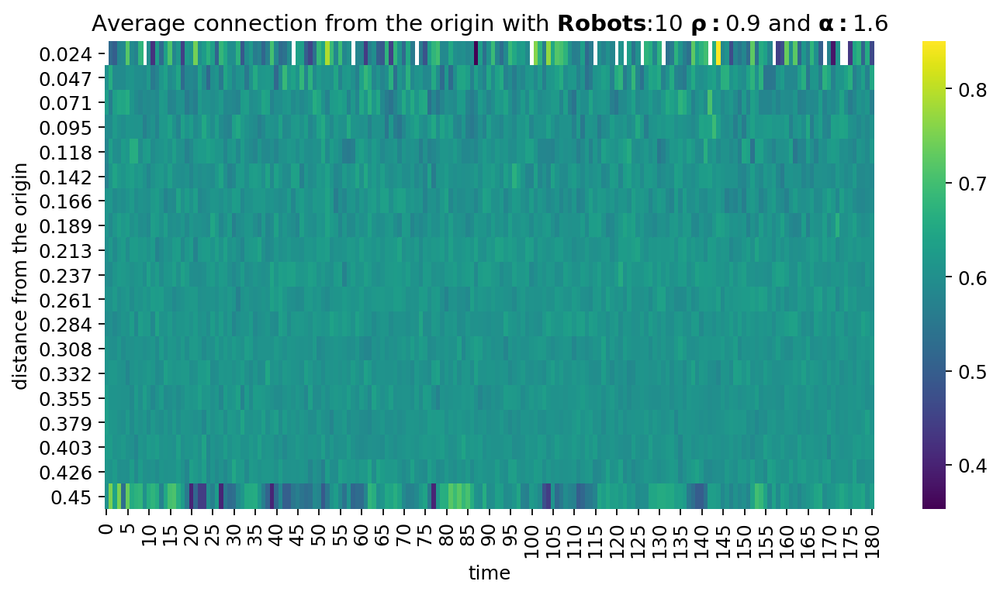

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.8.png


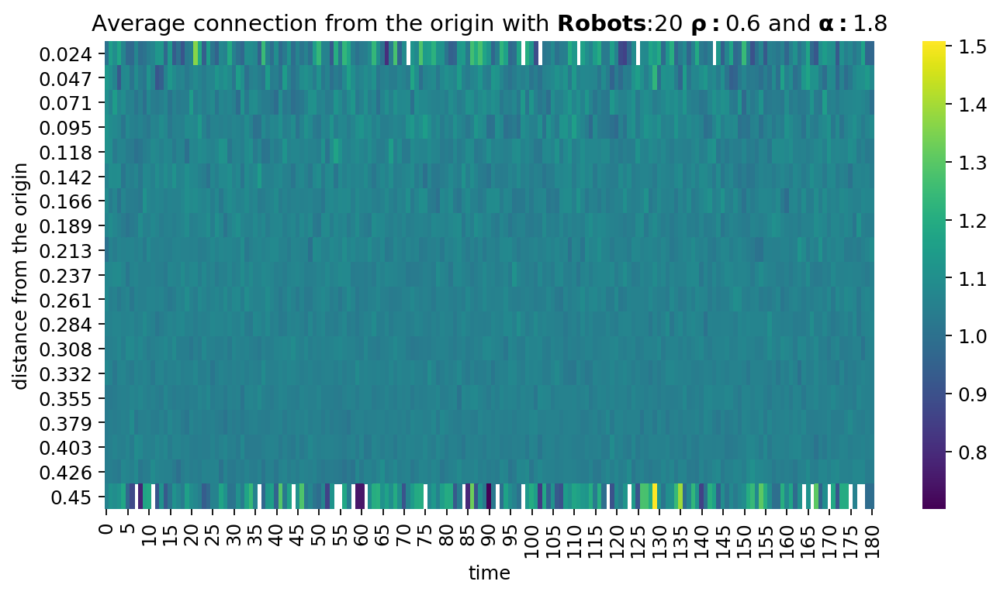

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.0_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.4.png


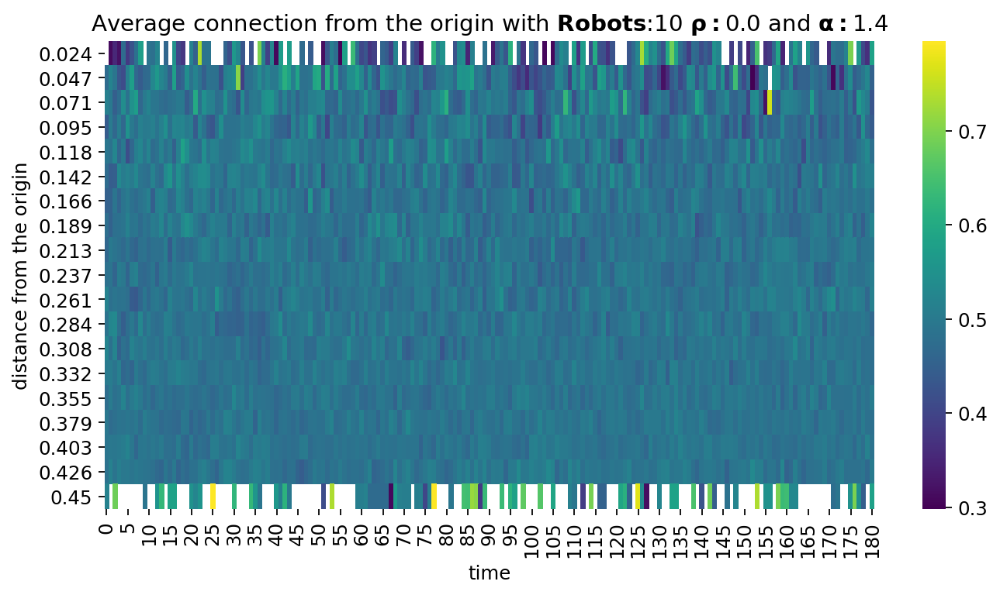

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.2_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.2.png


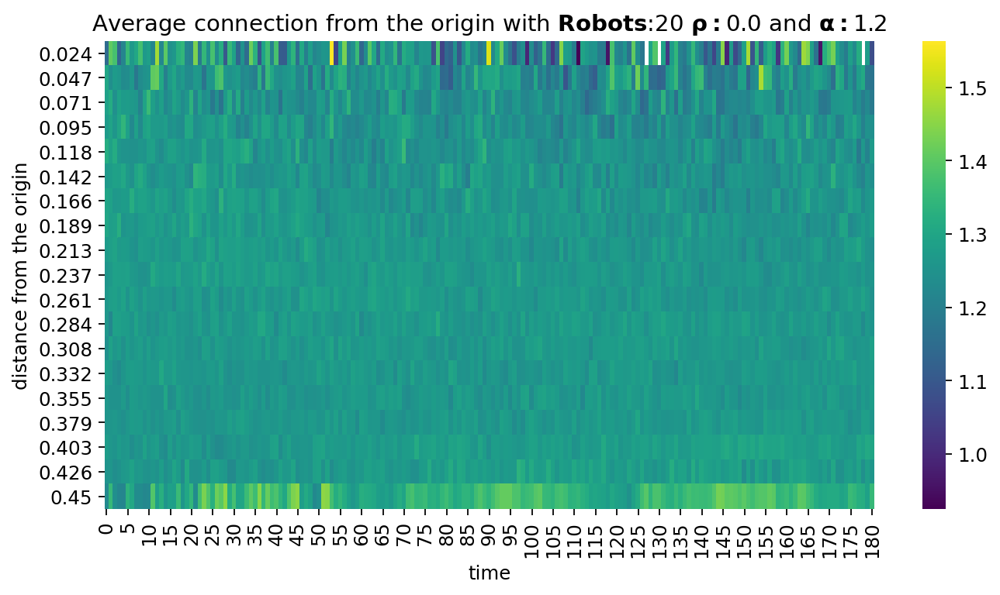

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.6_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.6.png


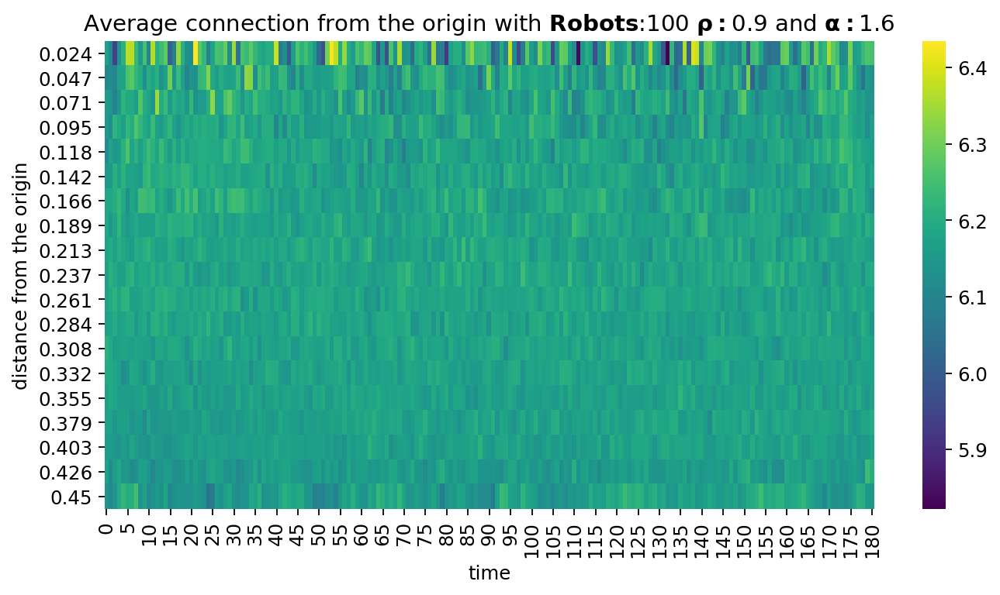

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.2_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.2.png


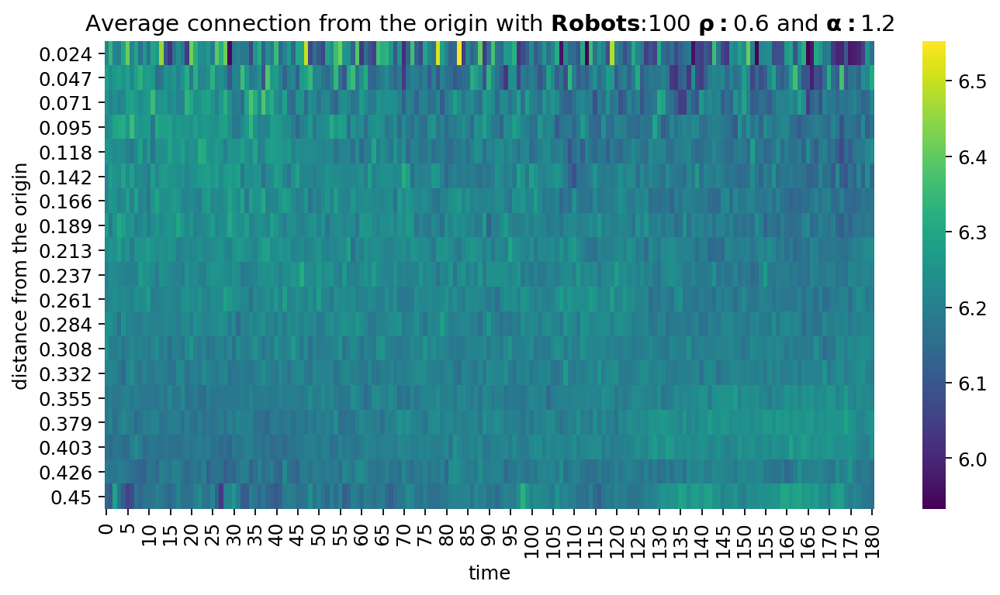

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#2.0_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_2.0.png


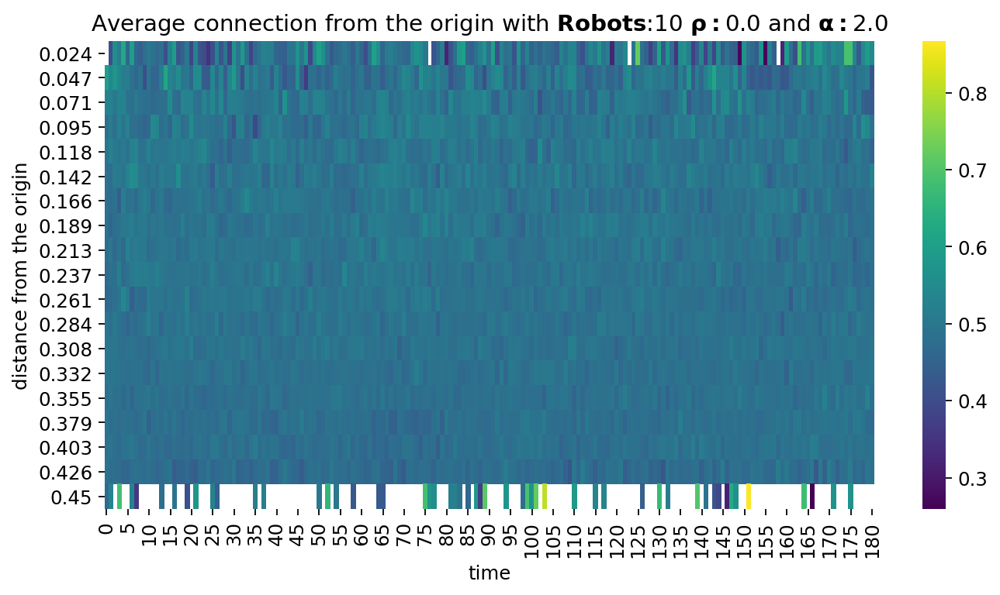

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.3_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.8.png


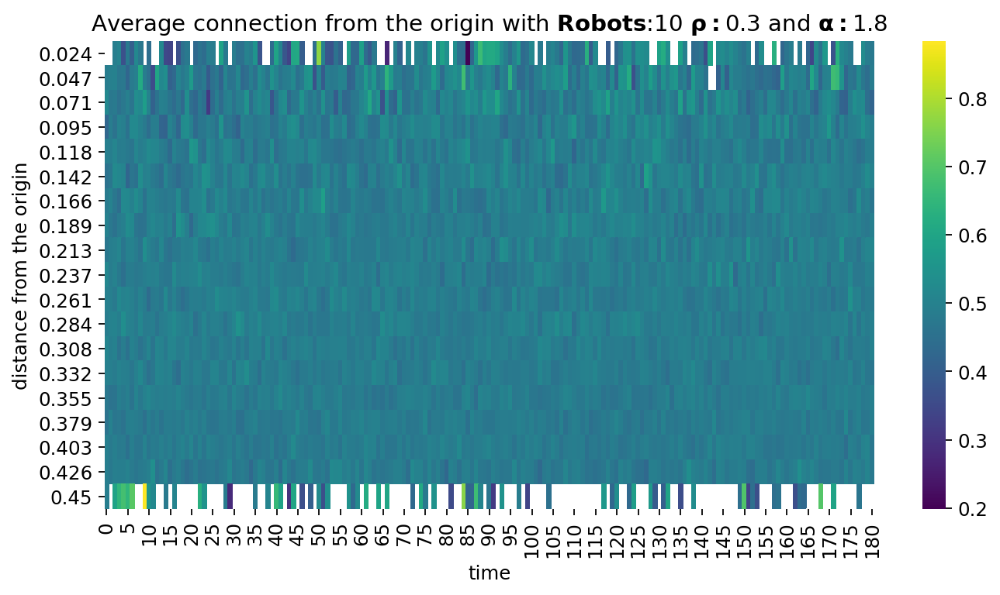

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#2.0_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_2.0.png


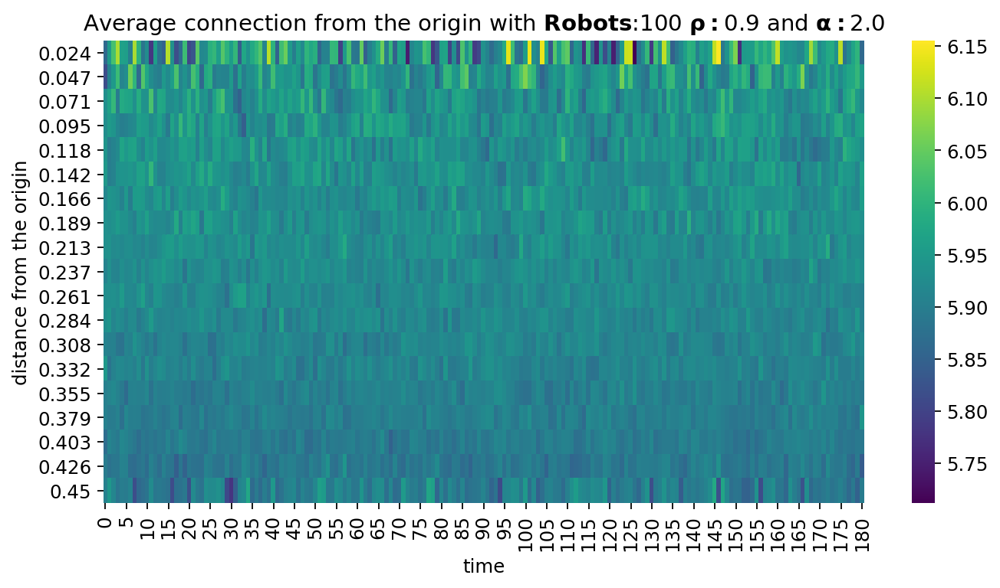

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#2.0_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_2.0.png


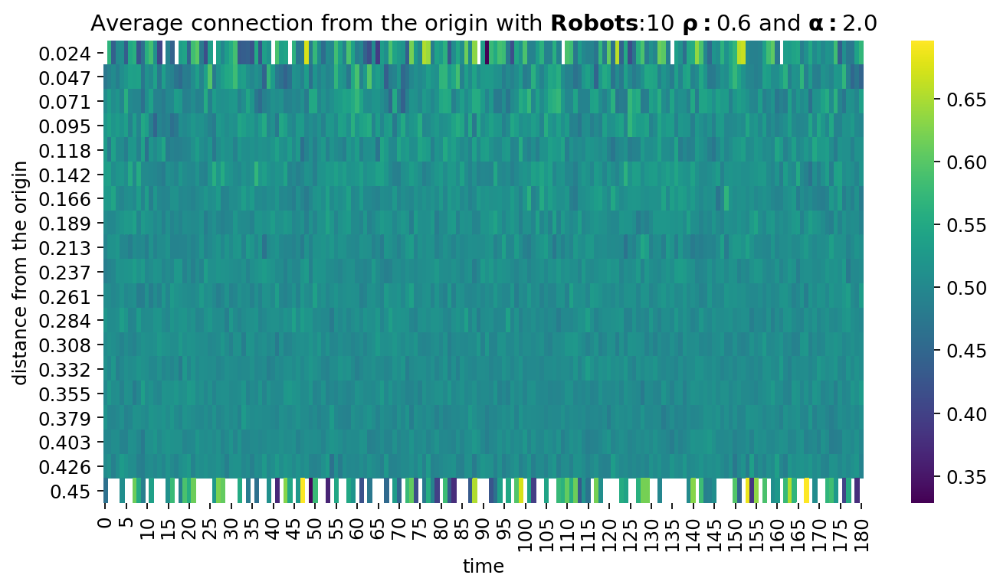

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#2.0_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_2.0.png


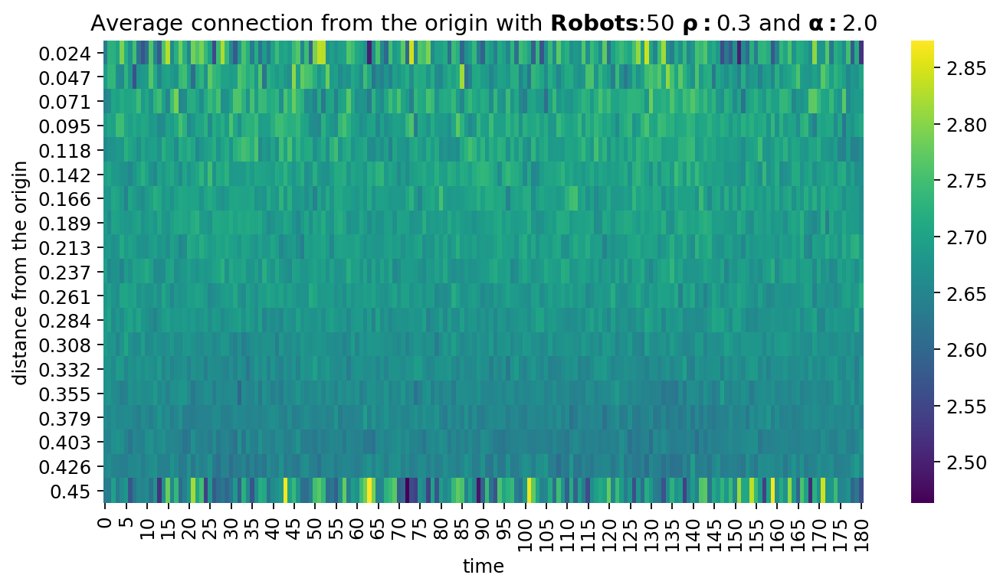

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.6_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.6.png


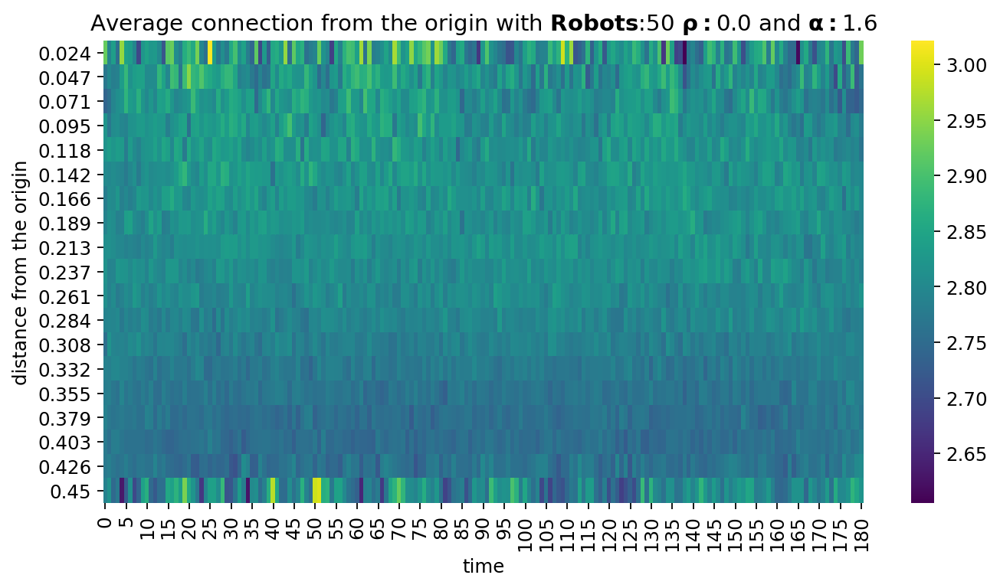

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.4.png


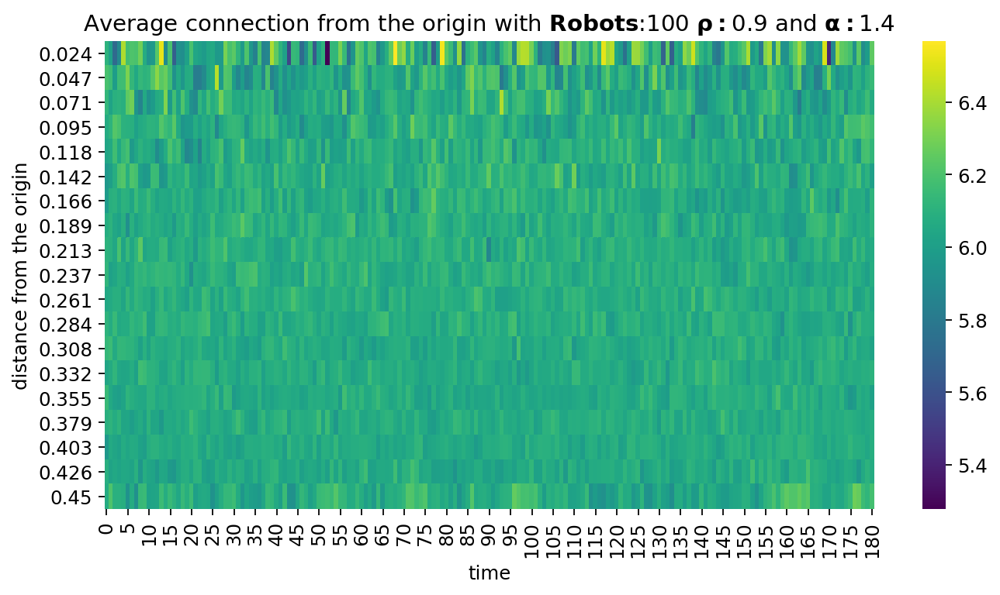

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.2_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.2.png


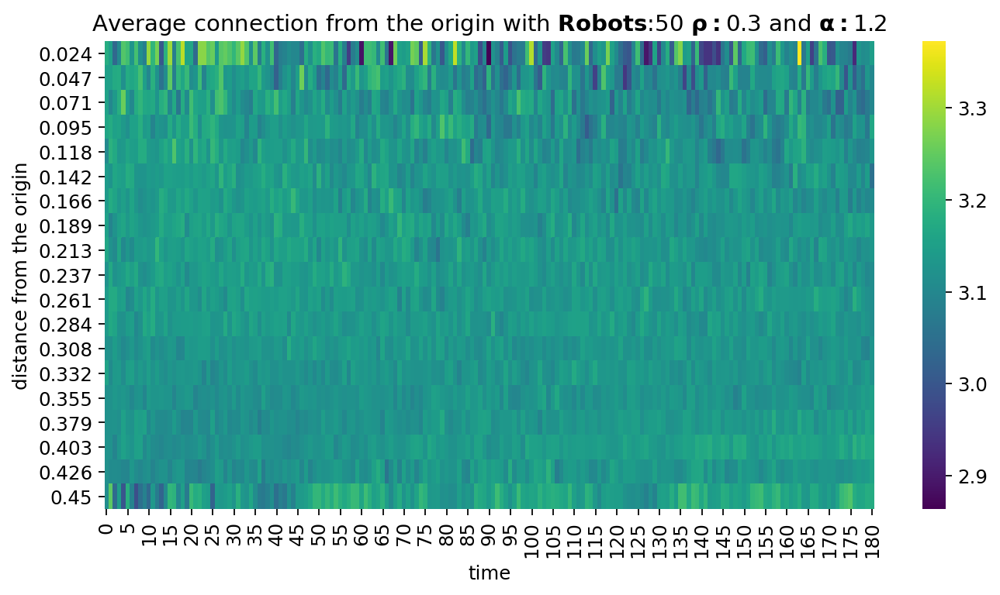

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.2_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.2.png


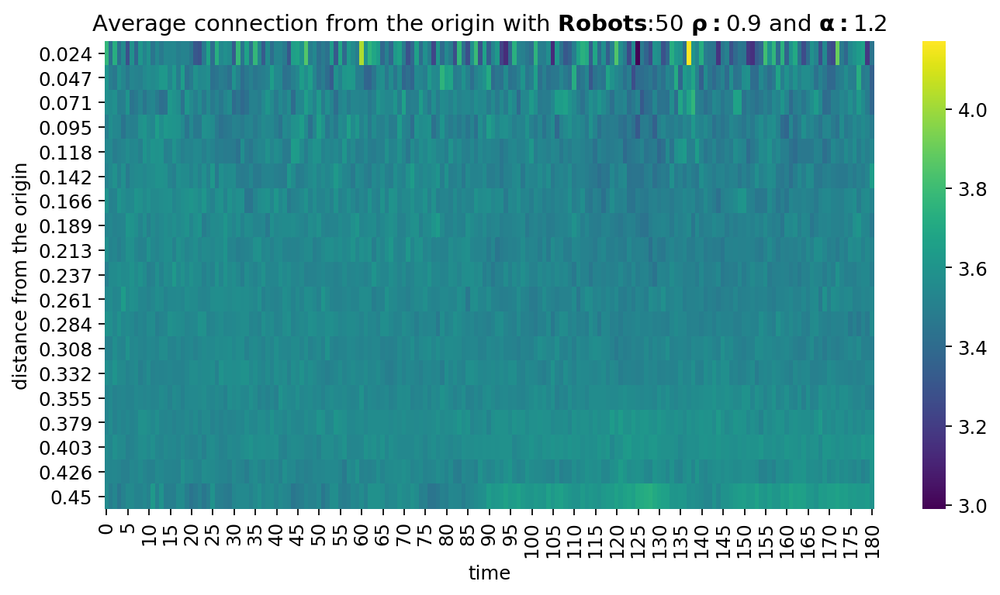

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.2_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.2.png


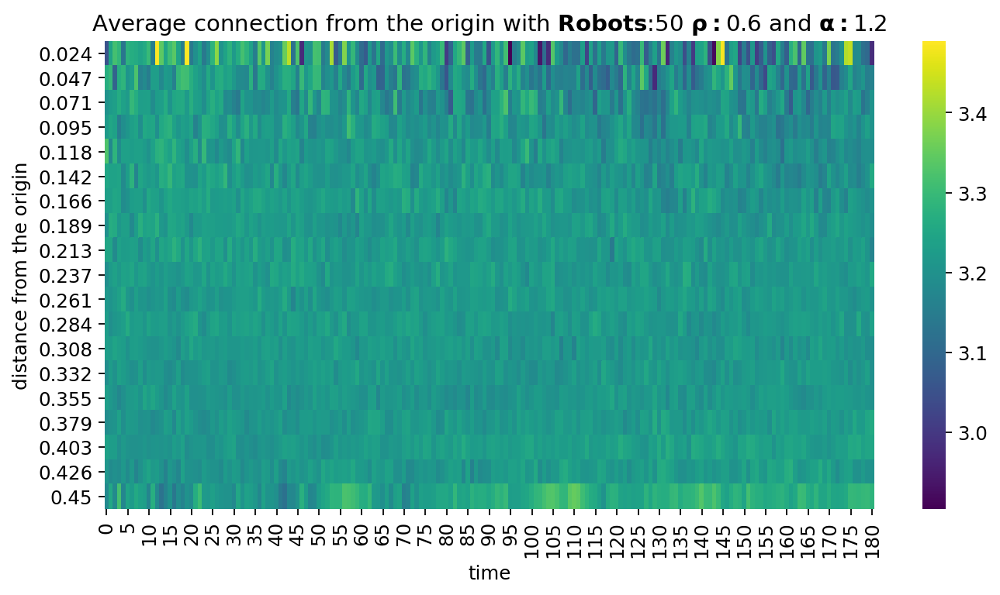

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.8.png


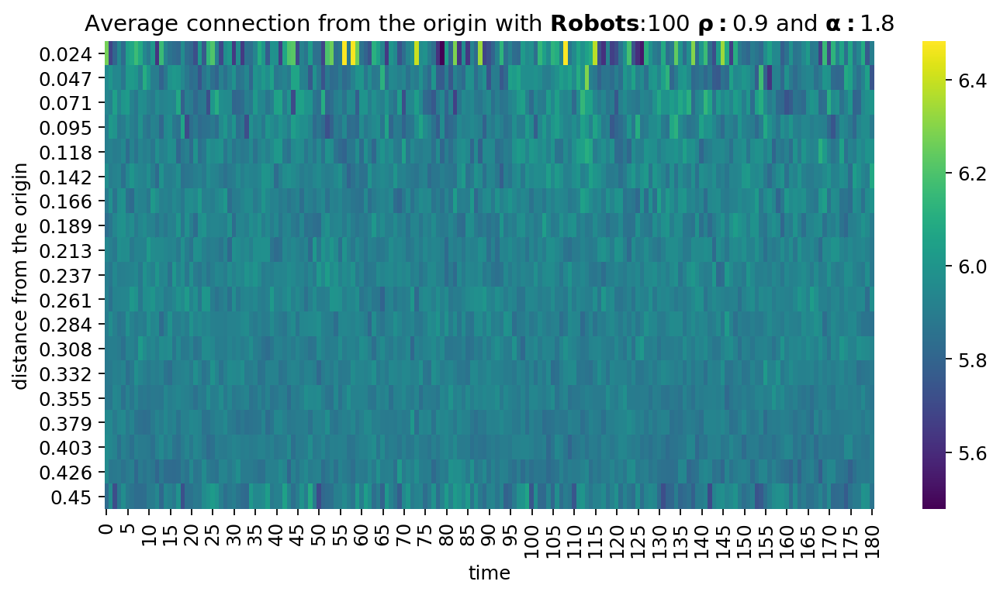

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#2.0_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_2.0.png


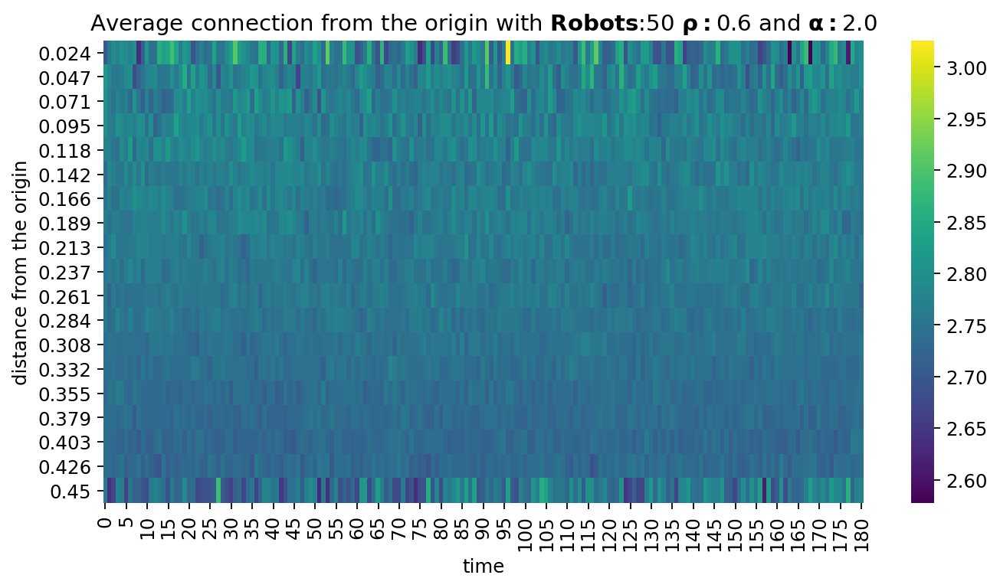

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.9_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.4.png


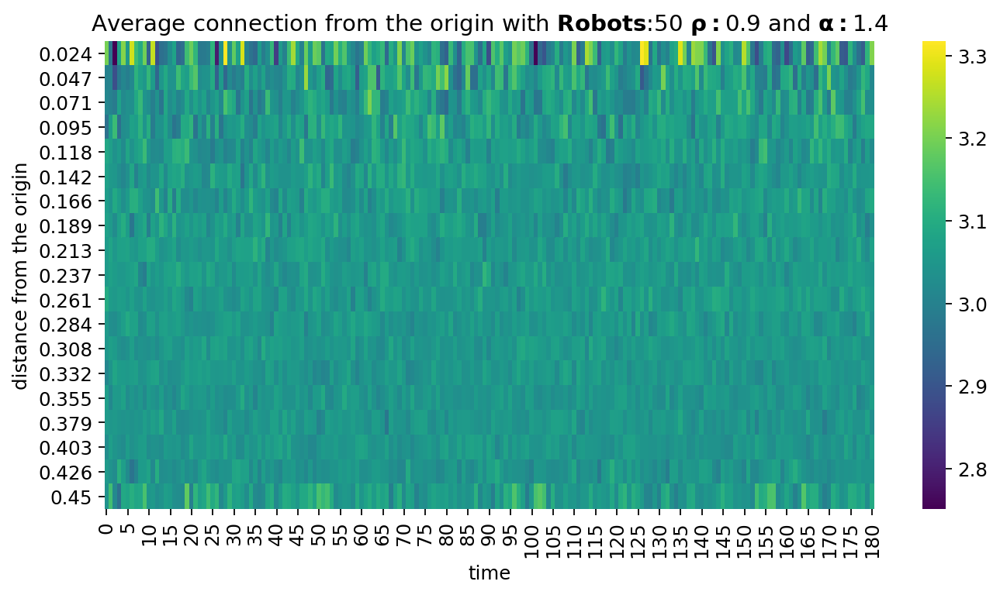

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.9_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.8.png


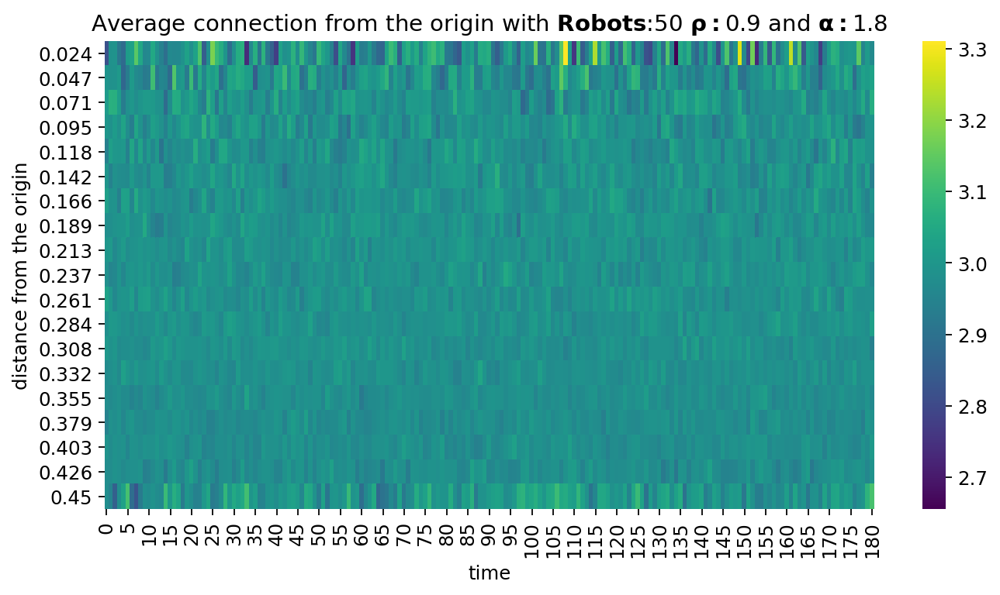

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.8.png


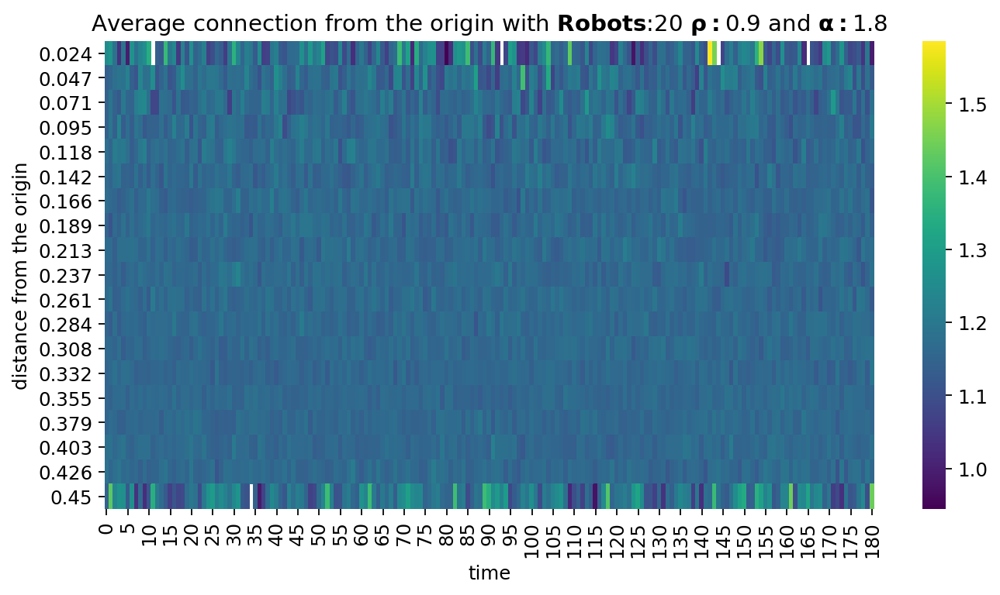

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#2.0_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_2.0.png


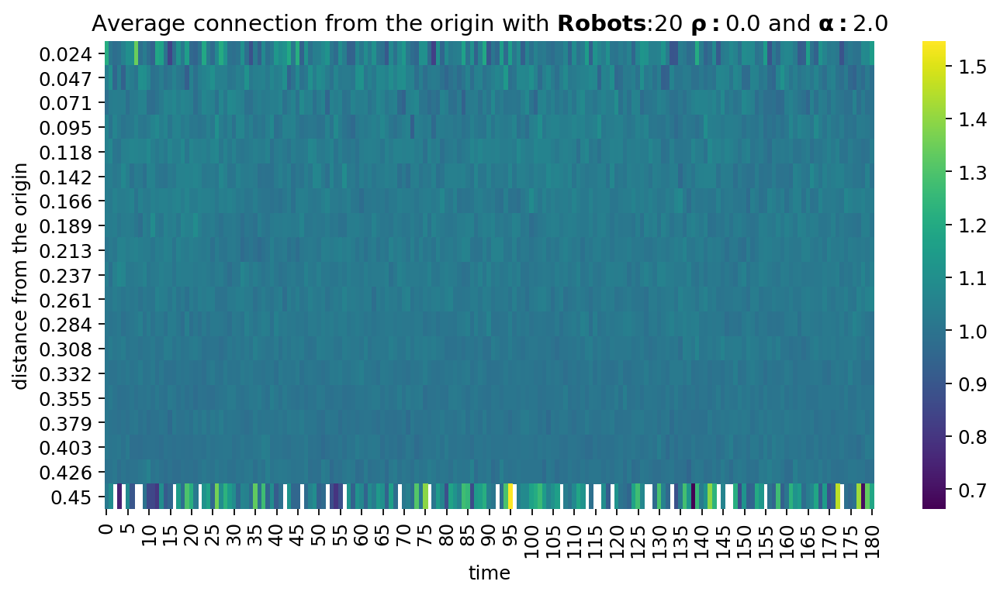

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.2_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.2.png


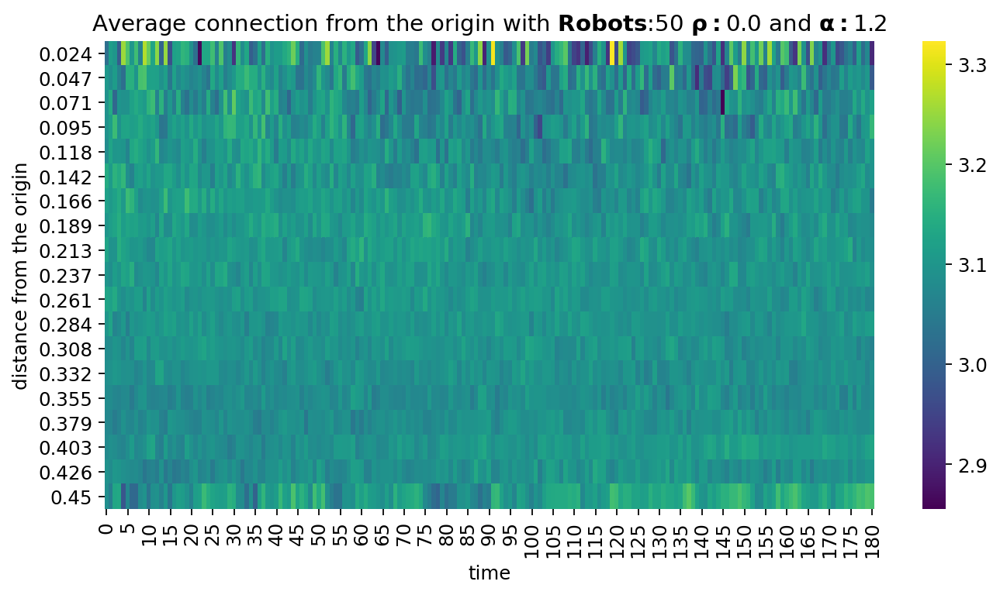

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.2_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.2.png


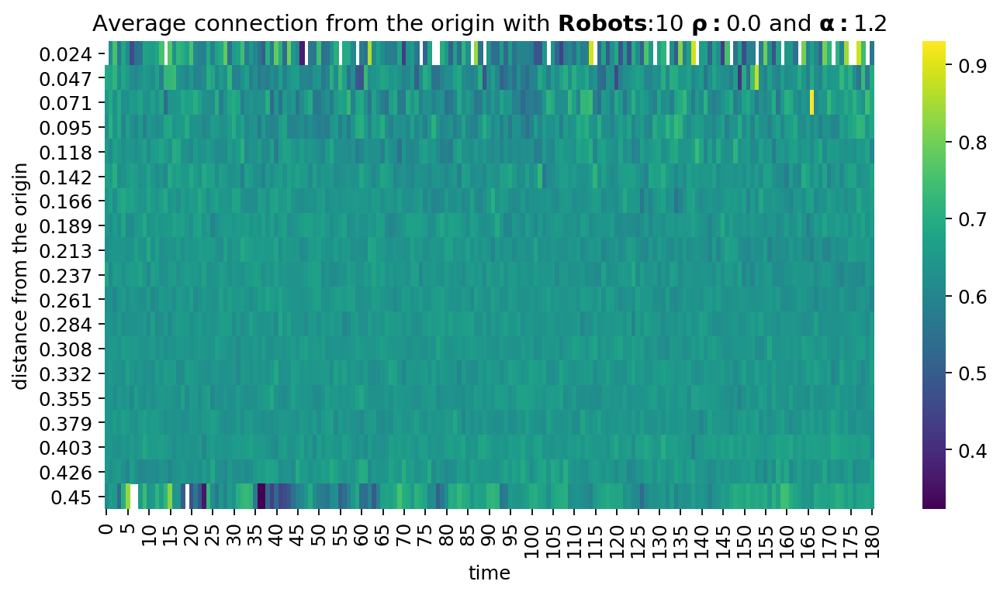

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.2_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.2.png


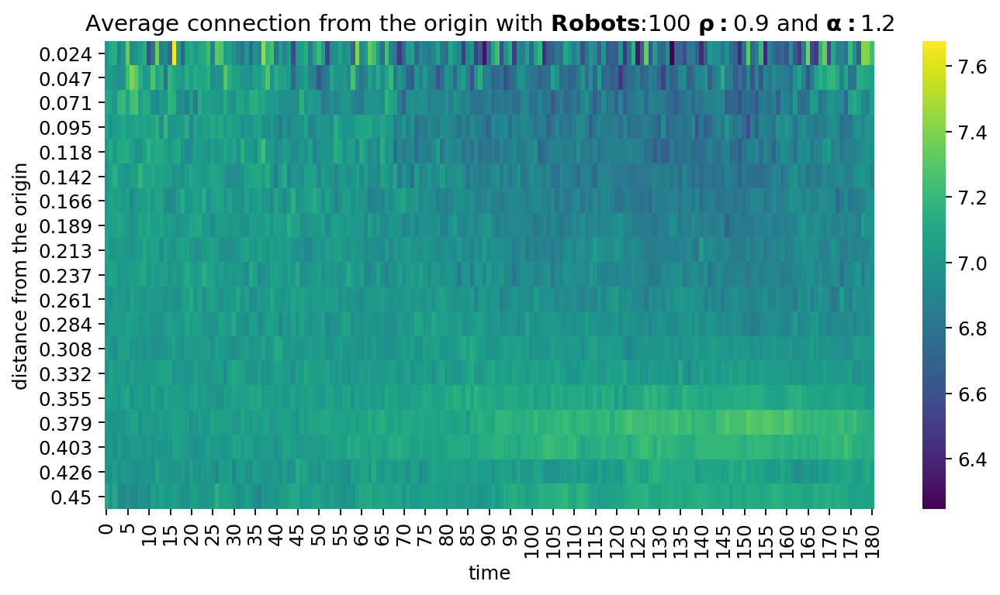

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.6_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.6.png


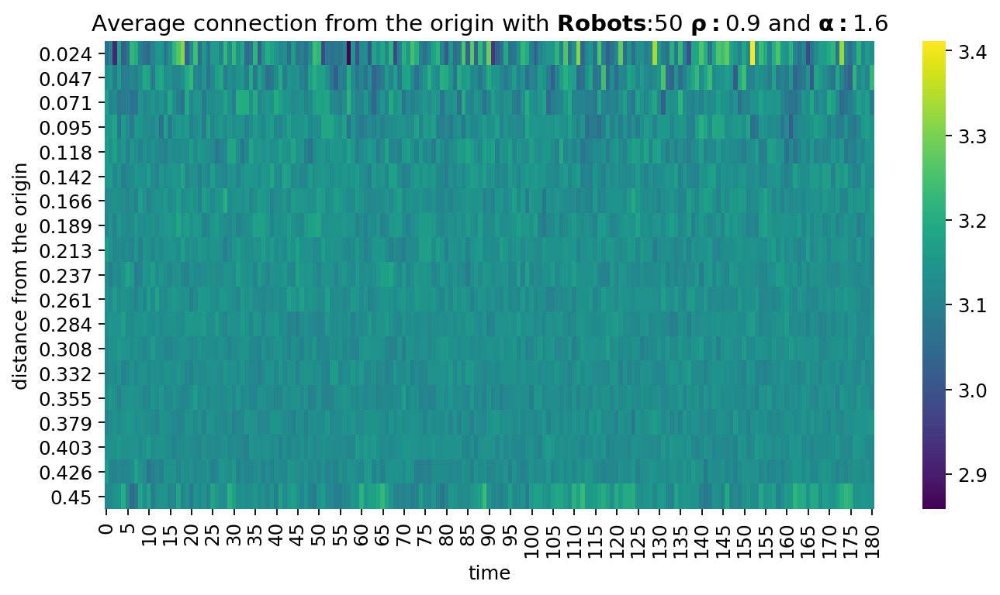

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#2.0_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_2.0.png


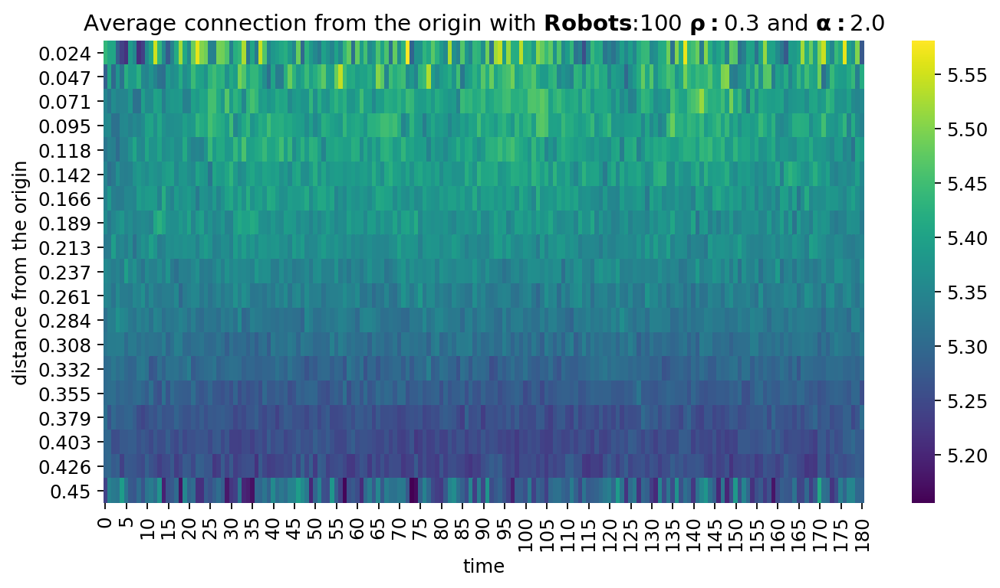

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.3_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.4.png


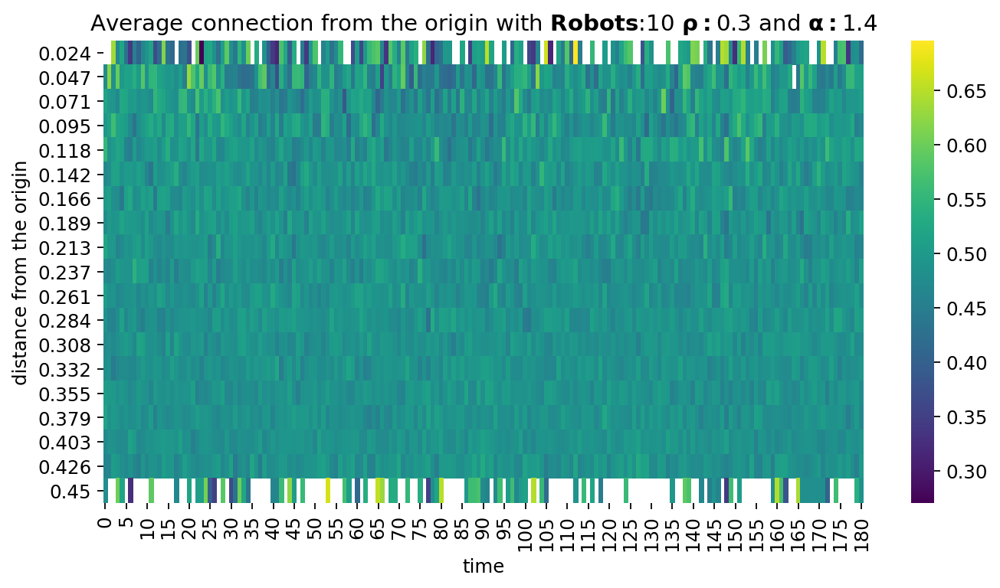

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.0_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.8.png


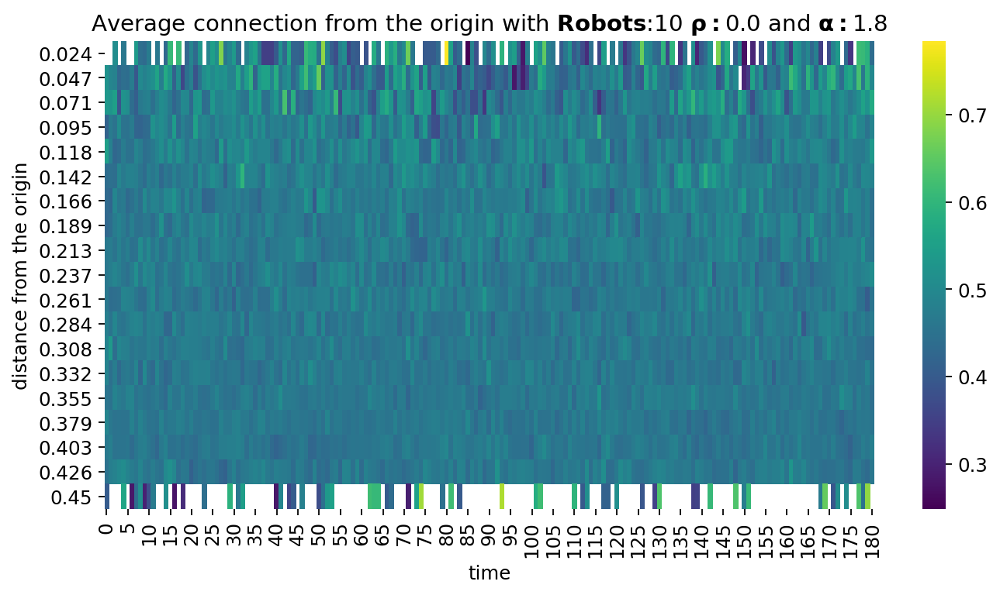

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.8.png


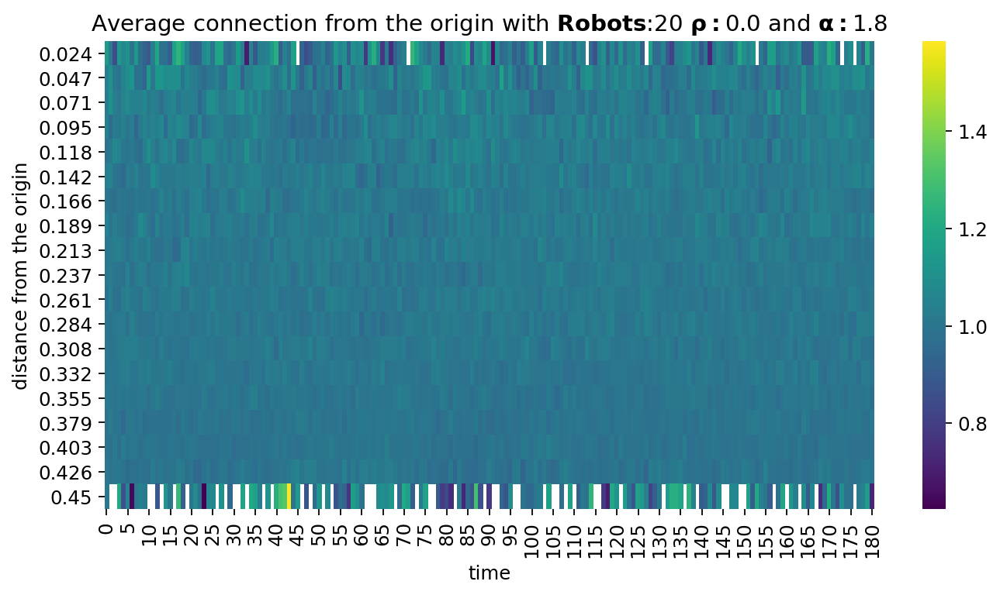

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.3_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.8.png


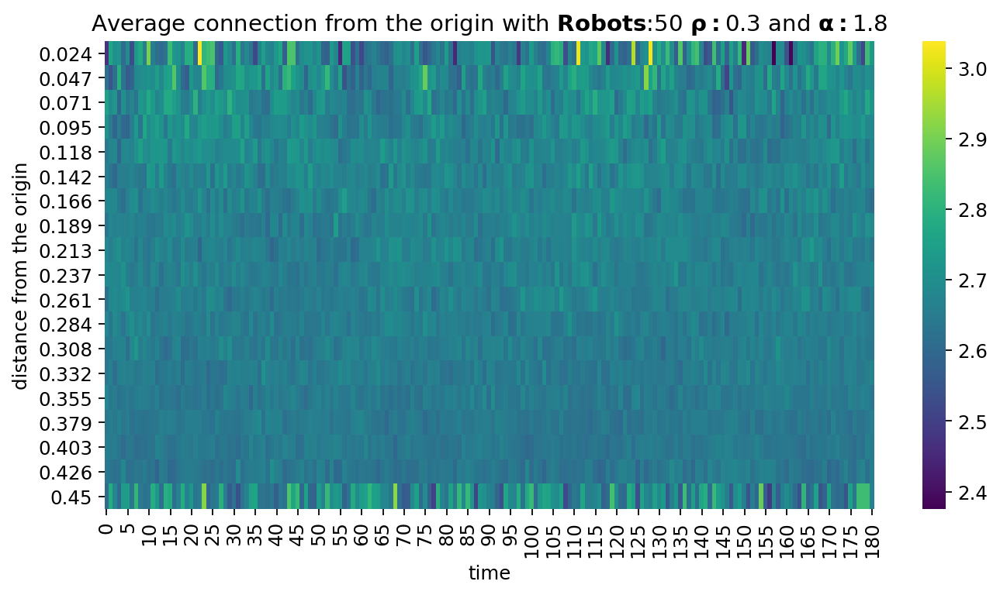

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.6_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.8.png


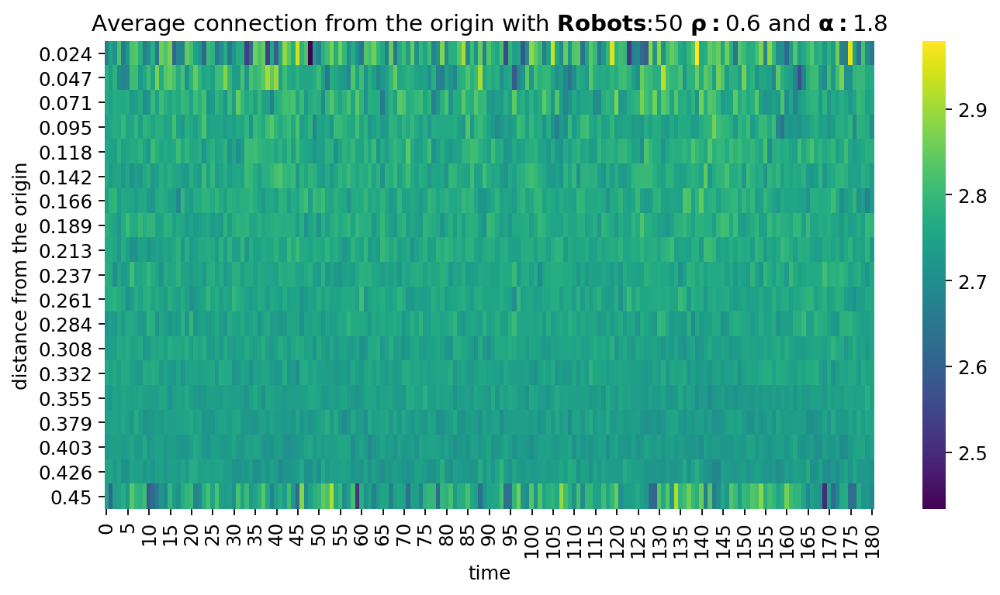

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.6_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.4.png


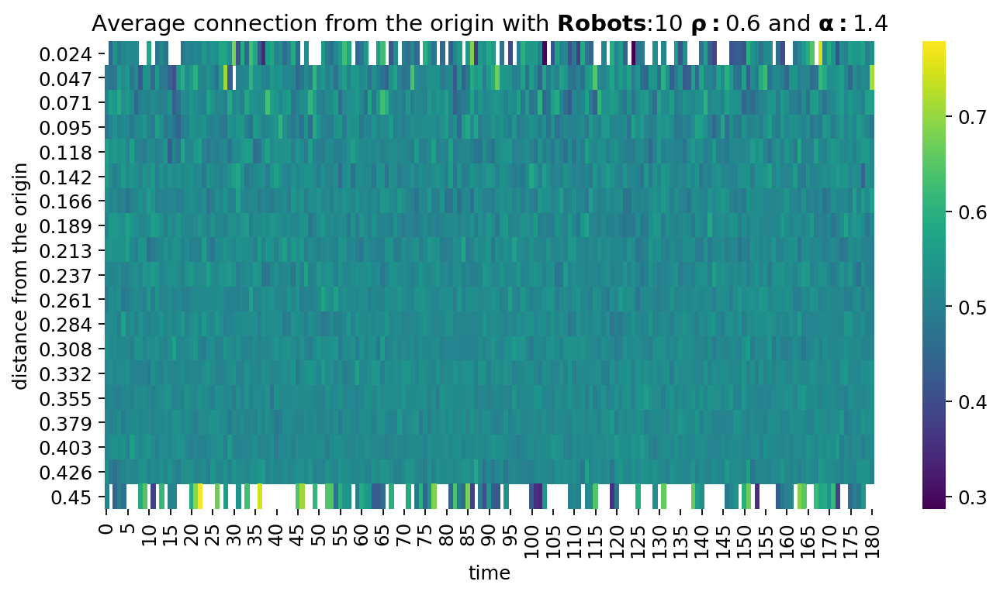

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.8.png


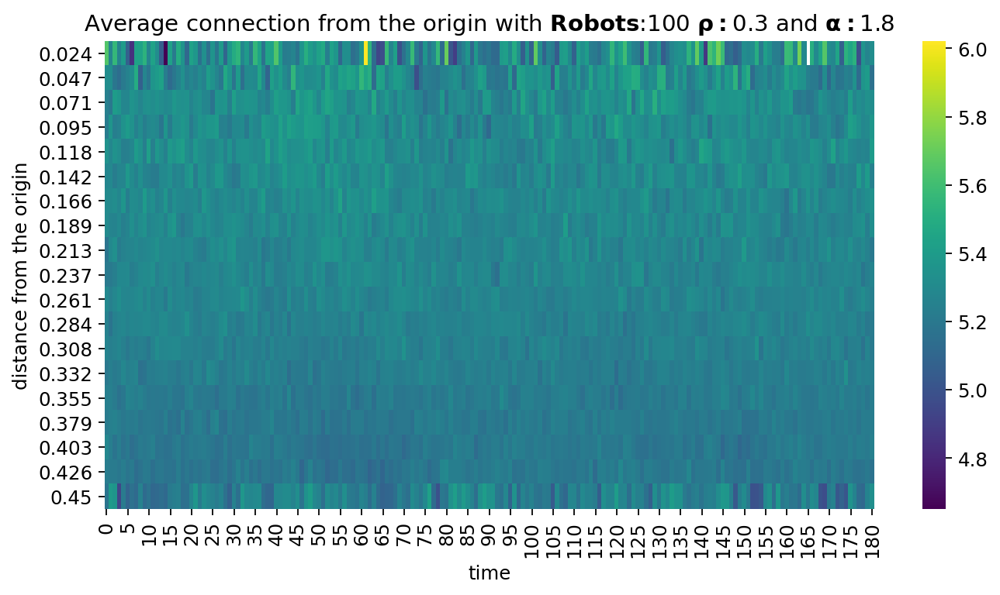

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.4.png


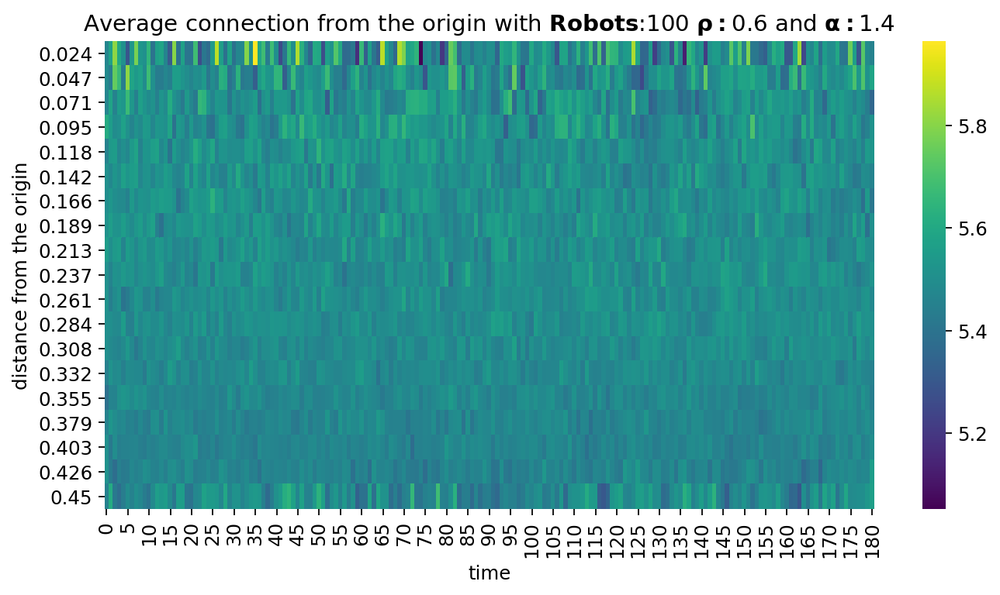

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.4.png


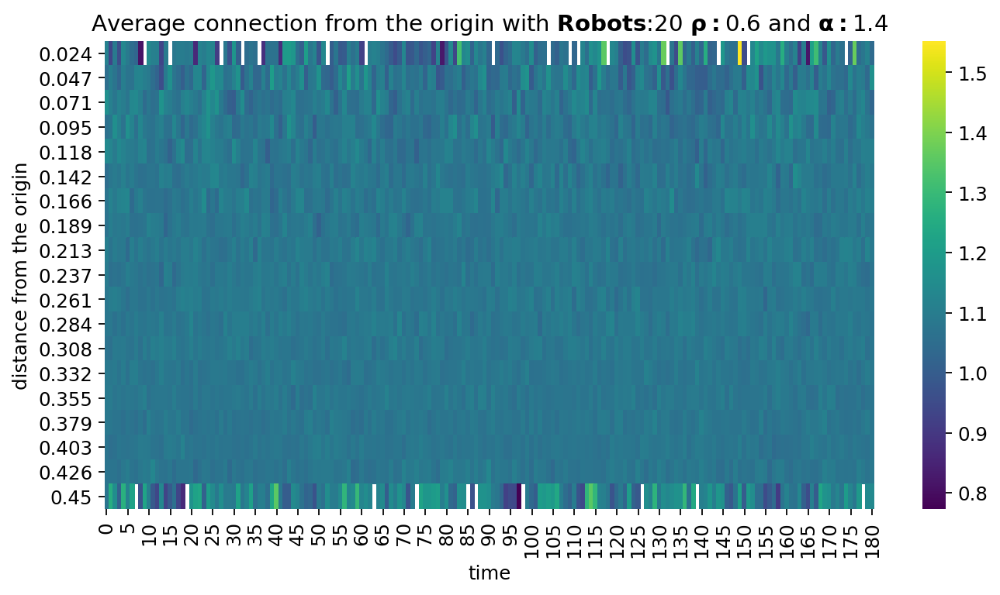

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.9_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.8.png


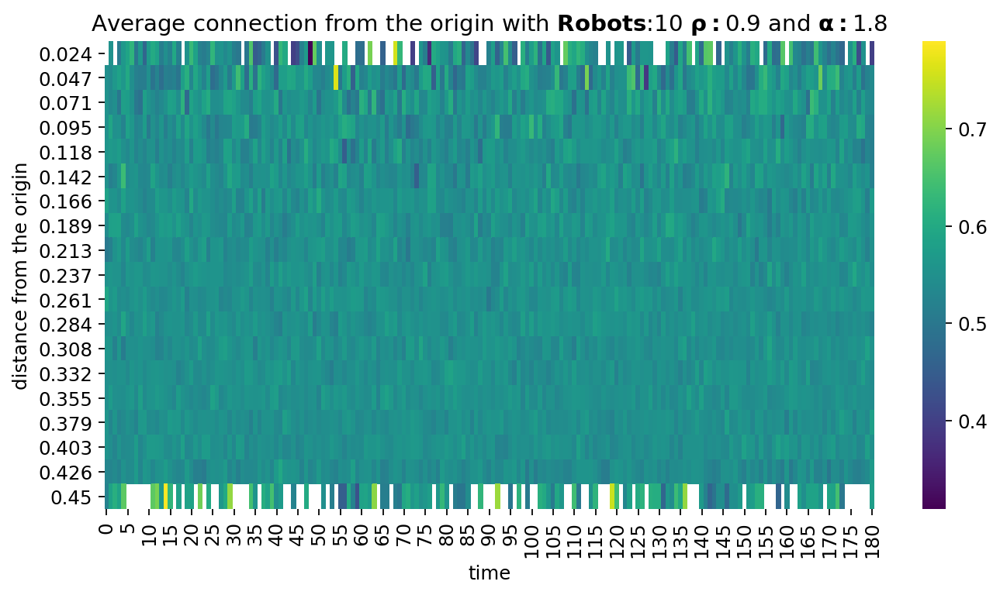

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.6_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.6.png


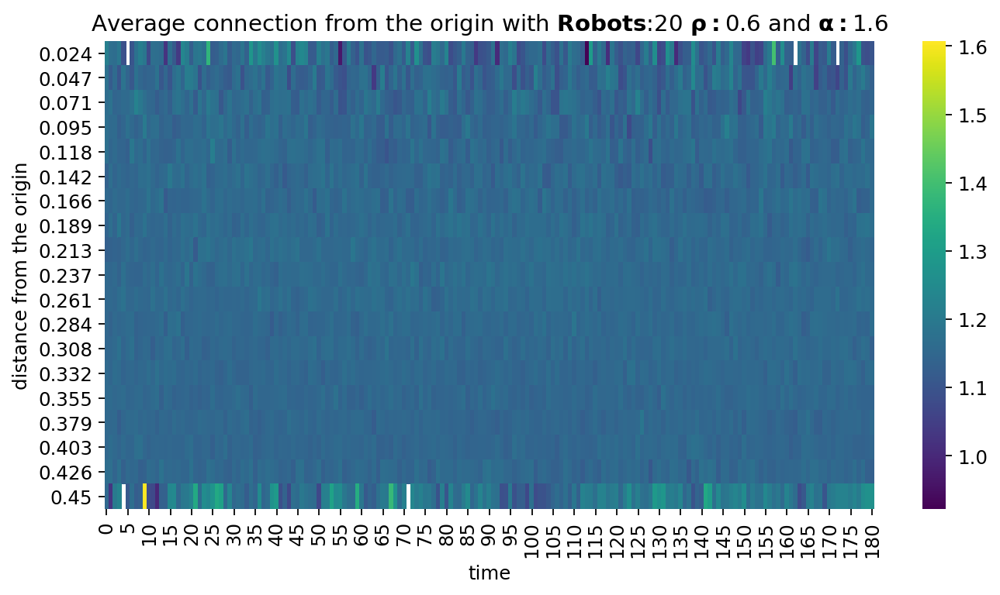

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.6_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.6.png


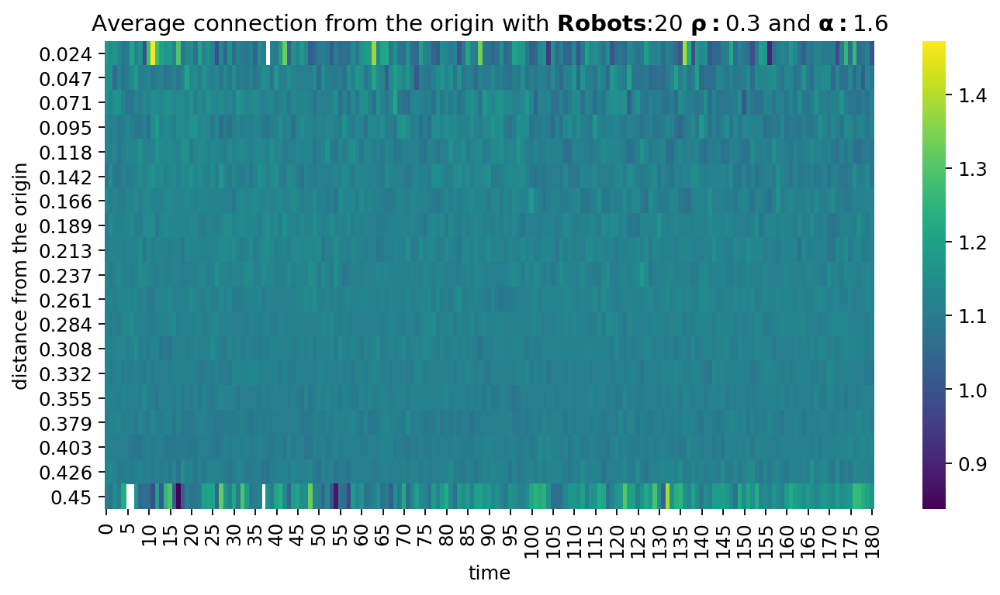

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.6_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.6.png


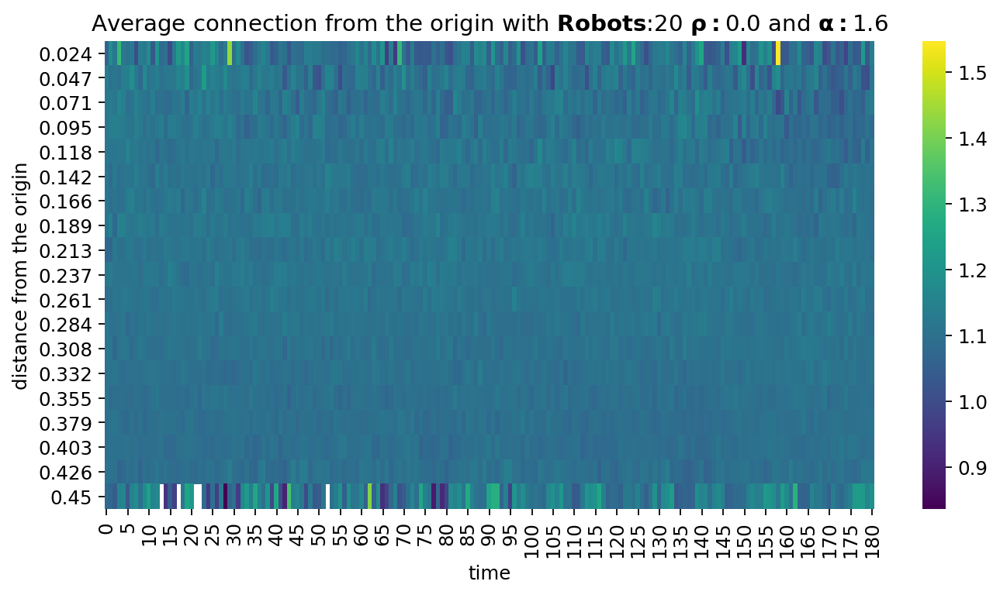

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.8.png


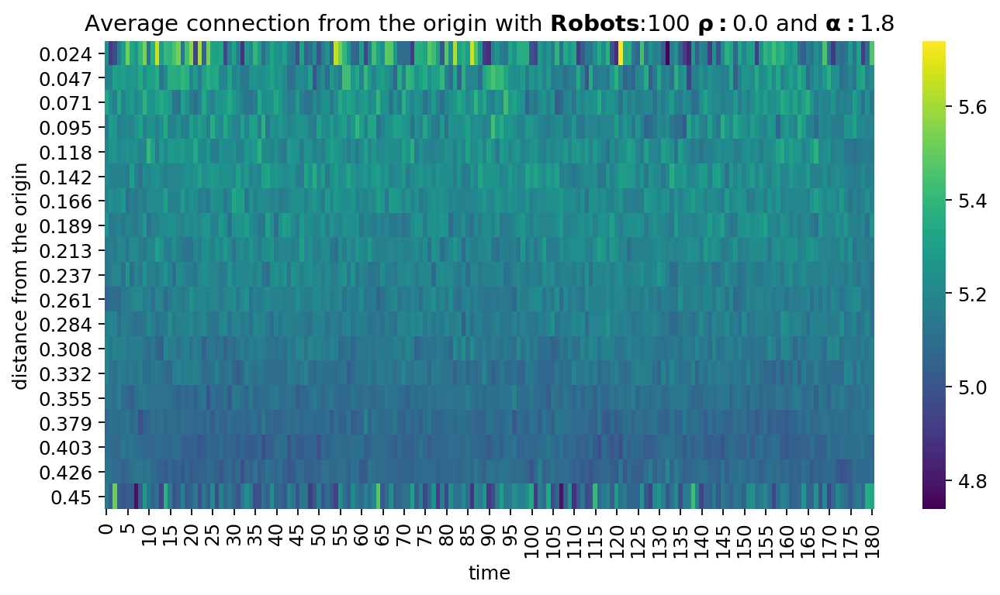

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.4.png


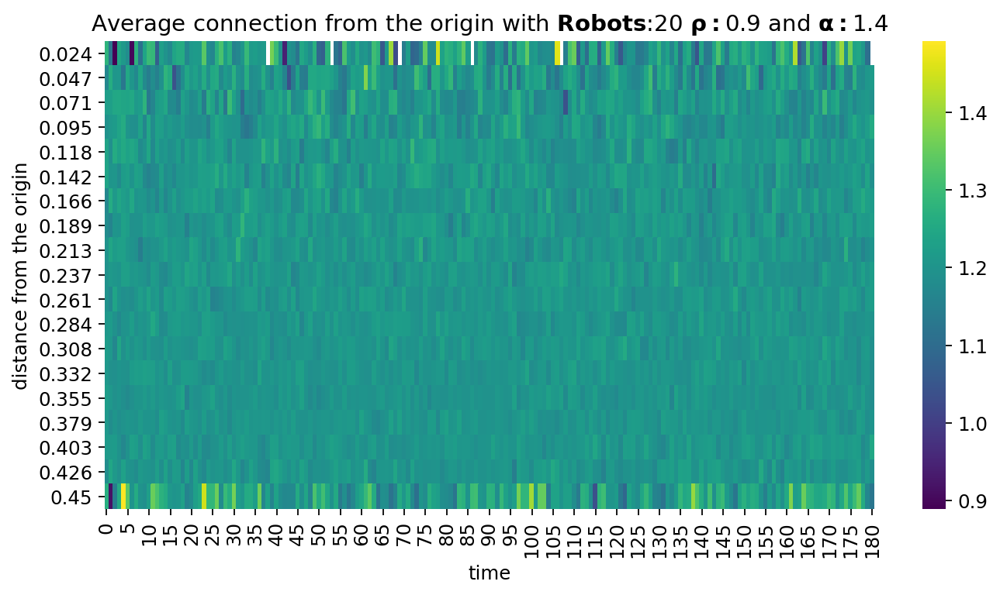

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.6_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.6.png


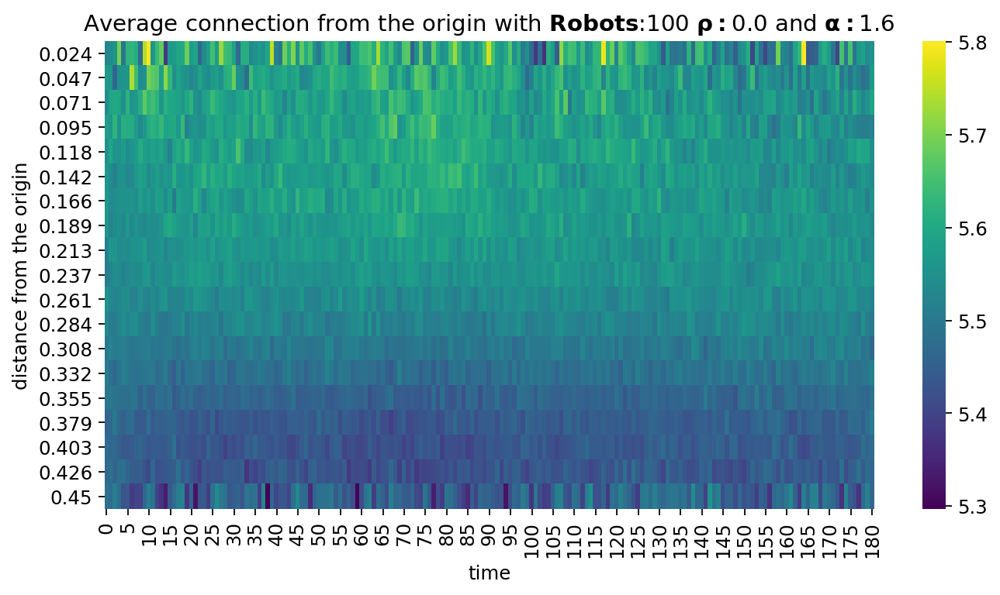

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.2_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.2.png


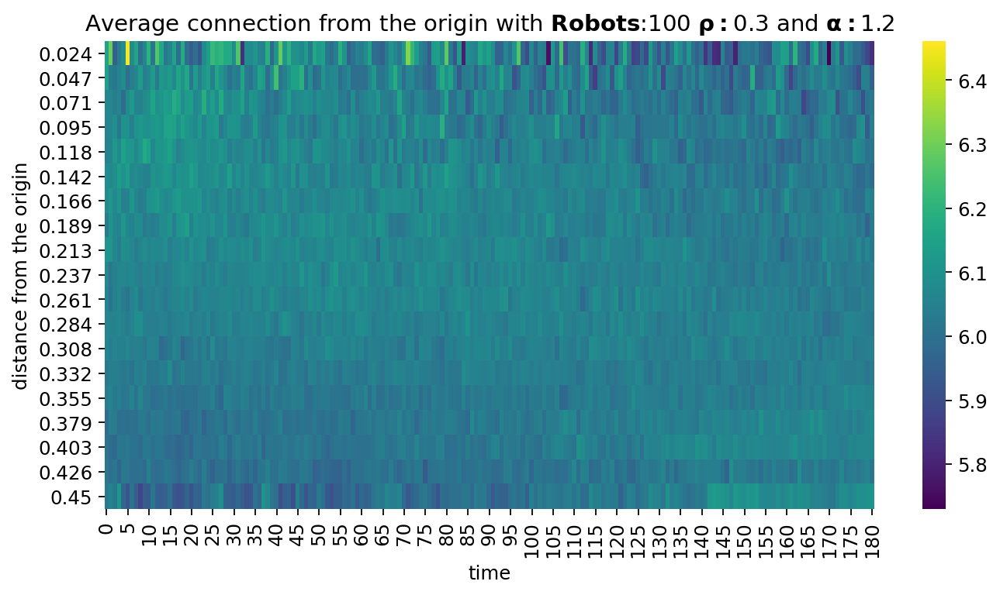

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#2.0_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_2.0.png


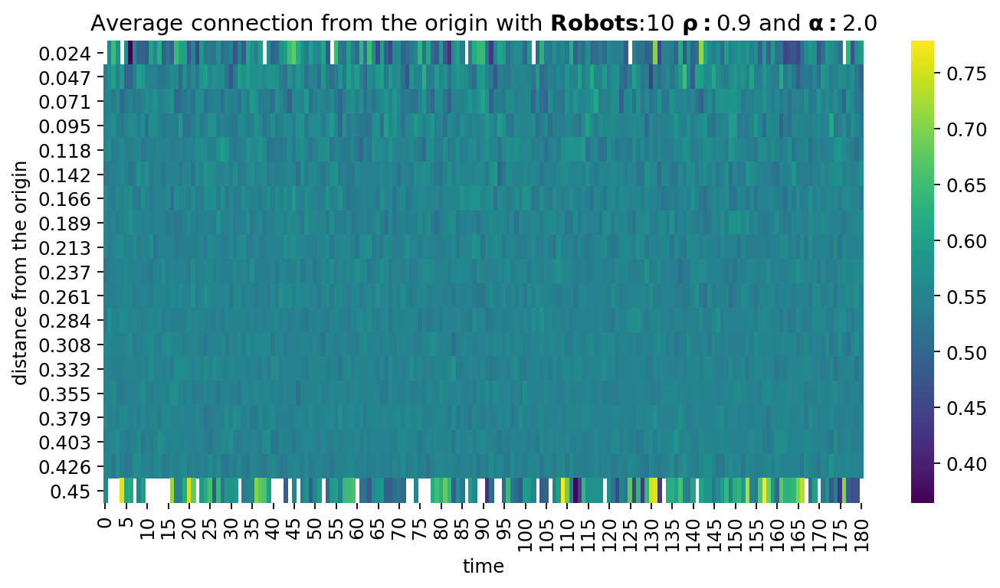

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#2.0_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_2.0.png


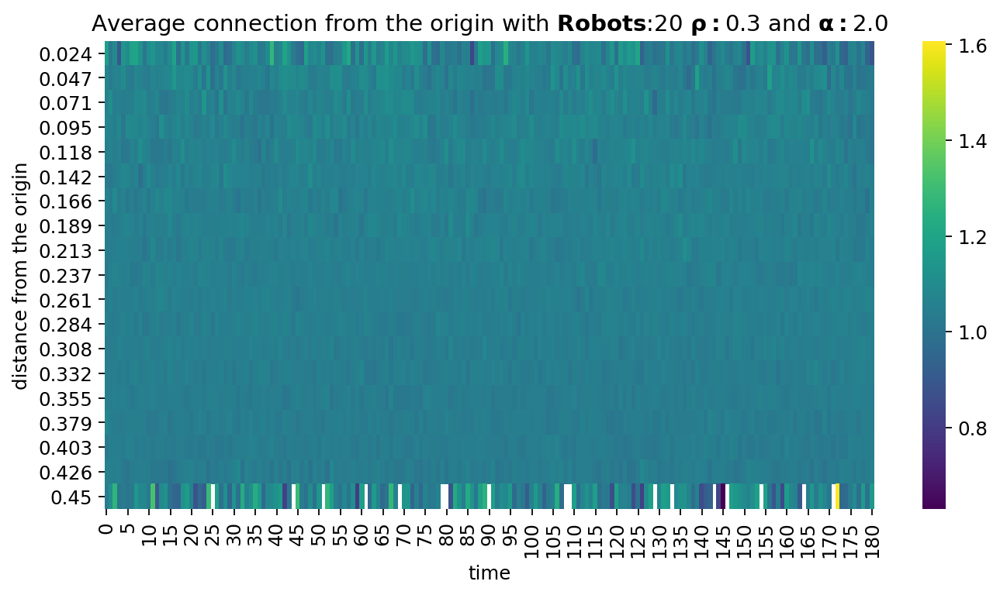

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#2.0_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_2.0.png


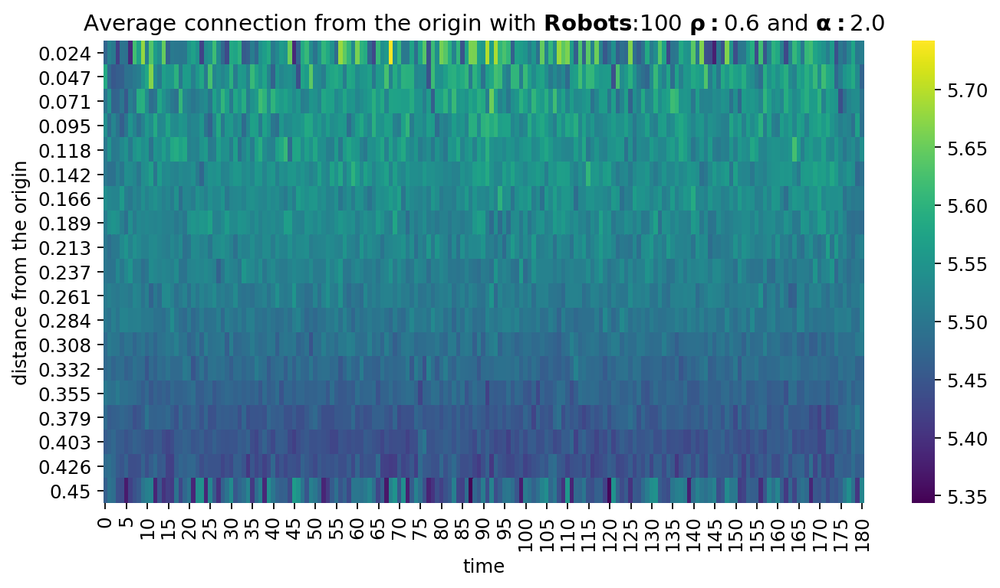

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.0_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.4.png


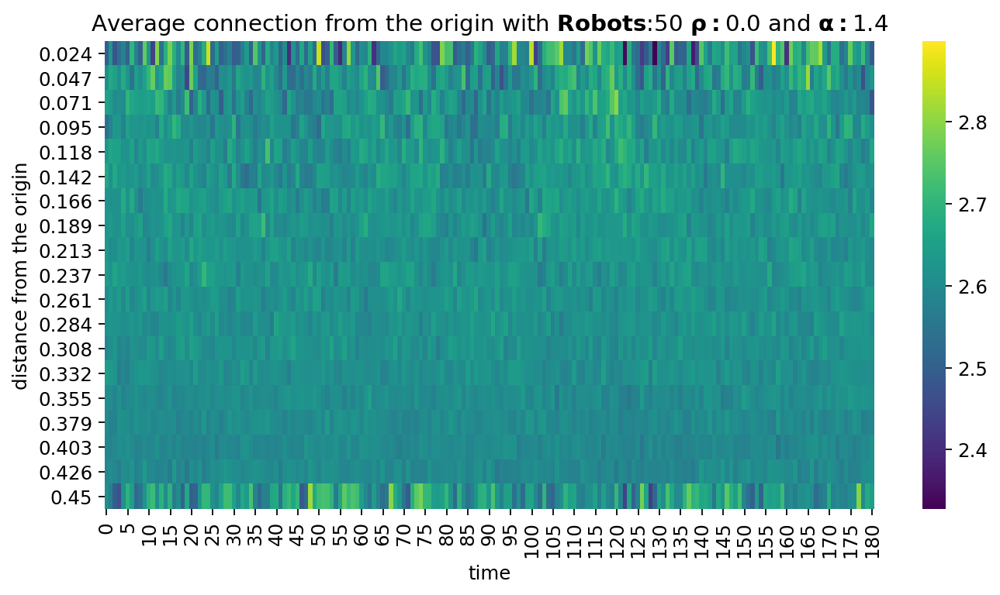

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#1.6_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.6.png


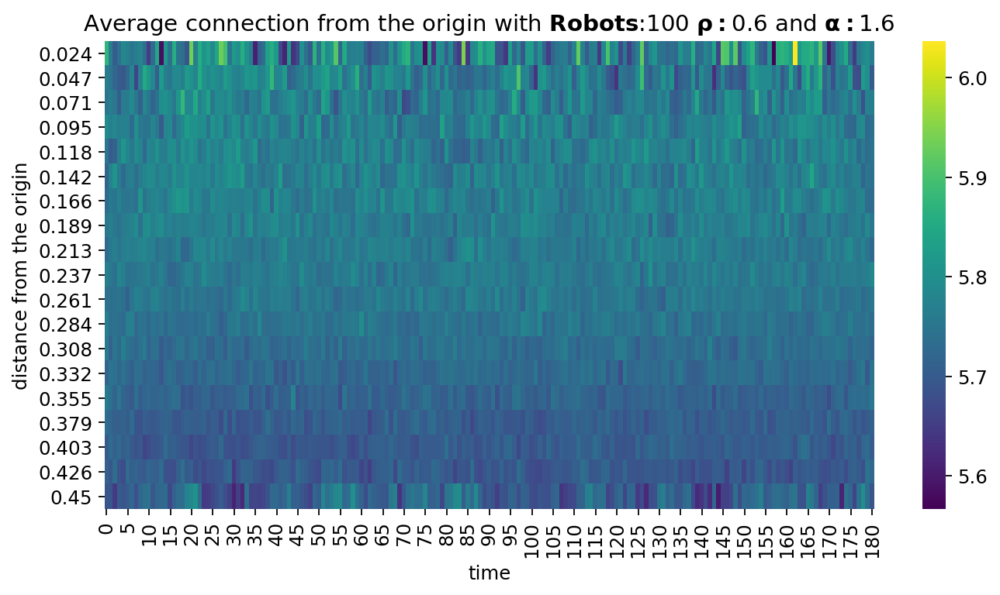

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.6_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.6.png


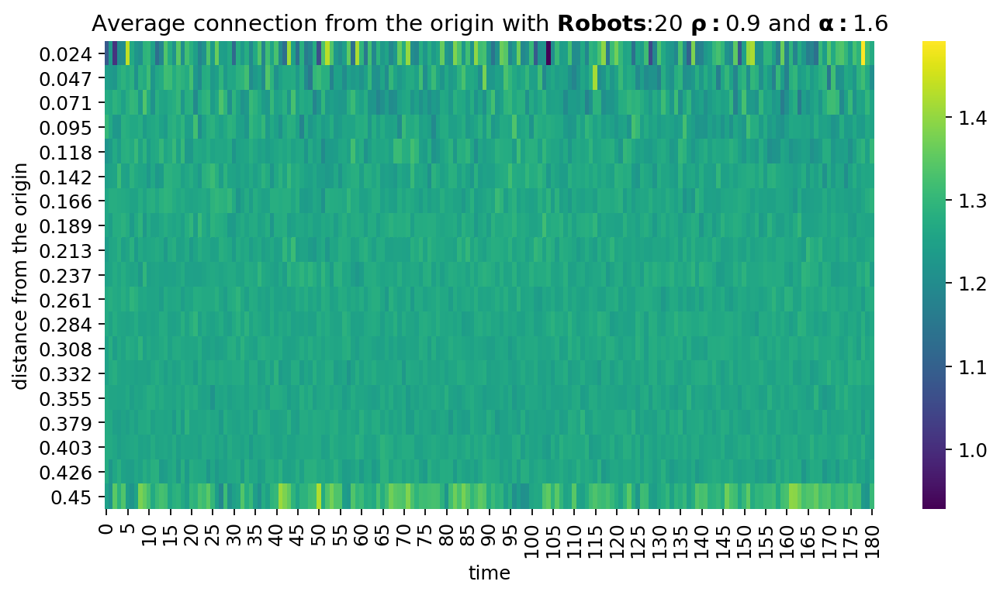

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.6_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.4.png


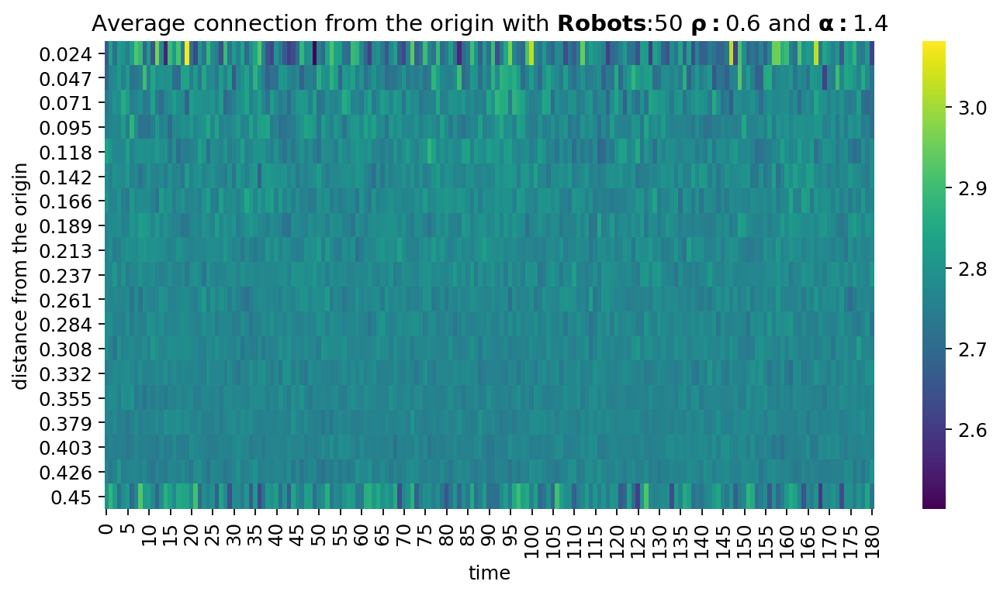

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.2_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.2.png


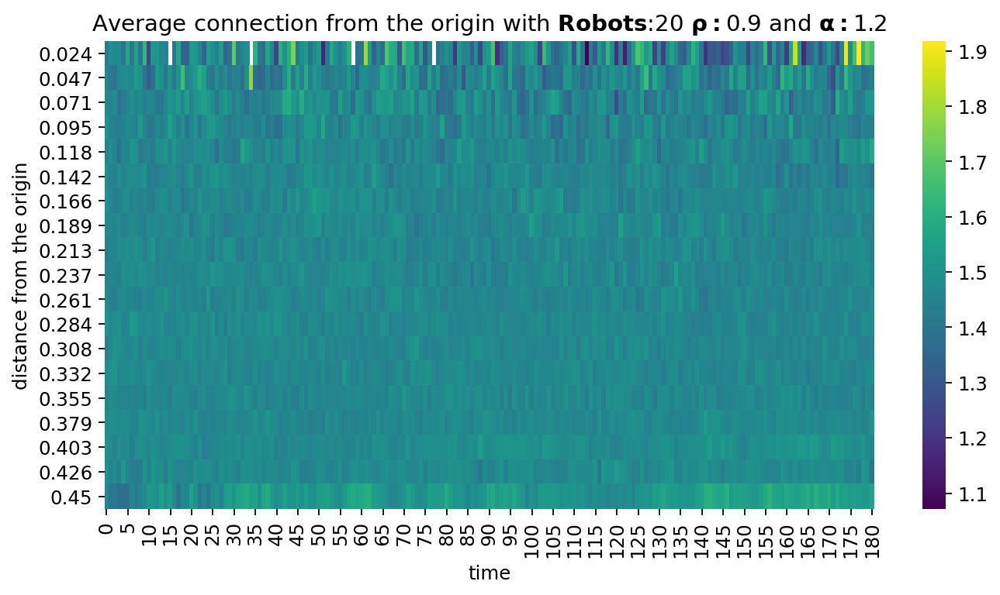

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#100_alpha#2.0_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_2.0.png


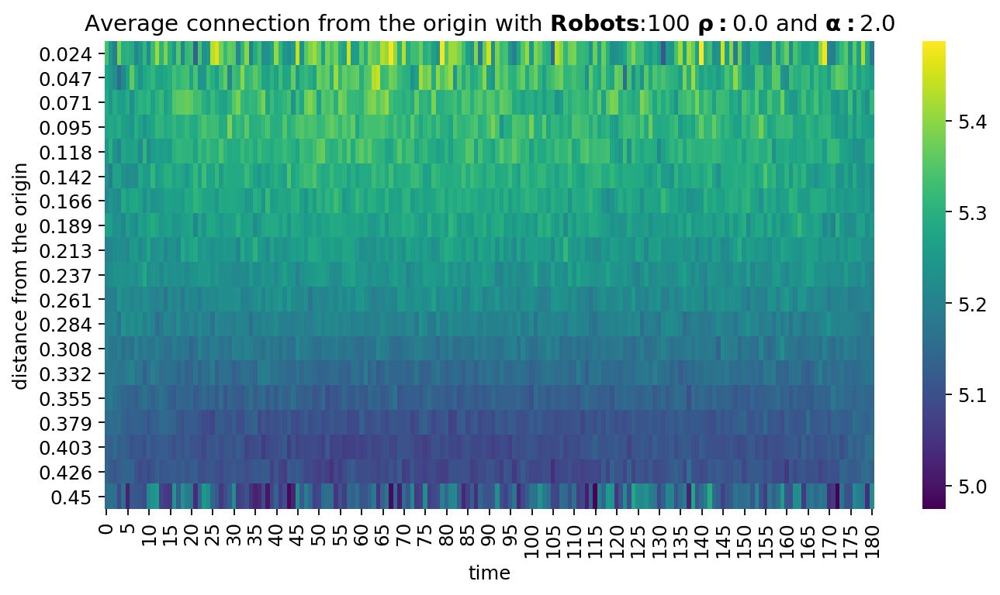

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.9_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.4.png


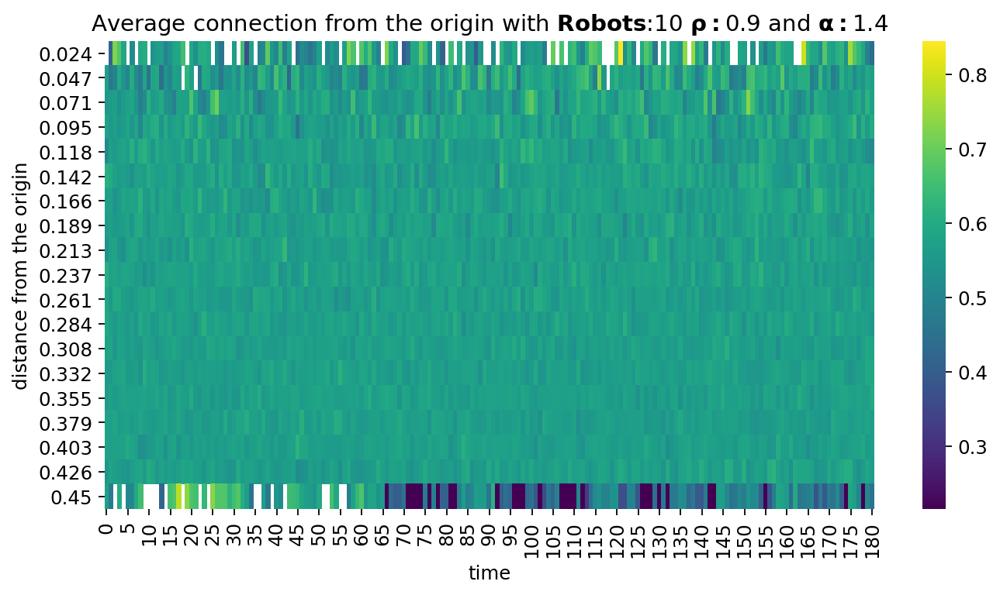

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#2.0_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_2.0.png


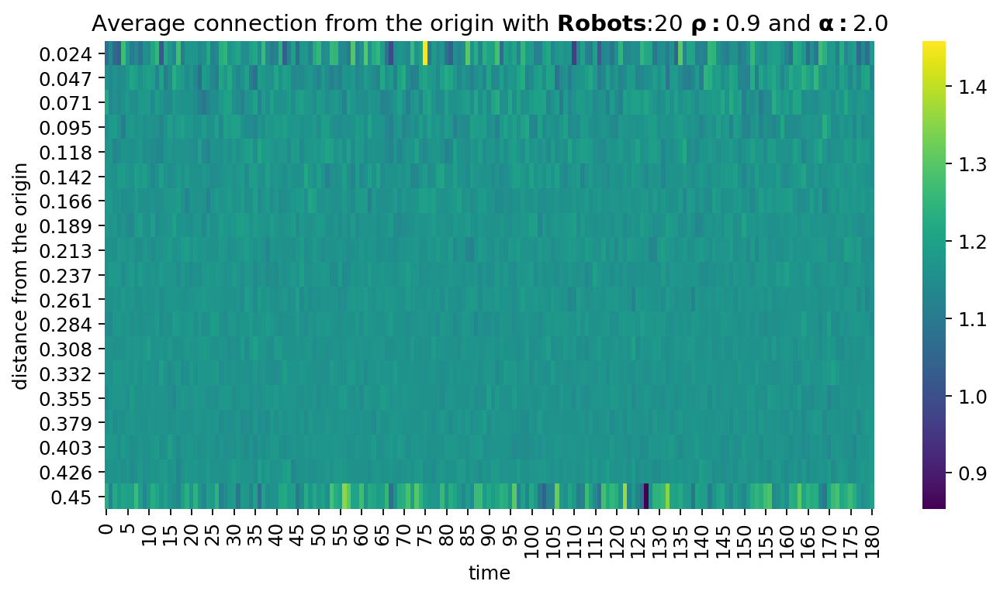

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#2.0_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_2.0.png


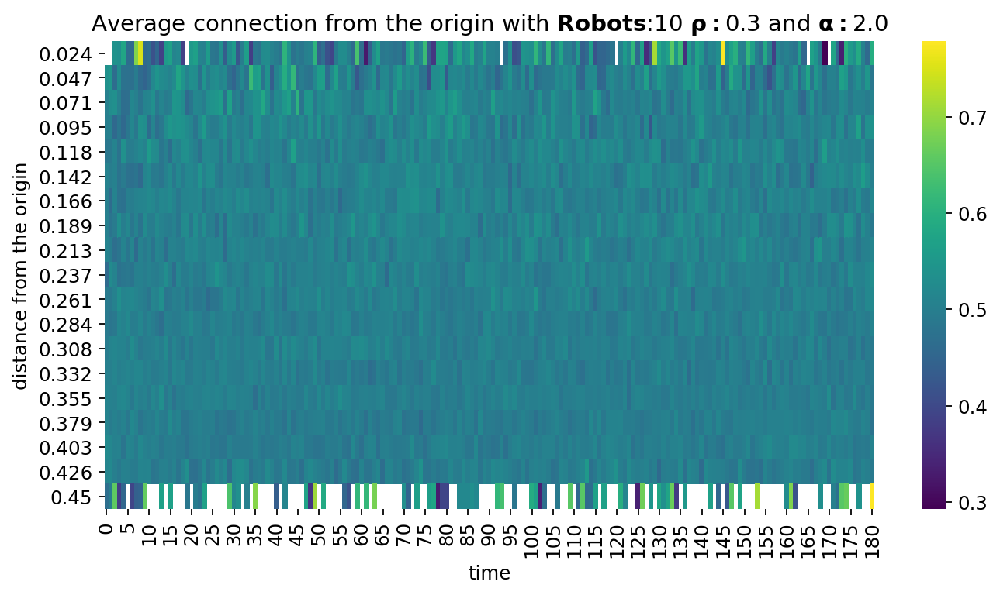

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.6_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.6.png


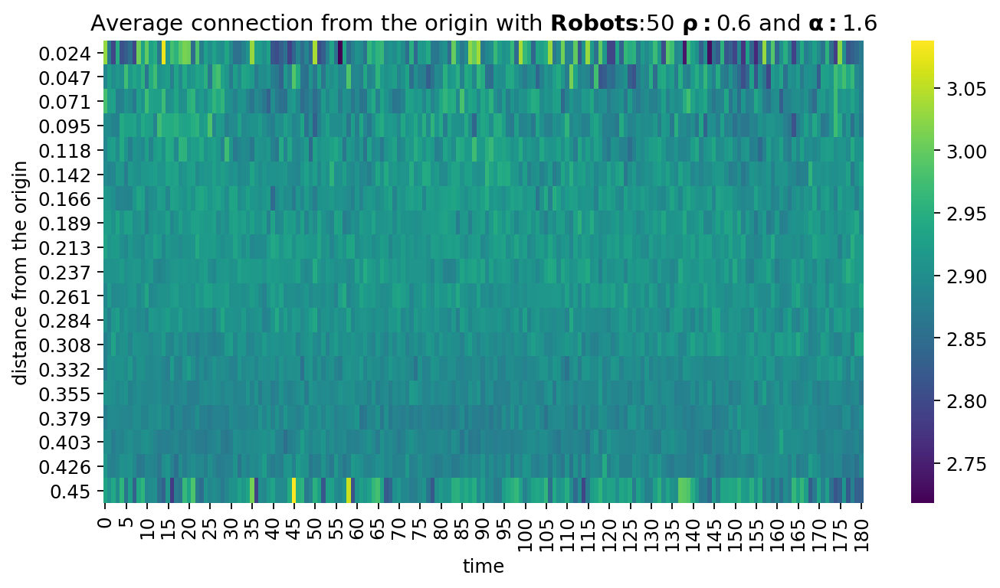

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#1.2_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.2.png


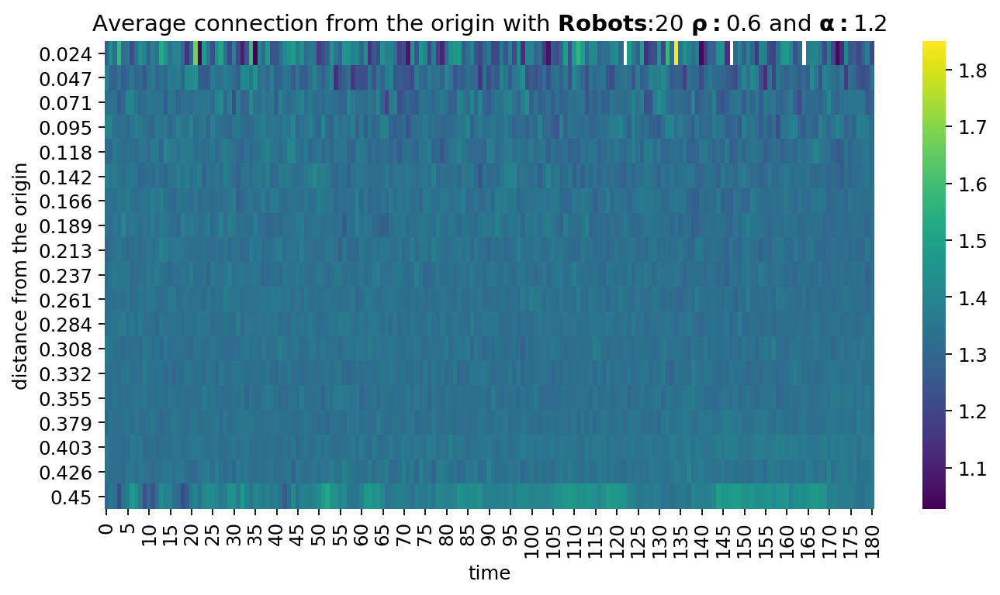

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.3_1800
(2500, 181)
	 df_values.shape: (2500, 181, 2)
distances shape (181, 2500)
origin_distance.shape (2500, 181)
origin_distance.T.shape (181, 2500)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.4.png


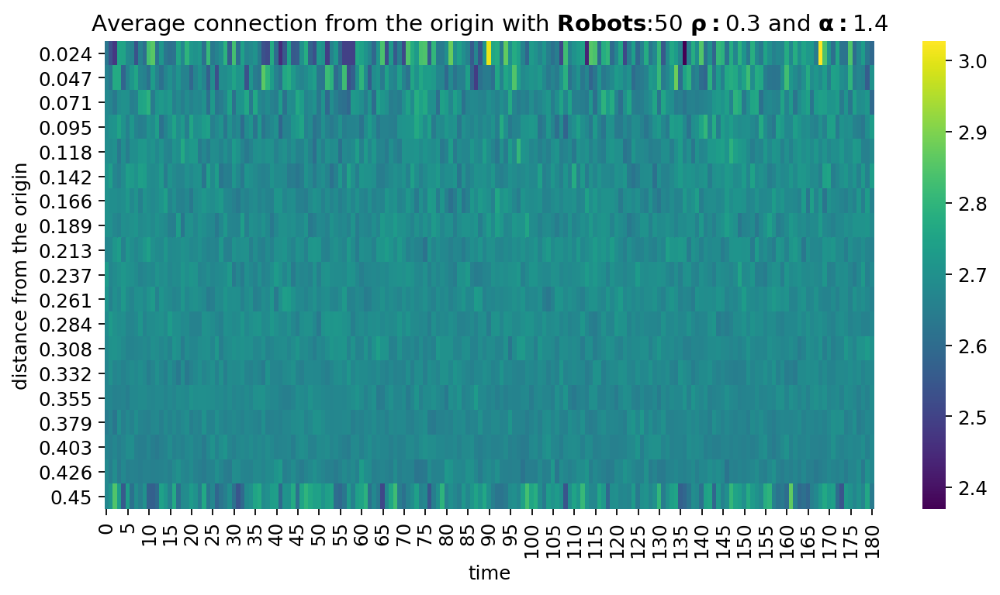

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.6_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.6.png


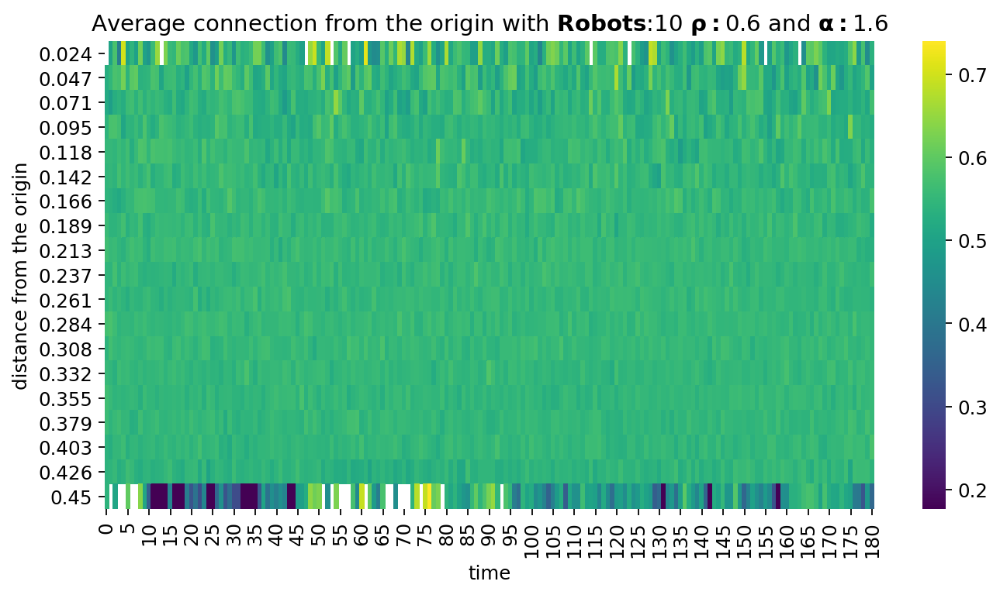

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.8.png


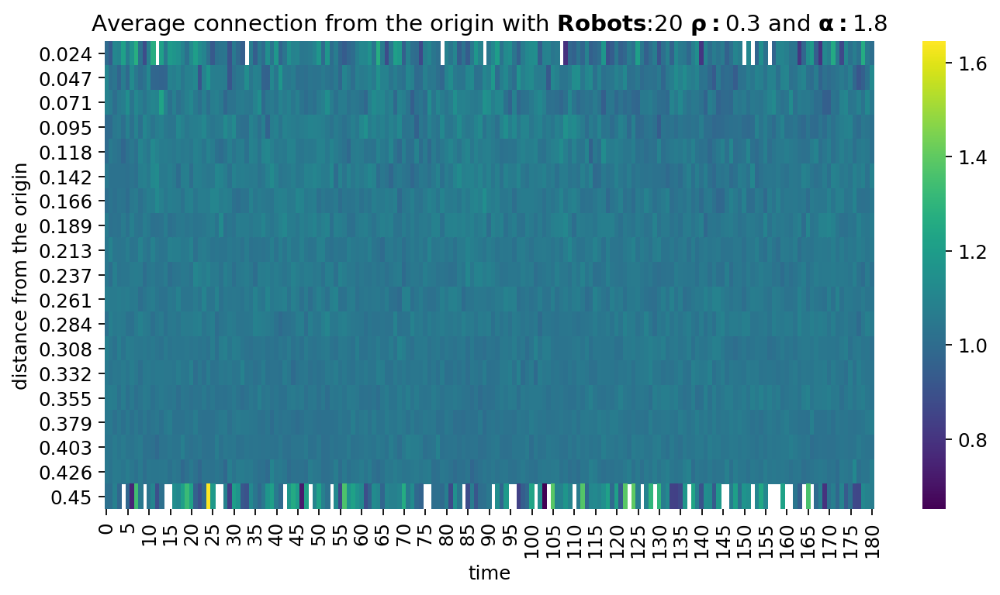

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#2.0_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_2.0.png


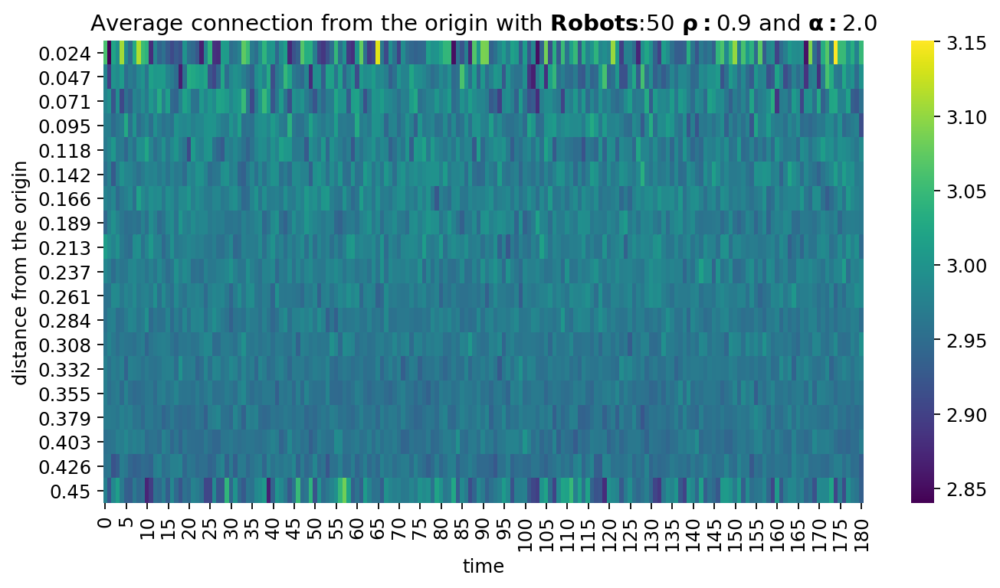

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#10_alpha#1.6_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.6.png


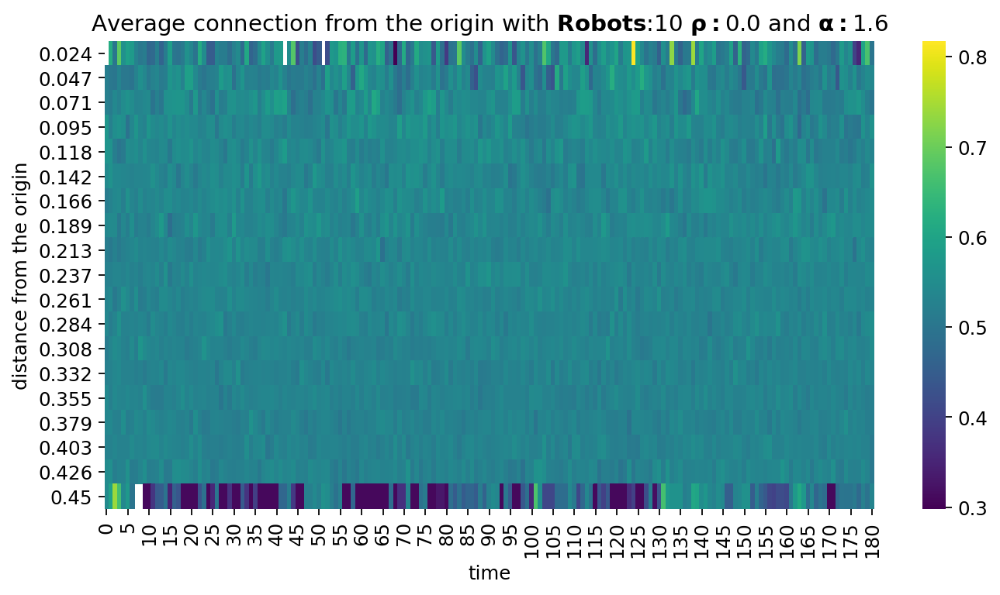

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#20_alpha#2.0_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_2.0.png


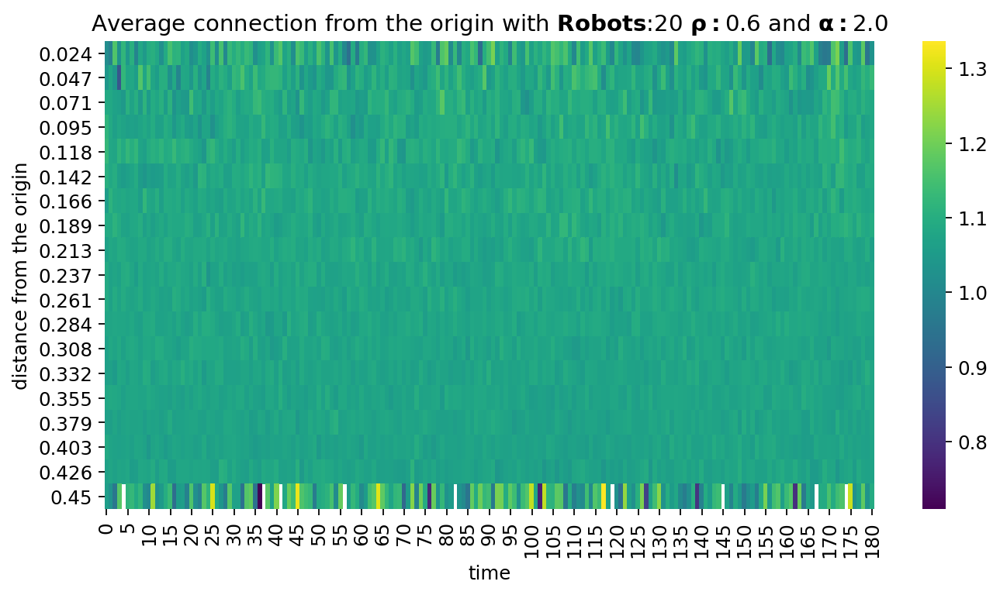

results/ALL/Simulated/bouncing_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.6_1800
(500, 181)
	 df_values.shape: (500, 181, 2)
distances shape (181, 500)
origin_distance.shape (500, 181)
origin_distance.T.shape (181, 500)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.8.png


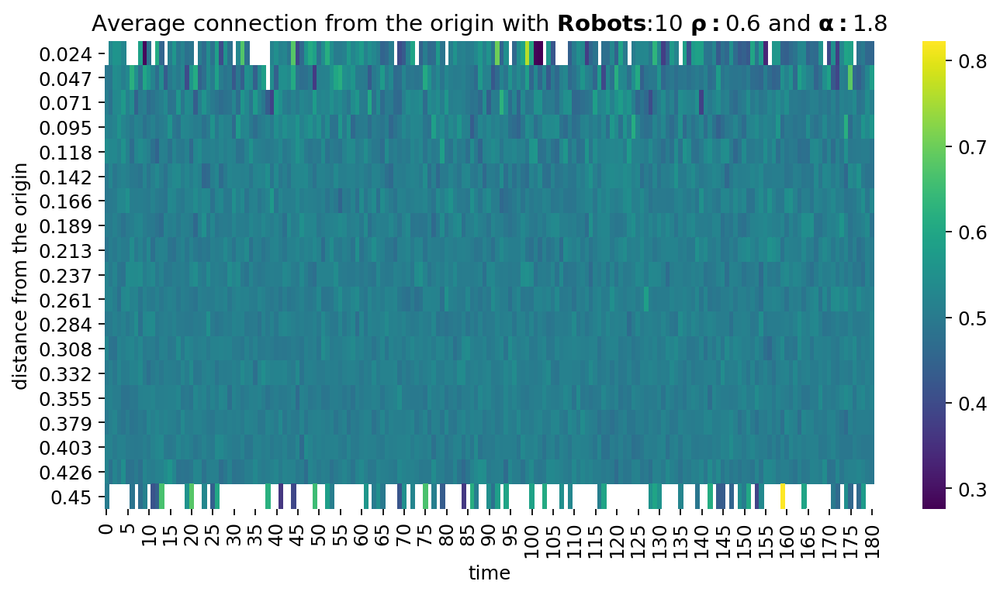

results/ALL/Simulated/bouncing_angle_100_runs/2020-07-01_robots#50_alpha#1.6_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.6.png


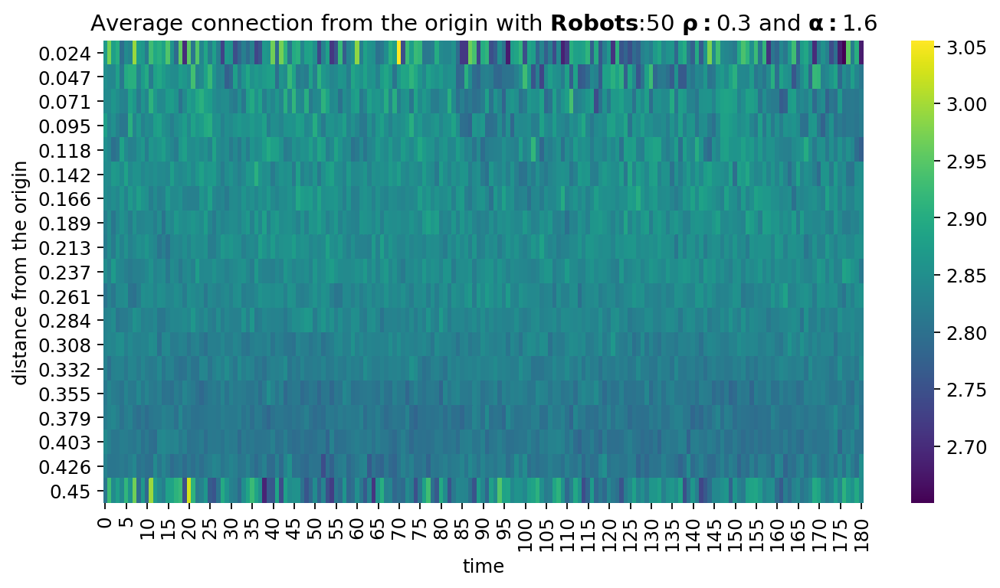

In [35]:
bin_edges = np.linspace(0, 0.45, 20)
bouncingAngle_folder = 'results/ALL/Simulated/bouncing_angle_100_runs'
avg_connection_degree_heatmap(bouncingAngle_folder)

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#2.0_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_2.0.png


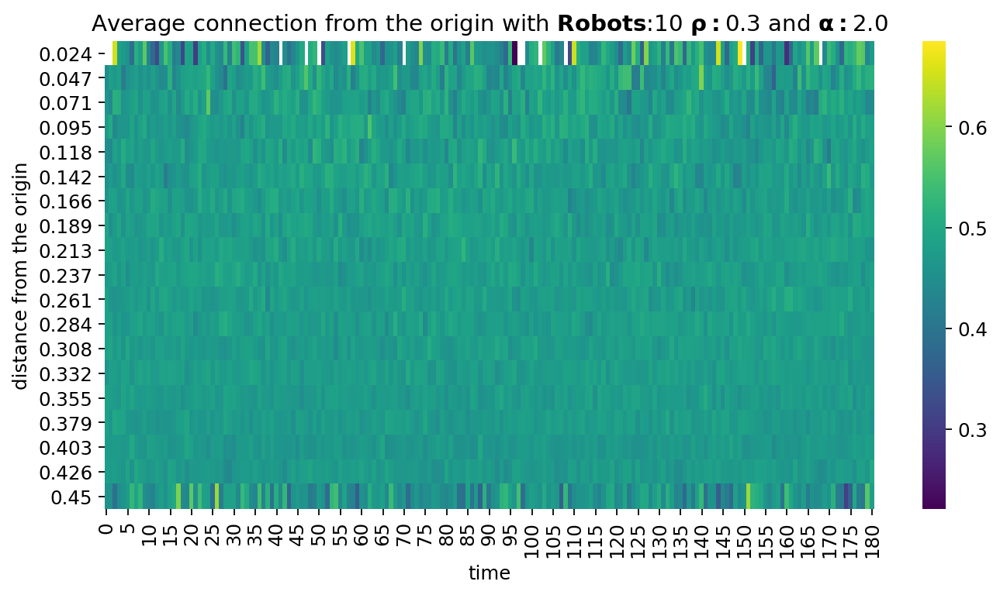

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.2_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.2.png


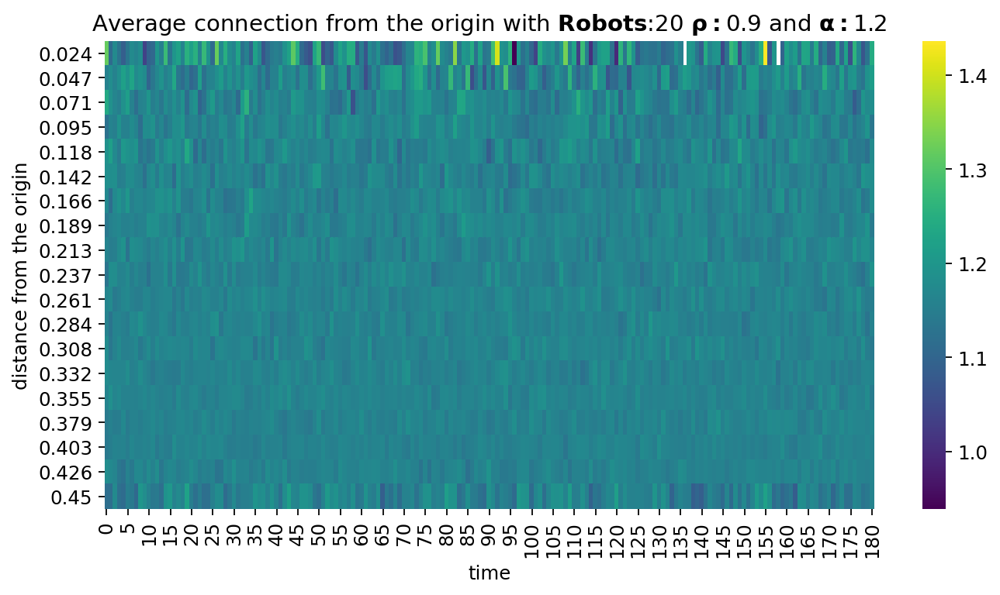

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.4.png


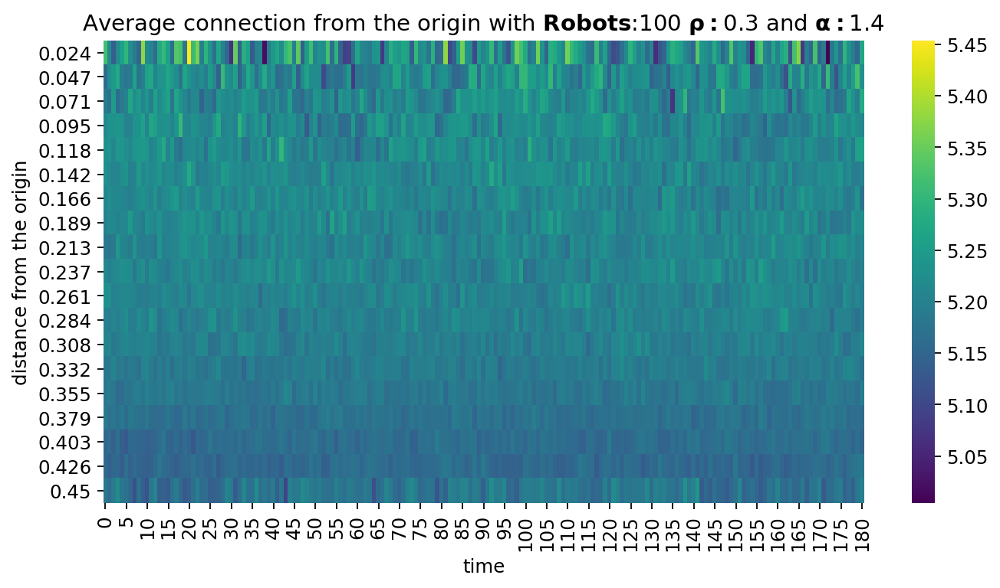

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.4.png


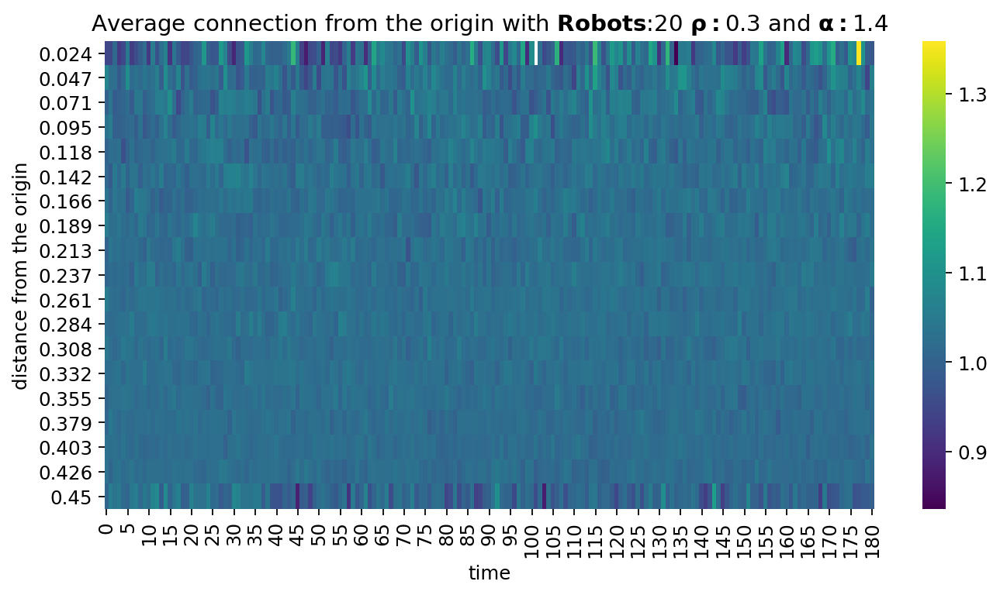

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.2_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.2.png


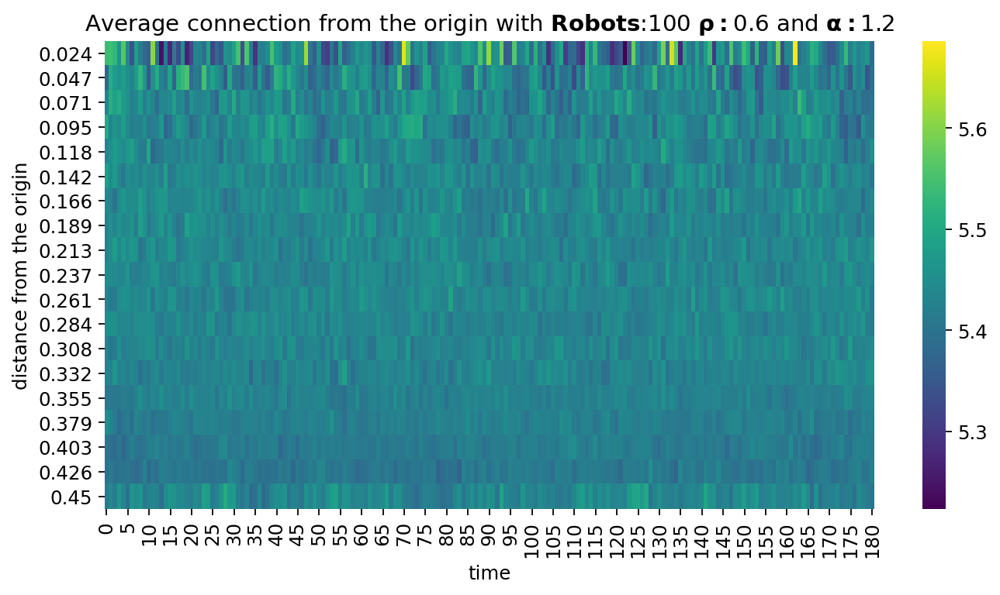

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.8.png


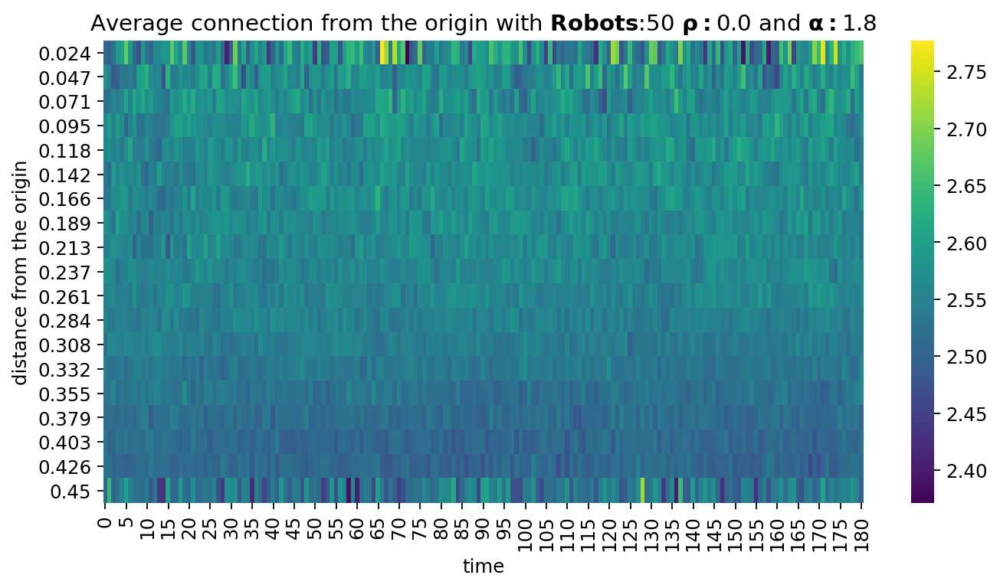

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.8.png


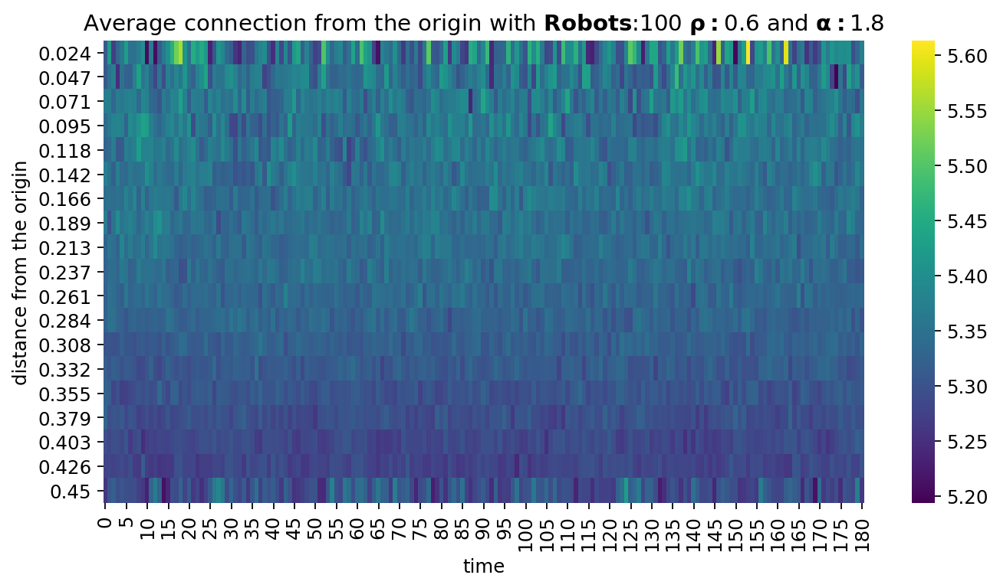

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.2_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.2.png


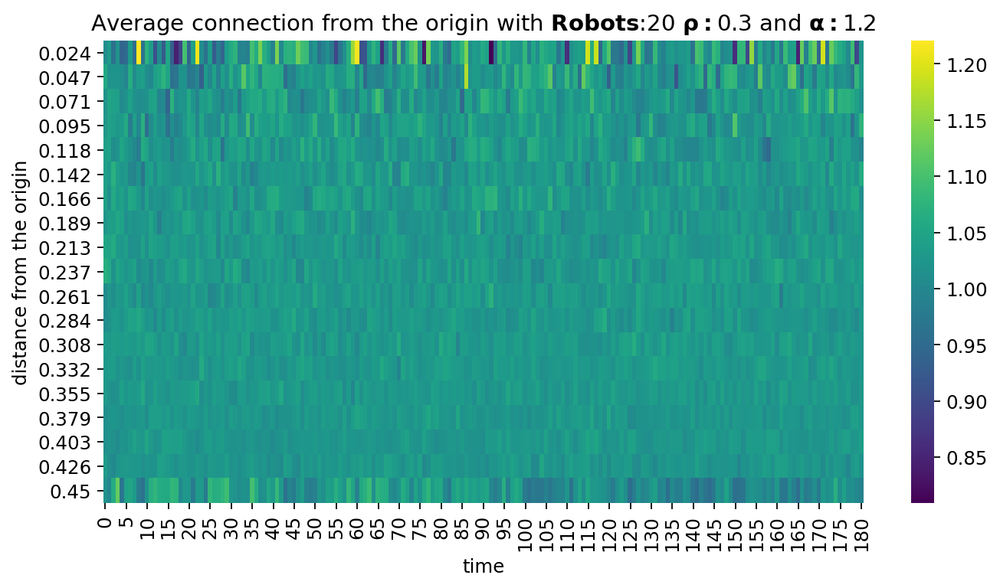

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#2.0_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_2.0.png


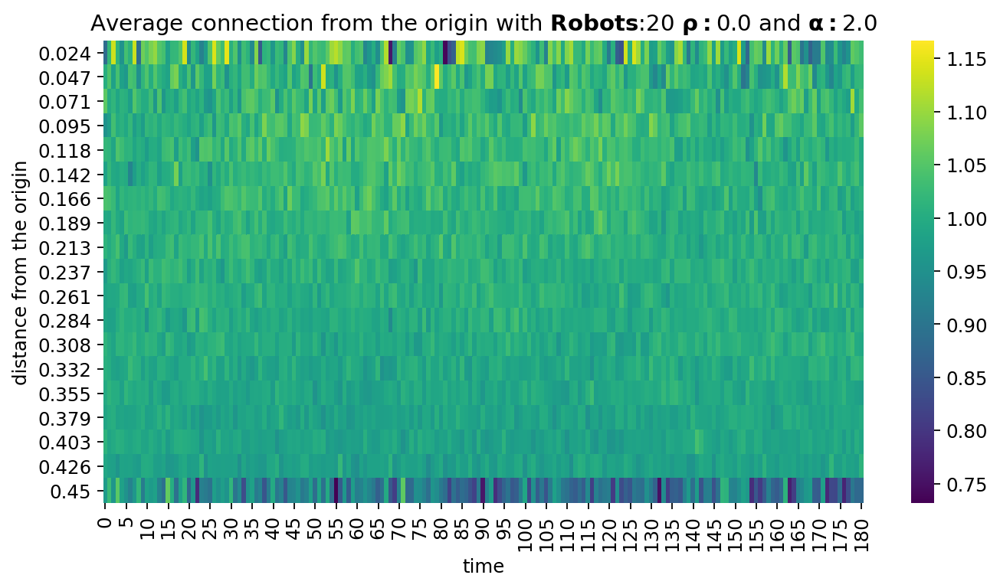

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.2_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.2.png


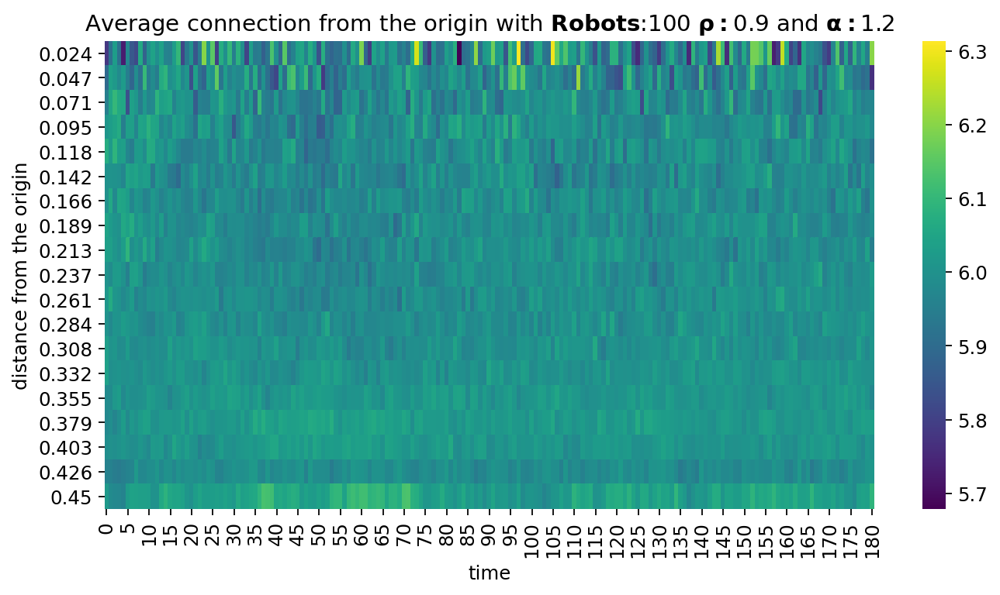

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.2_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.2.png


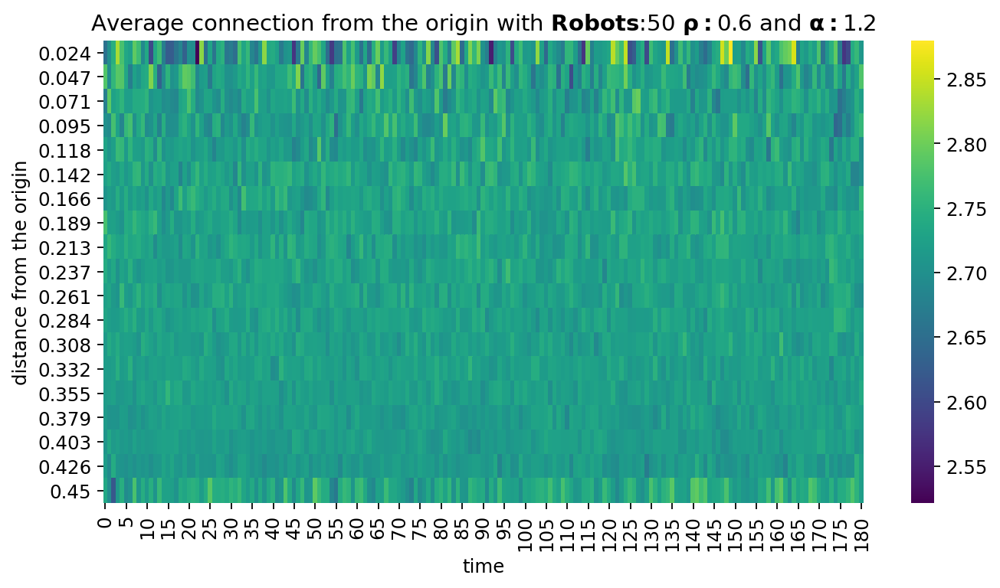

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.6_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.6.png


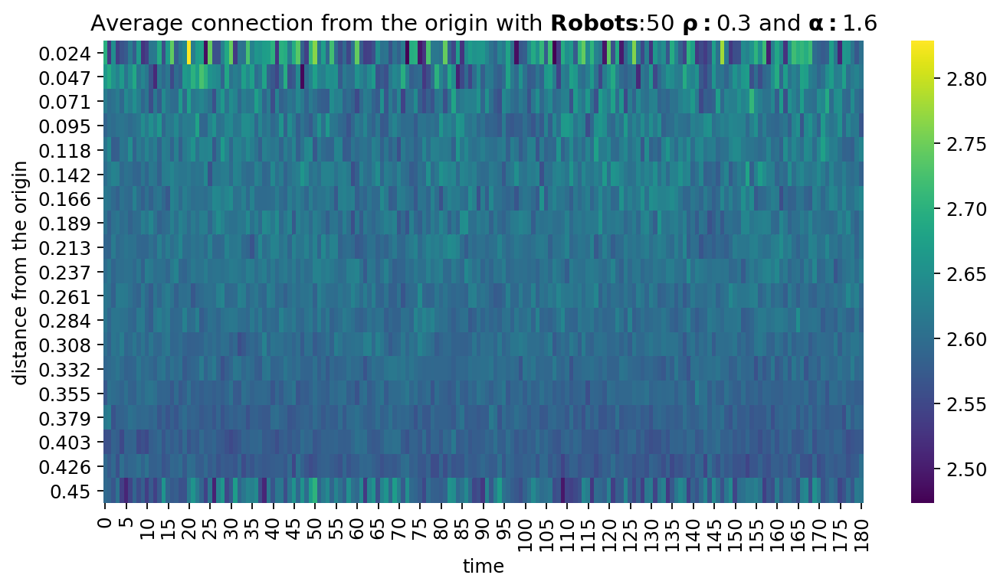

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.2_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.2.png


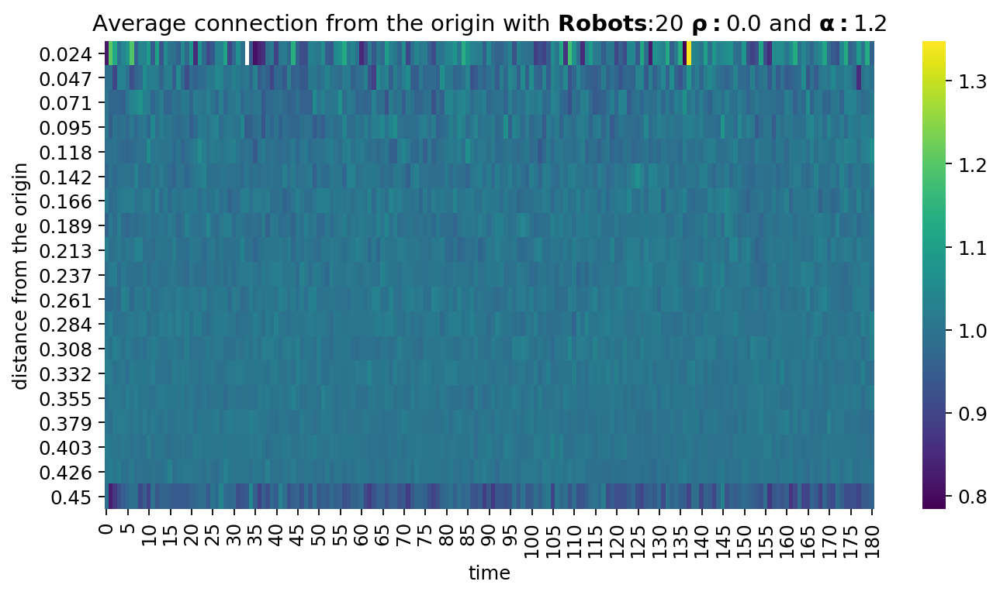

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#2.0_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_2.0.png


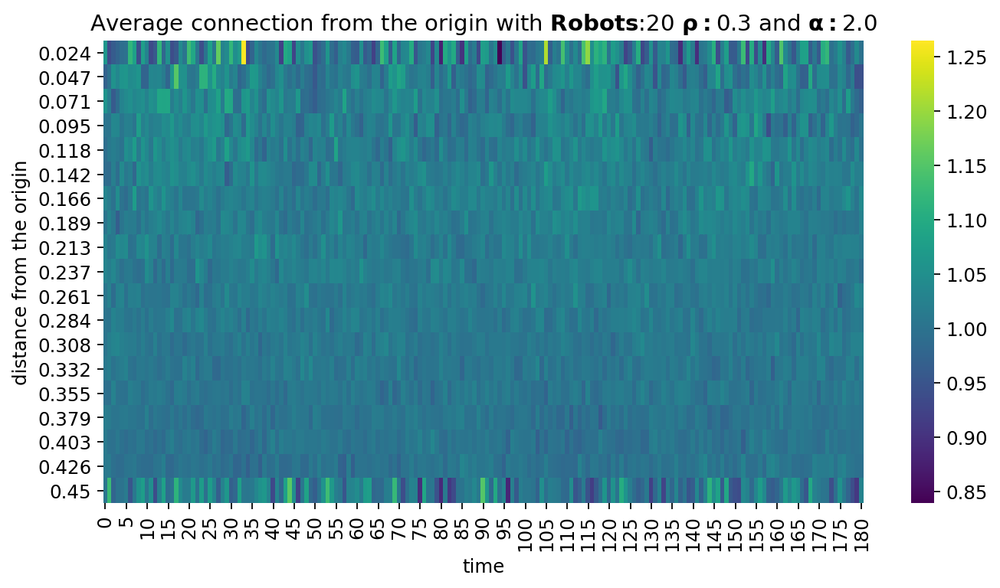

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.4.png


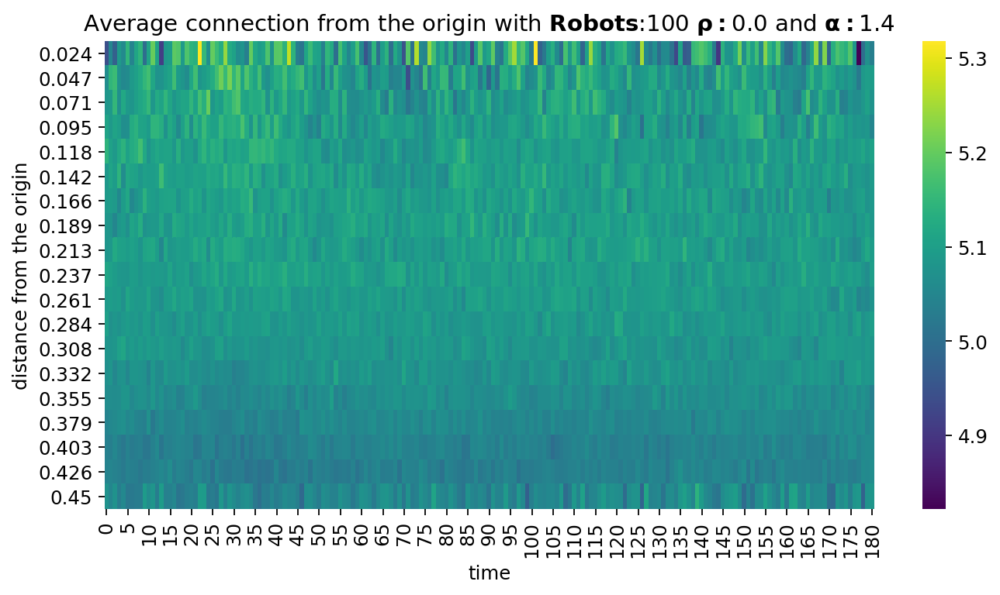

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#2.0_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_2.0.png


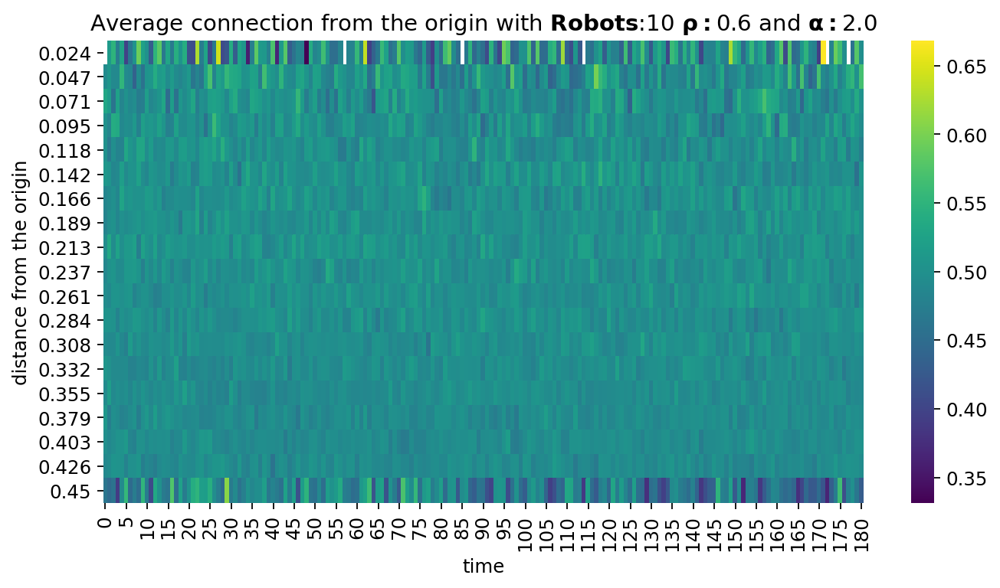

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.4.png


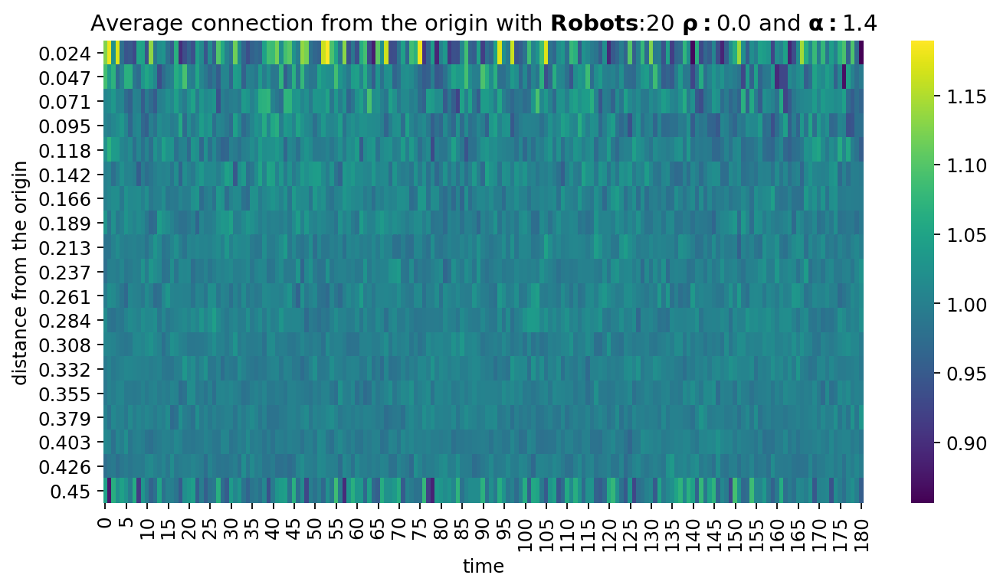

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.6_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.6.png


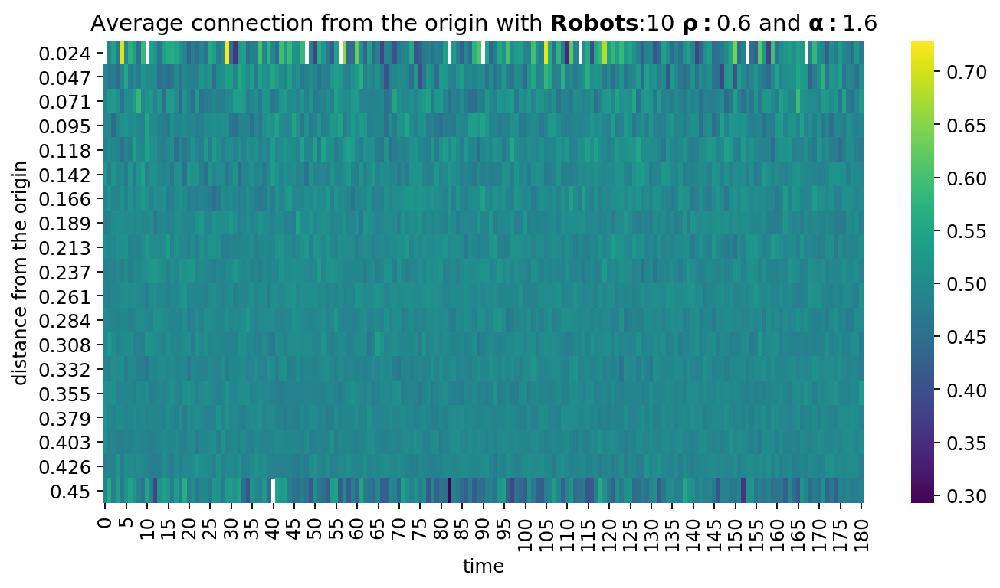

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.8.png


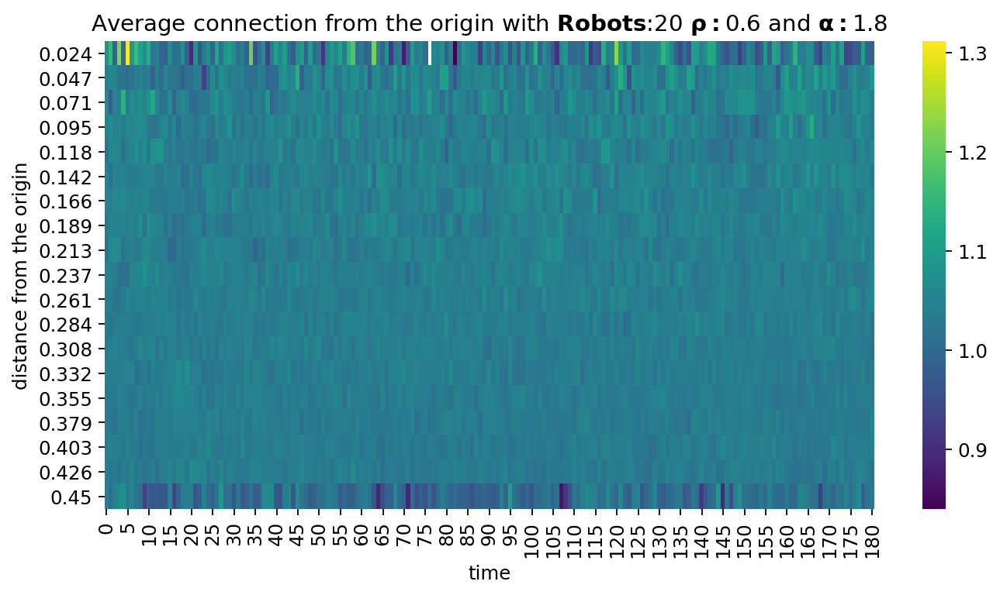

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.4.png


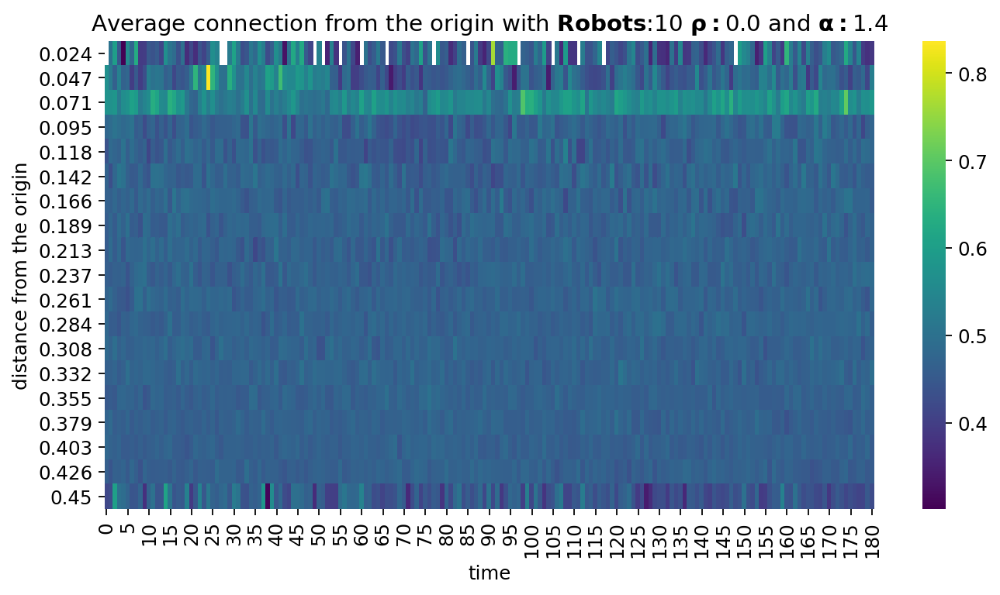

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.6_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.6.png


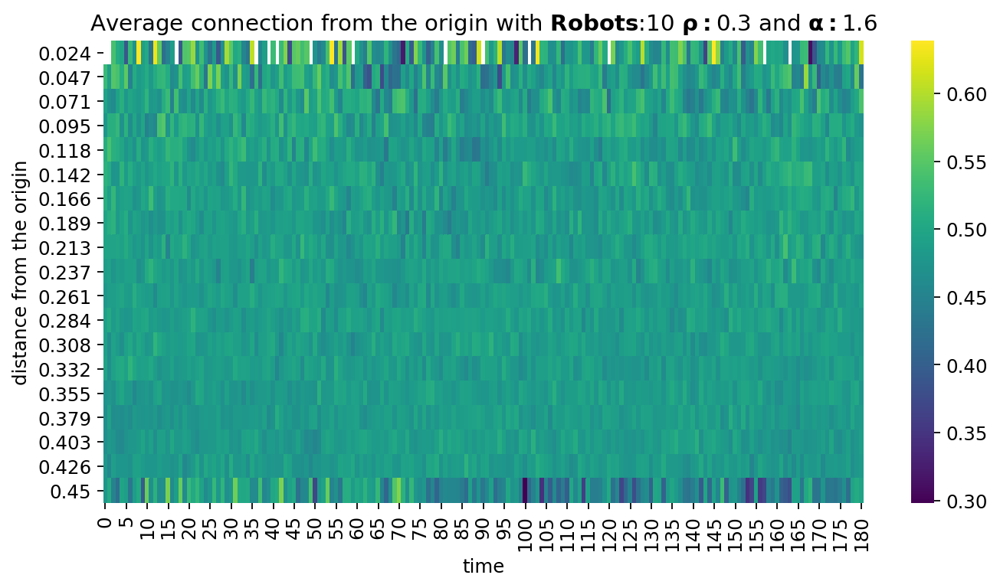

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.8.png


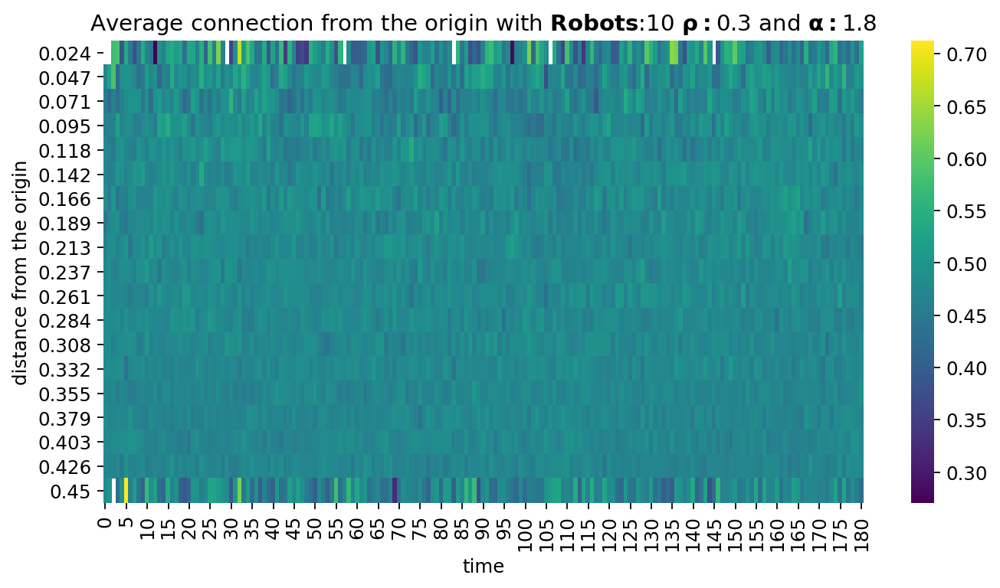

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.2_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.2.png


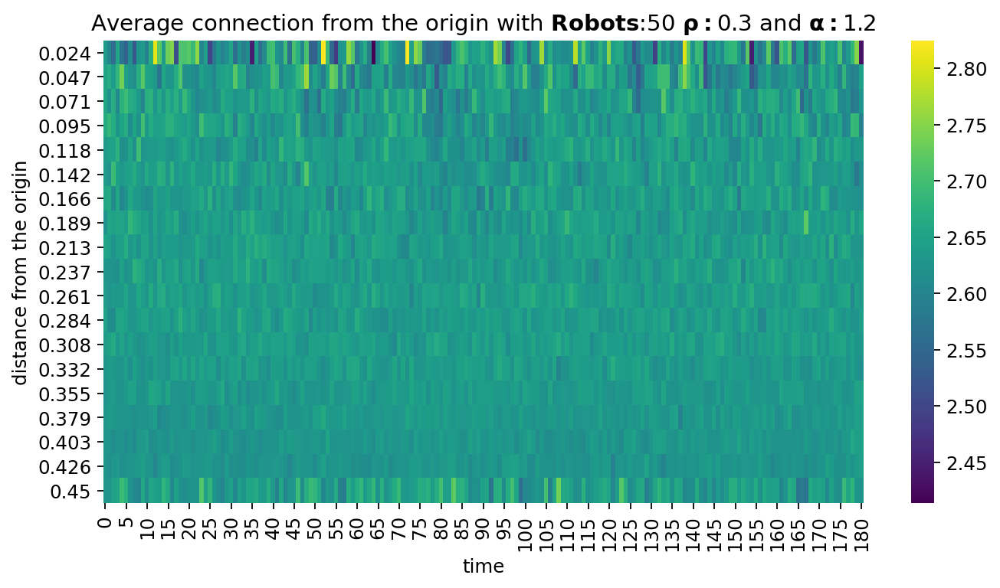

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.6_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.6.png


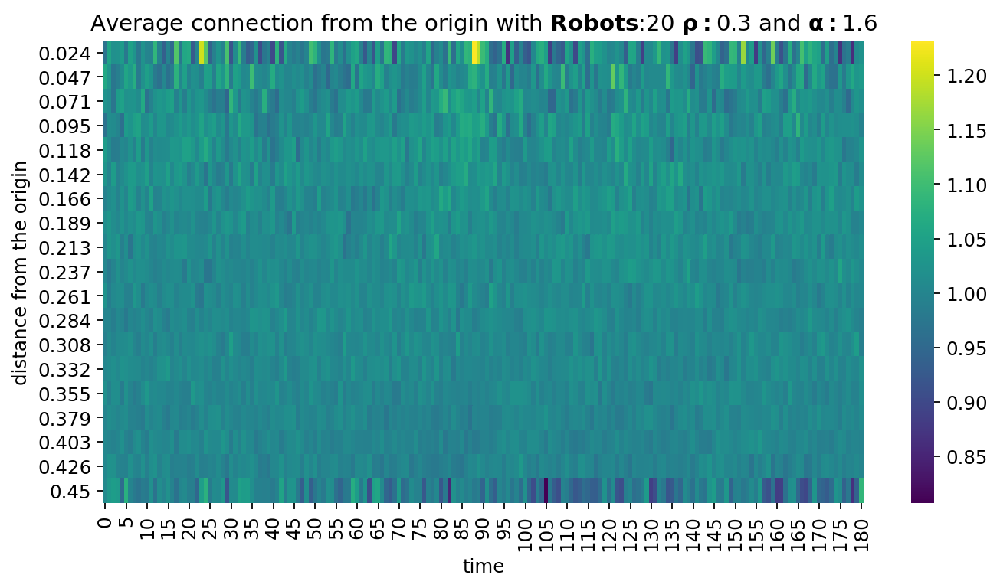

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.4.png


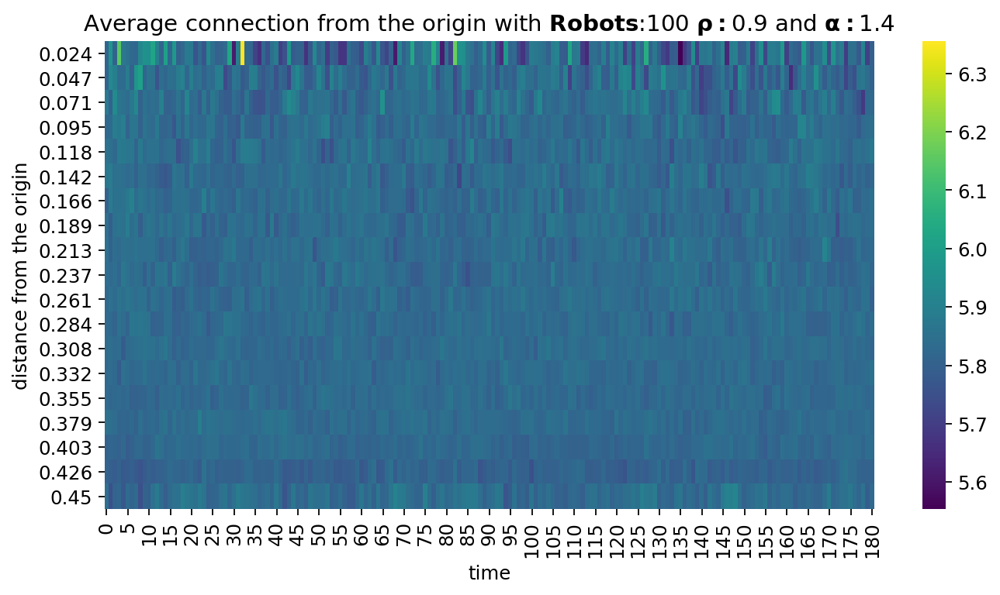

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.2_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.2.png


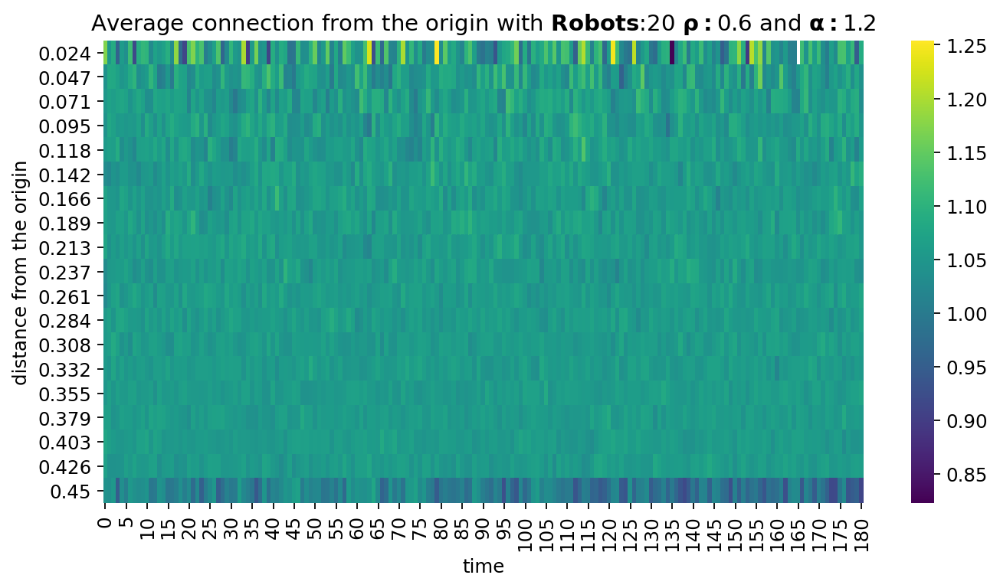

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#2.0_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_2.0.png


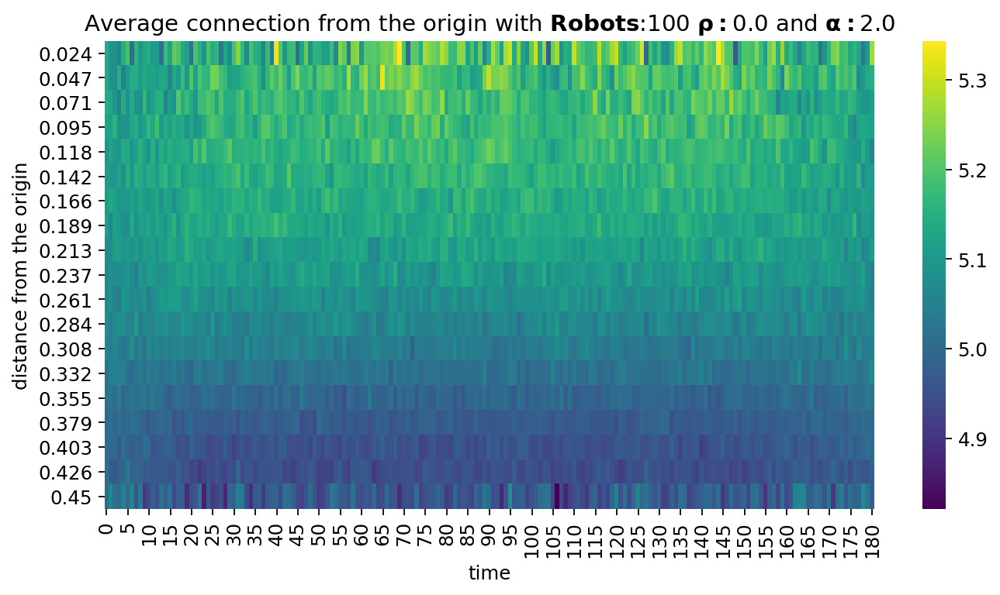

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.8.png


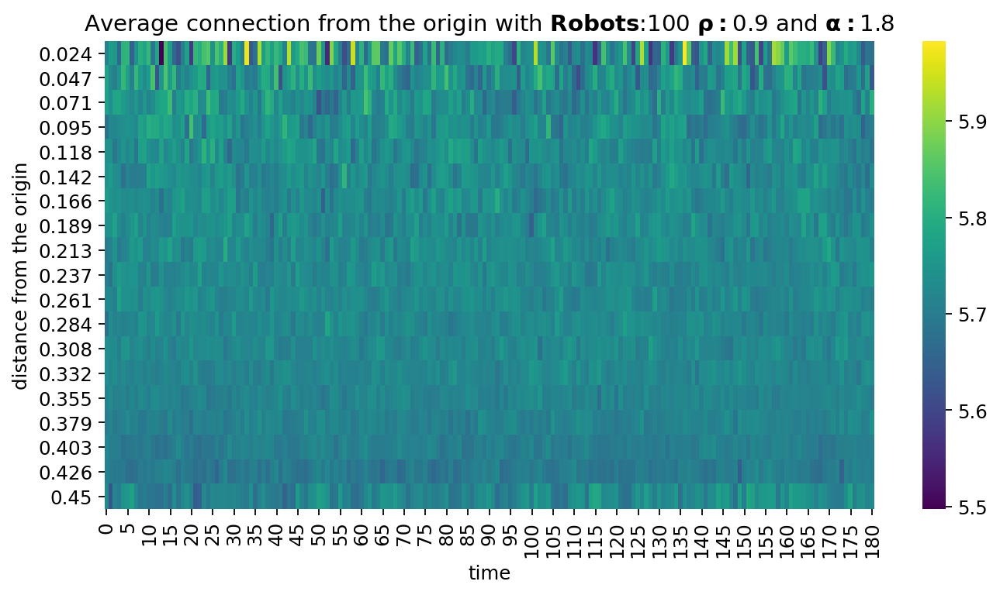

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.4.png


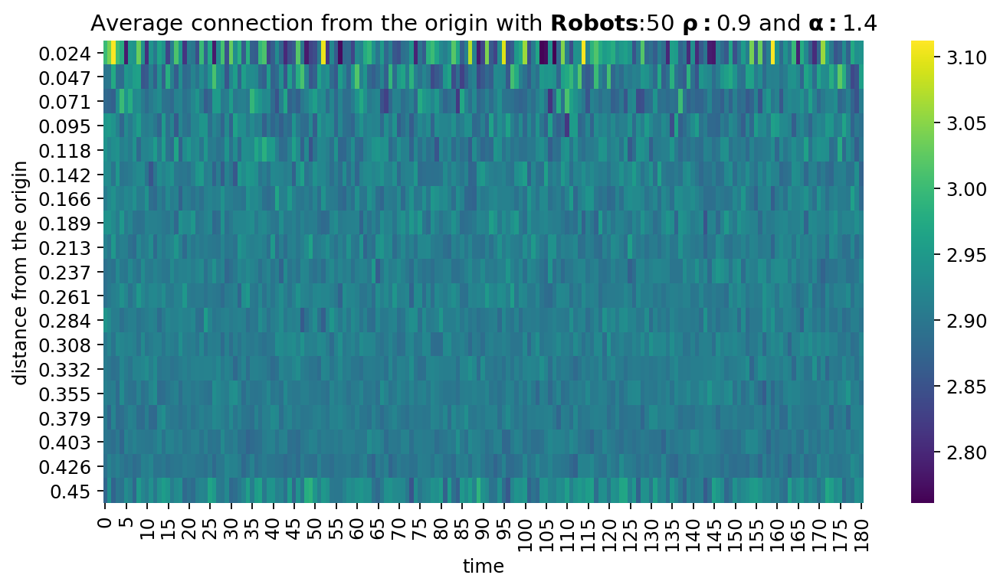

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.8.png


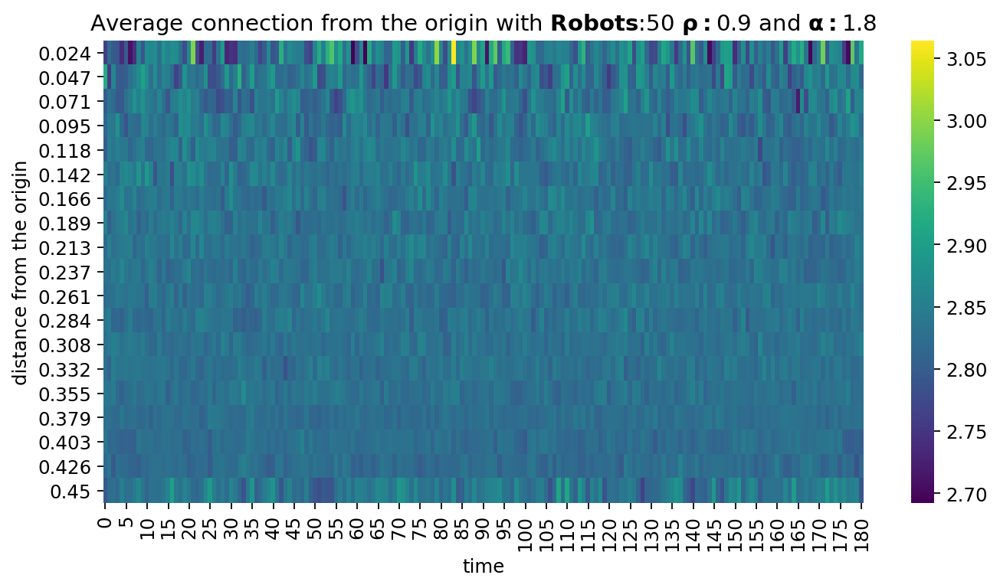

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.8.png


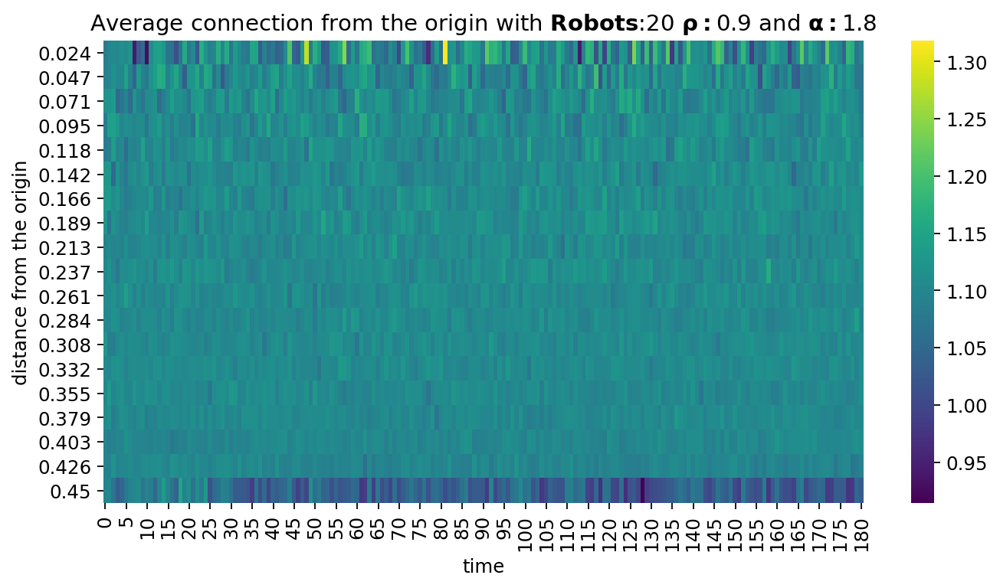

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.2_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.2.png


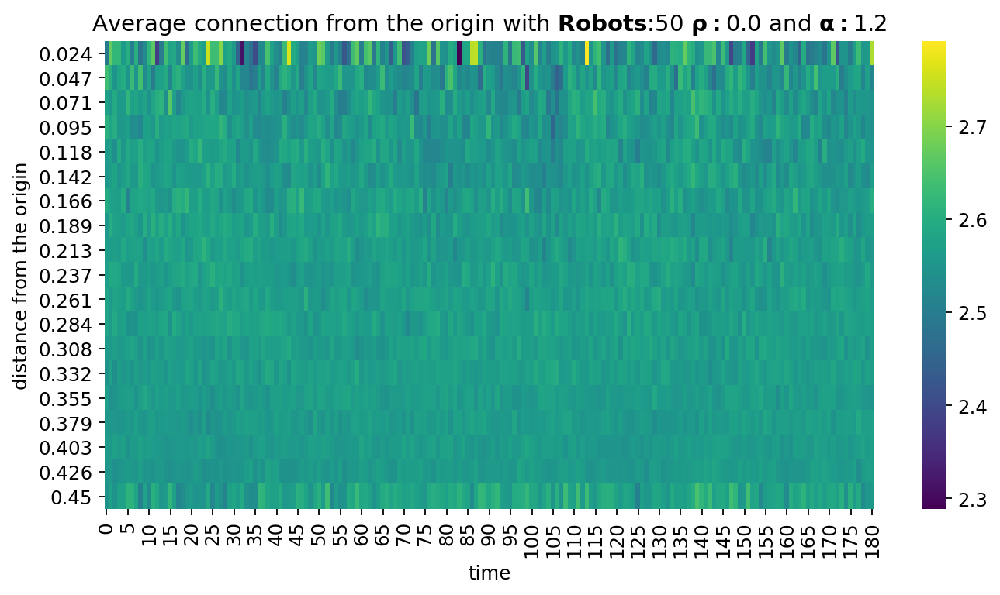

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.6_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.6.png


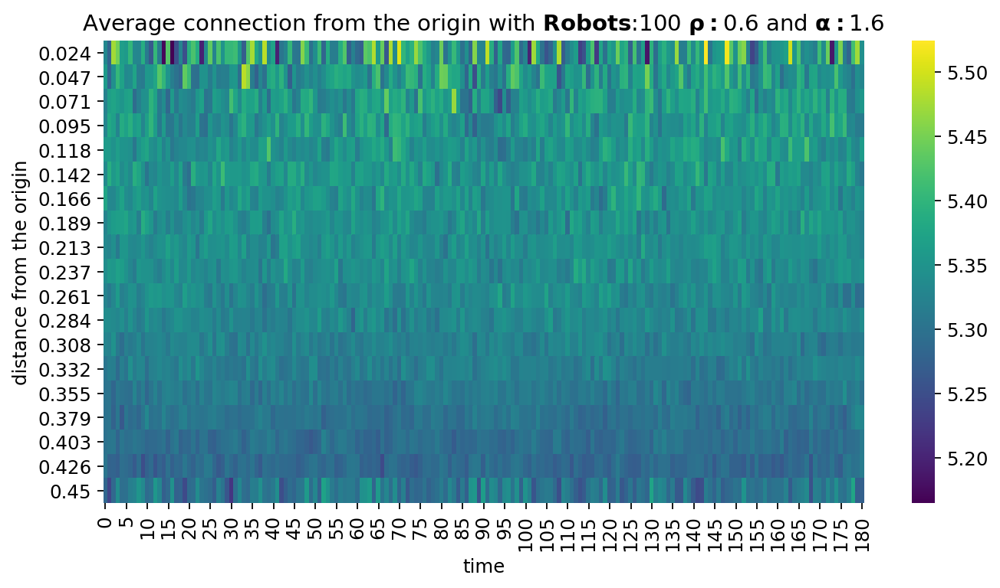

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.6_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.6.png


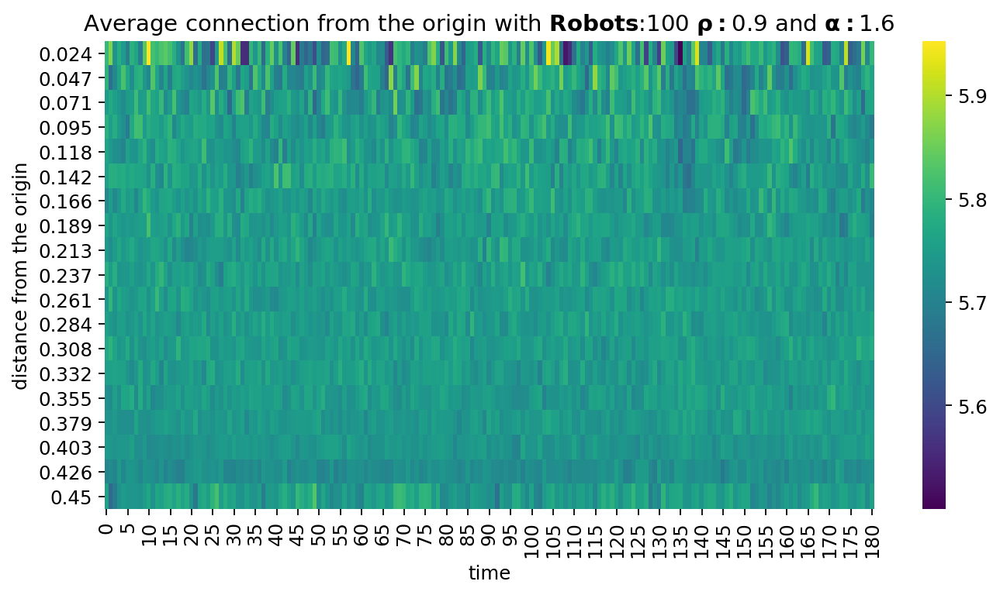

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.6_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.6.png


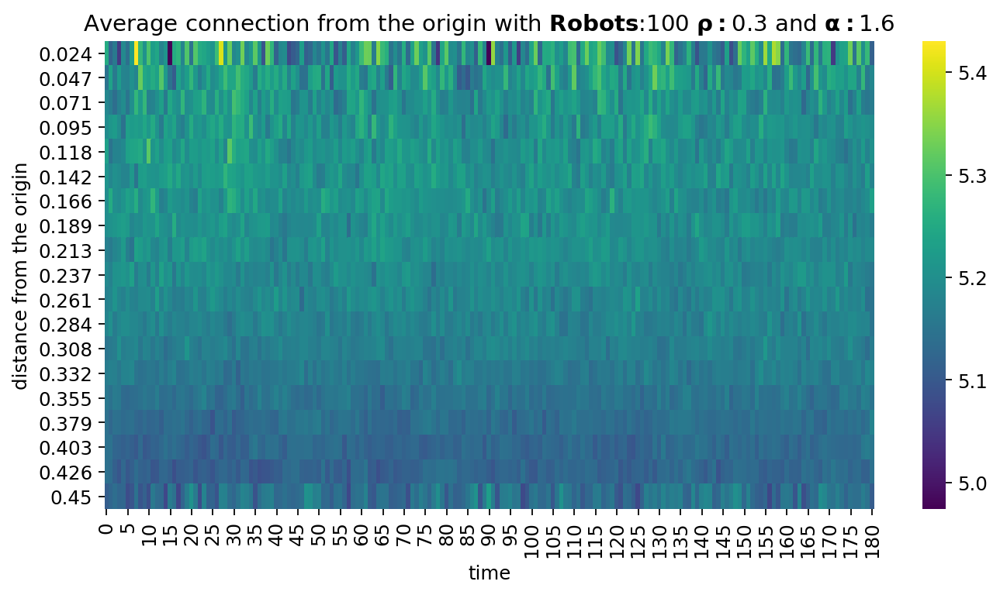

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.2_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.2.png


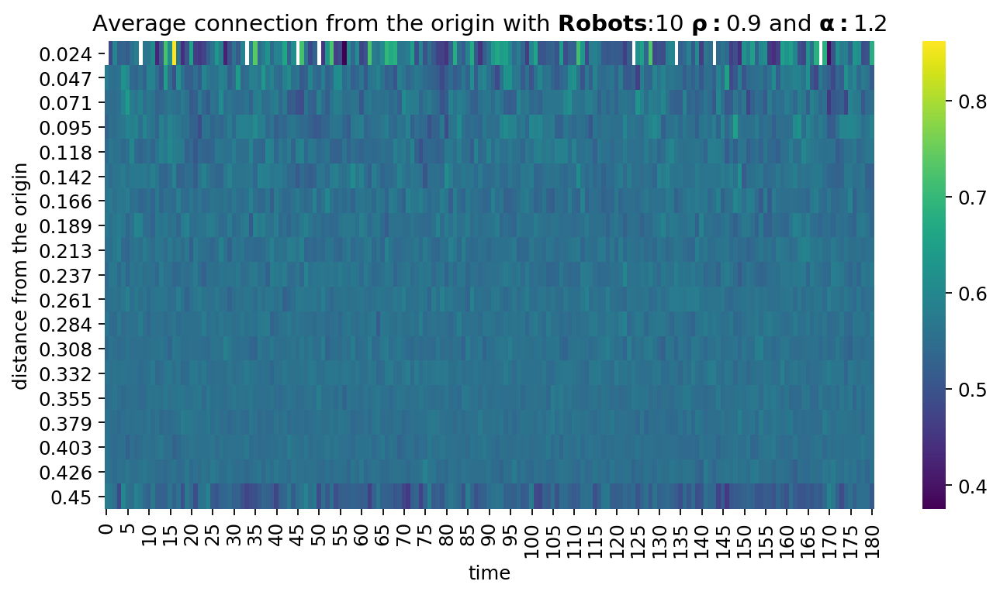

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#2.0_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_2.0.png


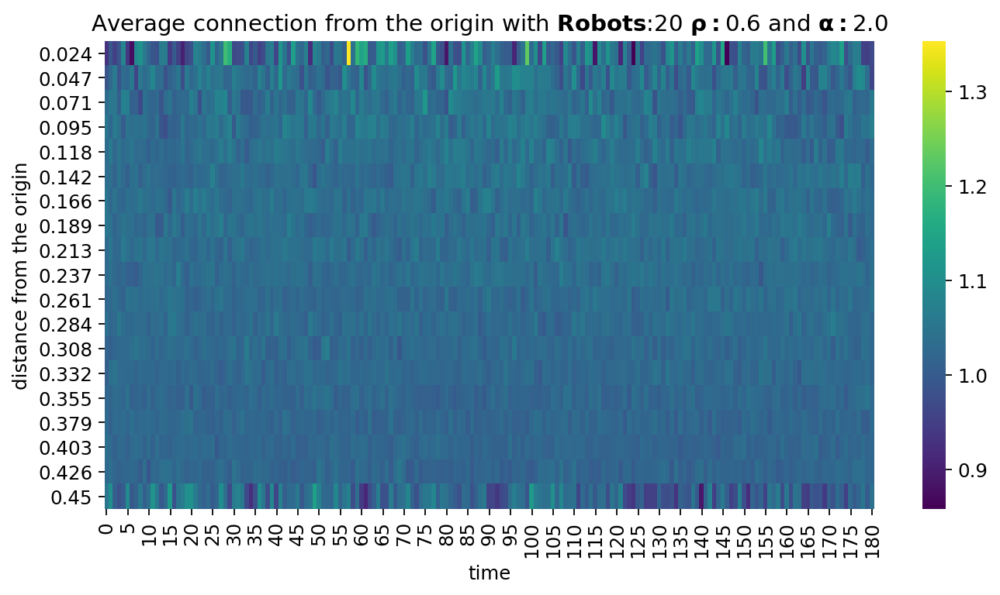

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.6_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.6.png


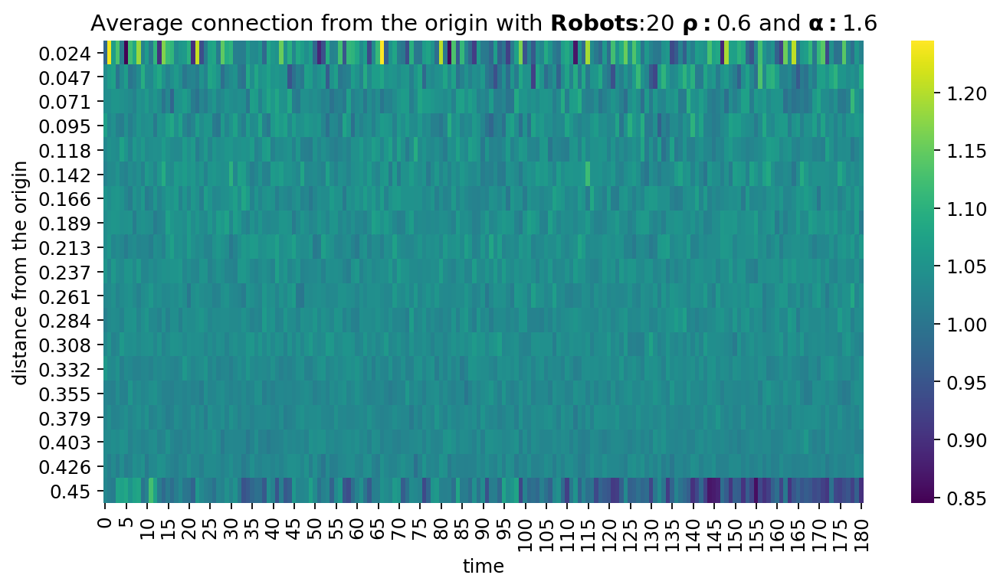

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.6_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.6.png


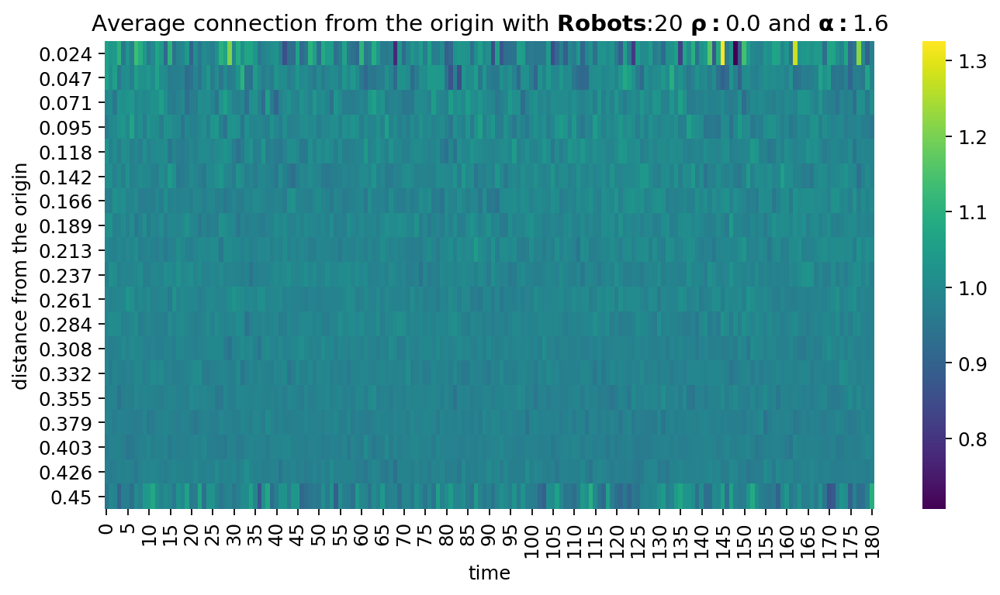

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.2_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.2.png


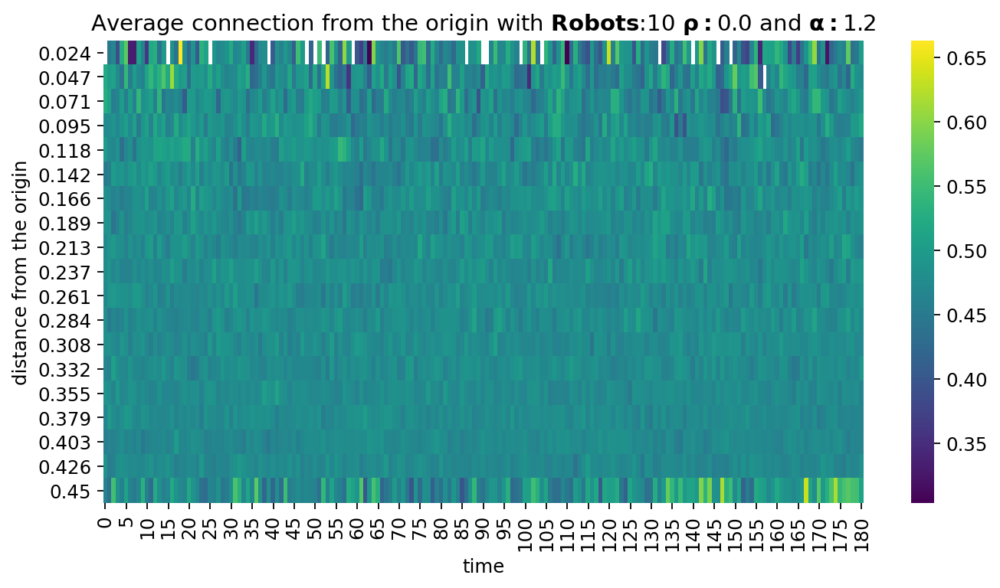

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.6_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.6.png


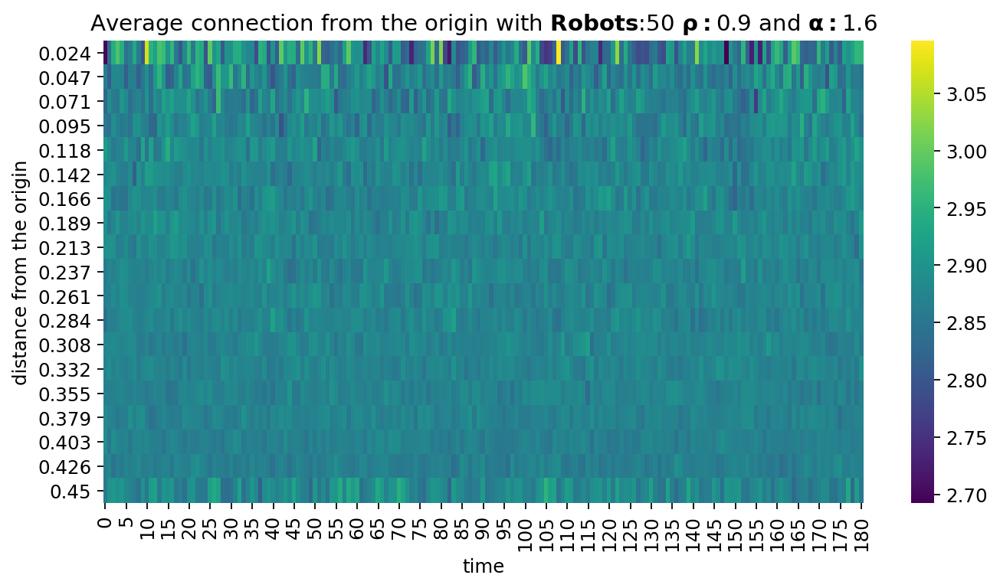

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#2.0_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_2.0.png


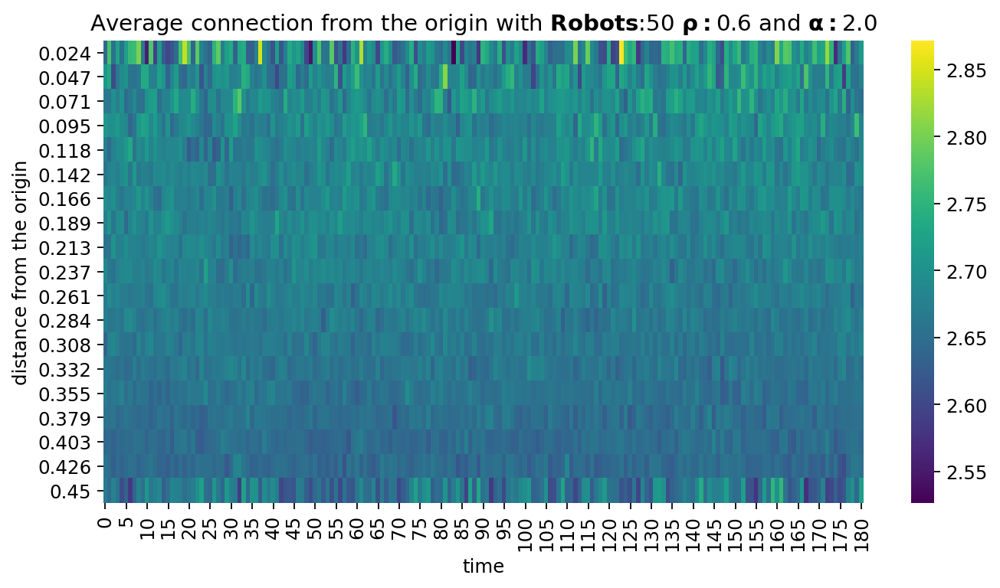

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.4.png


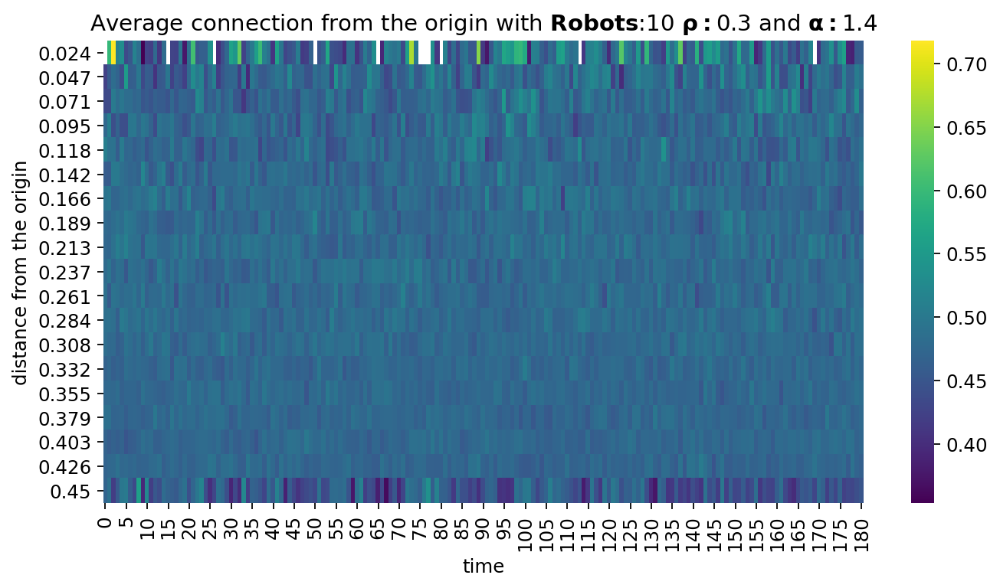

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.8.png


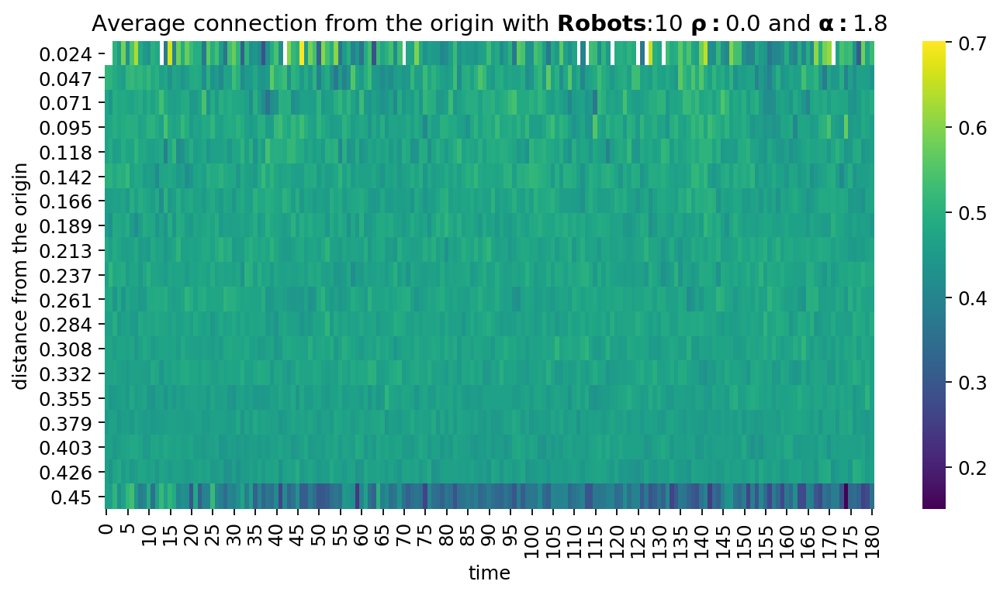

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#1.6_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.6.png


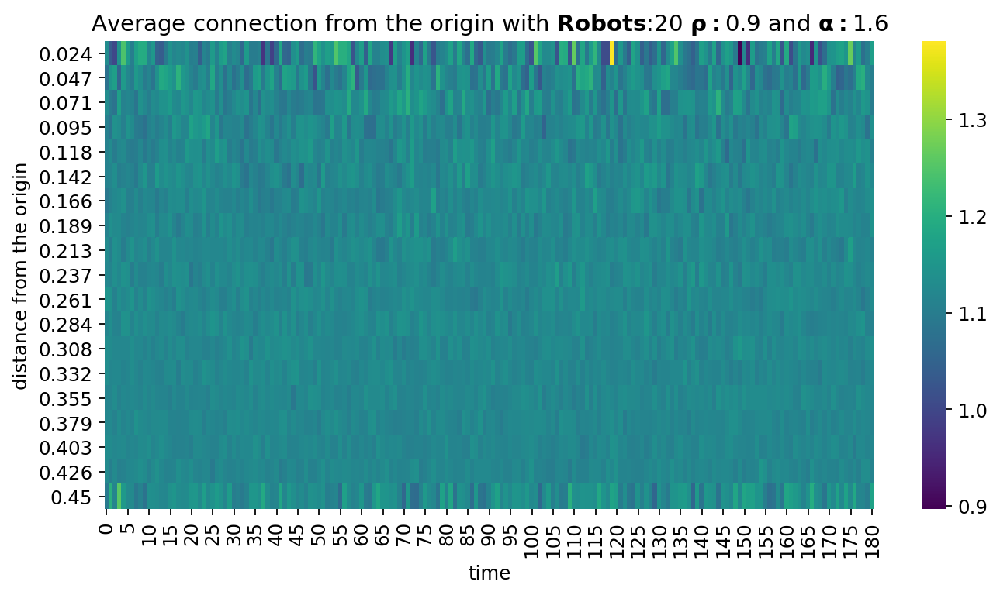

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.2_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.2.png


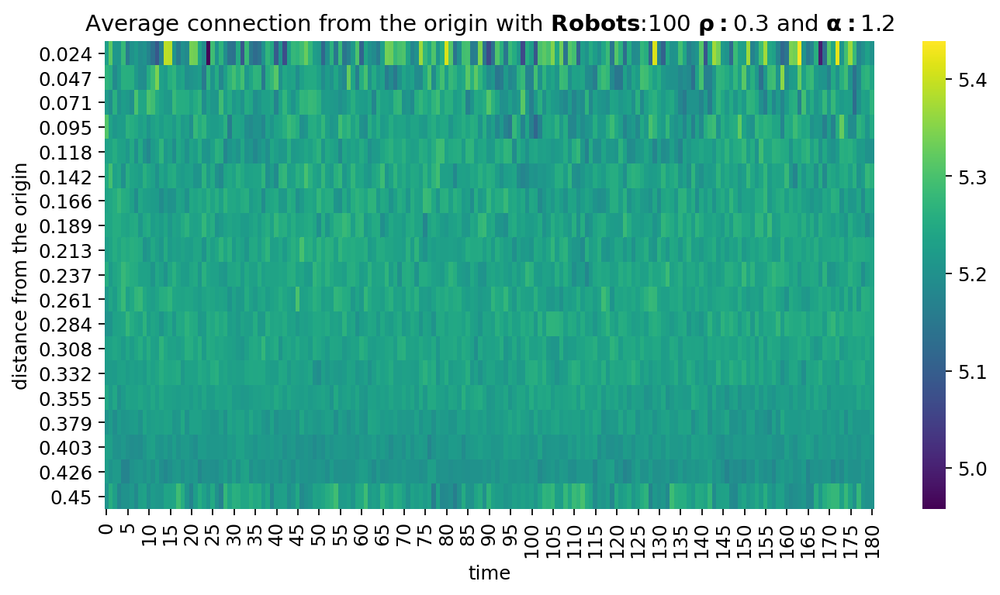

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.8.png


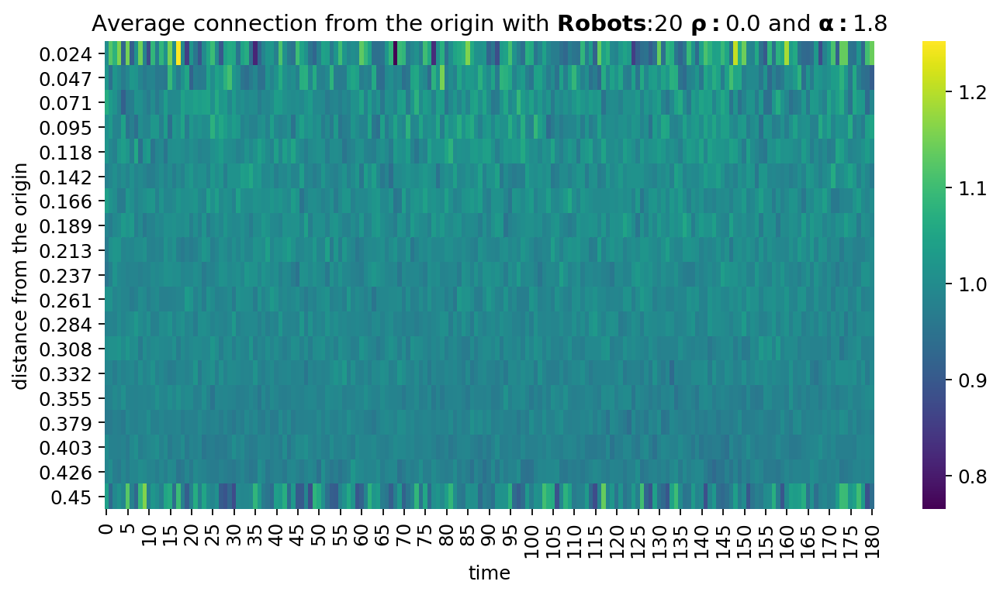

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.8.png


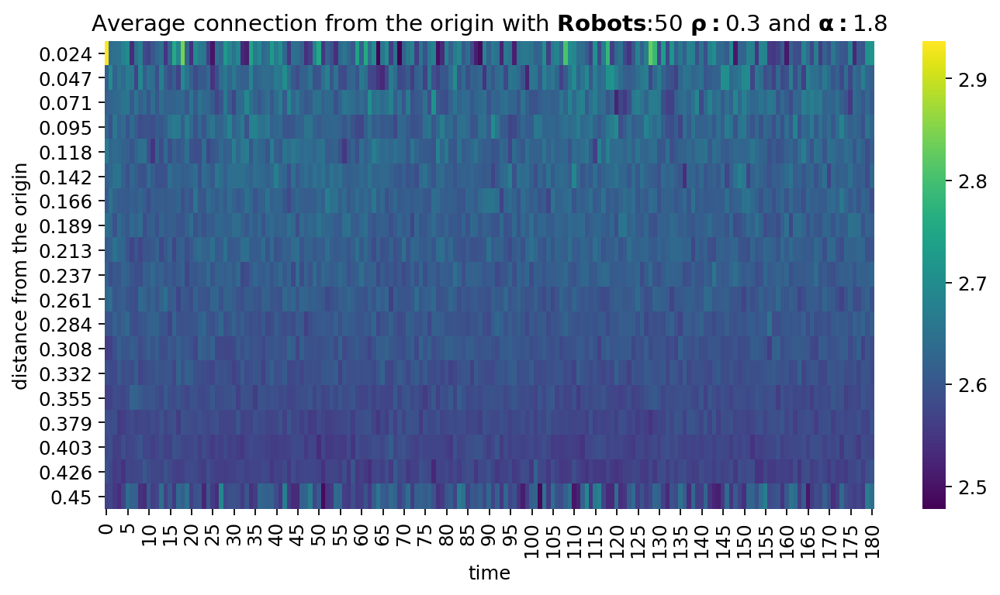

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.8.png


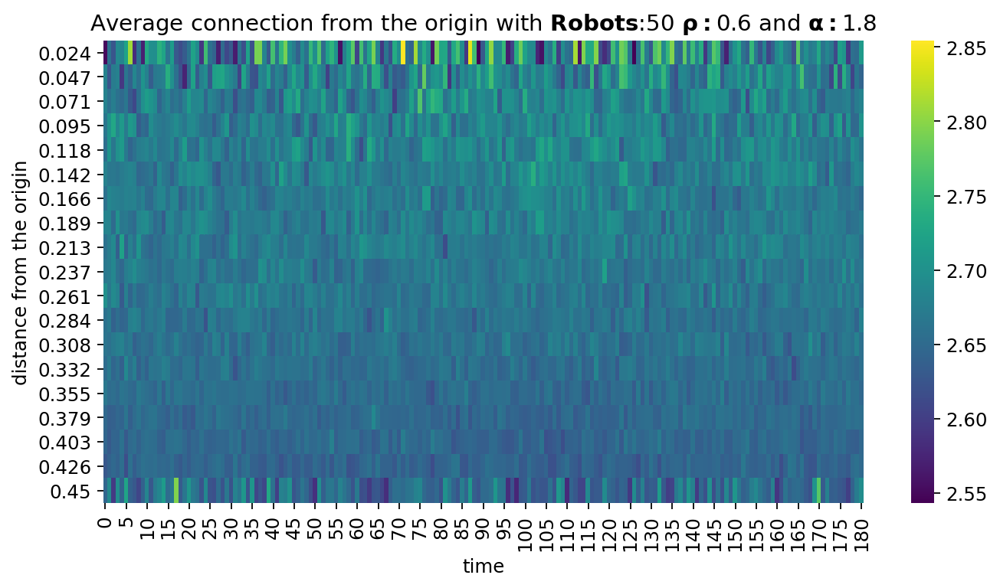

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.6_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.6.png


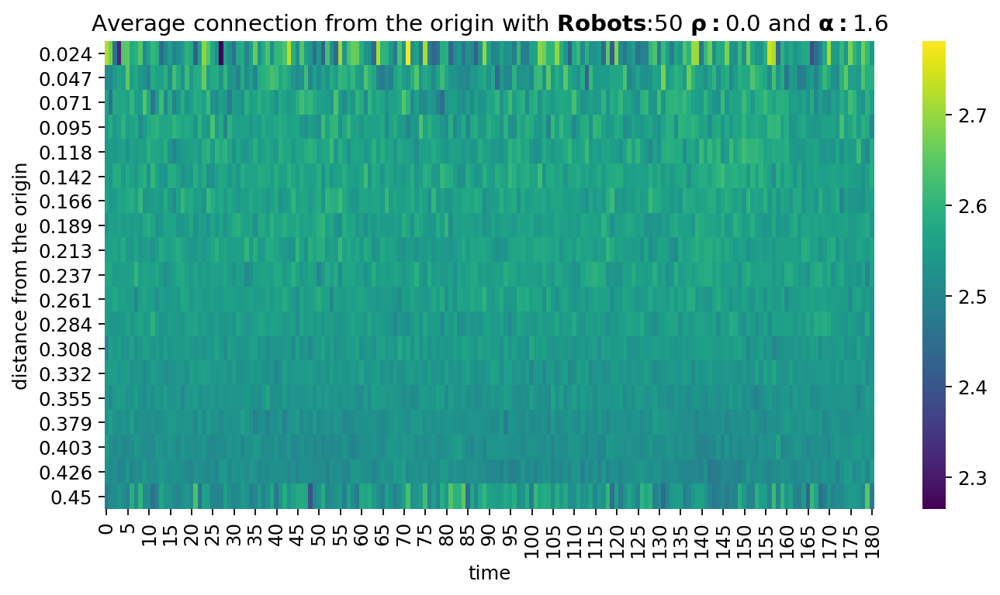

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.4.png


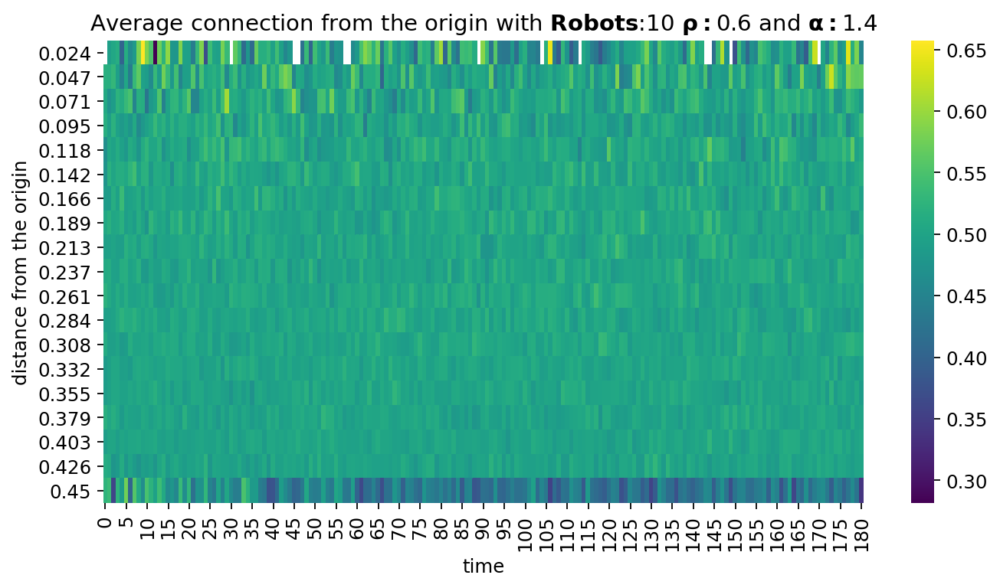

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.6_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.6.png


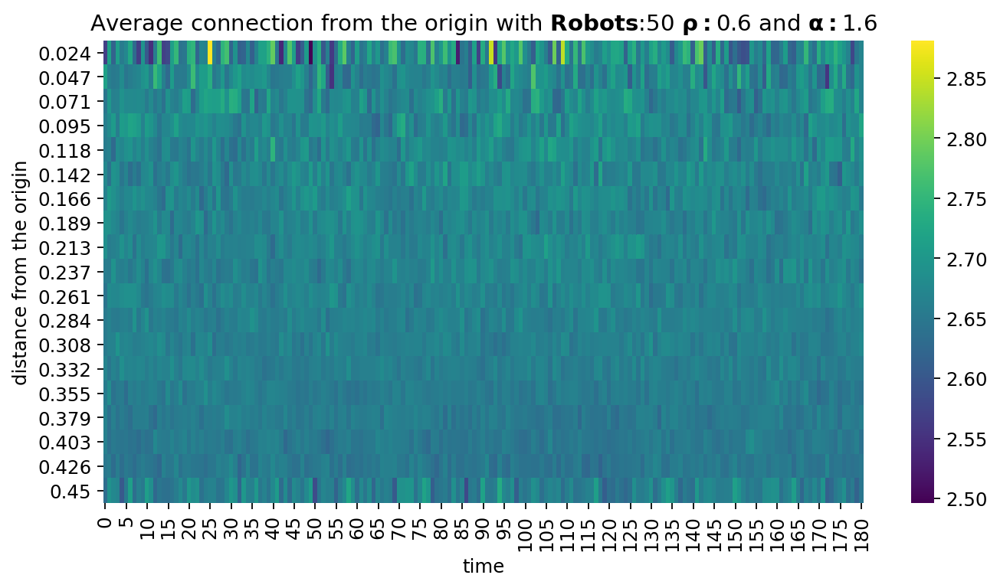

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.8.png


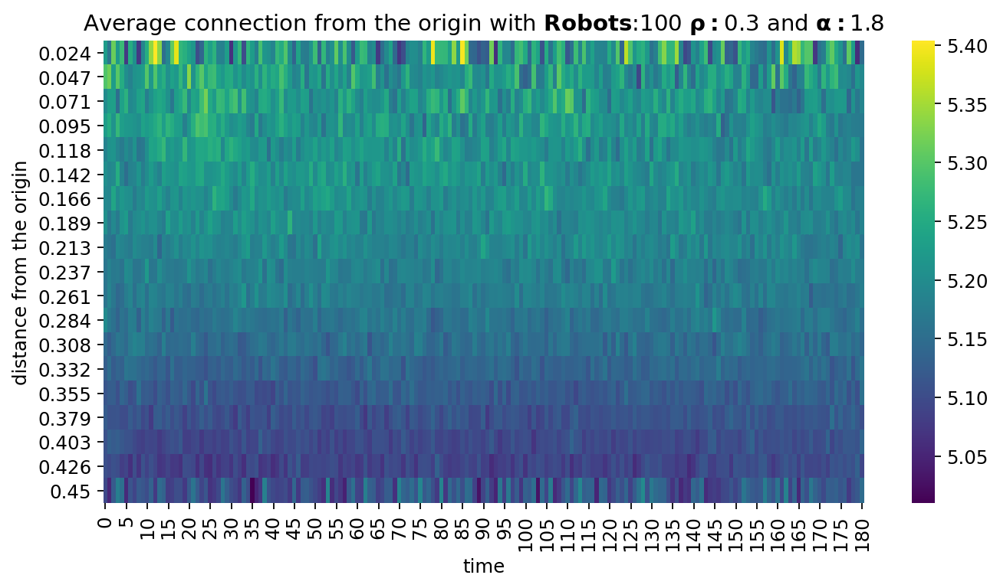

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.4.png


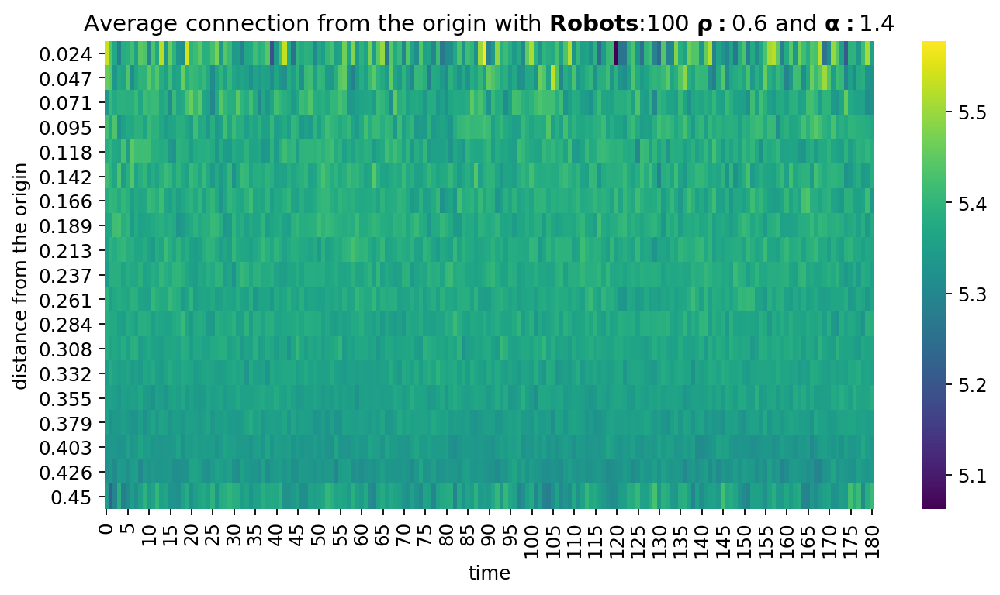

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.4.png


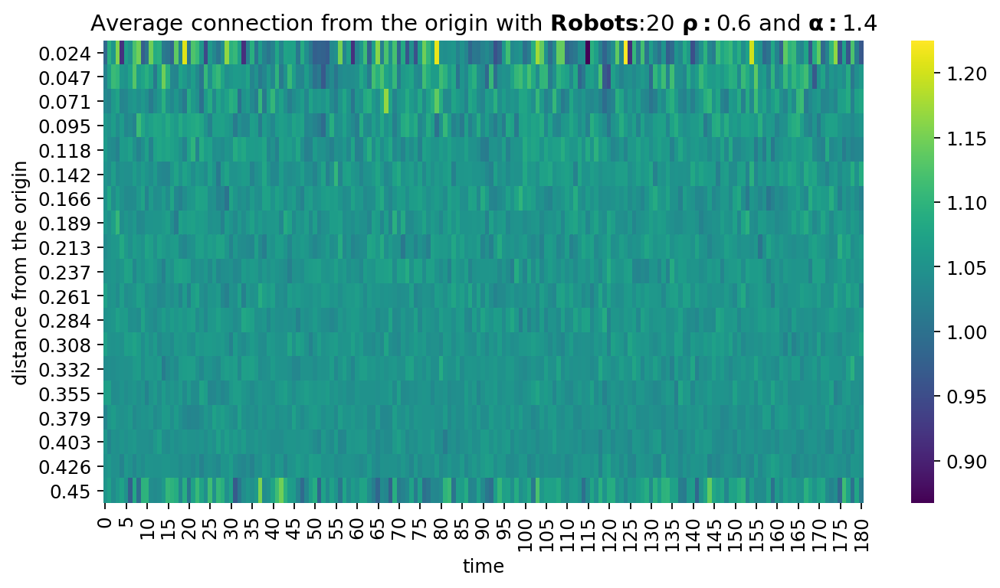

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.8.png


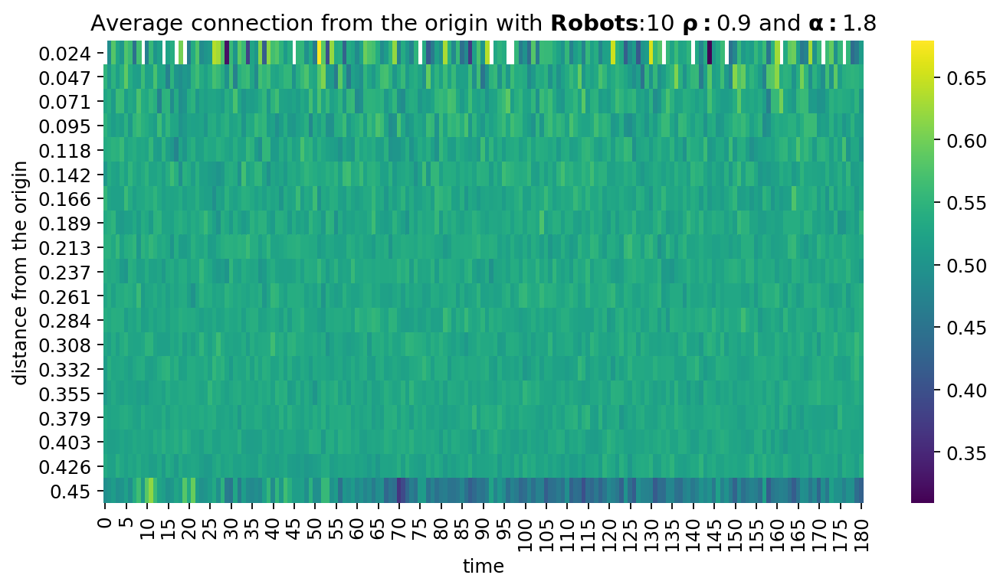

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#2.0_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_2.0.png


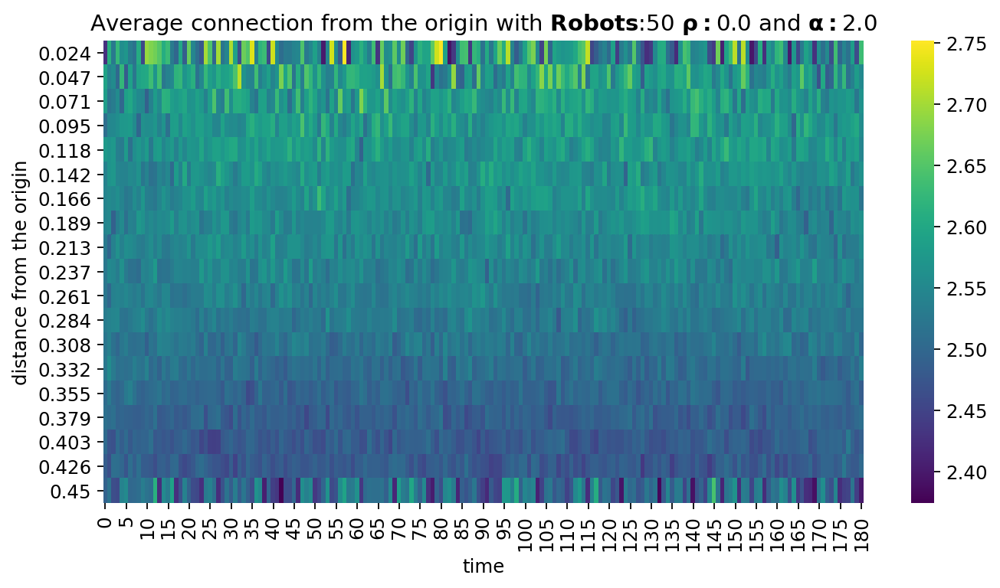

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#2.0_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_2.0.png


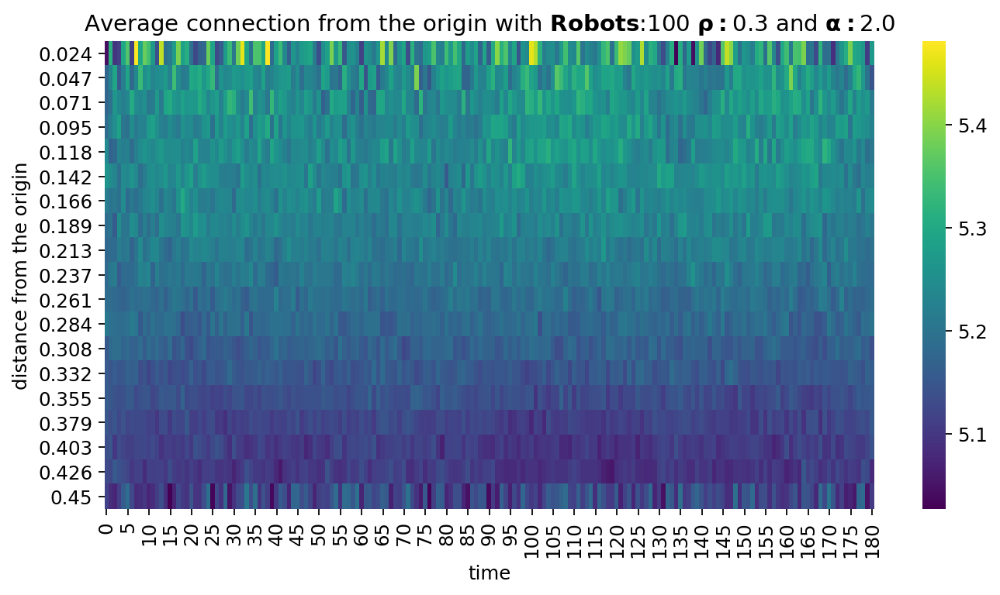

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.6_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.6.png


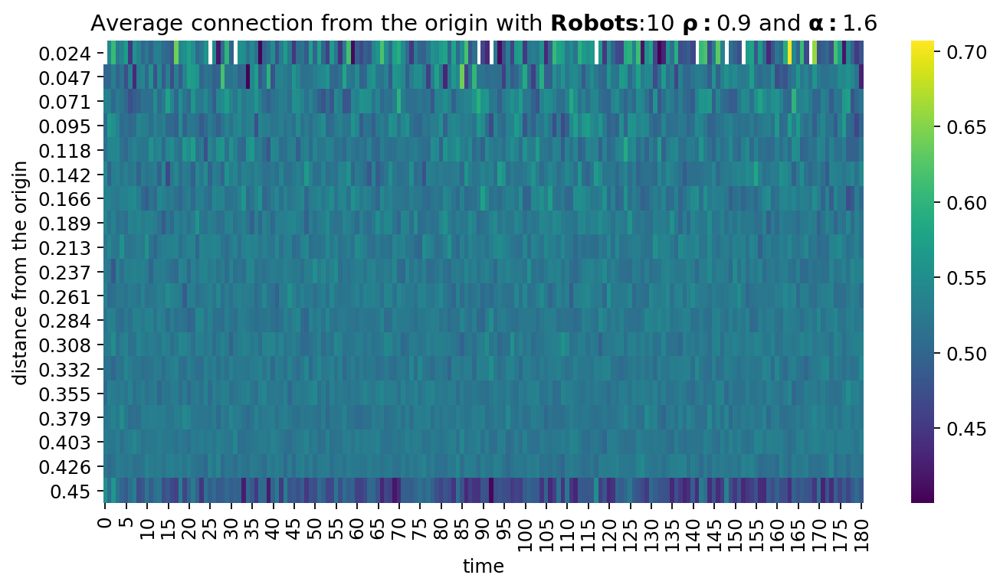

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#20_alpha#2.0_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_2.0.png


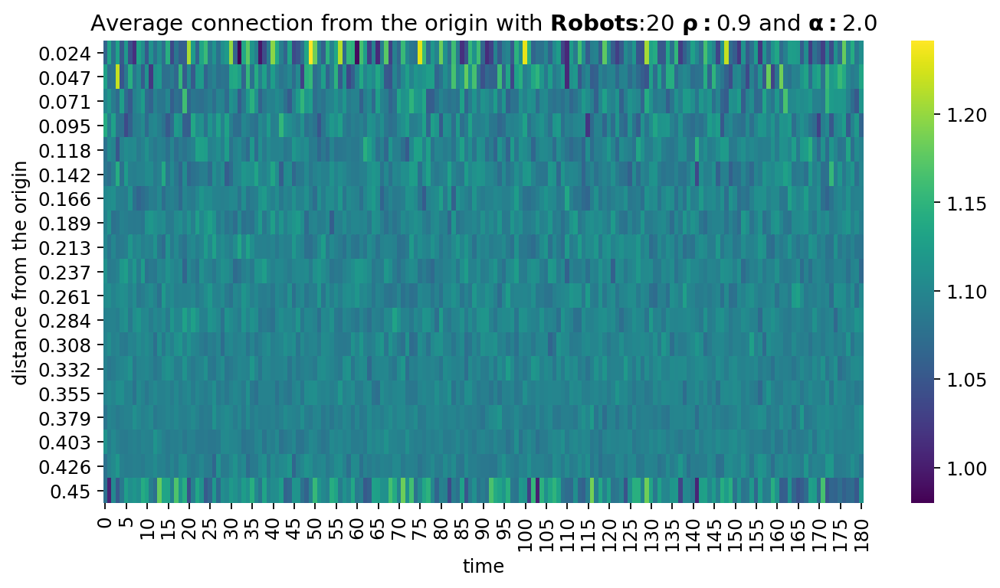

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.8.png


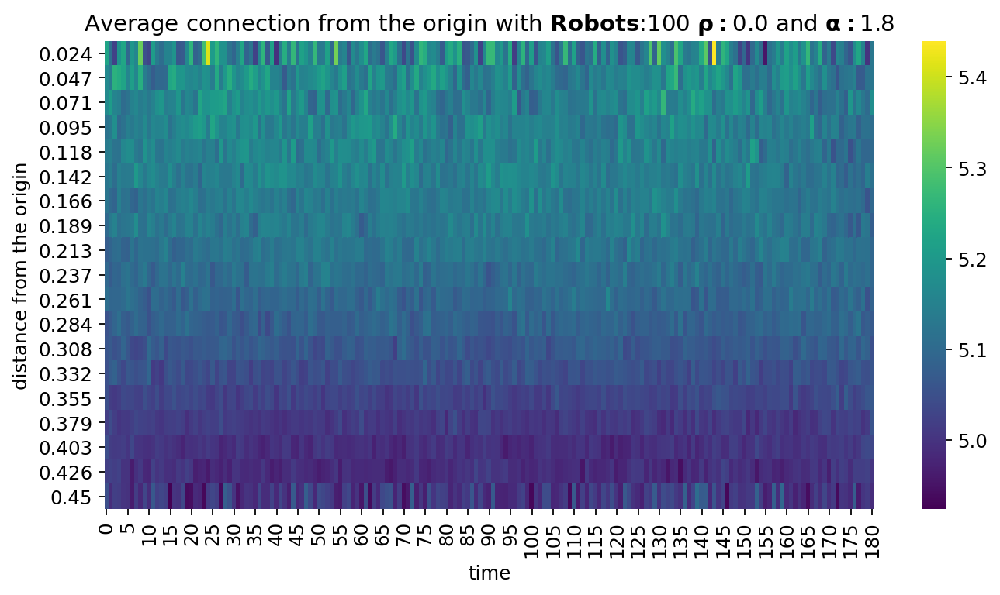

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.2_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.2.png


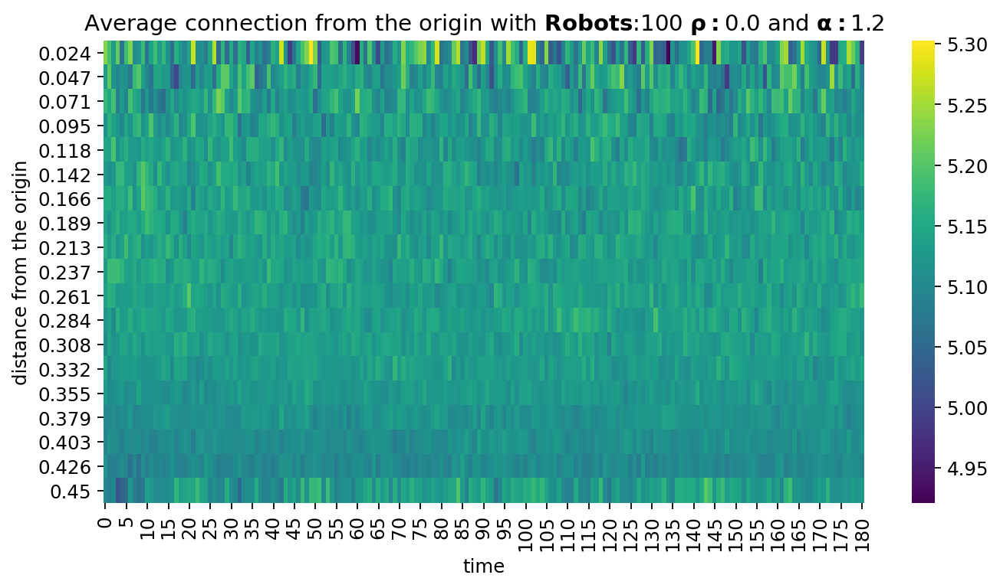

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.4.png


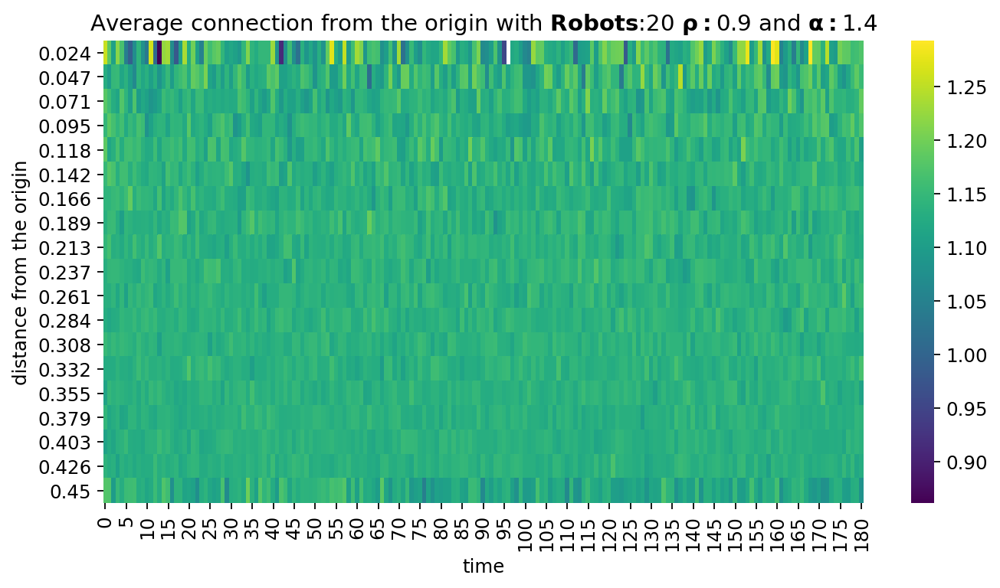

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.2_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.2.png


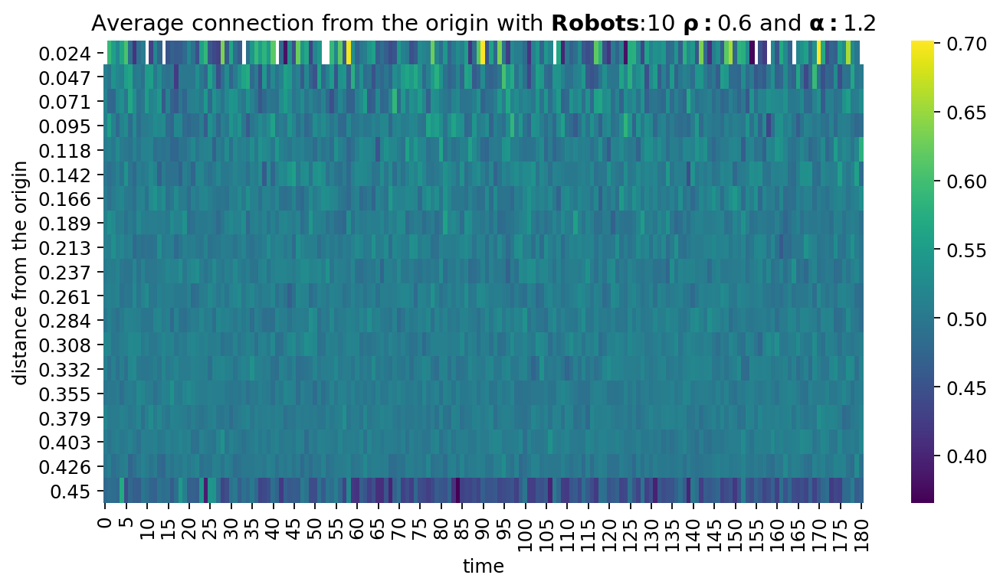

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#2.0_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_2.0.png


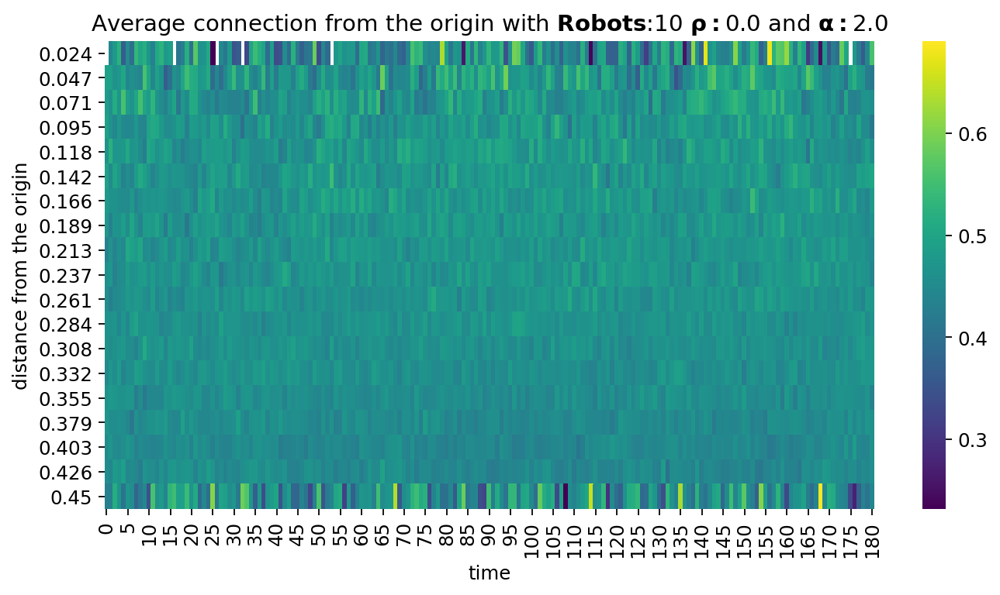

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.6_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.6.png


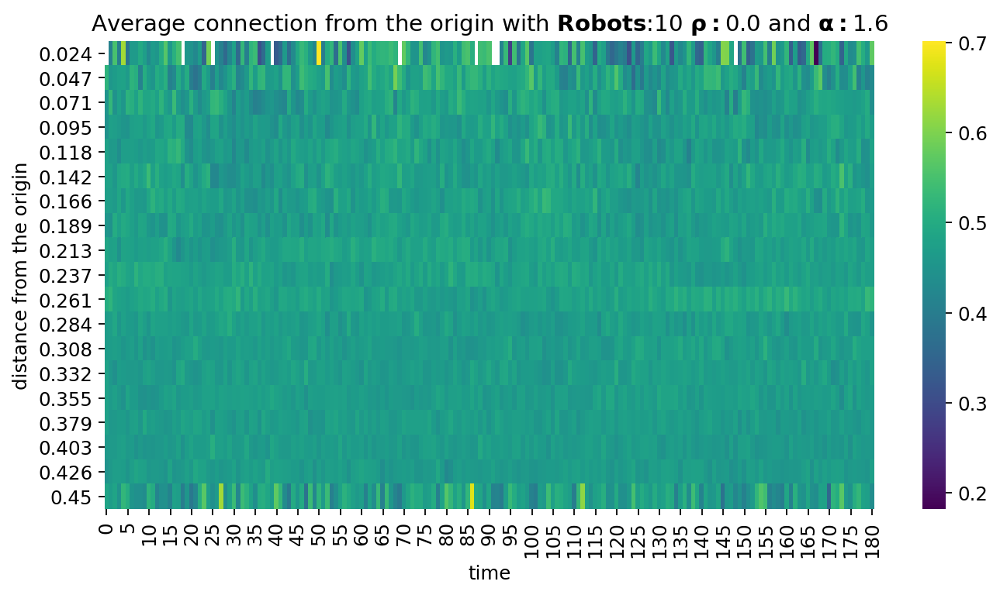

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.4.png


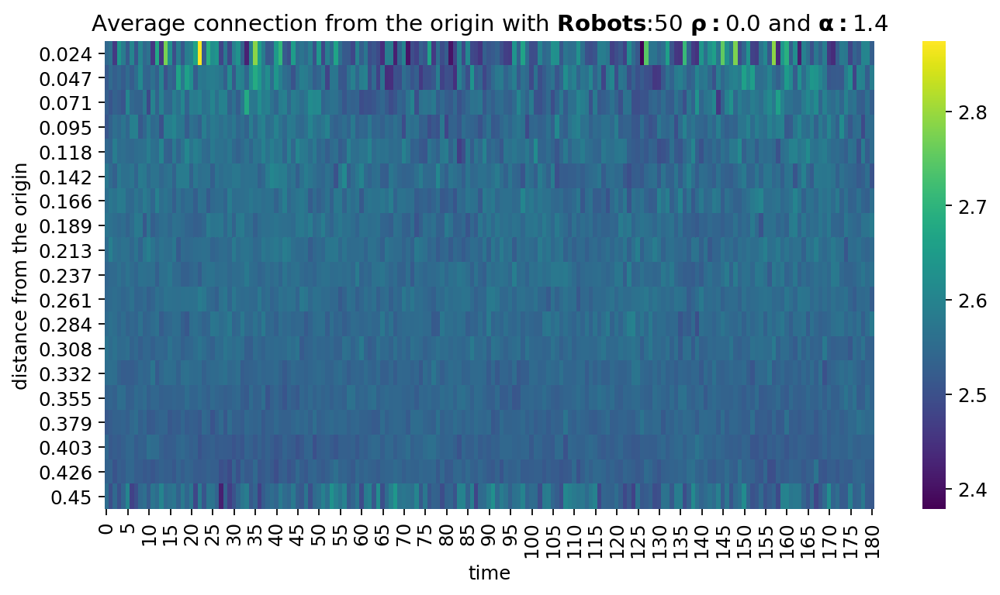

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#2.0_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_2.0.png


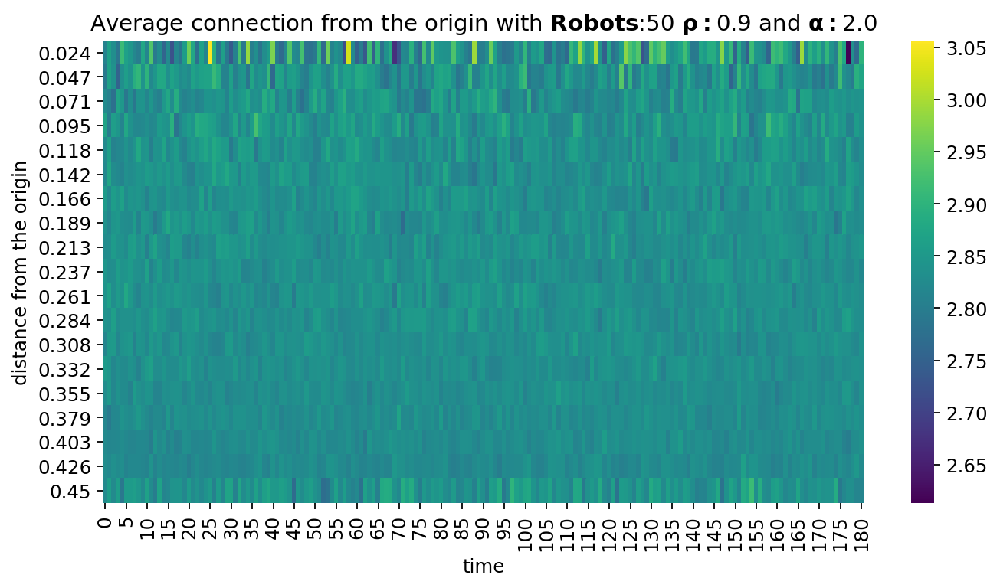

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#2.0_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_2.0.png


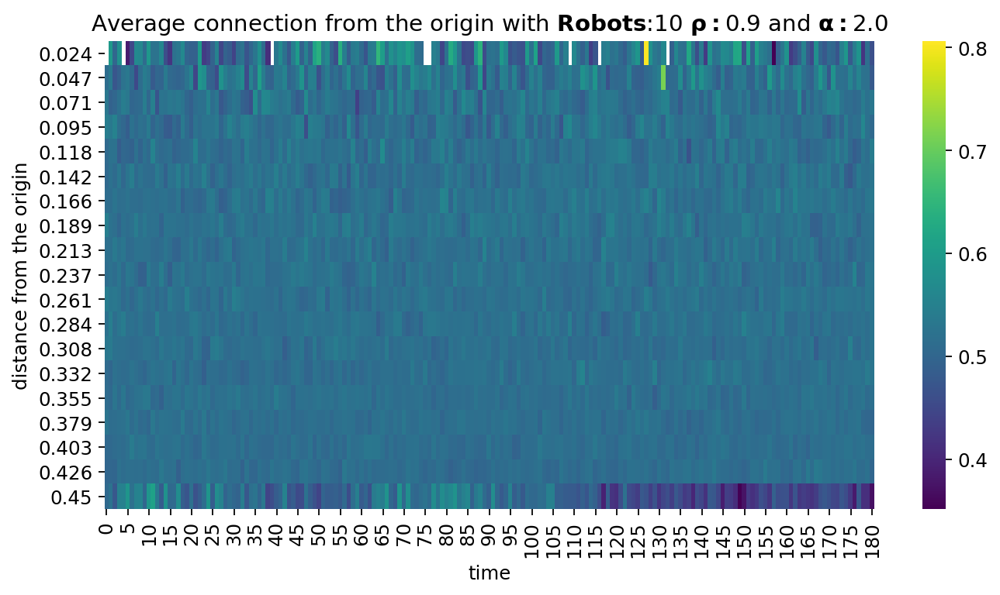

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#1.6_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.6.png


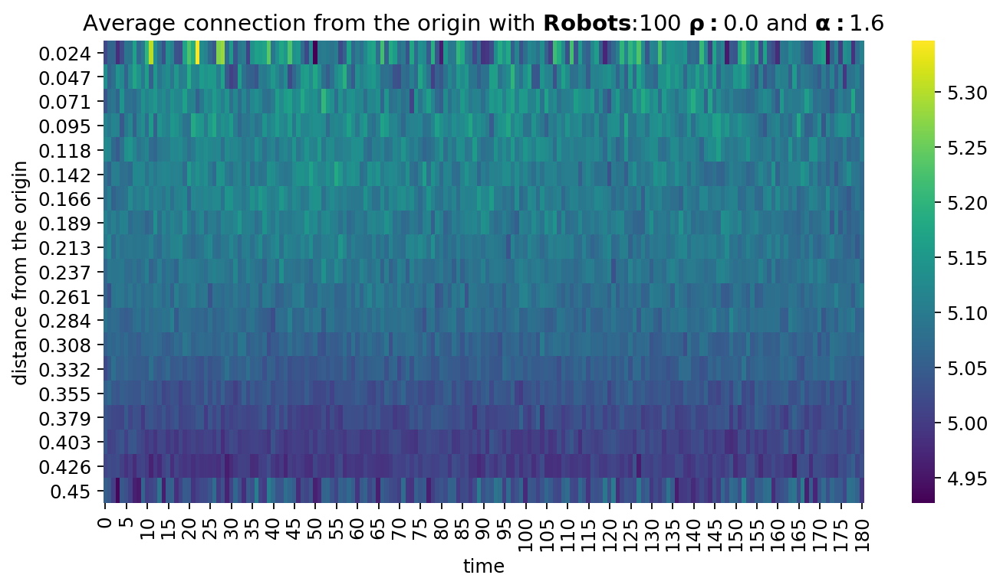

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.4.png


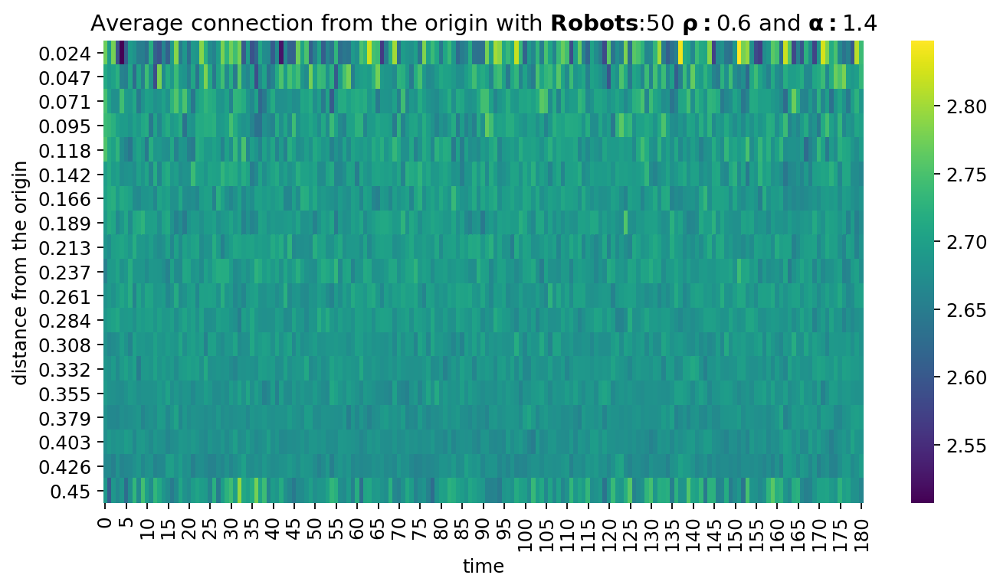

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.4.png


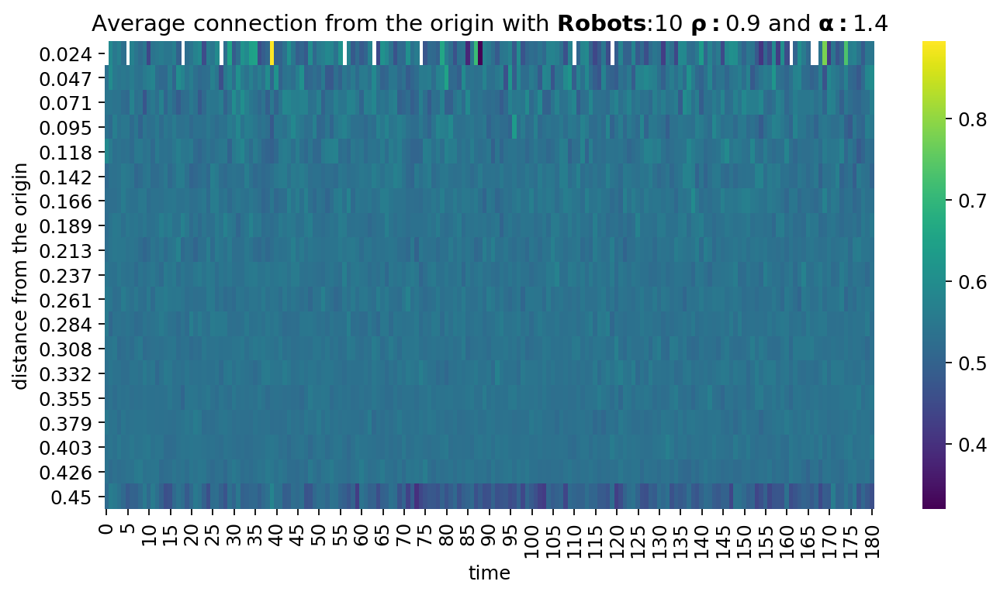

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.4.png


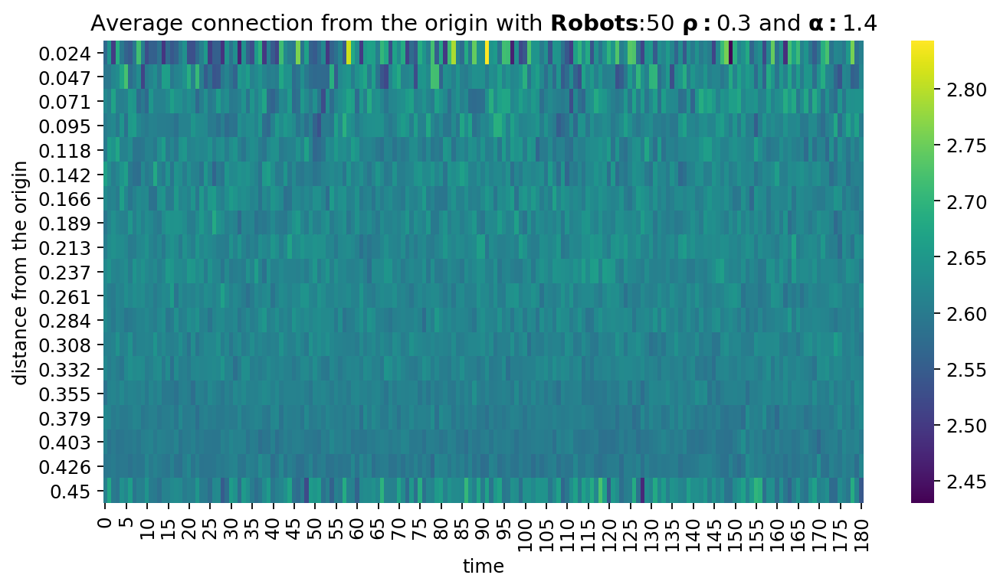

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#10_alpha#1.2_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.2.png


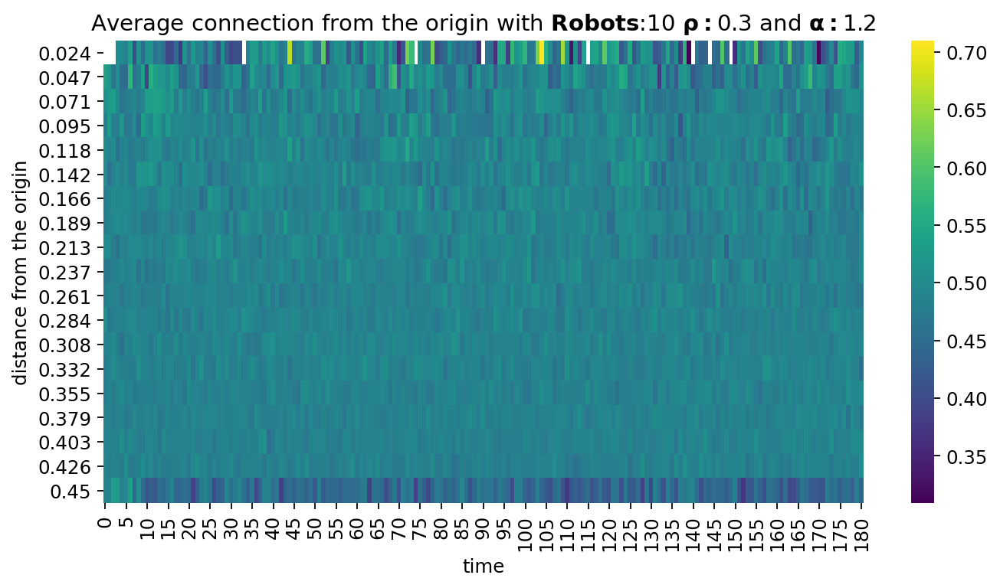

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.8.png


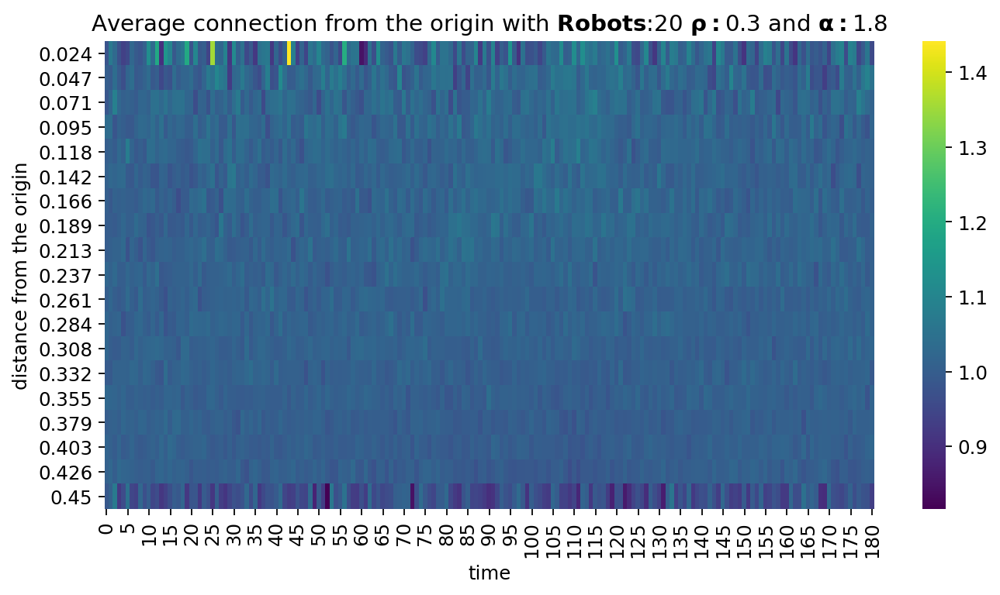

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#2.0_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_2.0.png


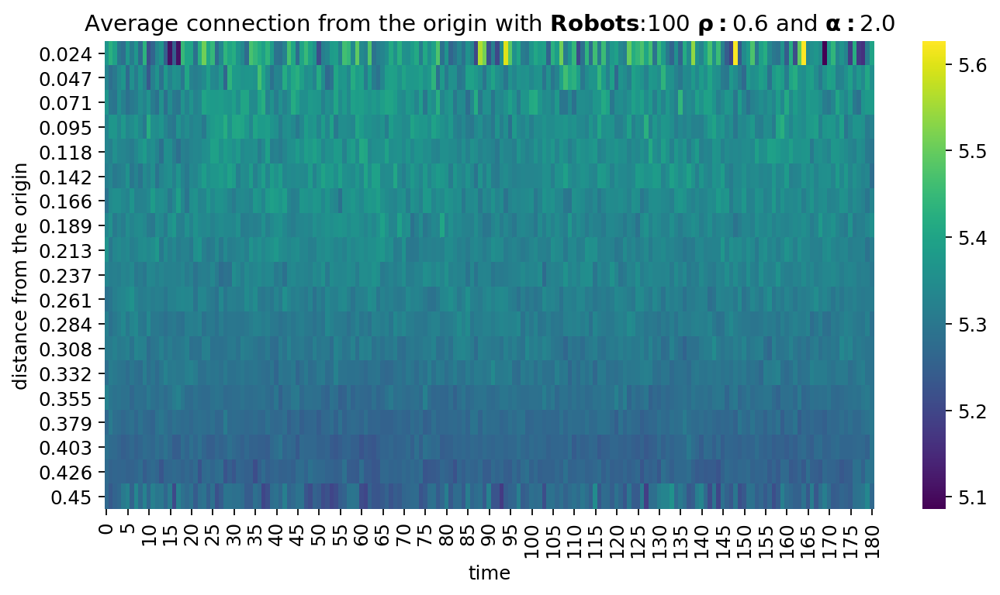

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#1.2_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.2.png


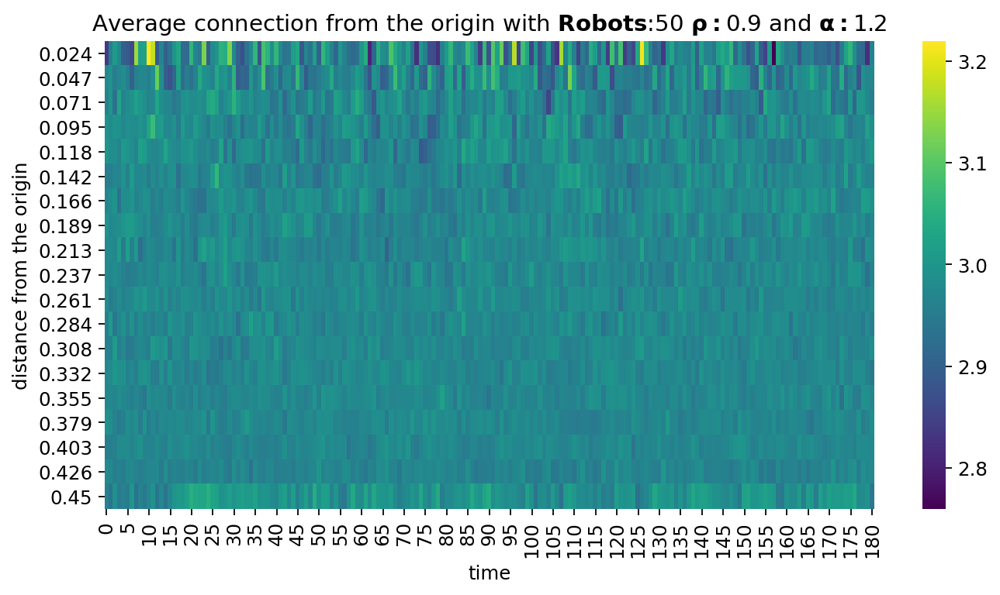

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#50_alpha#2.0_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_2.0.png


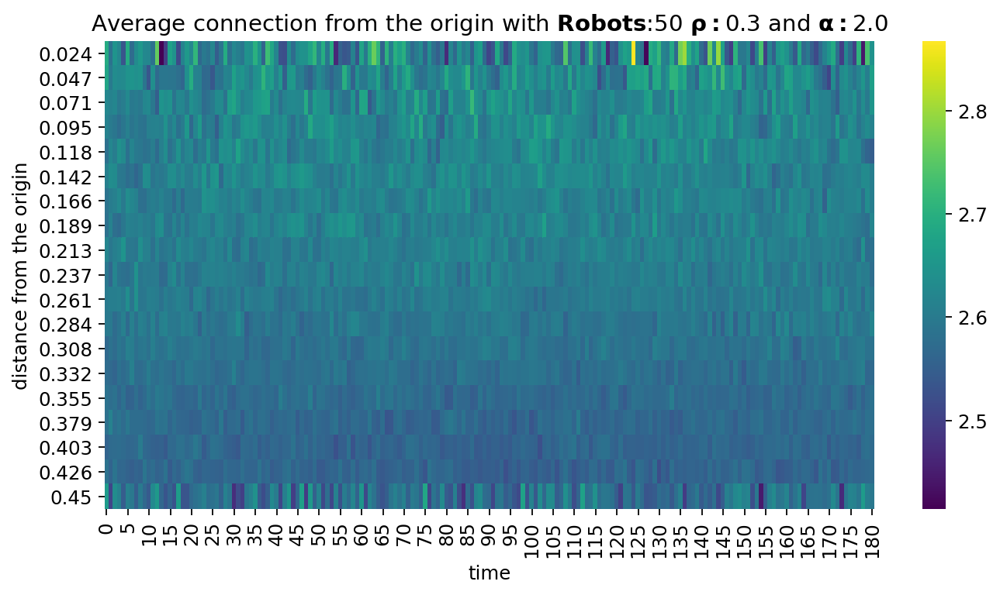

./results/ALL/Simulated/random_angle_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.8.png


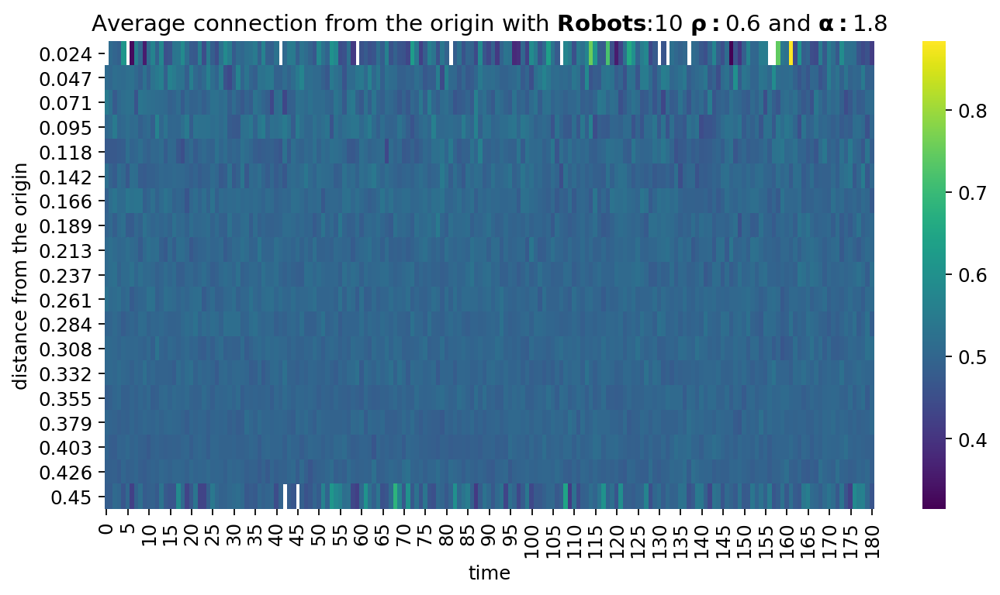

./results/ALL/Simulated/random_angle_100_runs/2020-07-03_robots#100_alpha#2.0_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_2.0.png


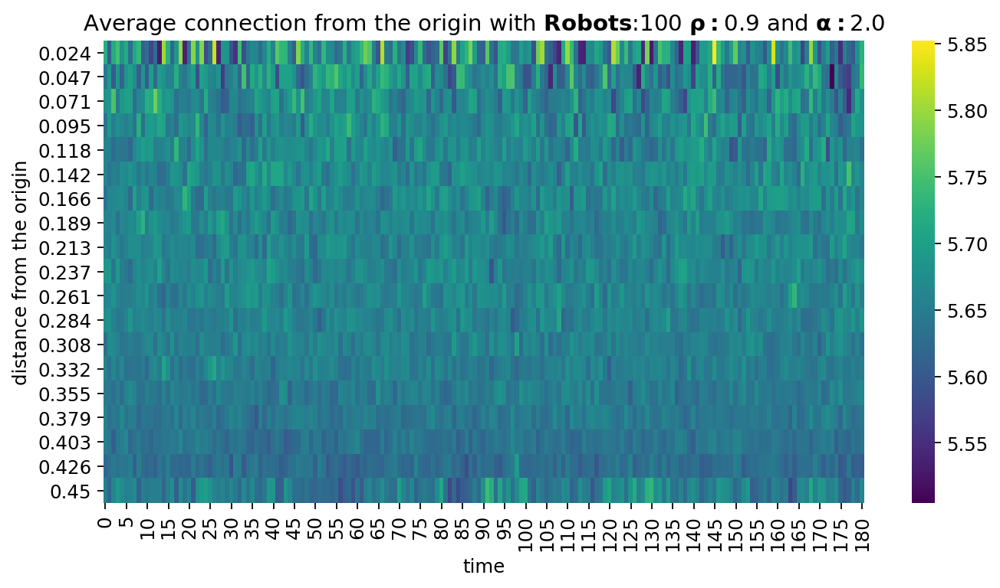

In [36]:
bin_edges = np.linspace(0, 0.45, 20)
randomAngle_folder = './results/ALL/Simulated/random_angle_100_runs'
avg_connection_degree_heatmap(randomAngle_folder)

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.6_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.6.png


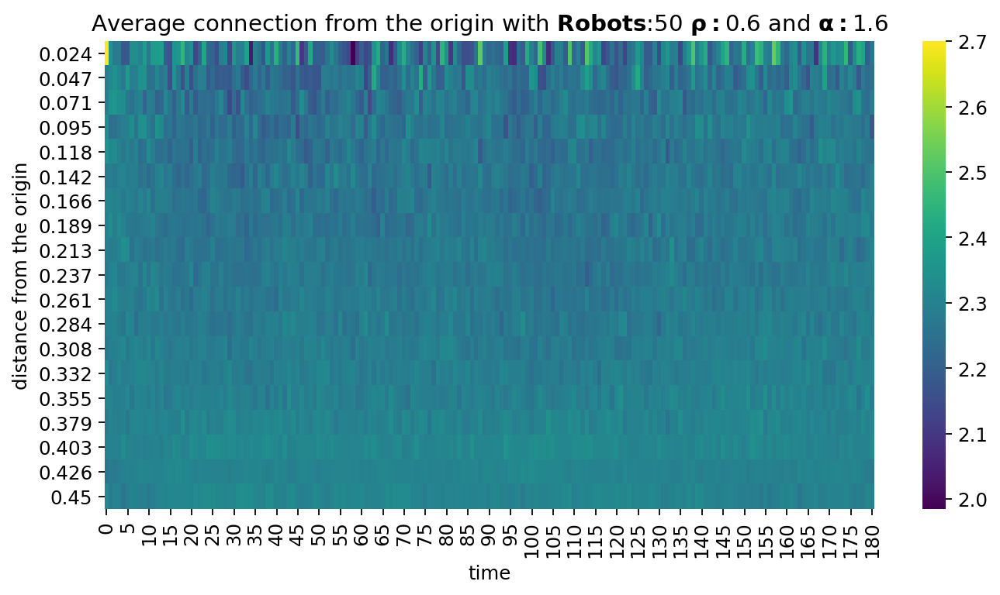

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.6_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.6.png


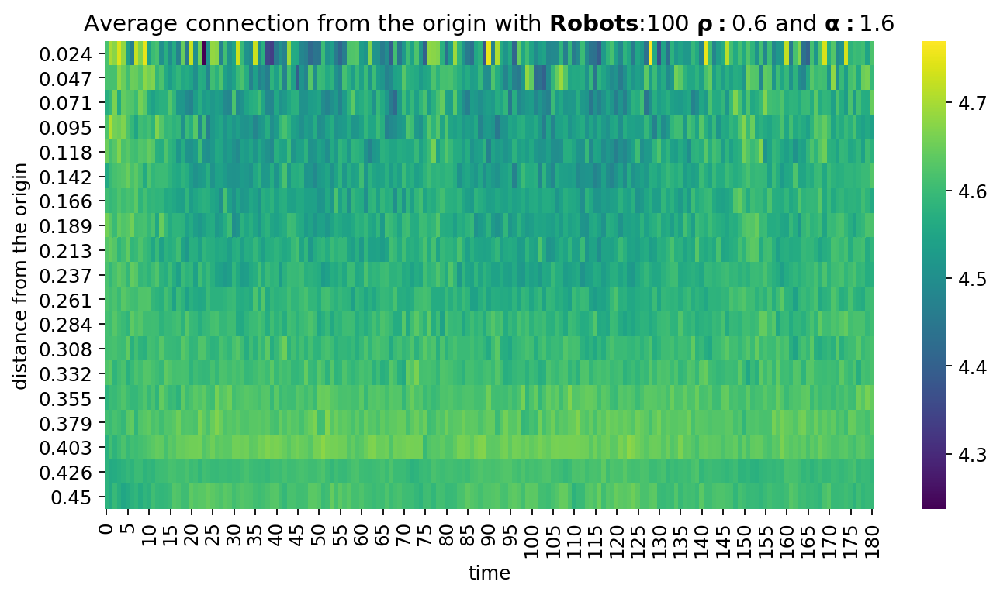

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.4.png


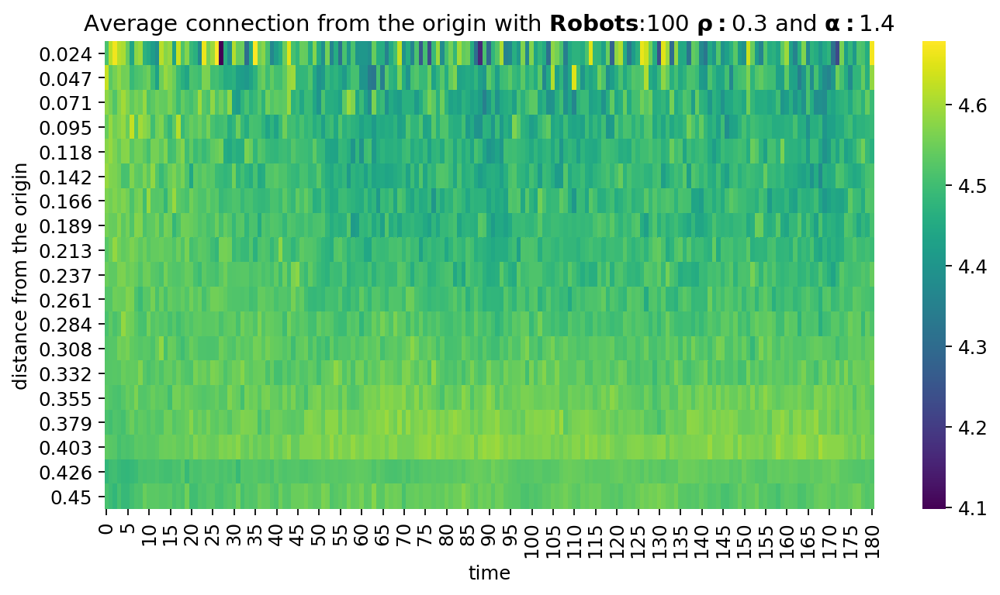

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.8.png


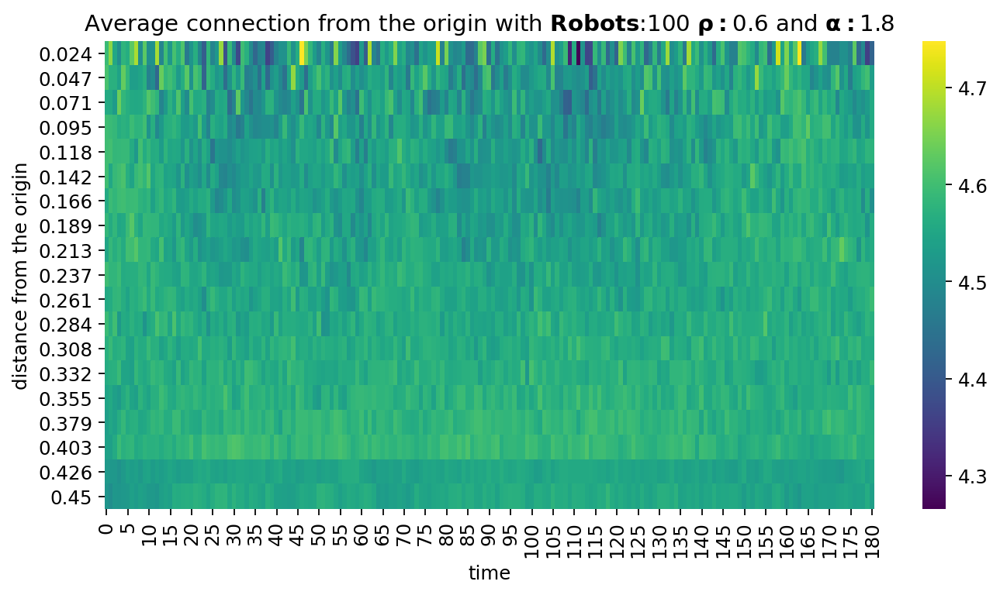

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.4.png


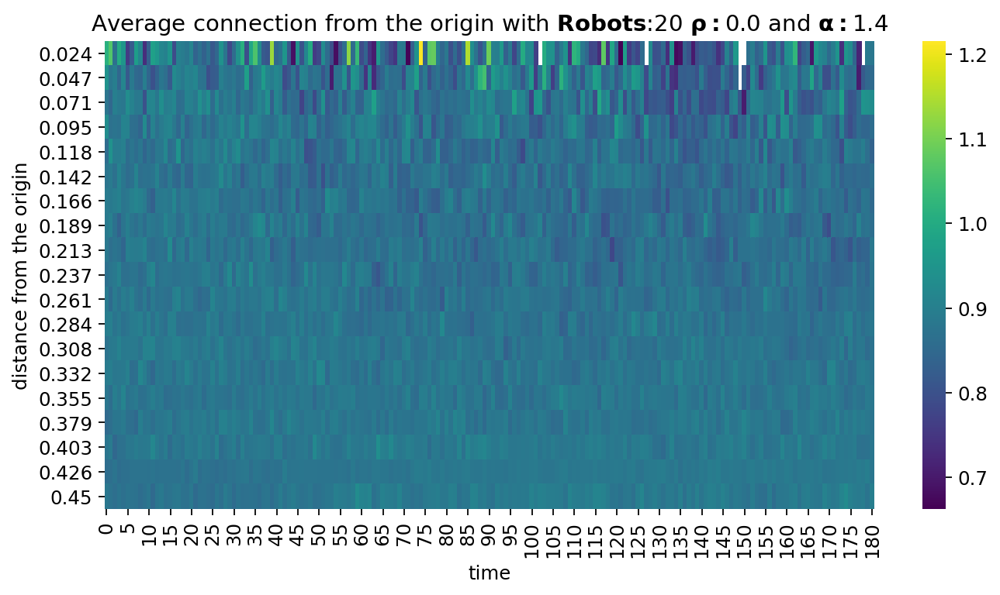

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.6_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.6.png


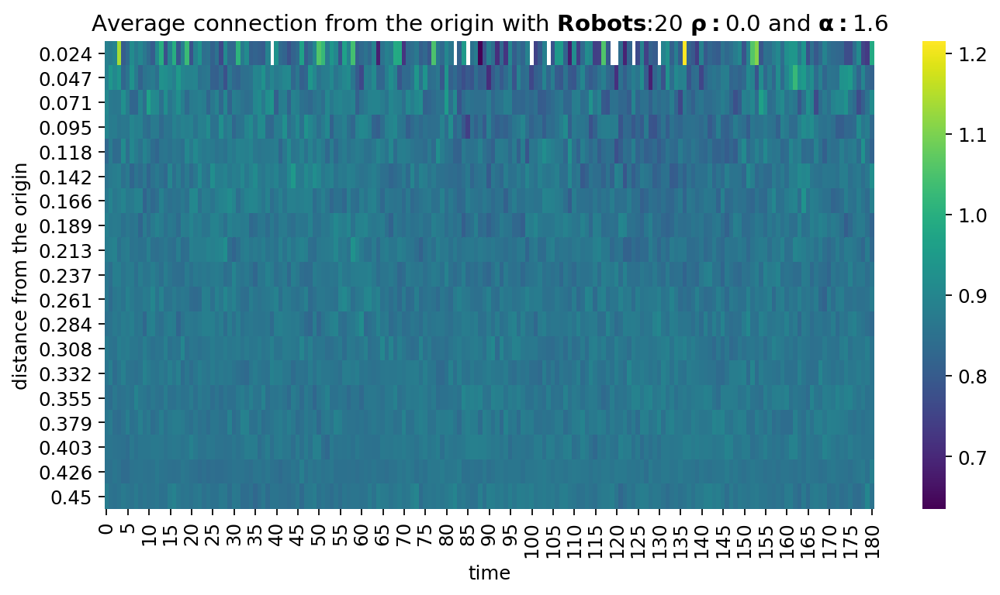

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.2_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.2.png


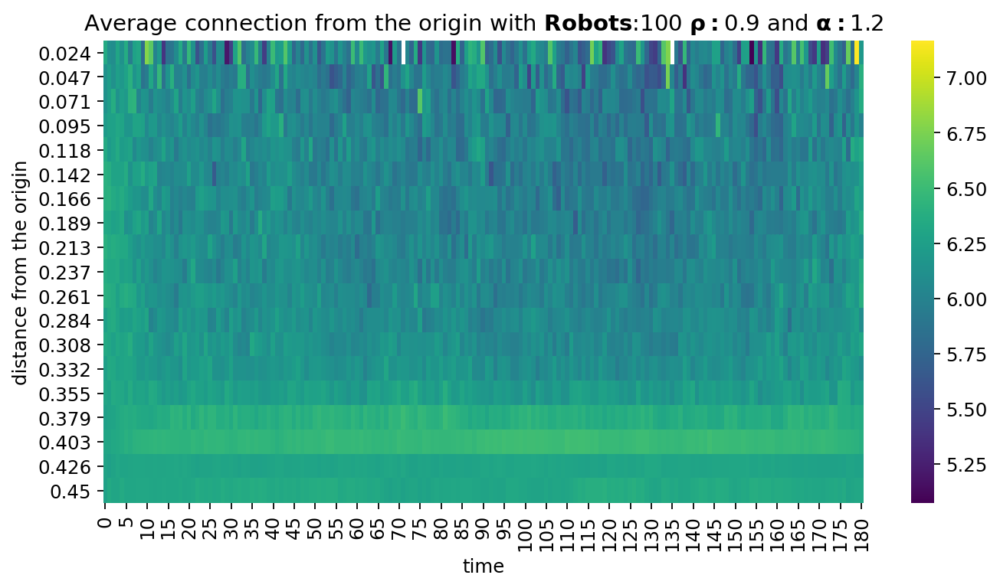

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.2_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.2.png


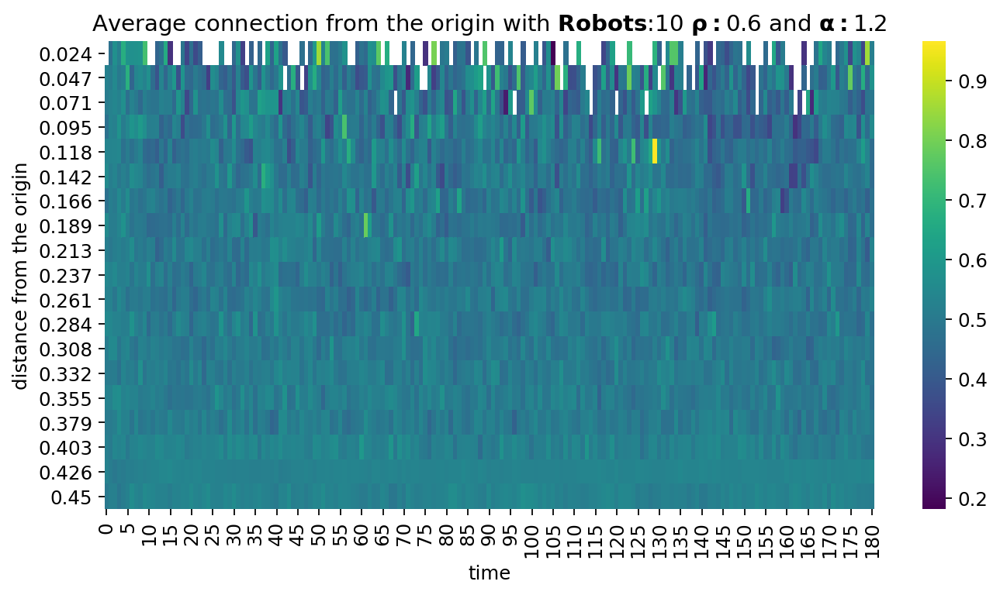

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.6_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.6.png


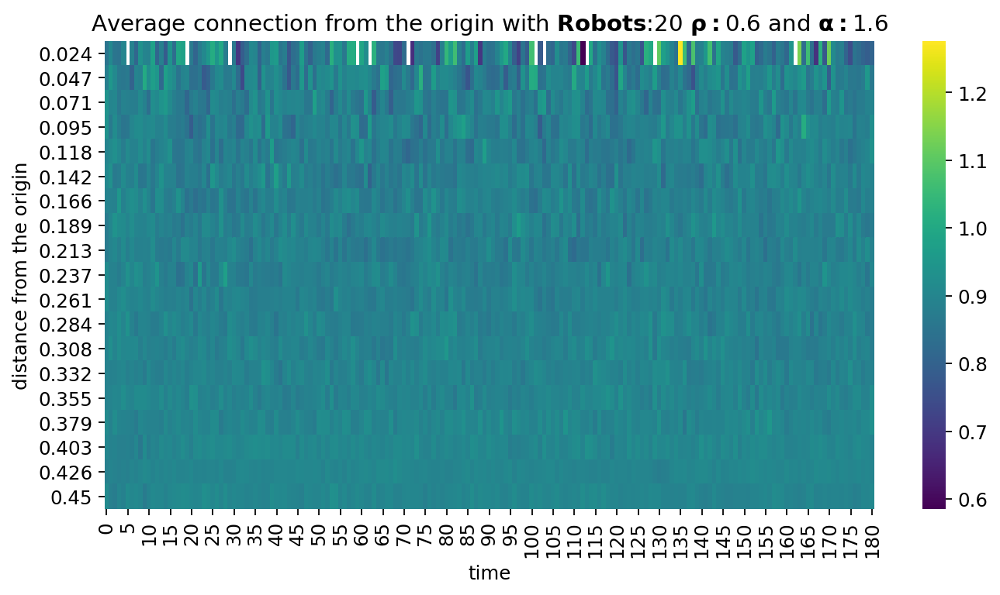

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#2.0_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_2.0.png


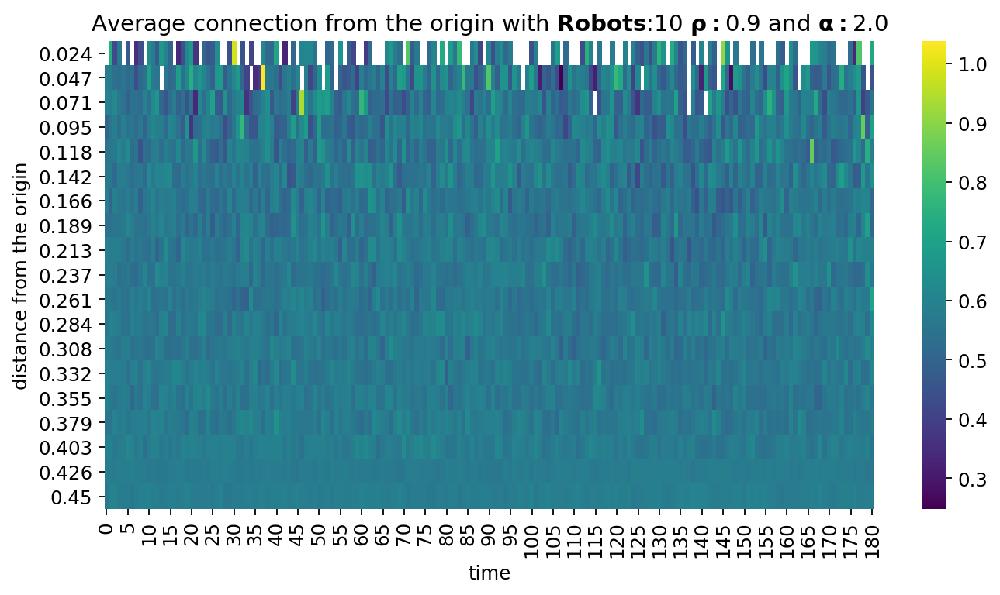

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.4.png


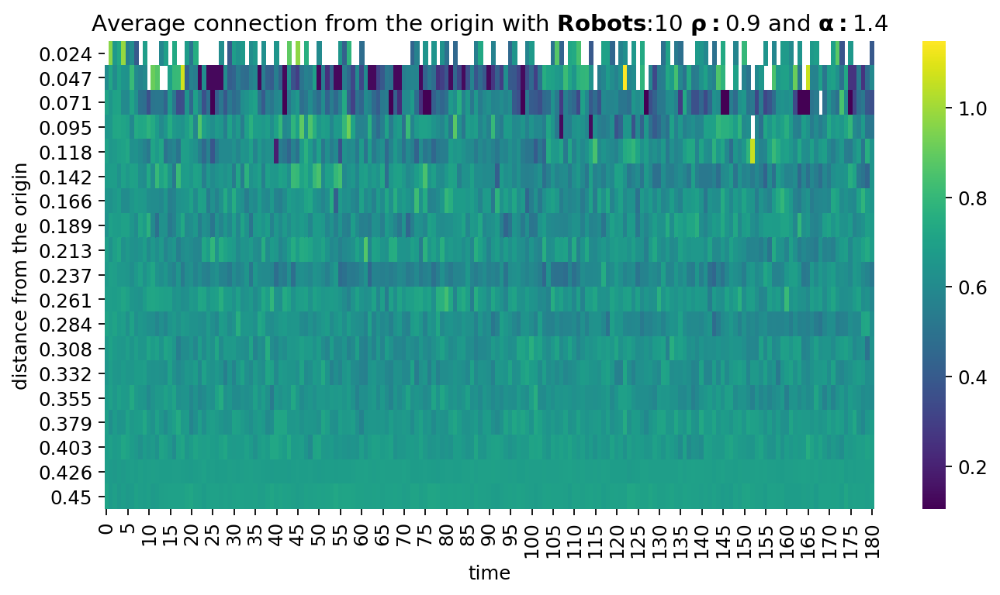

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#2.0_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_2.0.png


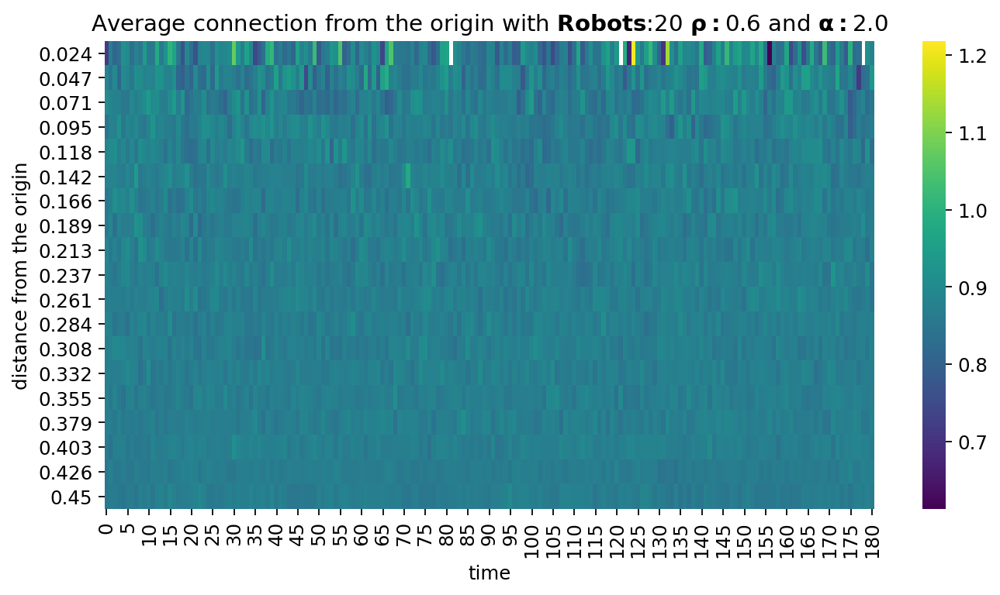

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.4.png


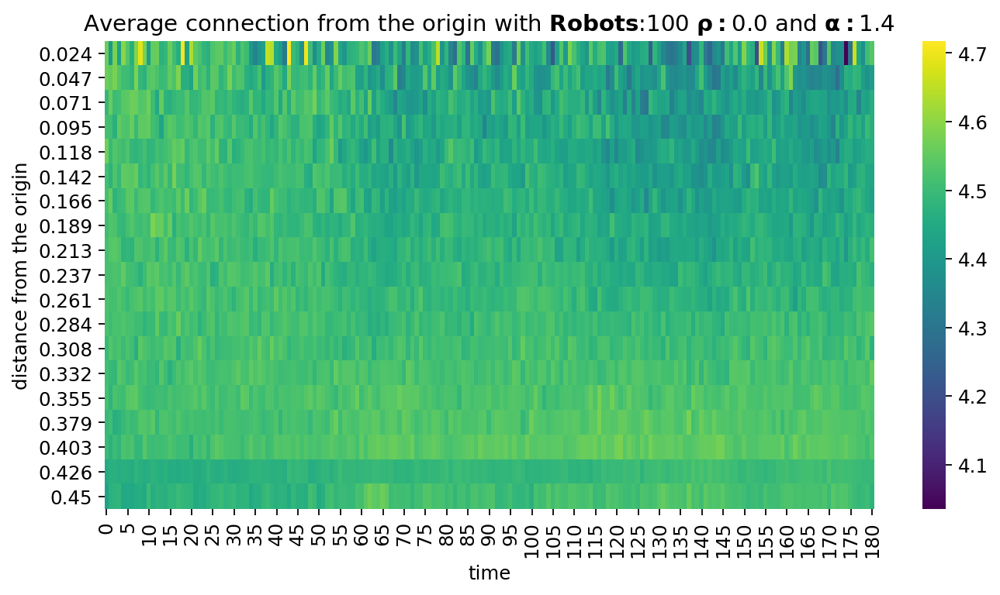

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#2.0_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_2.0.png


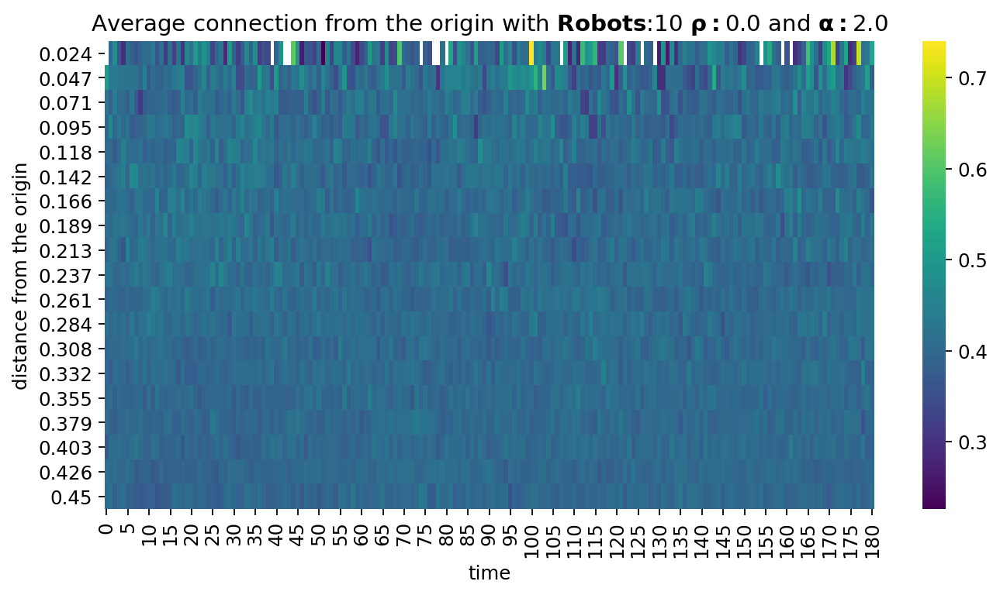

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#2.0_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_2.0.png


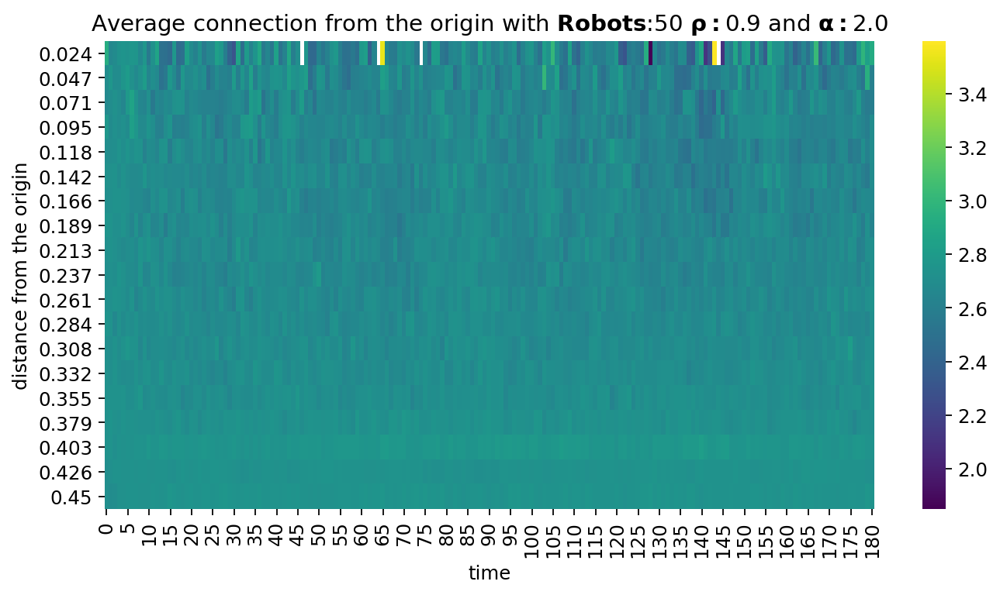

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.4.png


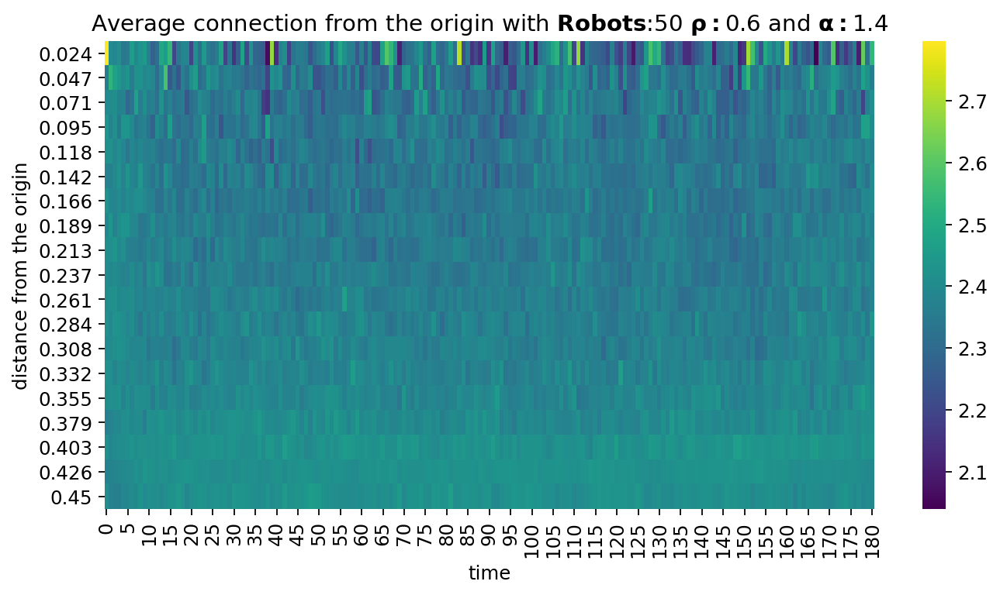

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#2.0_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_2.0.png


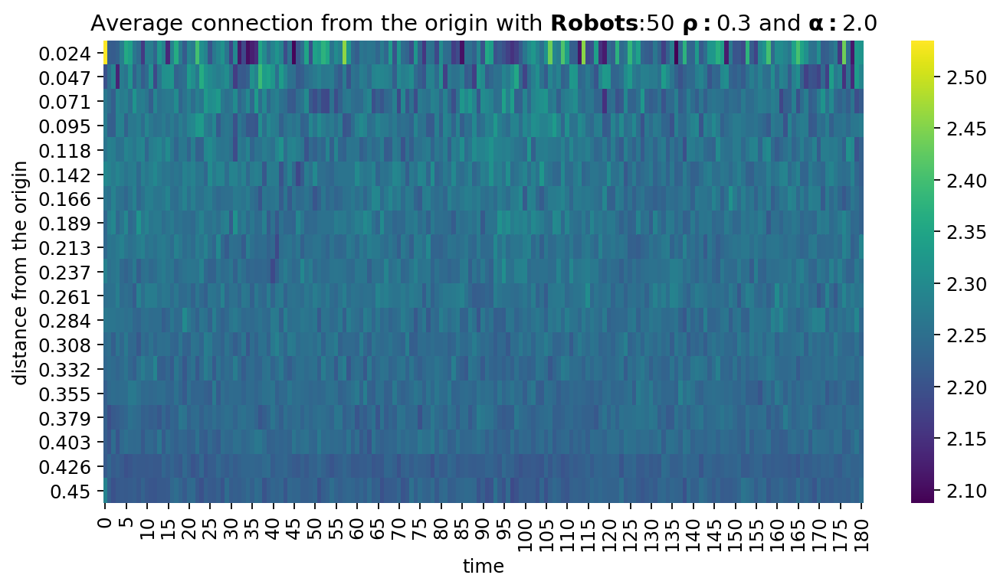

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.6_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.6.png


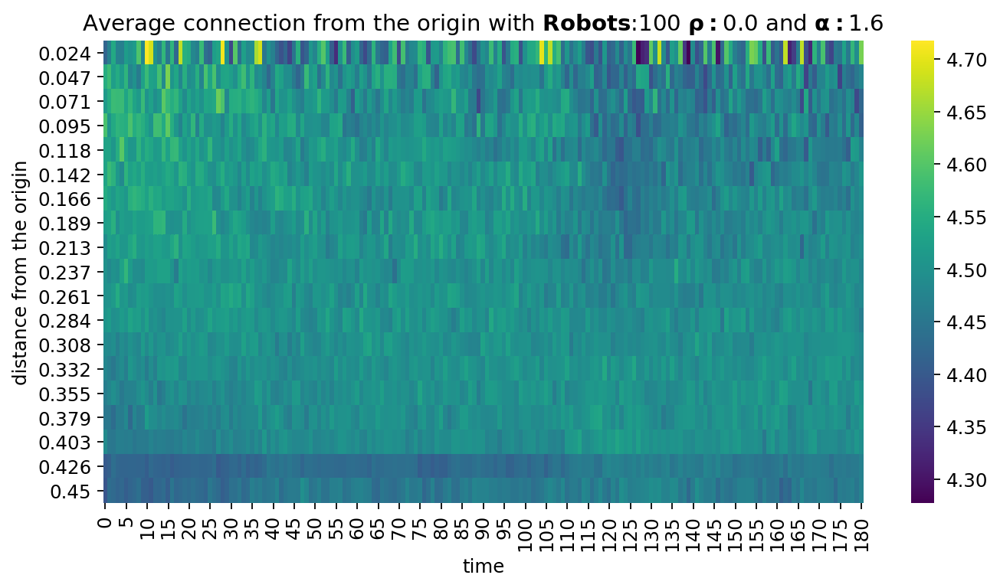

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.8.png


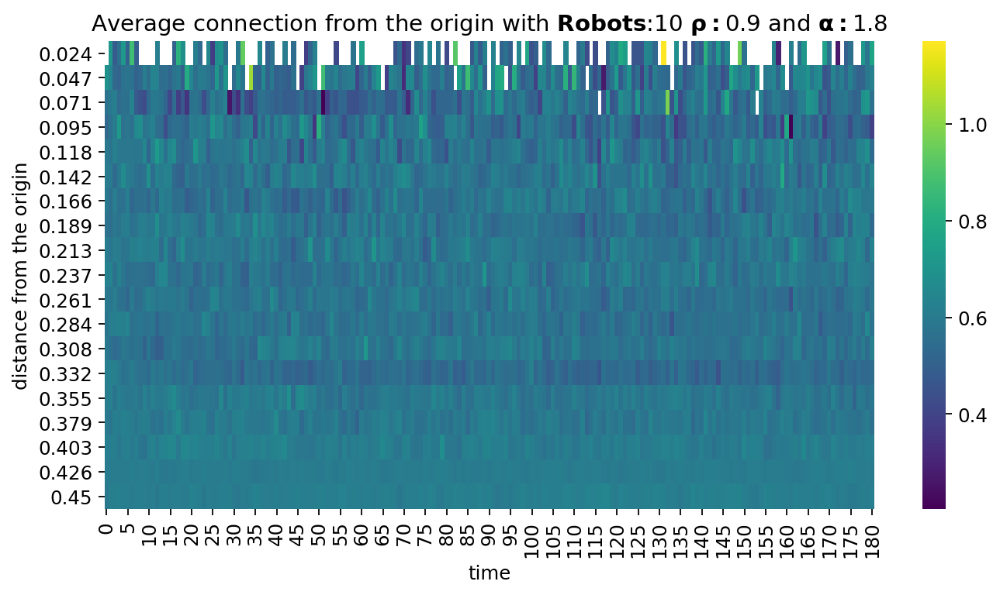

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.4.png


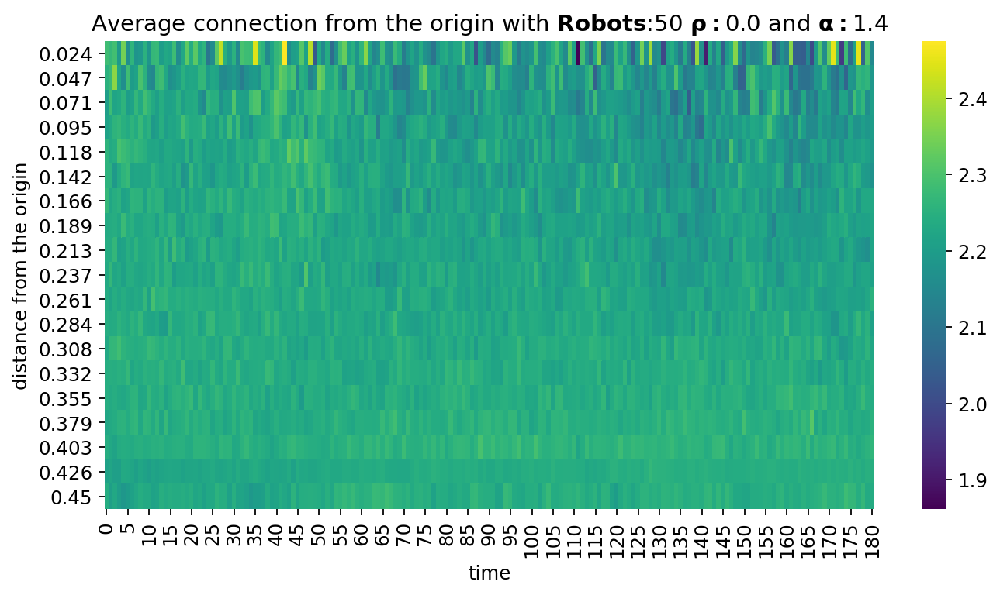

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.6_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.6.png


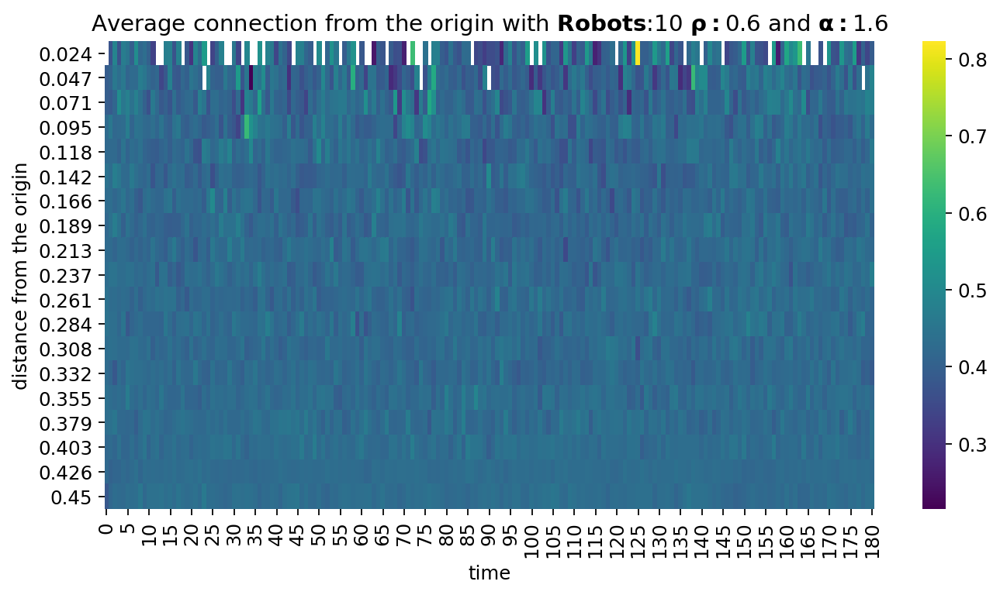

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.2_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.2.png


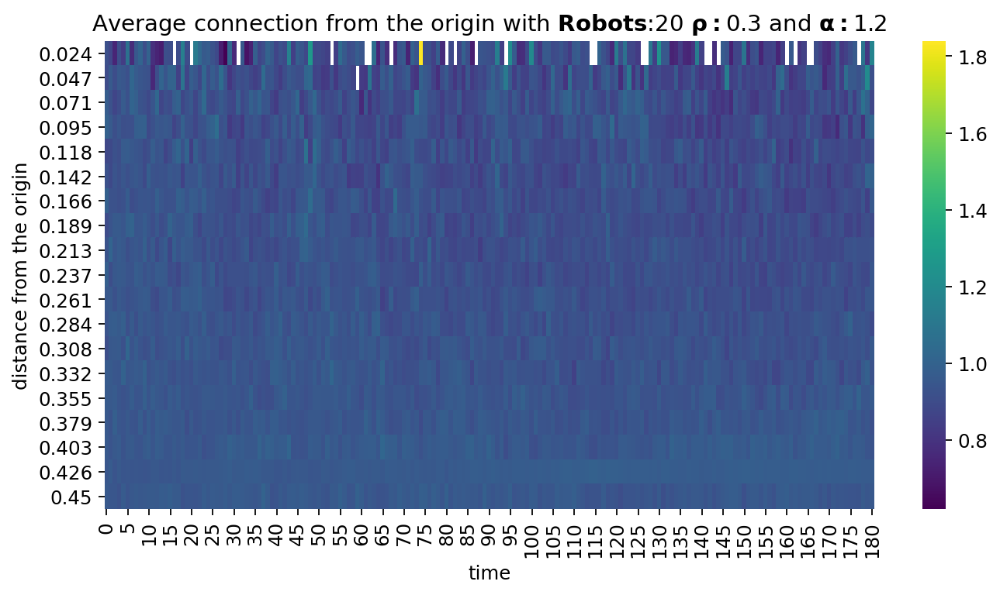

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.2_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.2.png


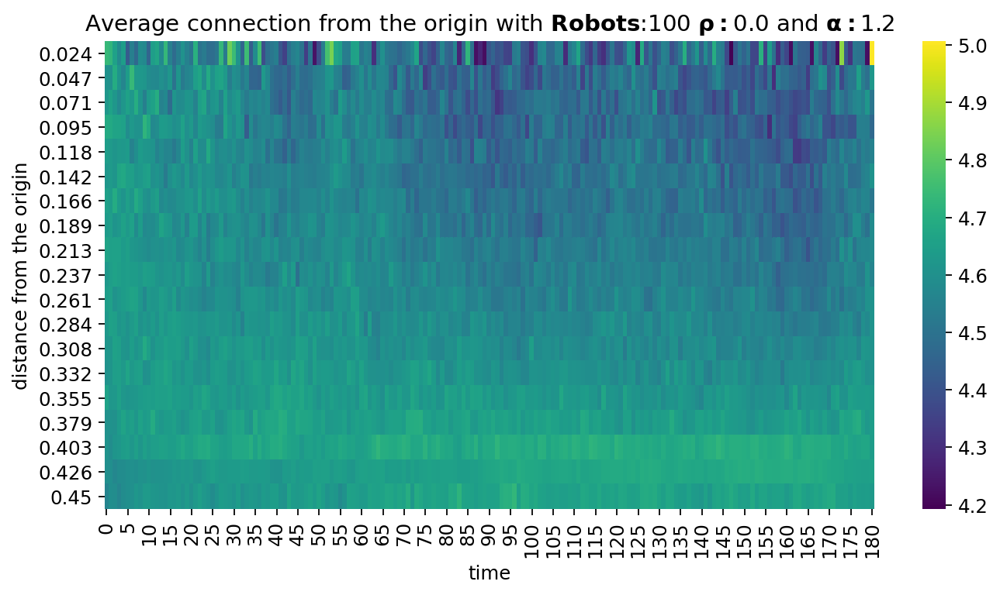

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.4.png


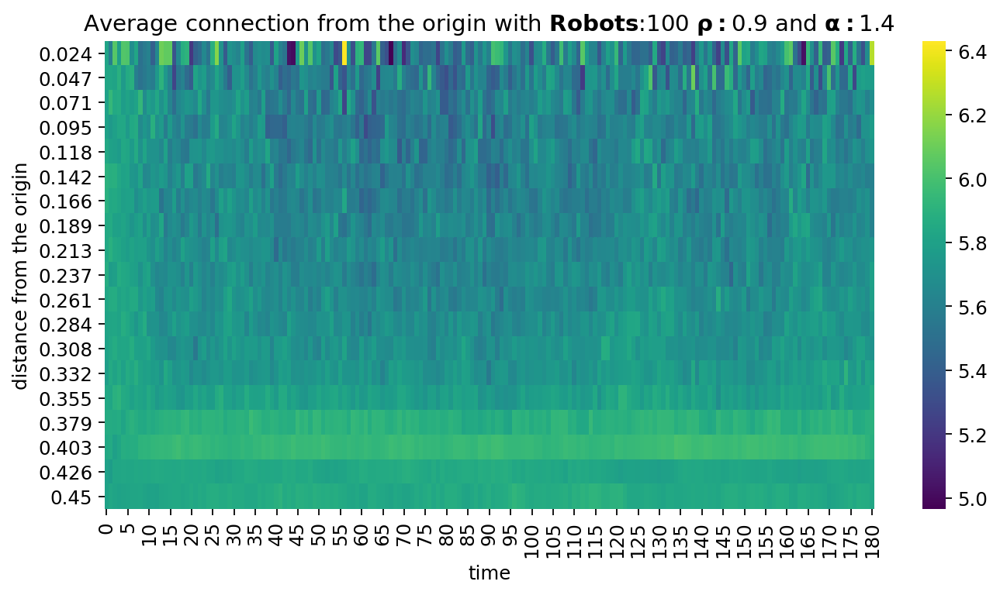

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.2_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.2.png


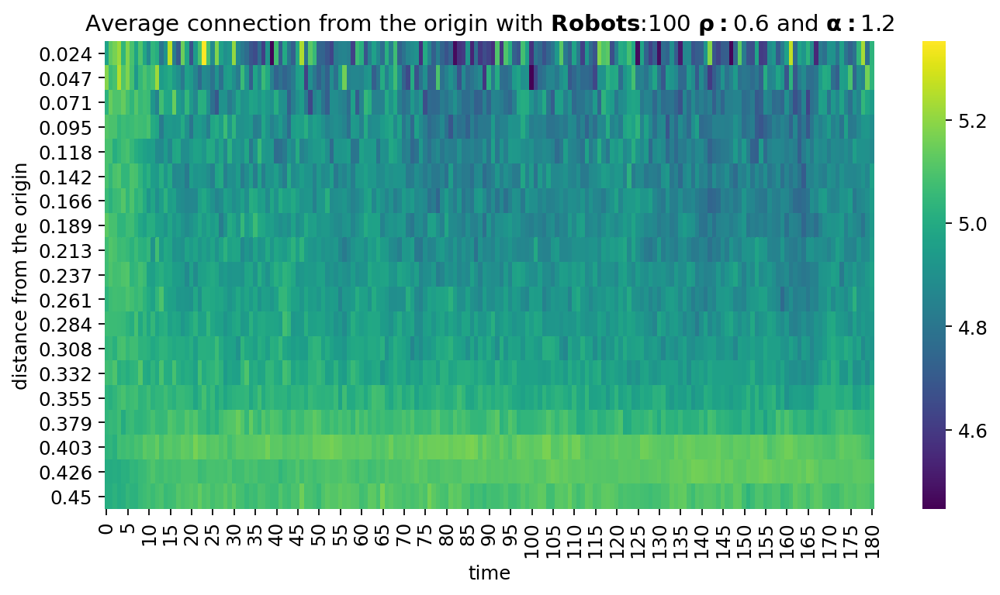

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.8.png


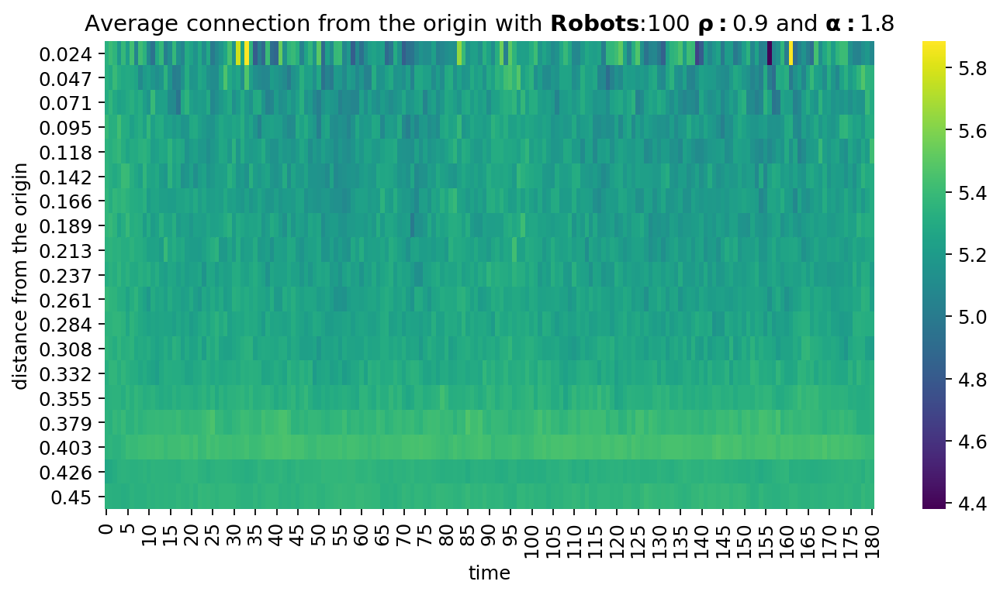

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.8.png


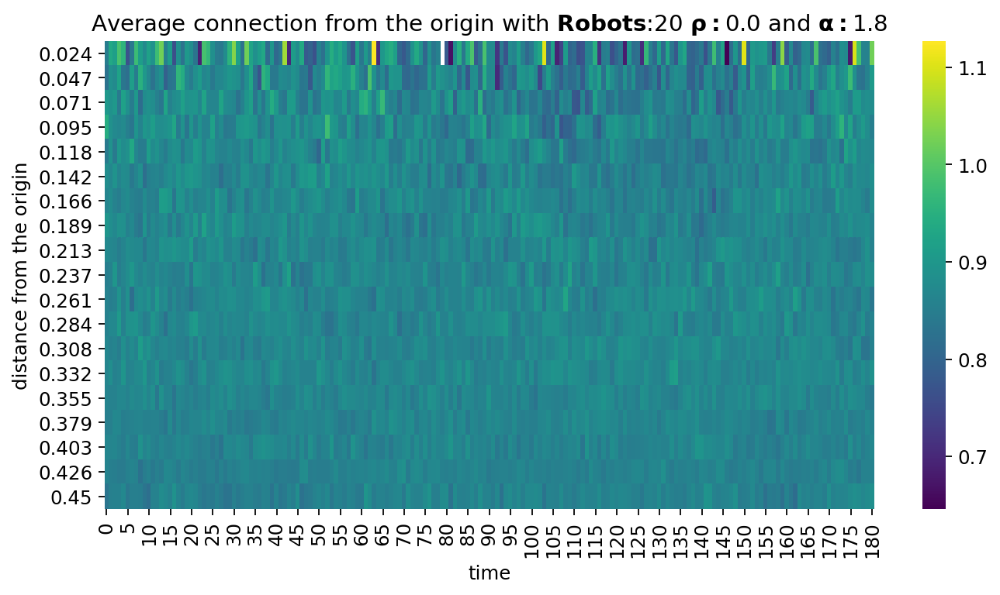

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.8.png


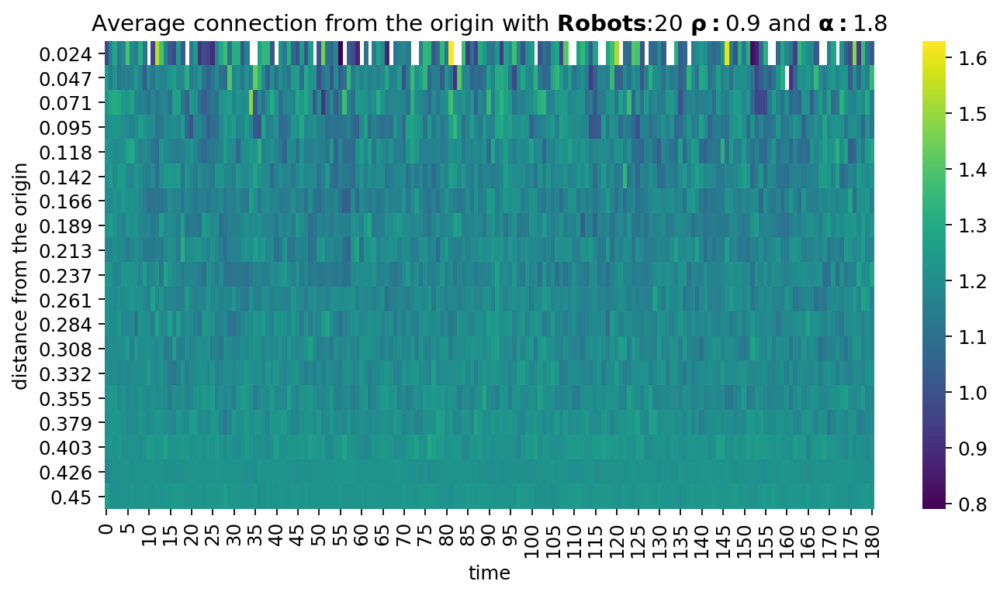

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.6_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.6.png


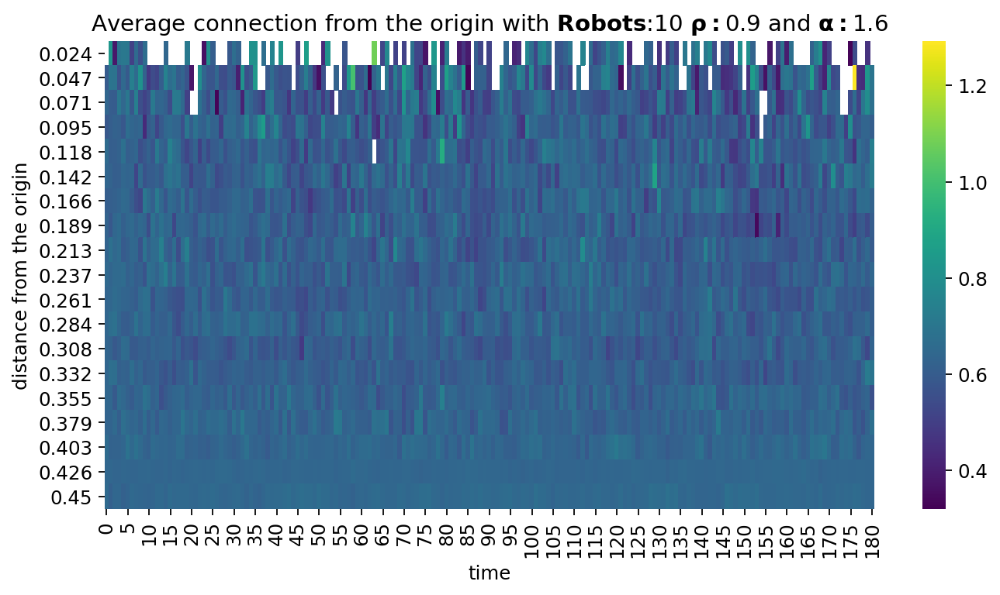

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.6_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.6.png


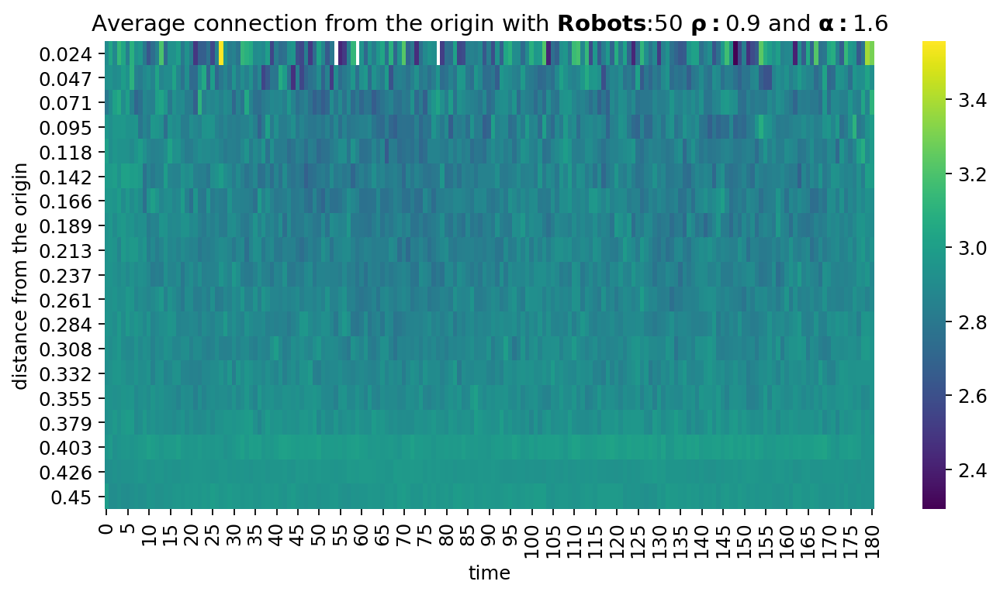

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.8.png


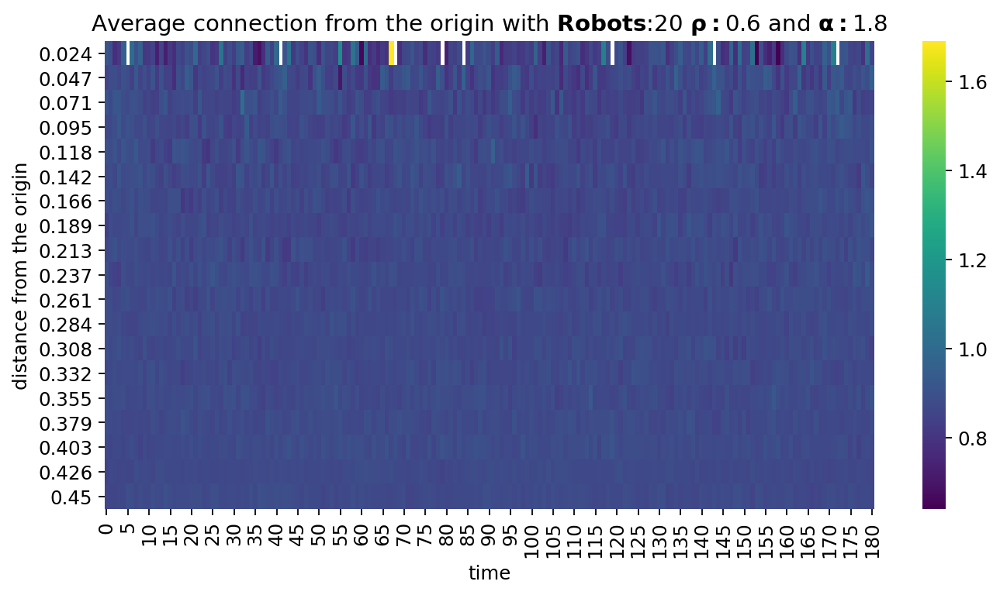

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.6_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.6.png


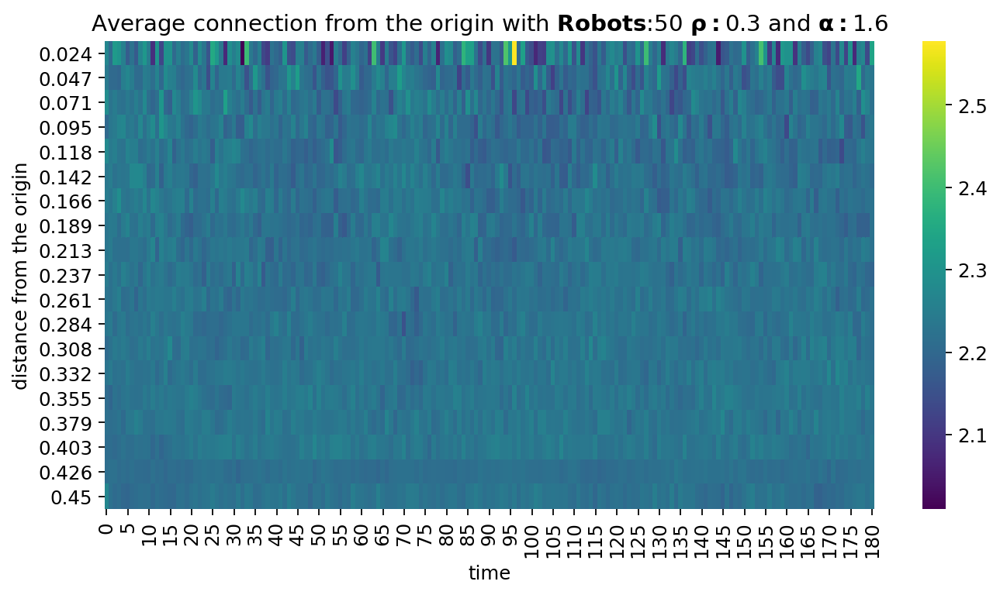

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.8.png


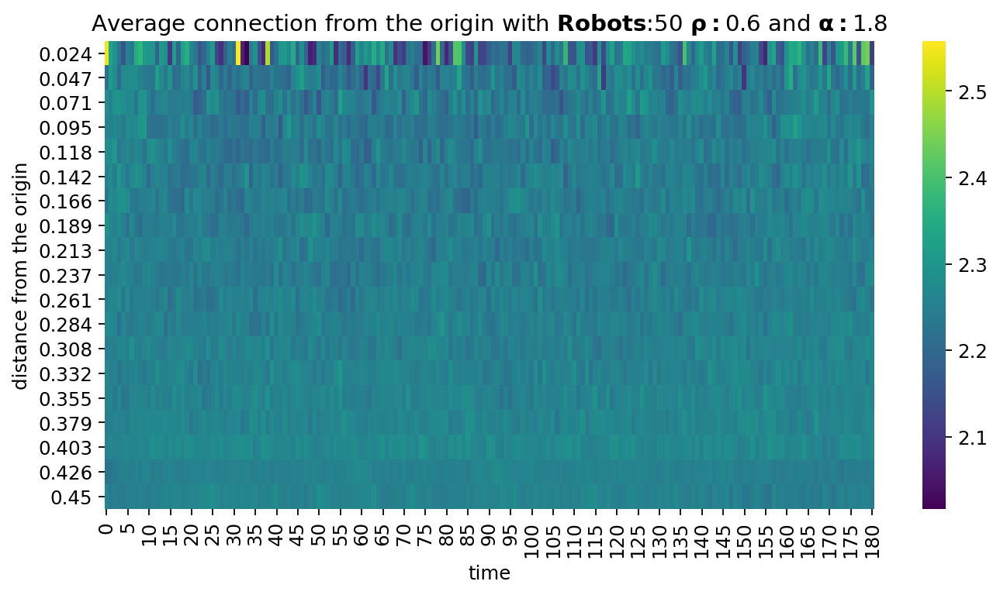

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.6_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.6.png


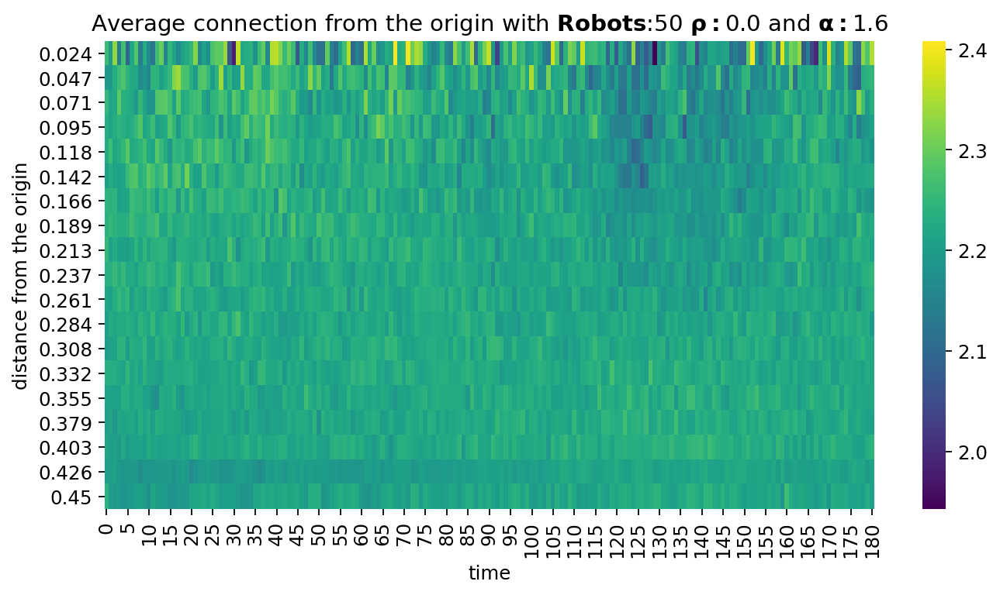

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.2_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.2.png


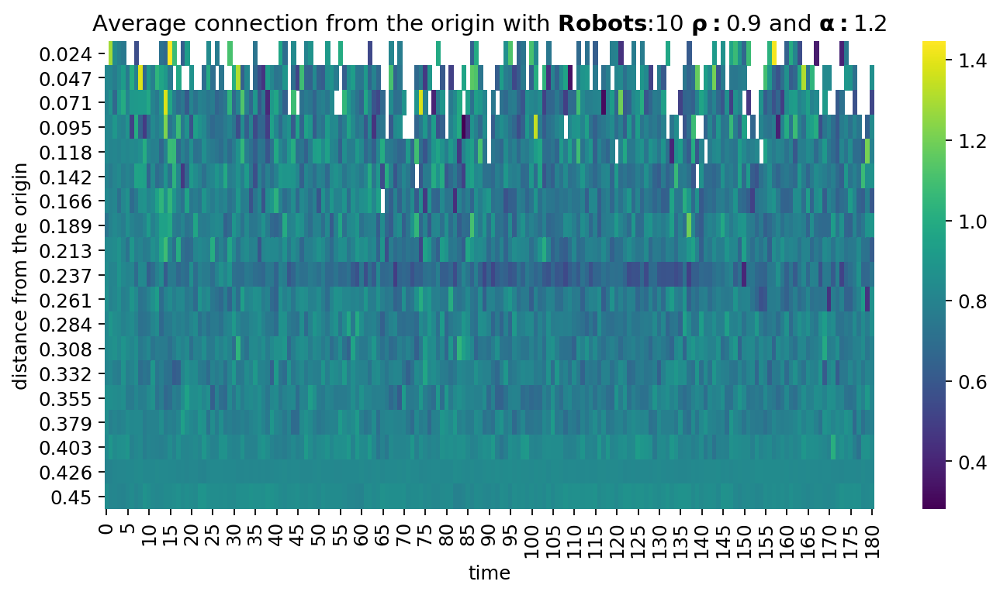

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.8.png


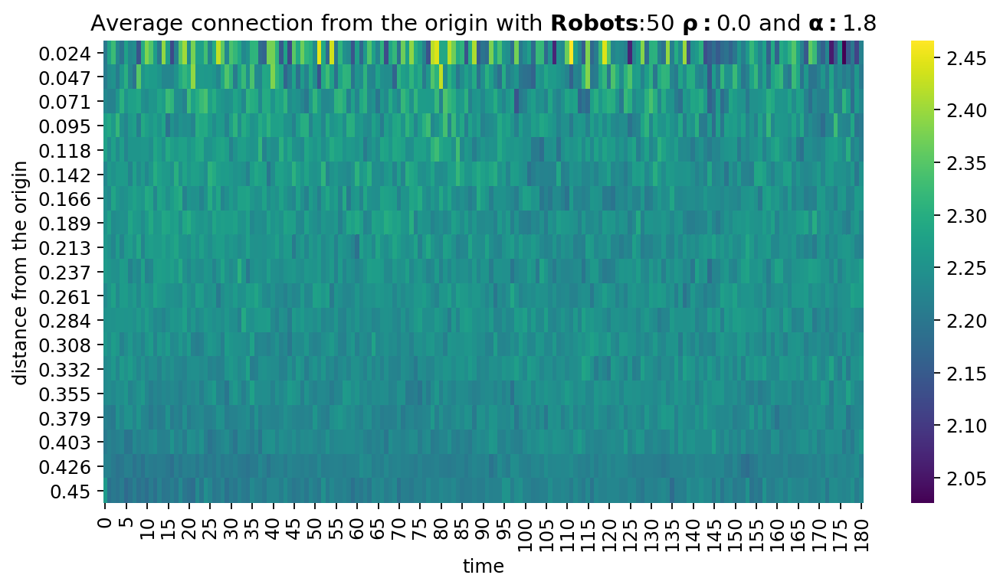

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.2_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.2.png


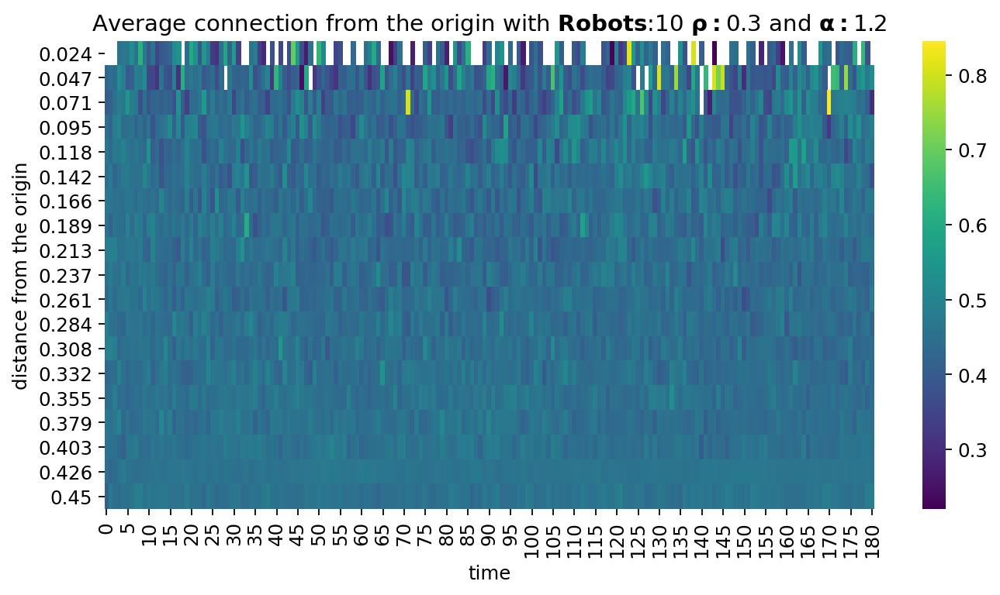

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.8_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.8.png


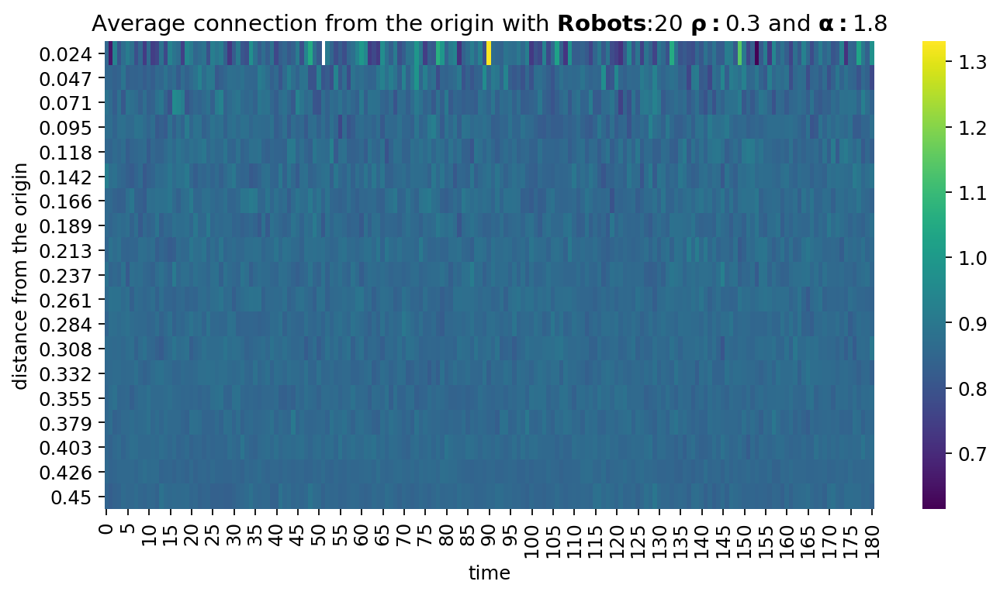

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#2.0_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_2.0.png


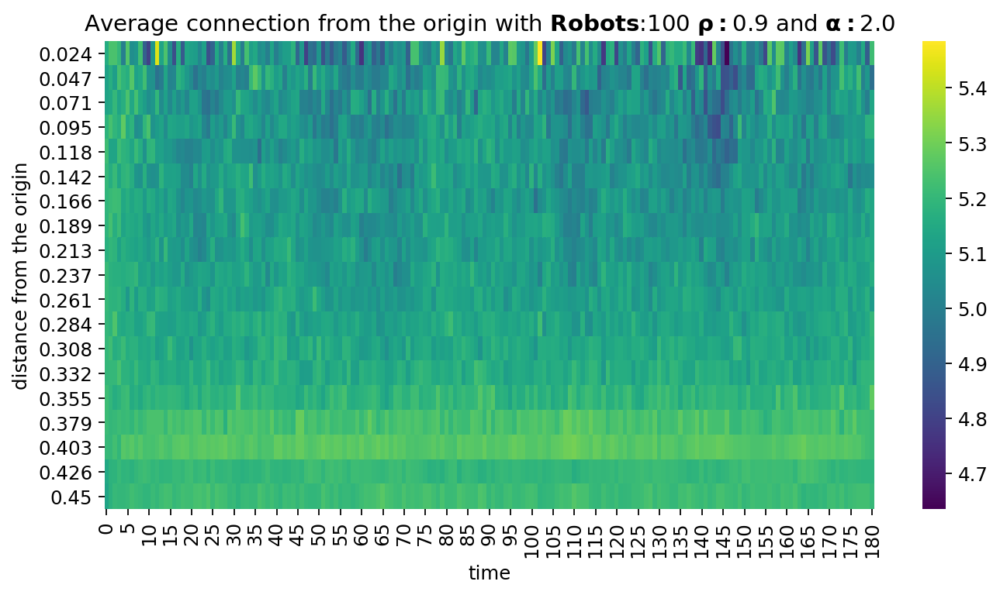

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#2.0_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)
Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_2.0.png


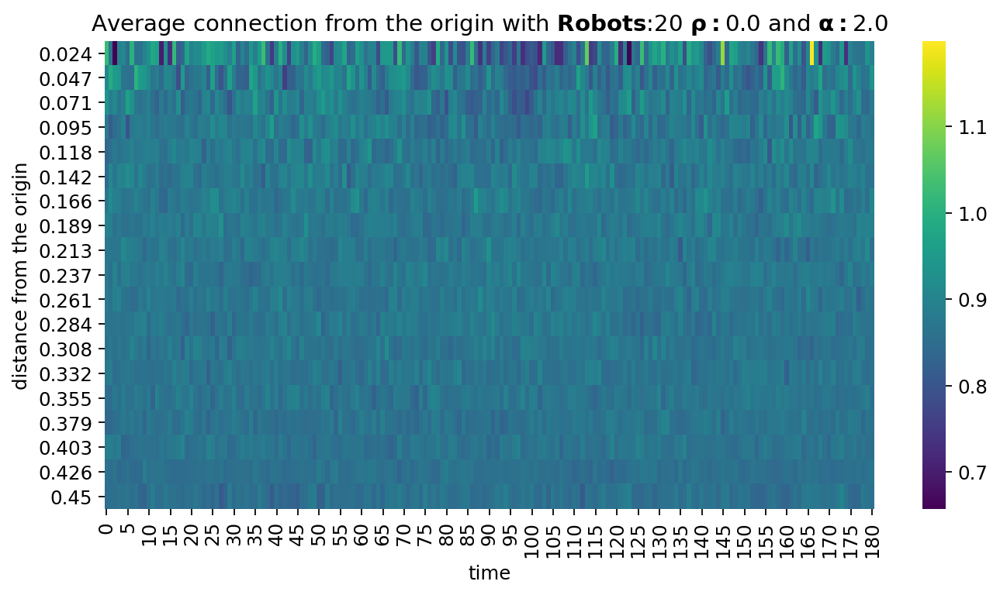

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#2.0_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_2.0.png


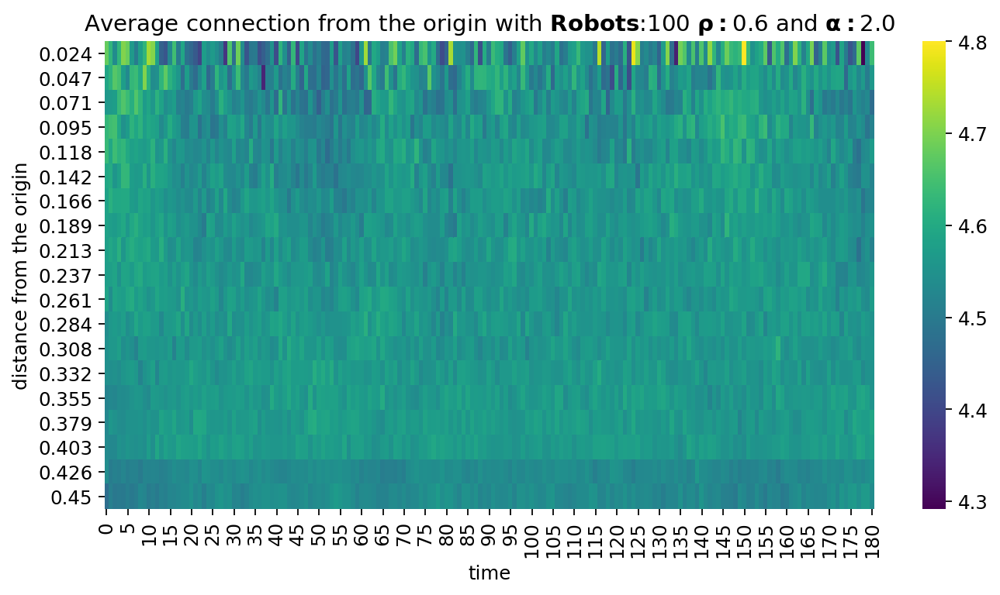

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.2_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.2.png


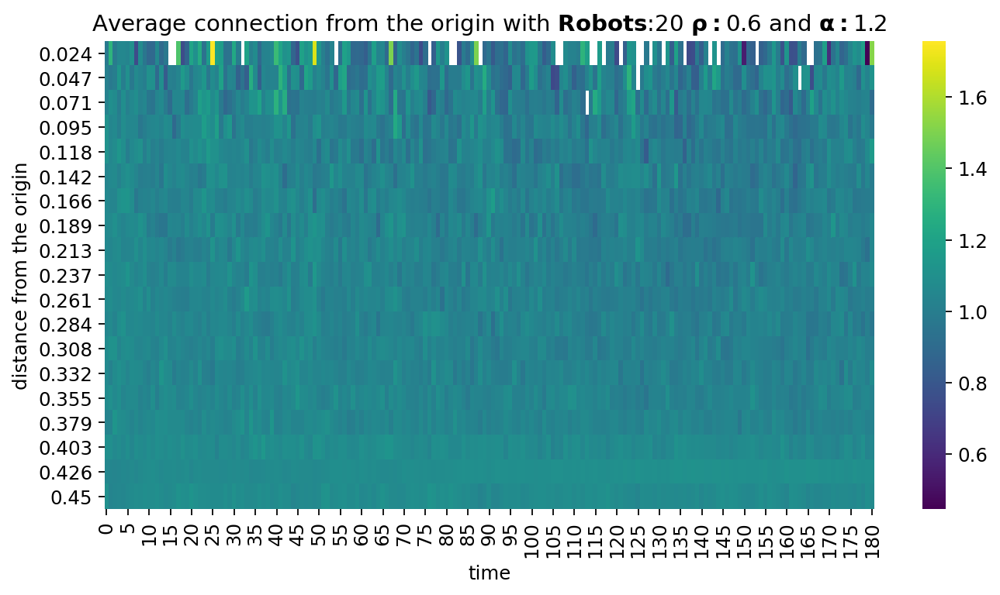

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.2_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.2.png


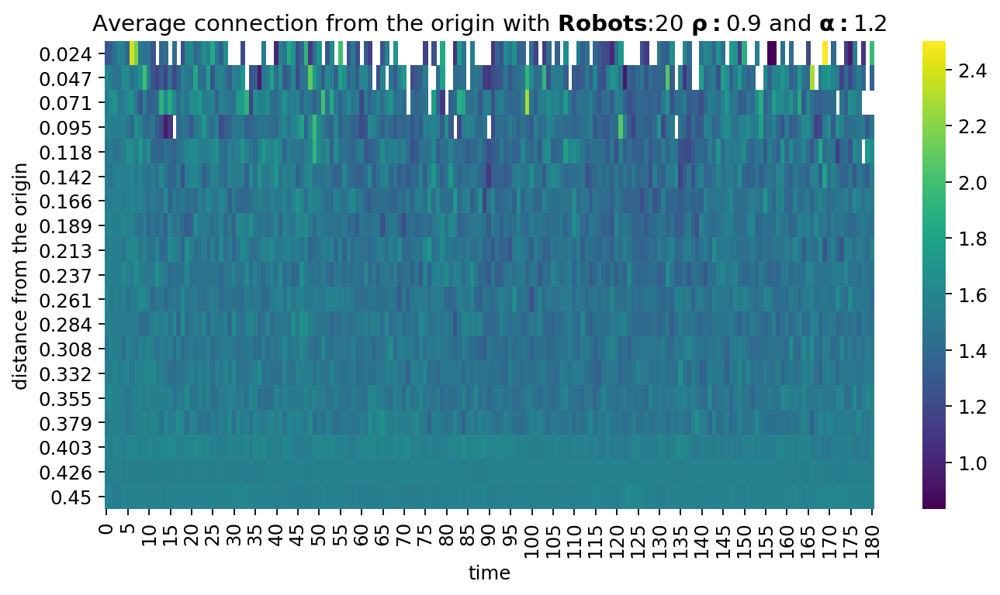

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.4.png


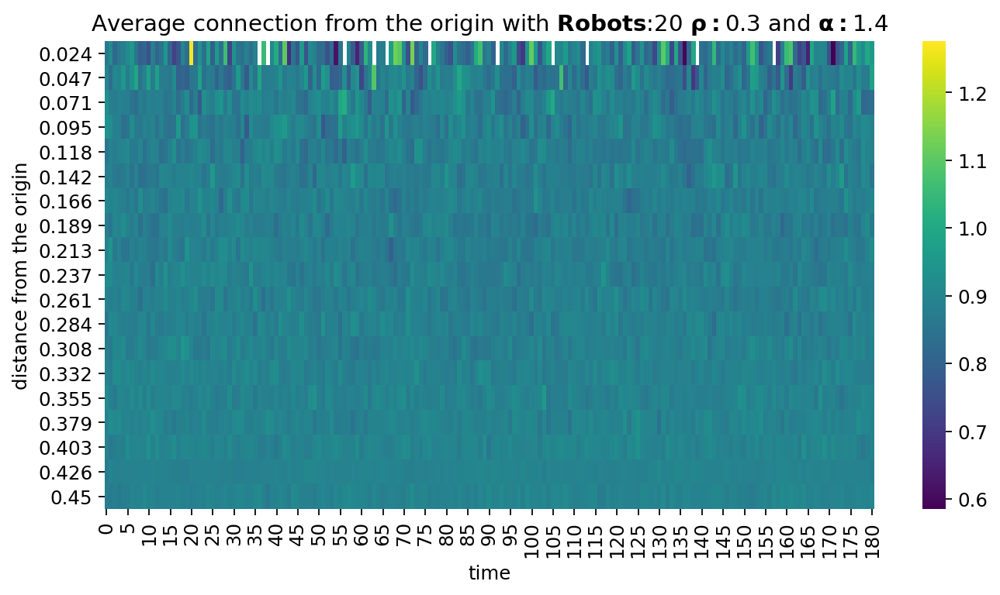

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.2_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.2.png


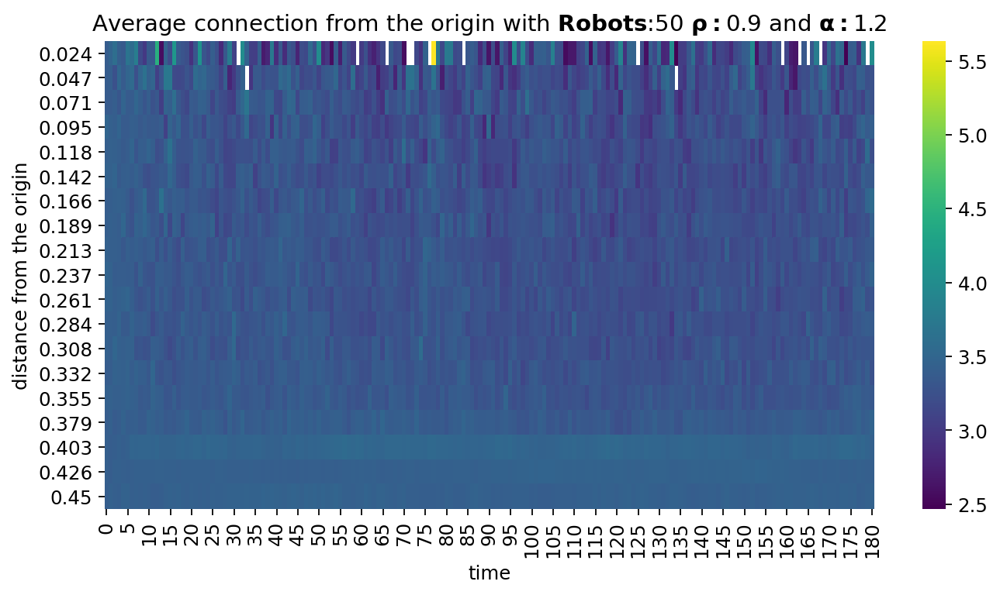

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.2_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.2.png


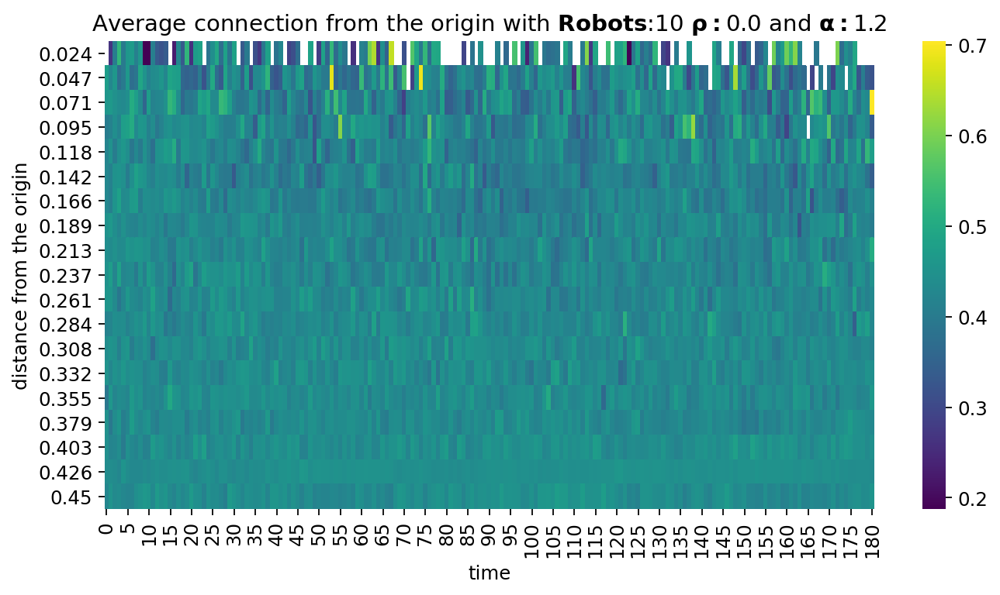

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#2.0_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_2.0.png


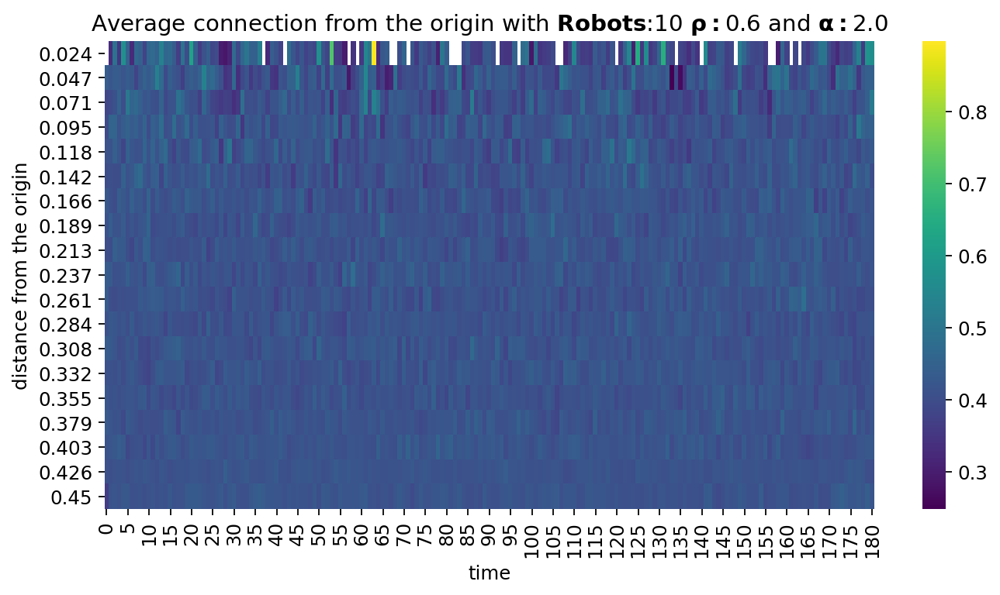

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#2.0_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_2.0.png


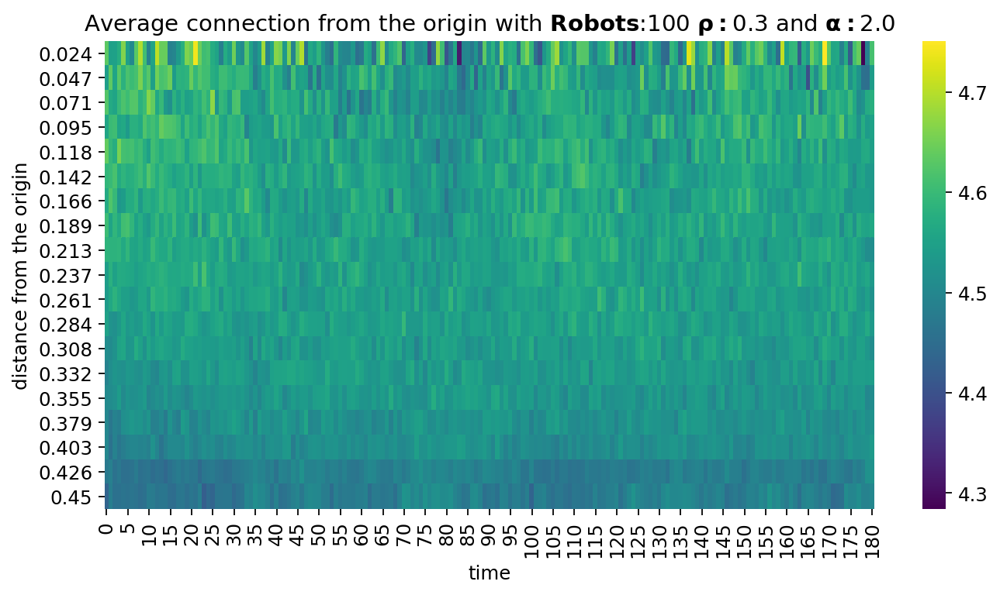

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.8.png


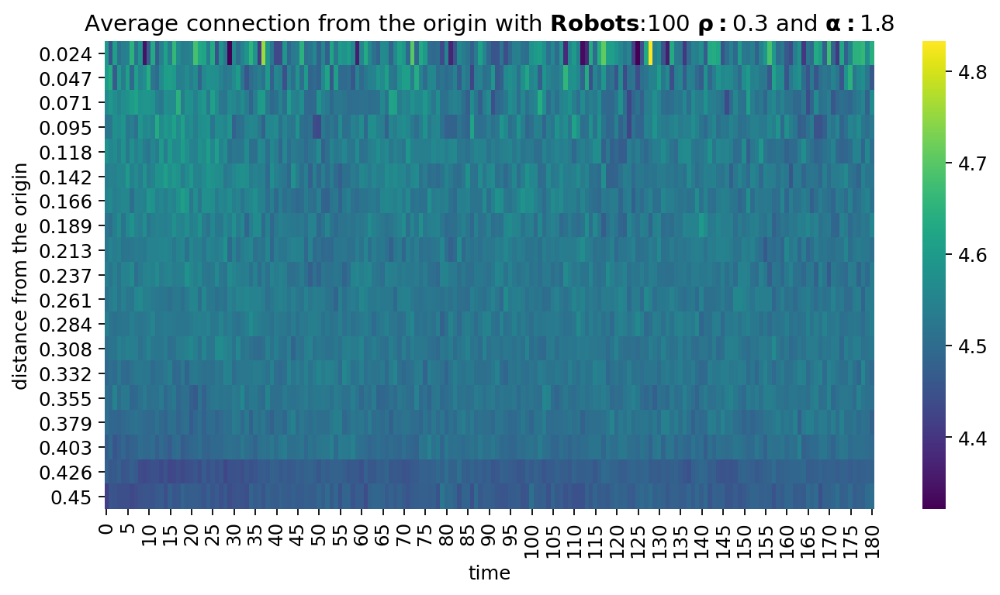

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.4.png


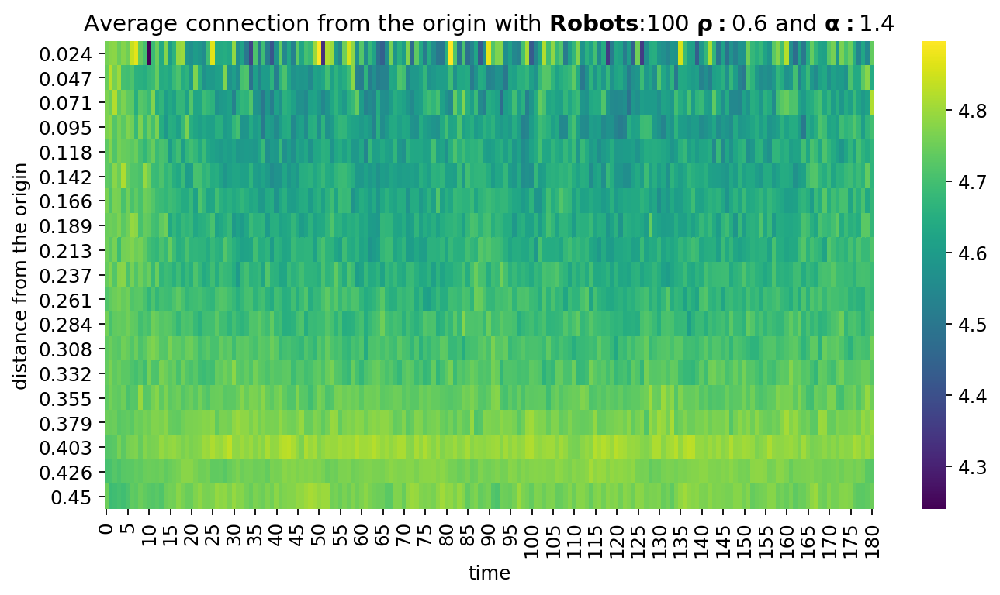

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.6_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.6.png


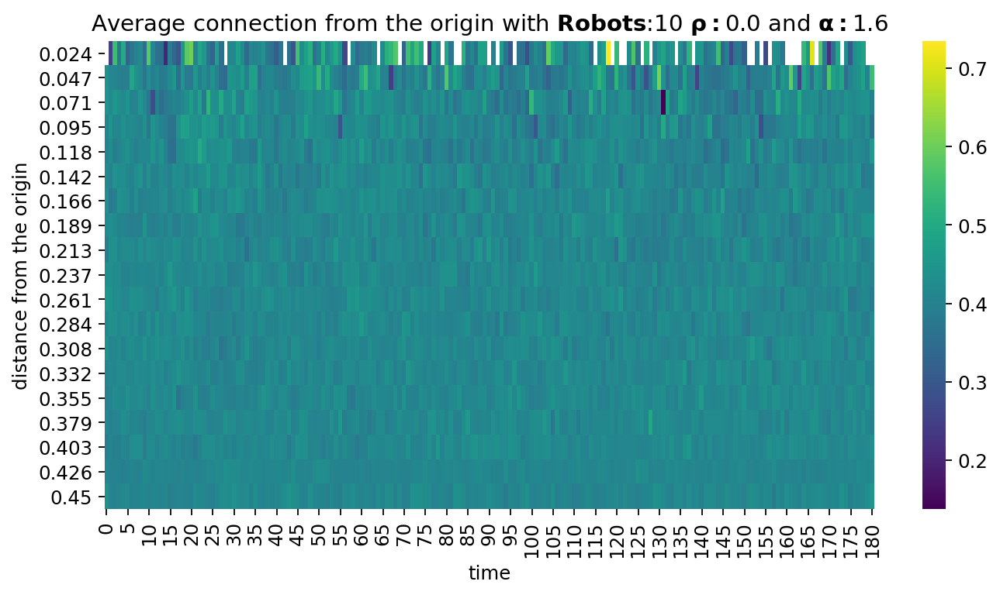

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.6_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.6.png


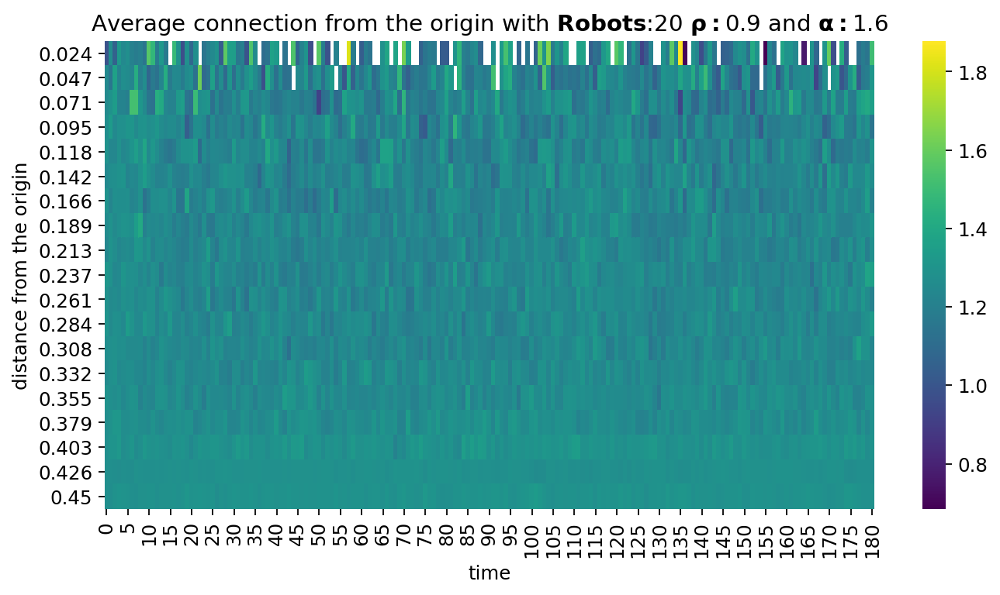

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.4.png


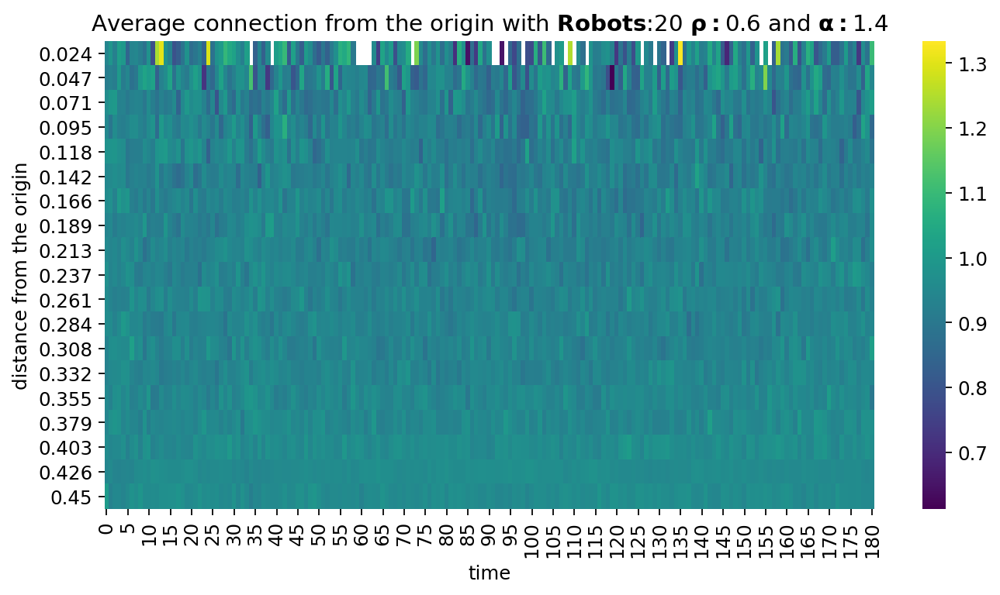

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.4.png


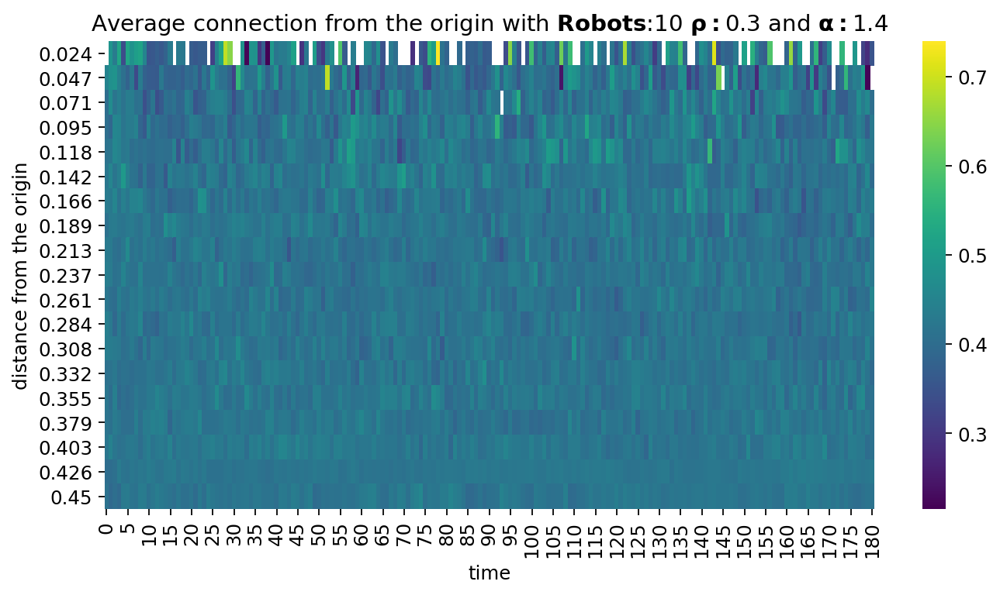

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.2_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.2.png


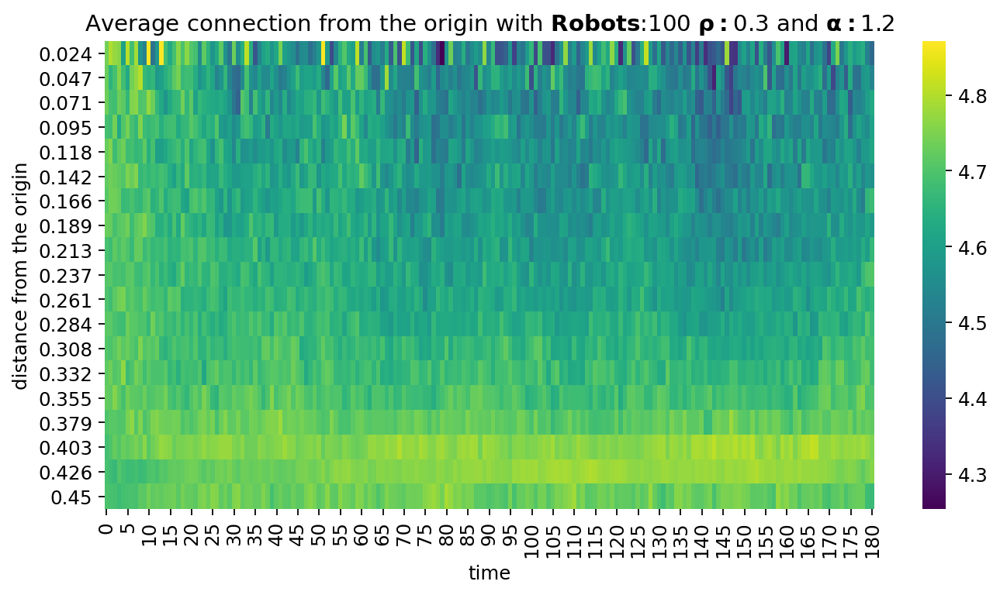

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#2.0_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_2.0.png


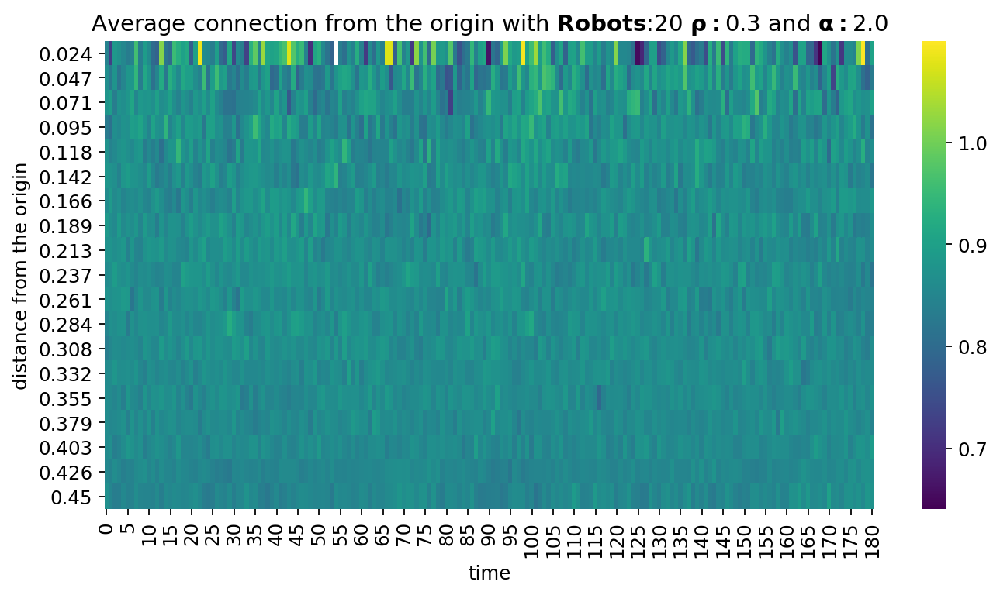

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.8.png


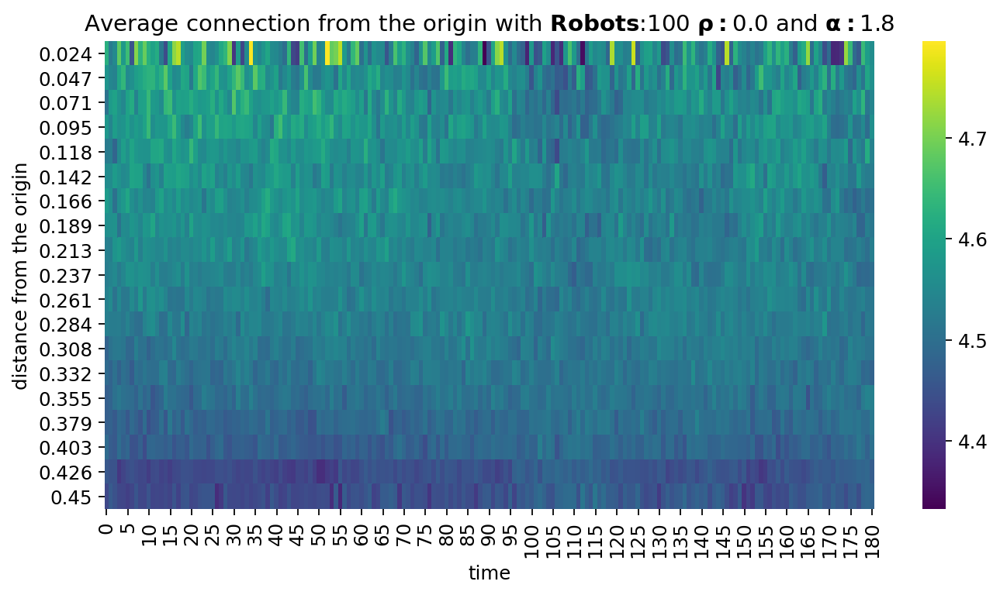

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.8.png


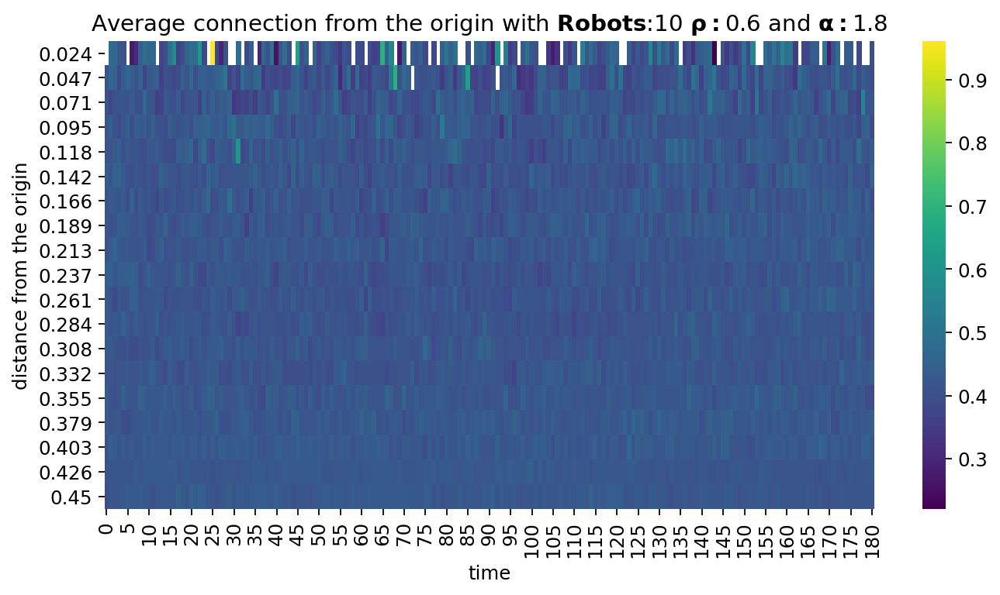

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.6_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.6.png


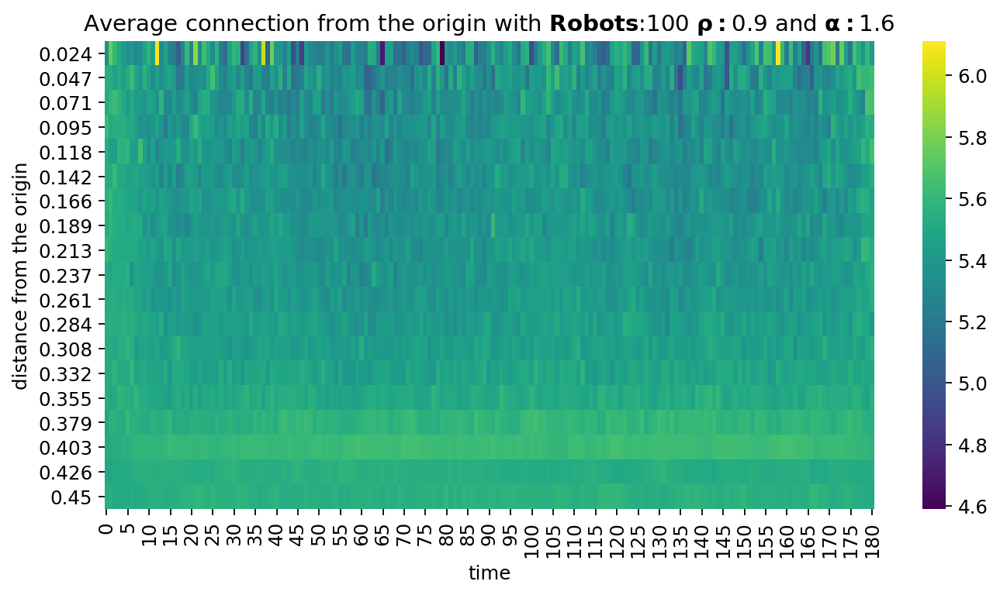

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#2.0_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_2.0.png


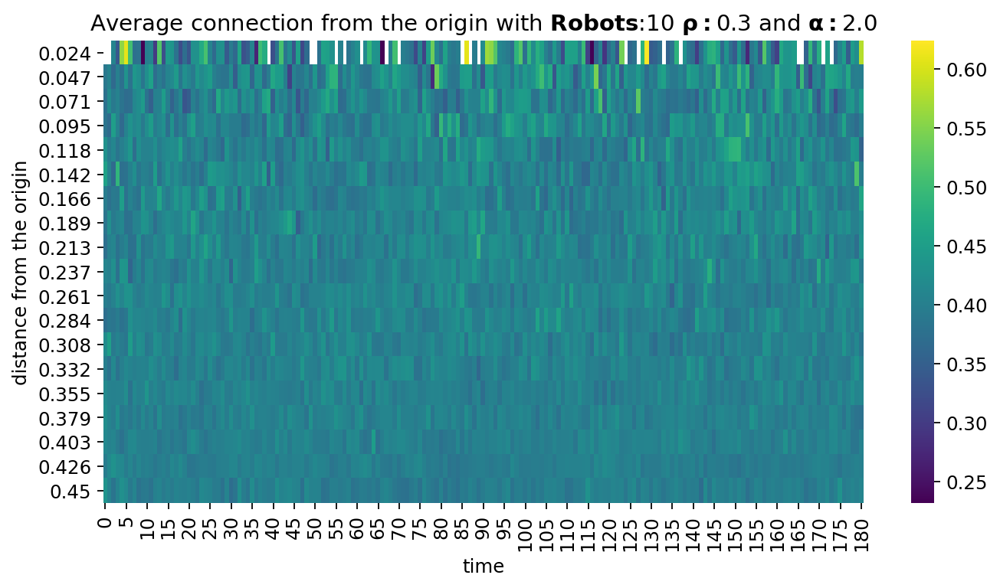

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#2.0_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_2.0.png


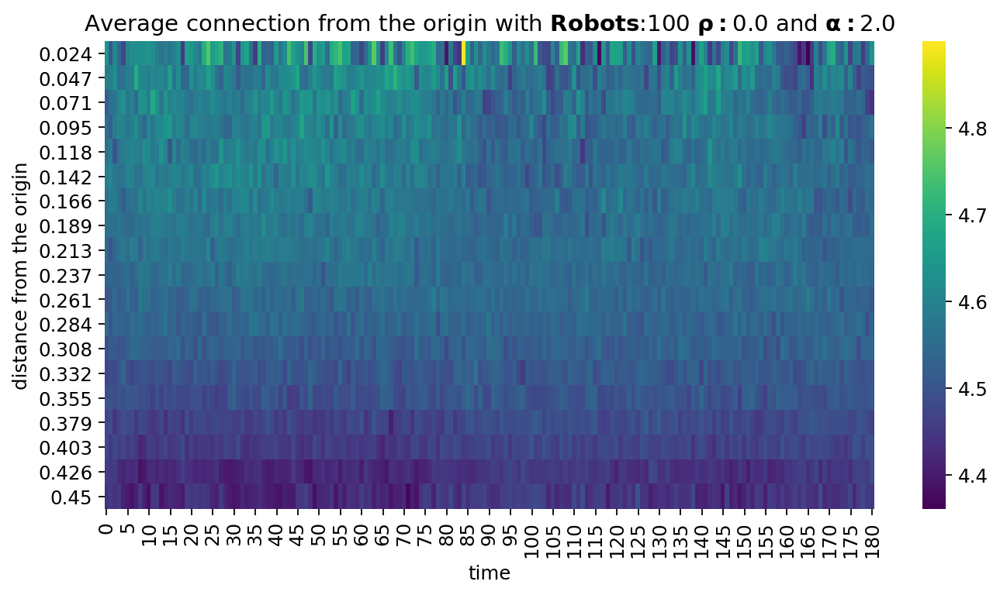

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#2.0_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_2.0.png


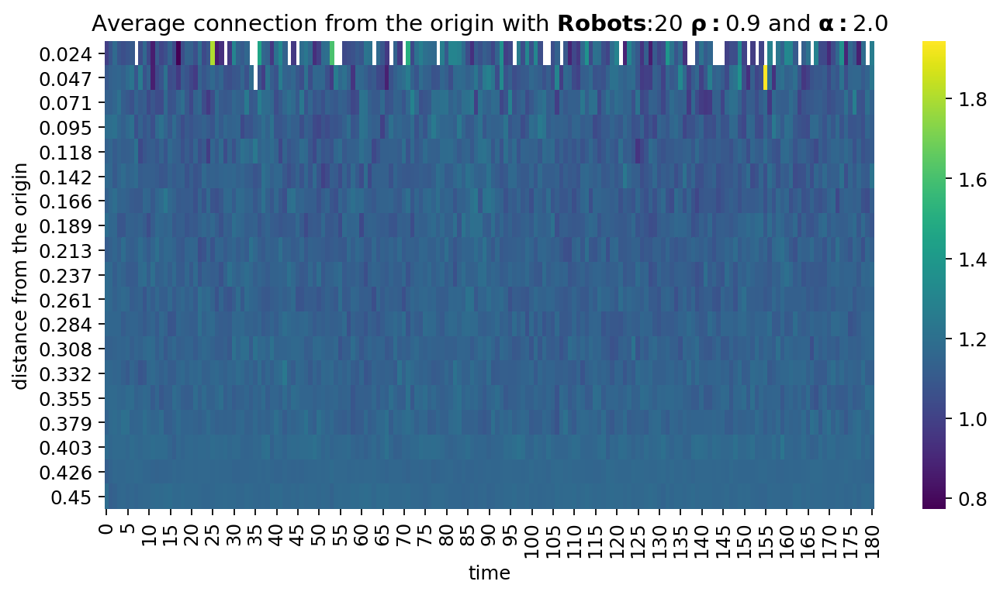

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.2_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.2.png


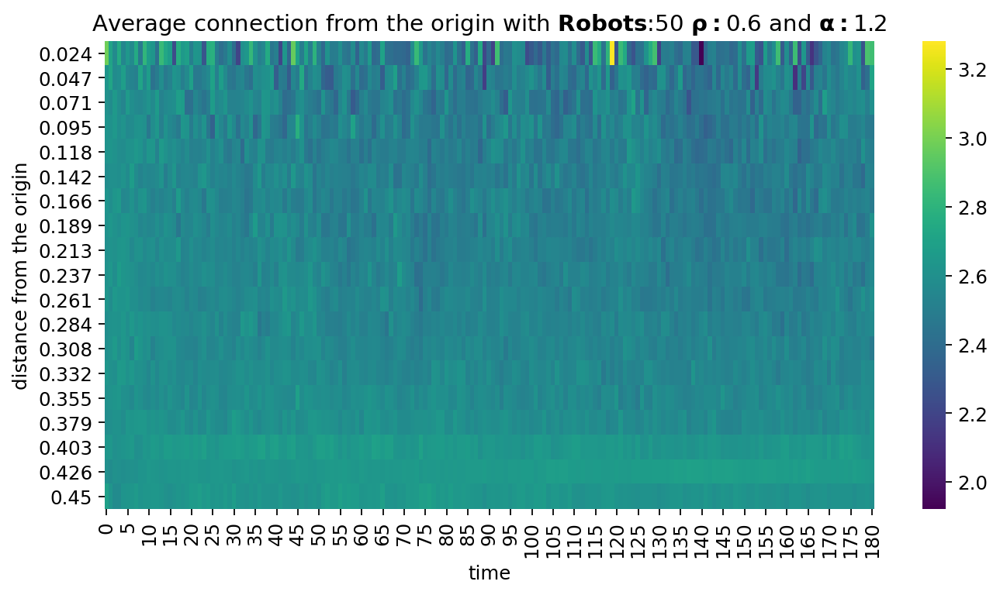

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.6_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.6.png


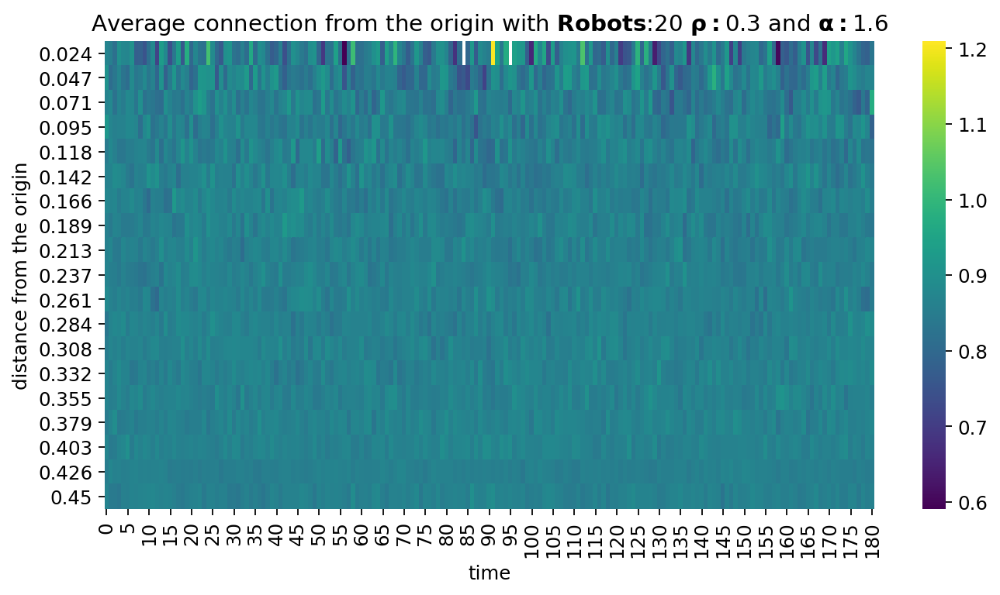

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.8.png


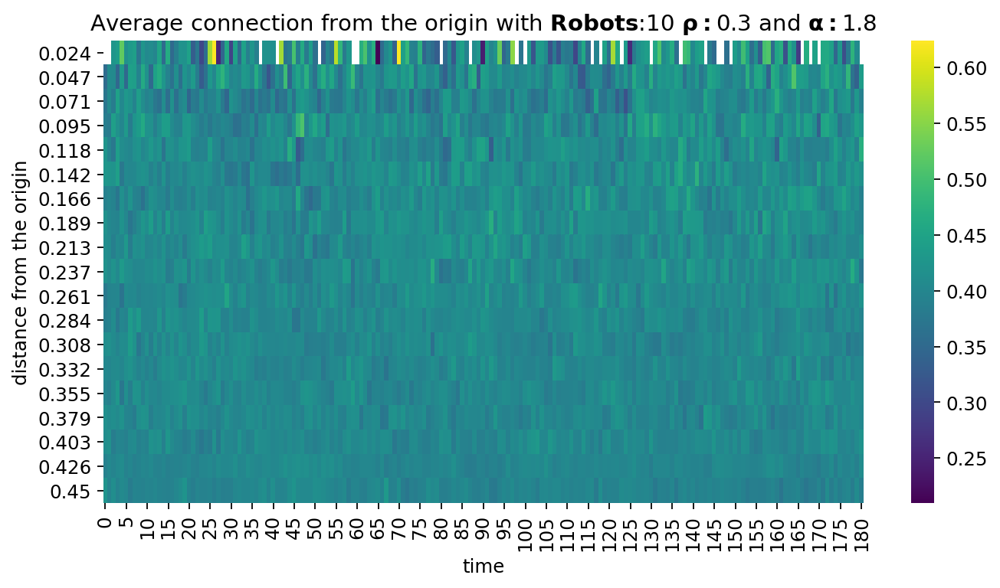

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.2_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.2.png


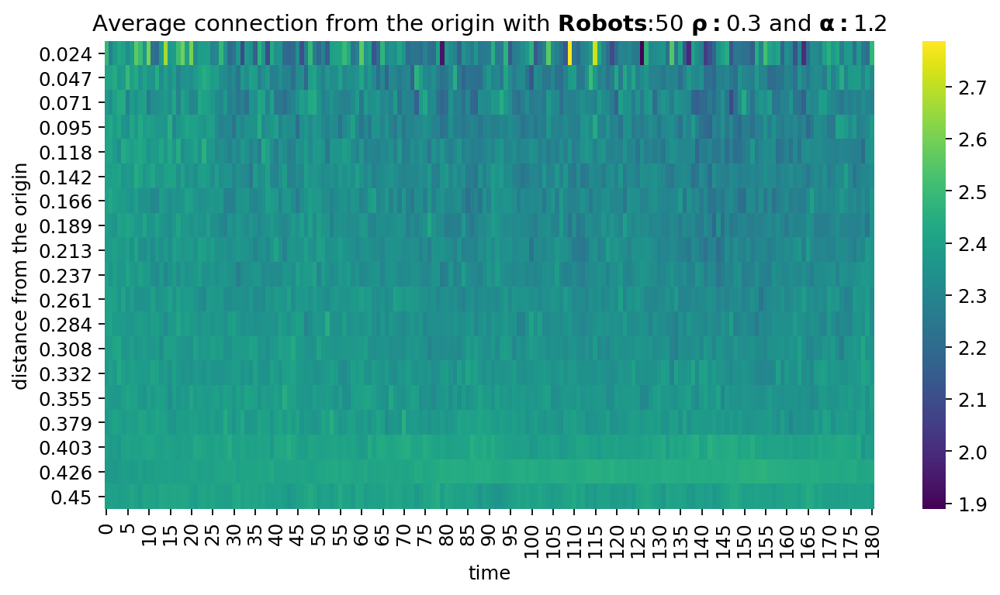

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.8_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.8.png


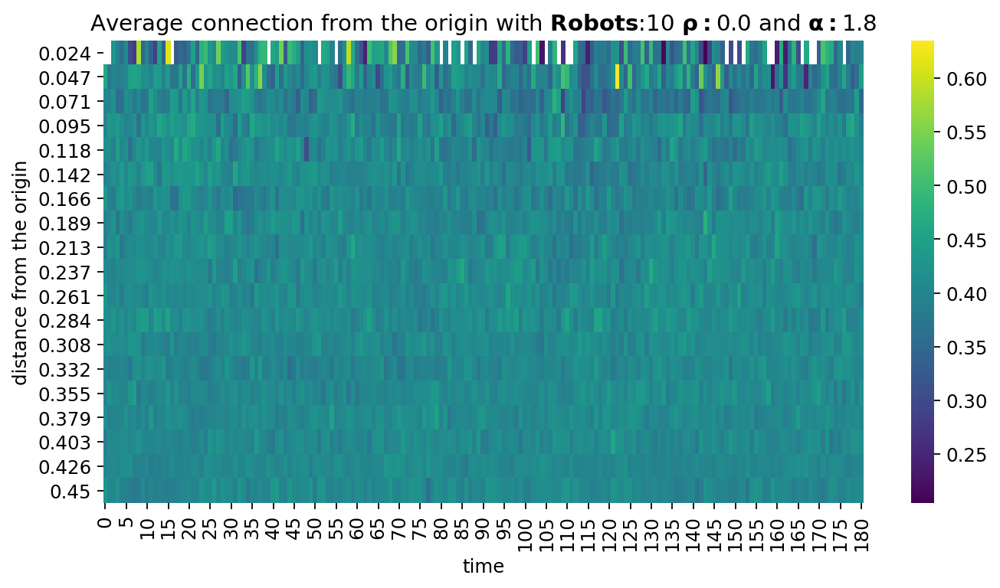

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.4.png


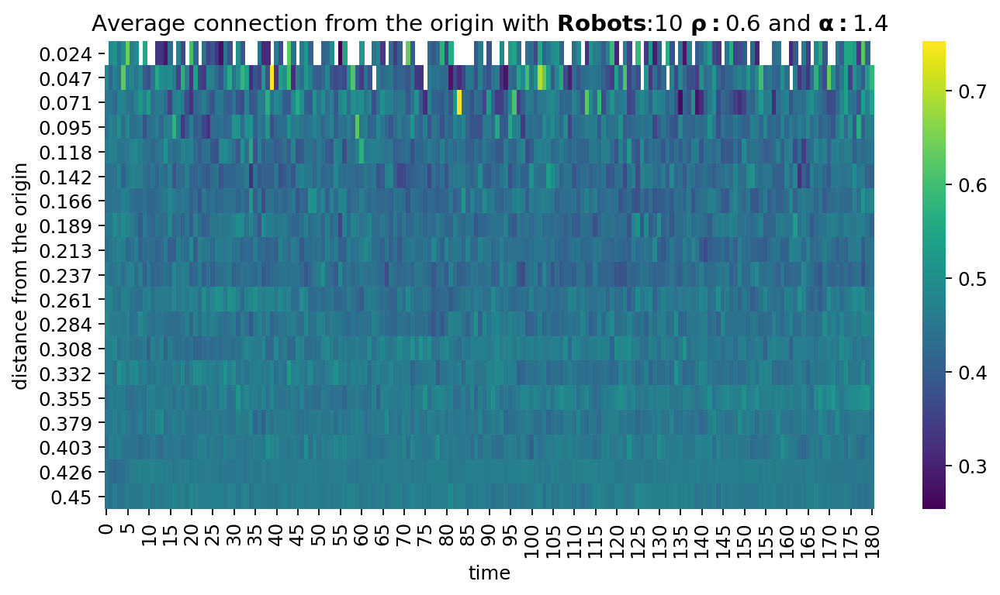

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#2.0_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_2.0.png


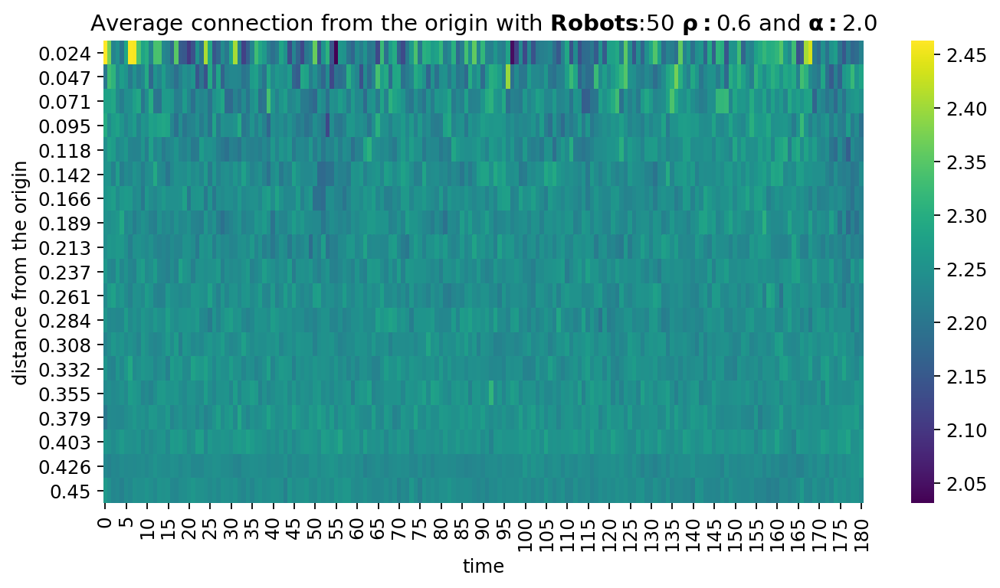

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.8.png


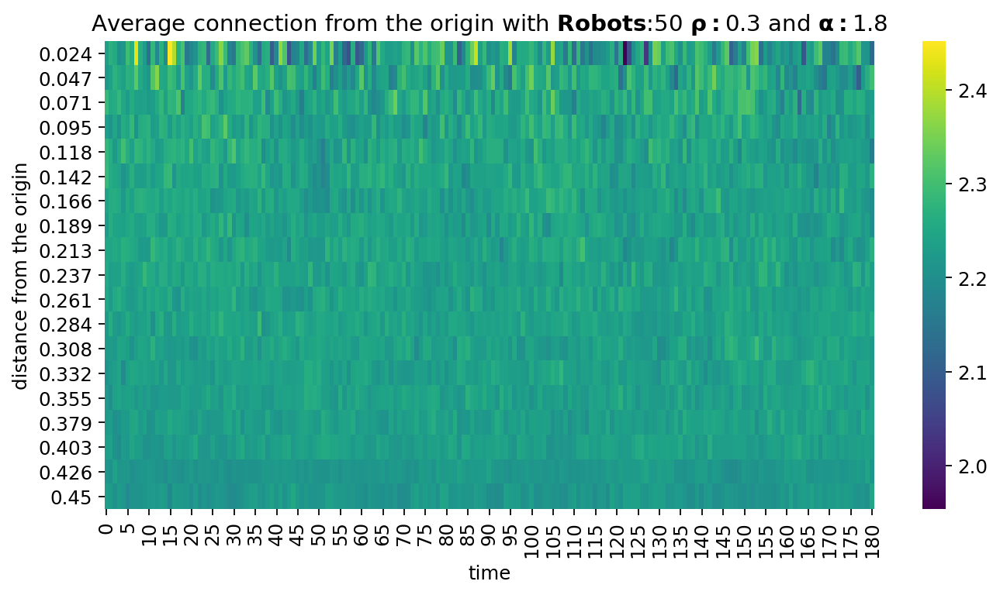

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#20_alpha#1.4_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.4.png


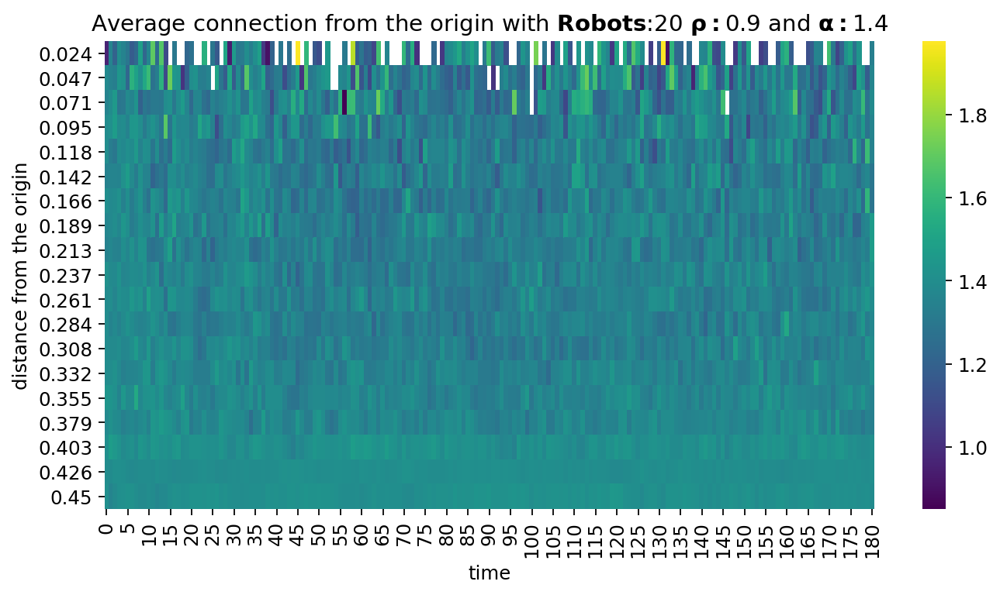

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.8_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.8.png


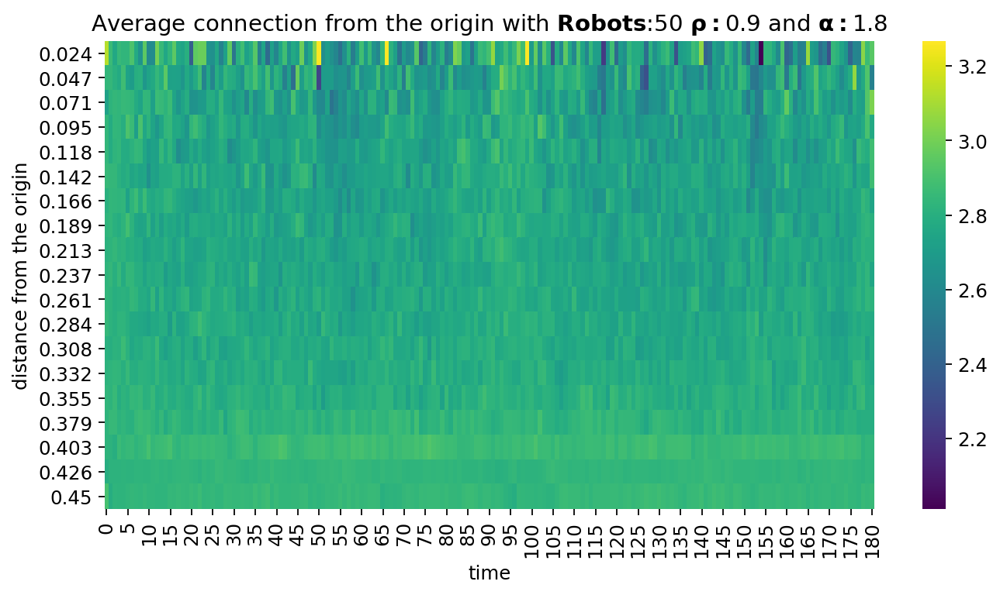

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.4.png


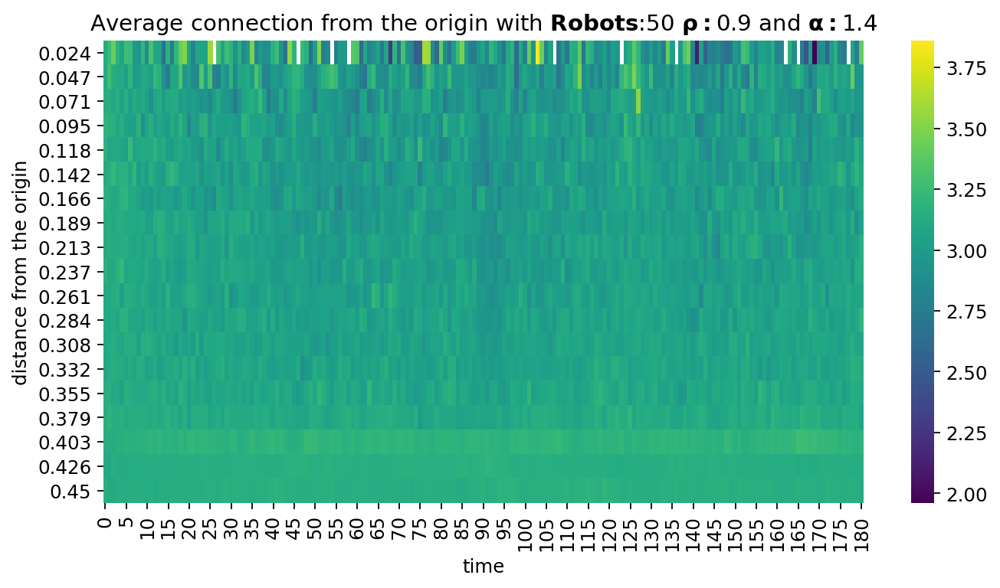

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#2.0_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_2.0.png


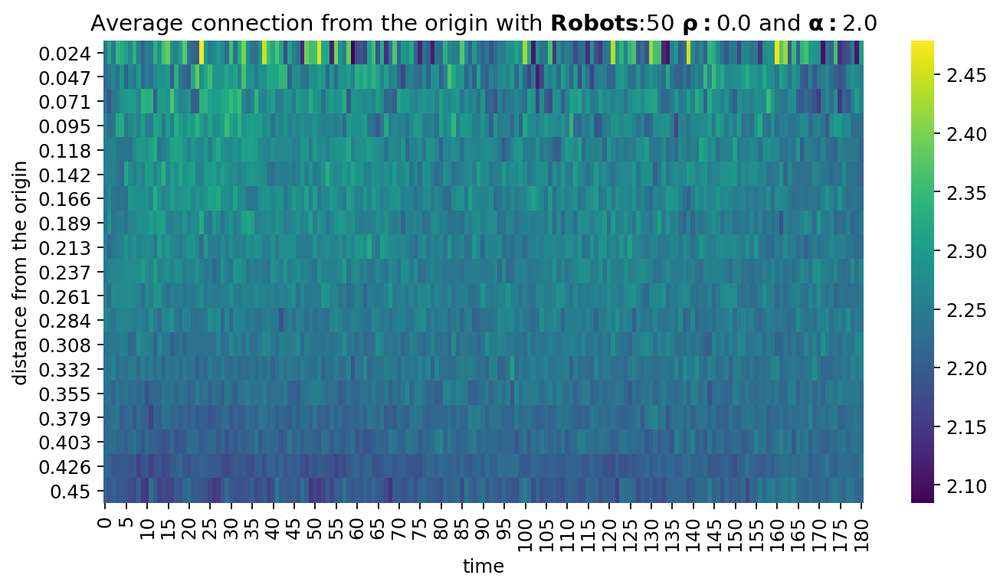

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#50_alpha#1.2_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.2.png


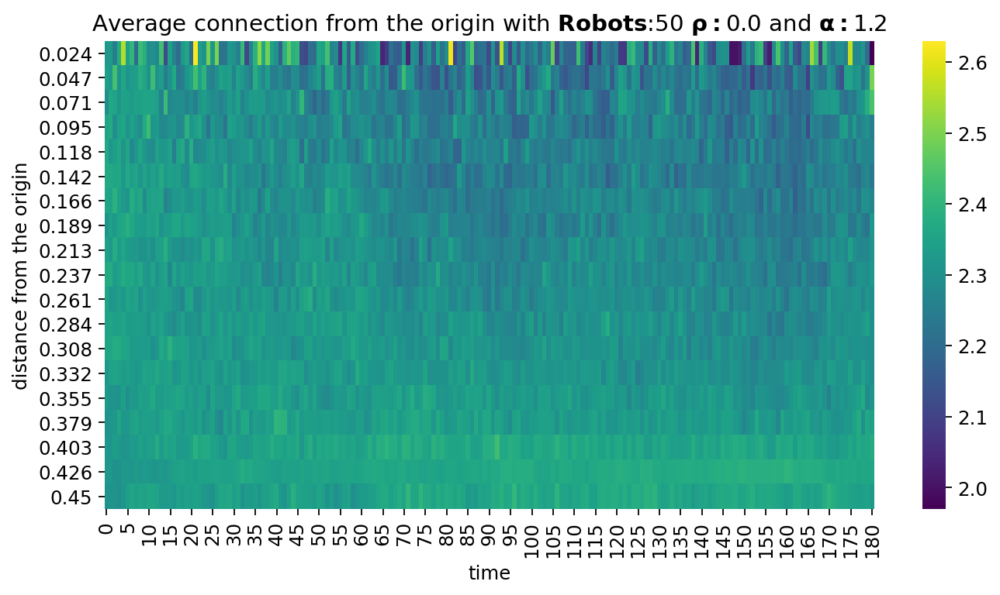

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#50_alpha#1.4_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)
Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.4.png


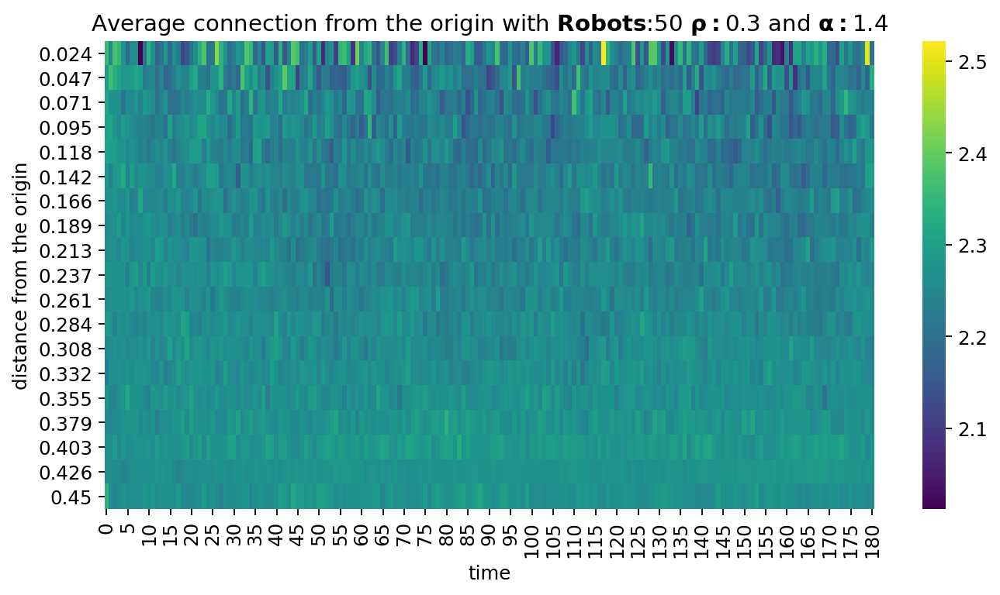

./results/ALL/Simulated/simple_experiment_100_runs/2021-09-20_robots#10_alpha#1.4_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.4.png


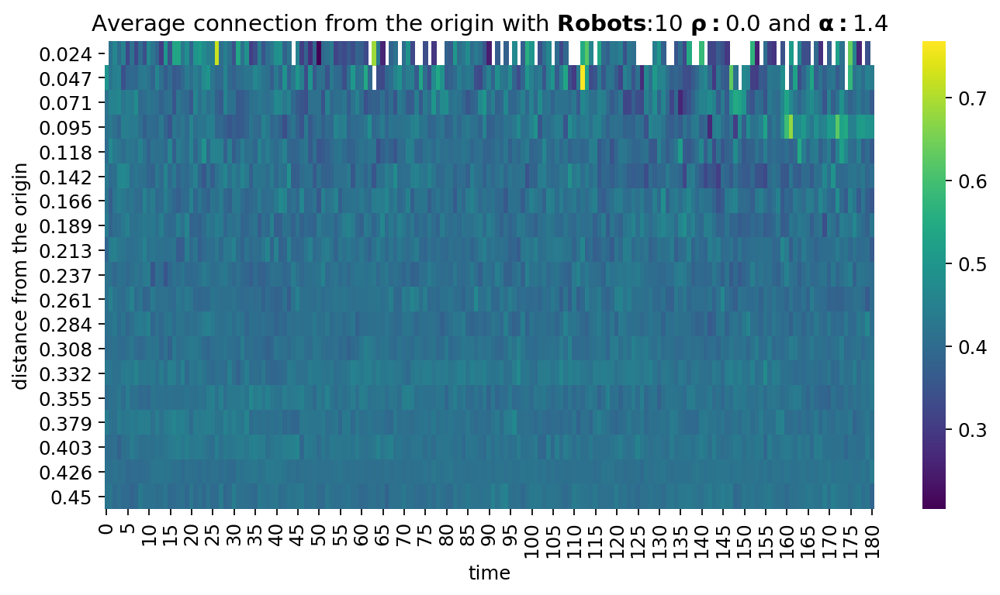

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#10_alpha#1.6_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.6.png


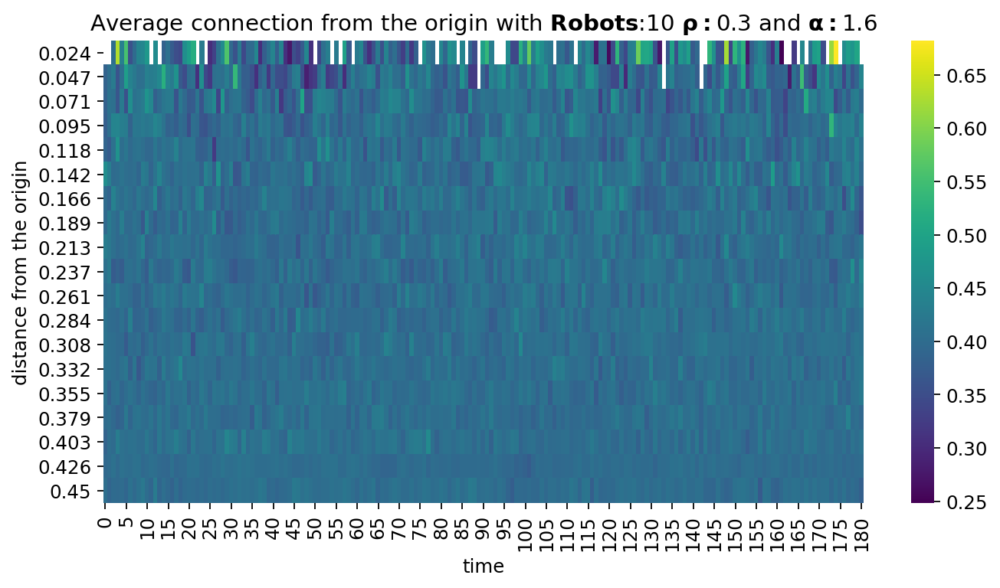

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#20_alpha#1.2_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.2.png


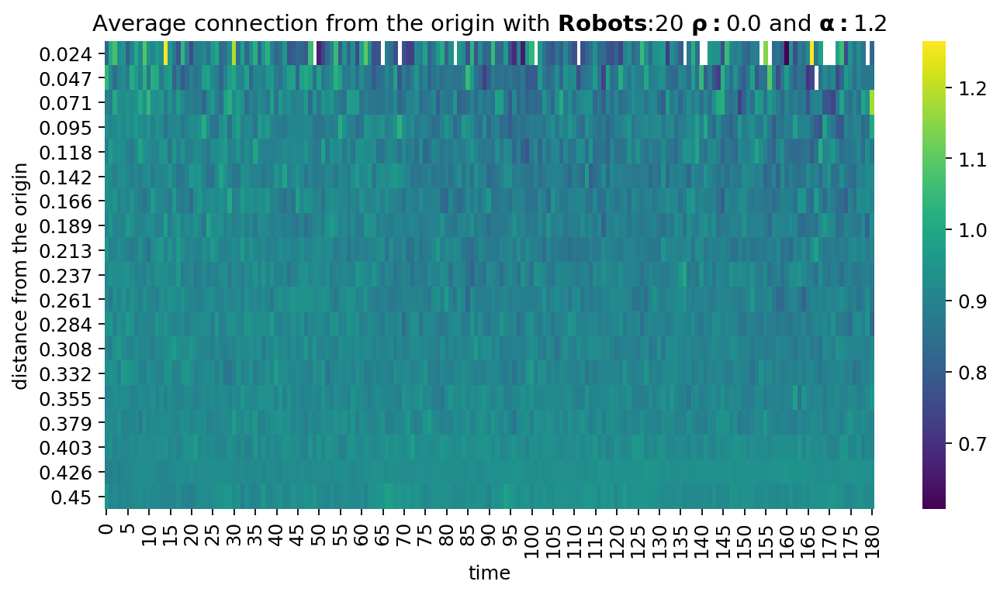

./results/ALL/Simulated/simple_experiment_100_runs/2020-06-03_robots#100_alpha#1.6_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)
Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.6.png


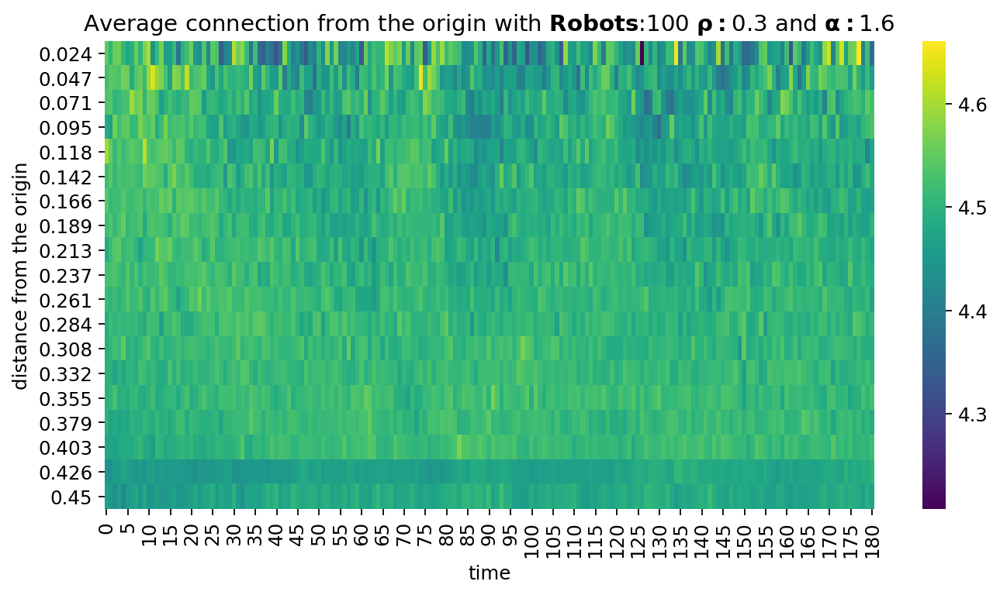

In [37]:
bin_edges = np.linspace(0, 0.45, 20)
simpleExperiment_folder = './results/ALL/Simulated/simple_experiment_100_runs'
avg_connection_degree_heatmap(simpleExperiment_folder)

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.2_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.2.png


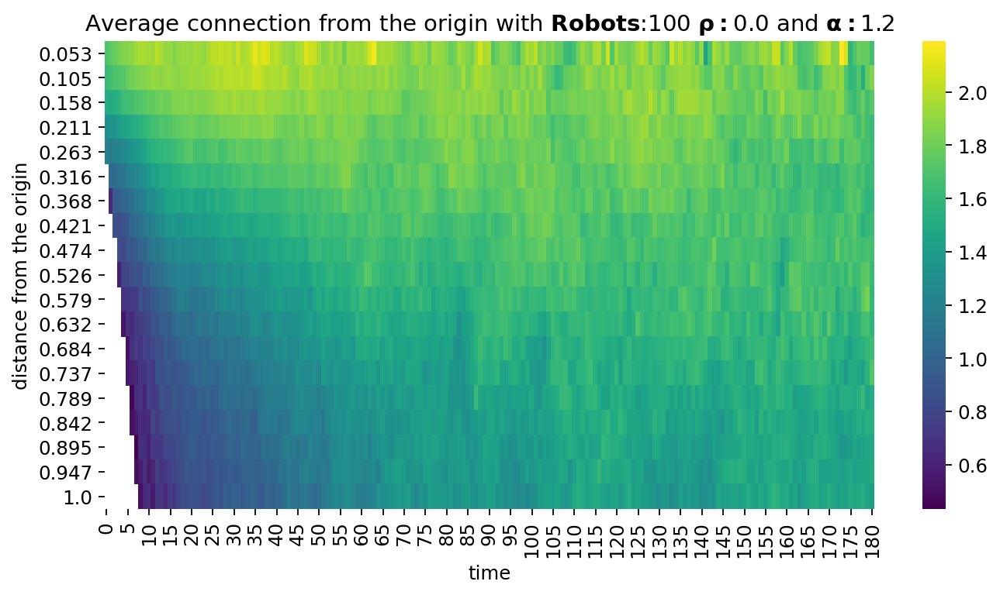

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.4.png


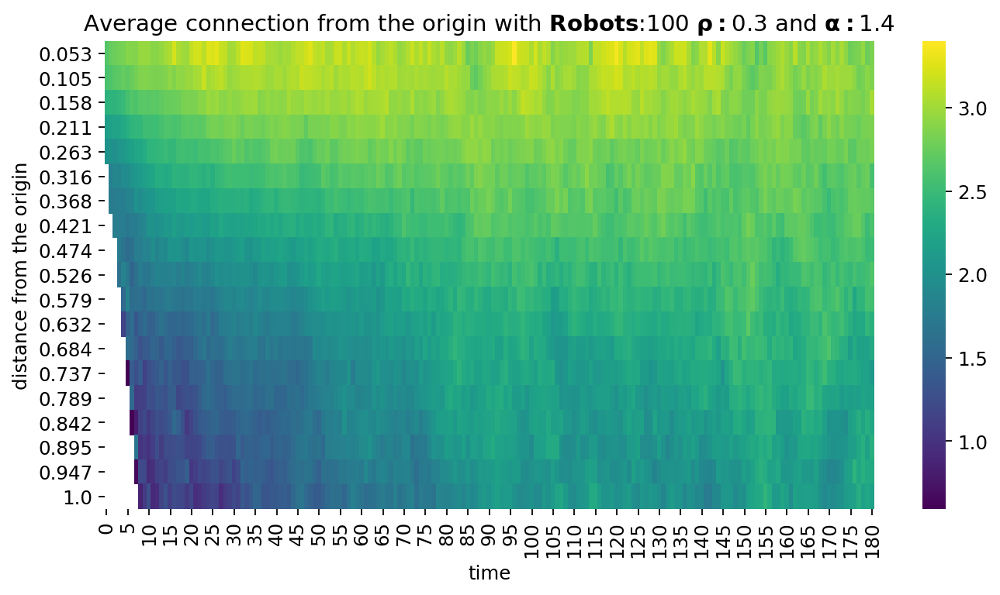

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.4.png


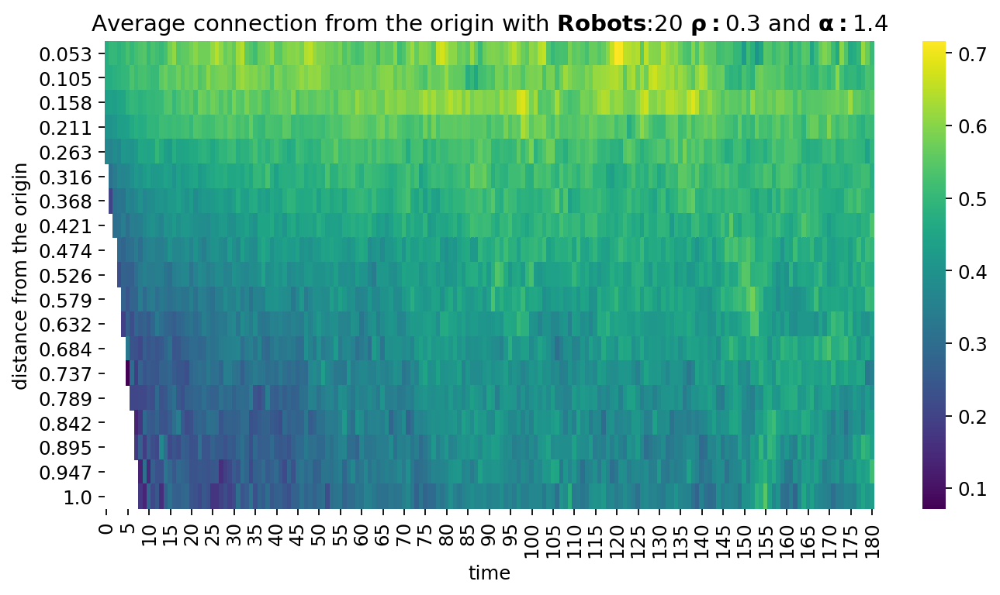

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.8.png


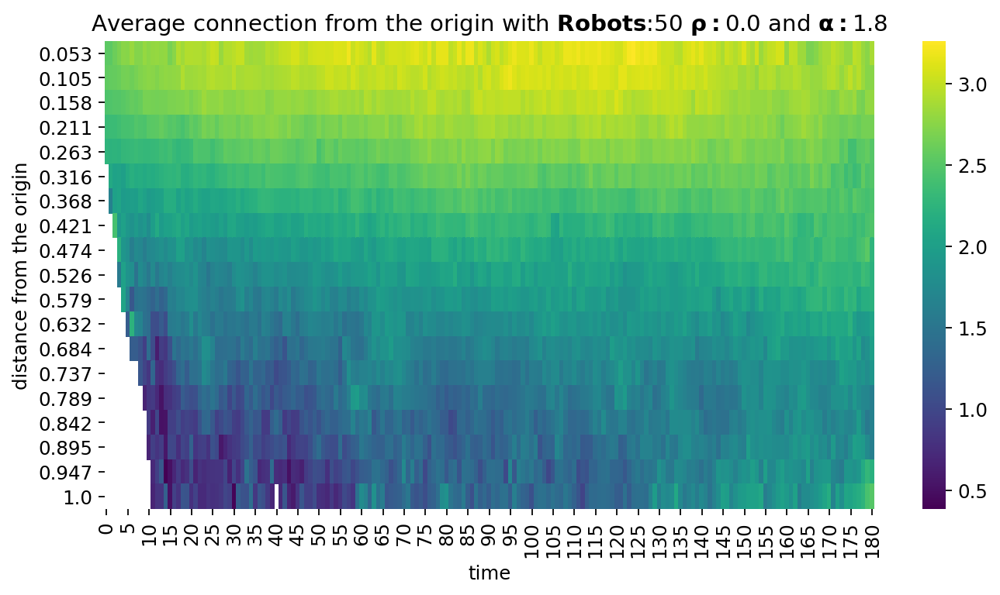

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.8.png


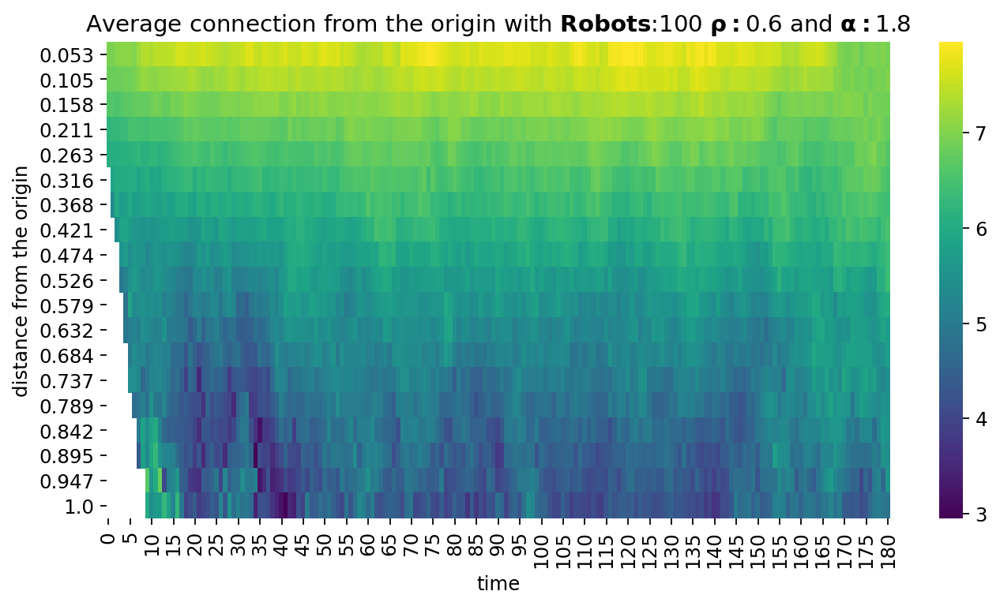

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.6_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.6.png


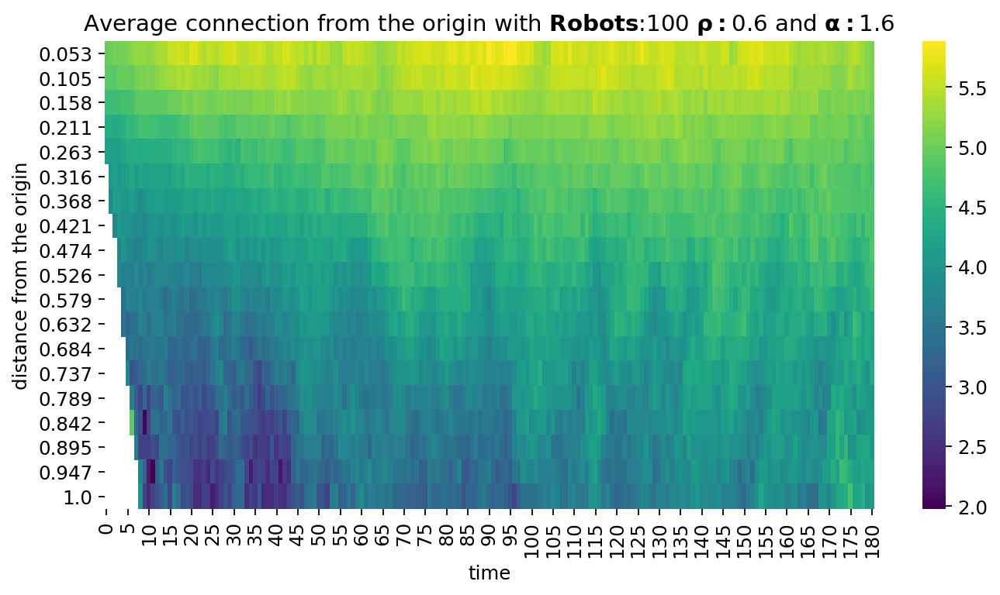

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#2.0_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_2.0.png


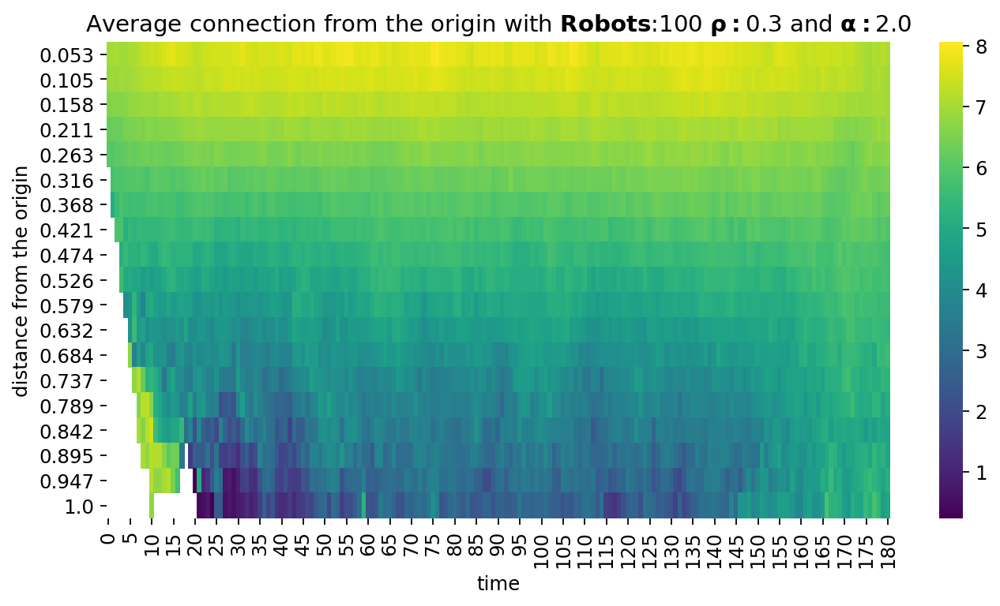

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.2_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.2.png


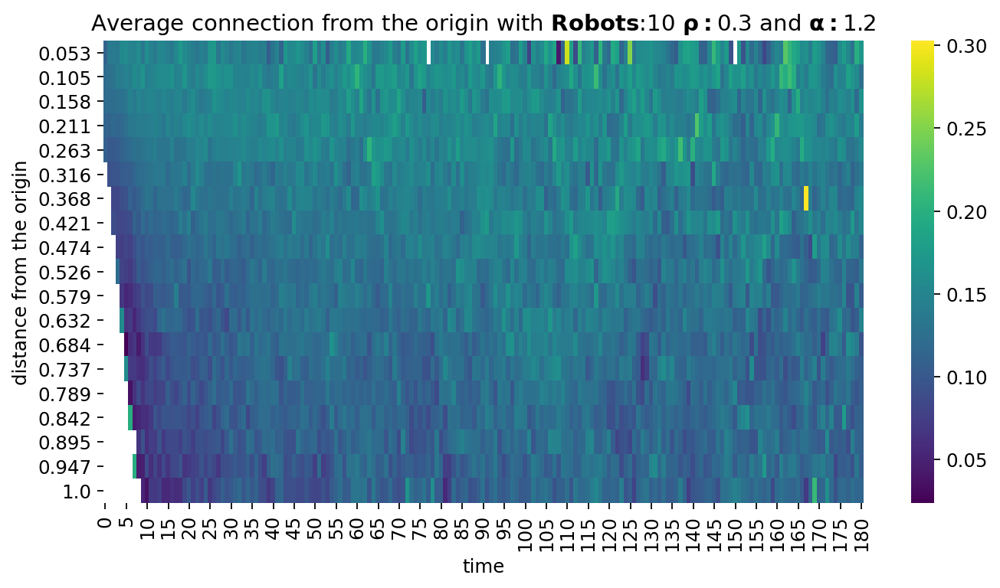

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.4.png


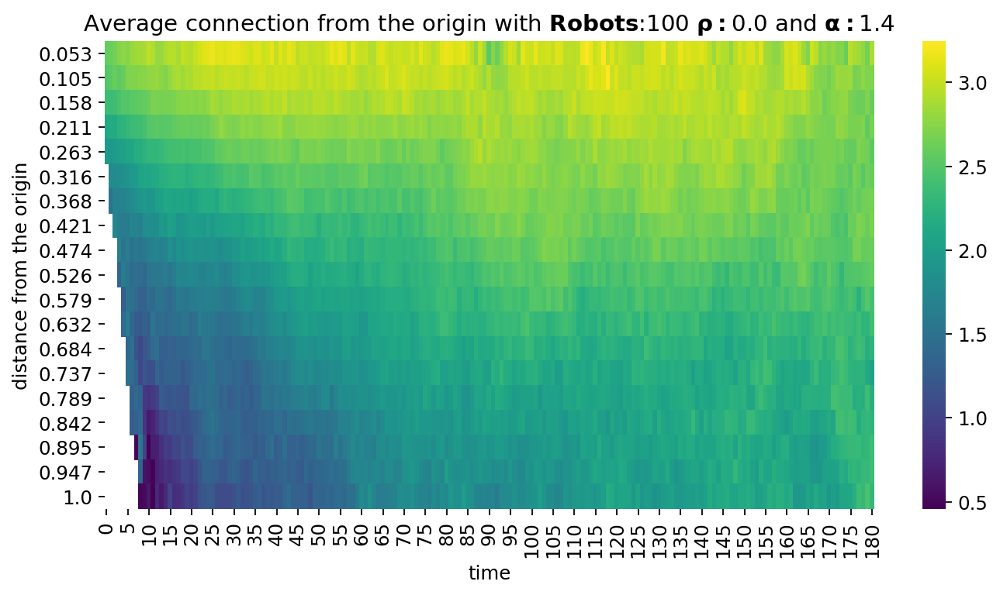

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.2_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.2.png


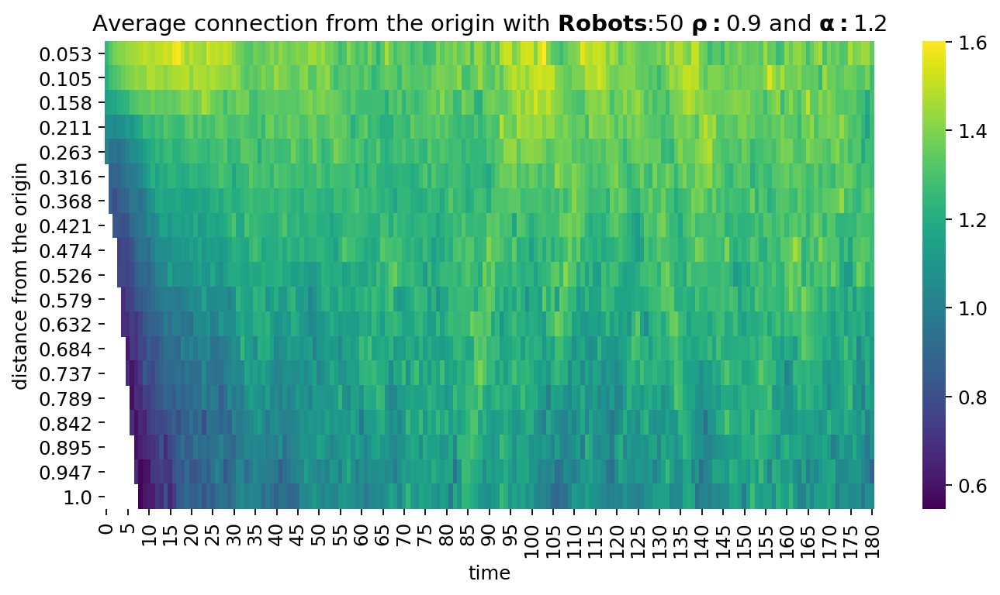

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.4.png


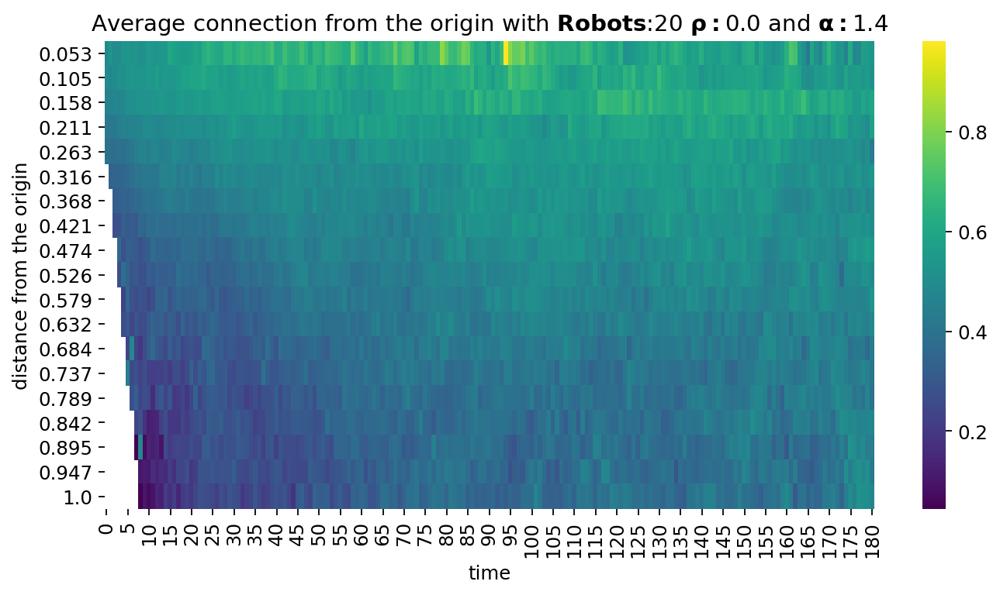

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.6_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.6.png


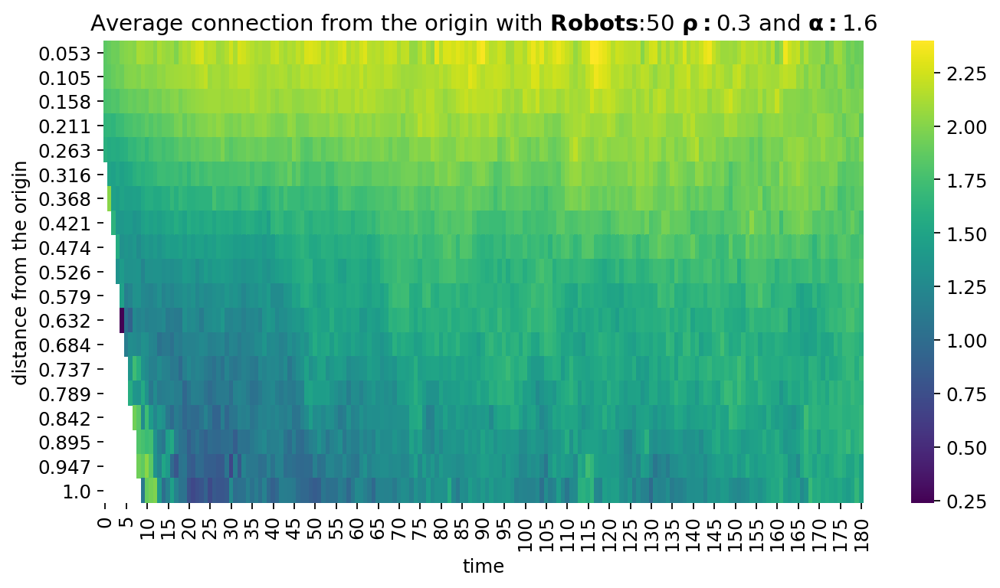

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.8.png


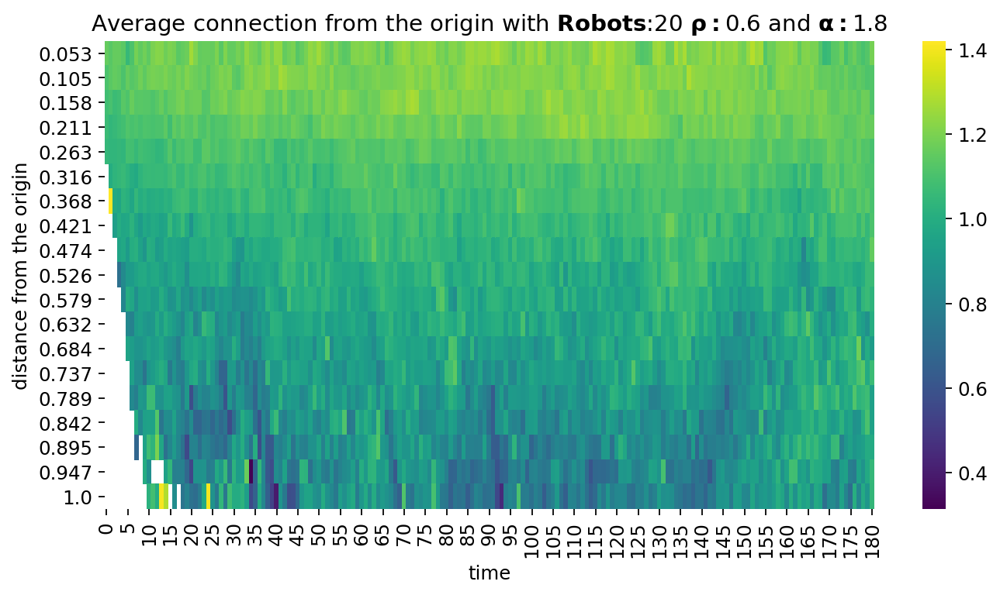

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.4.png


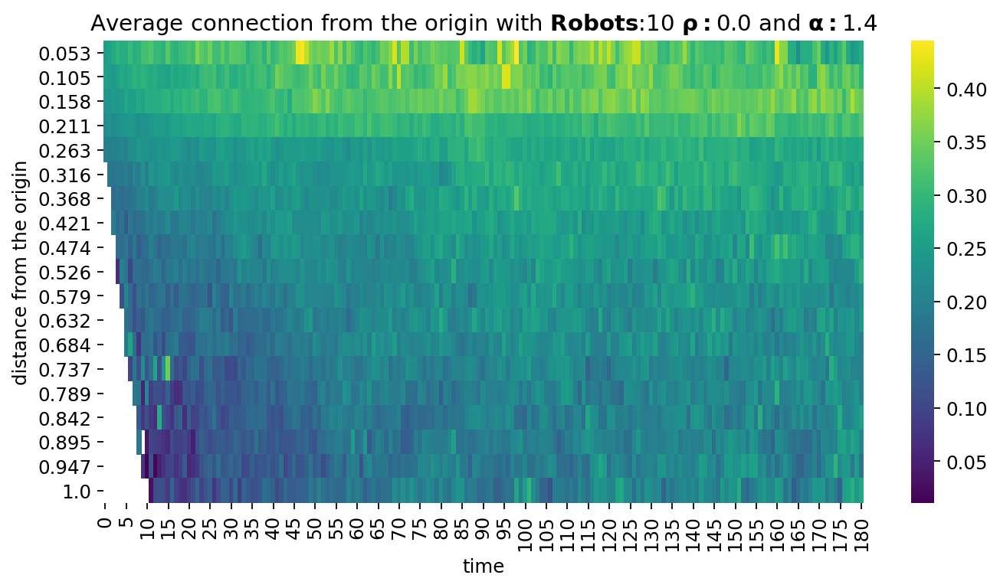

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#2.0_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_2.0.png


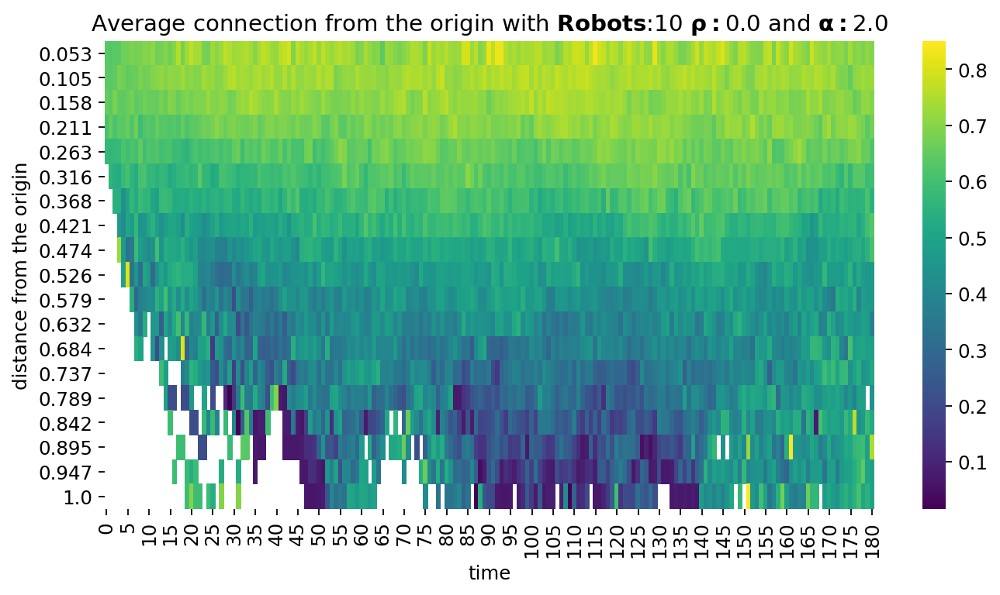

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.8.png


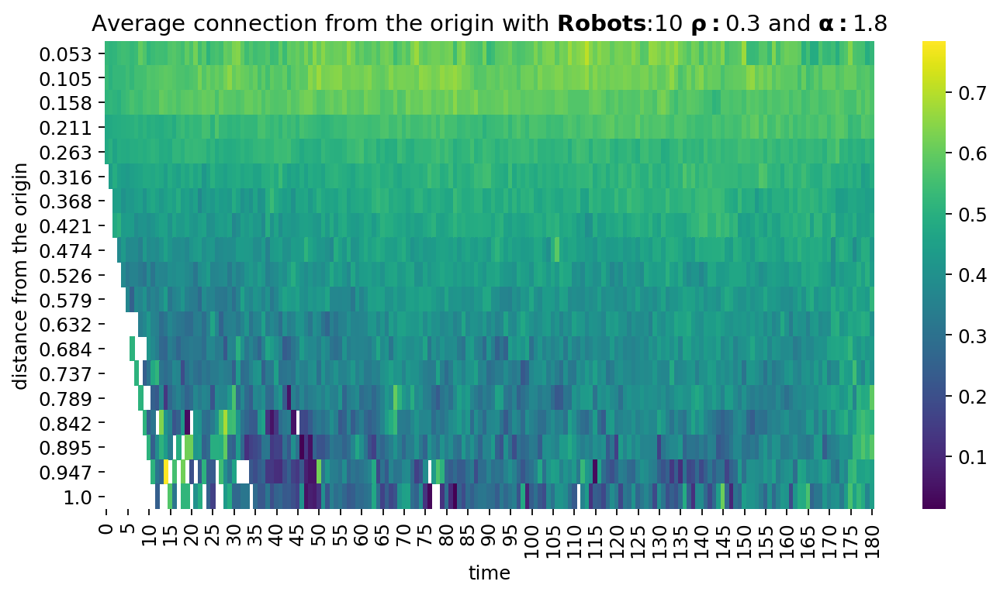

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#2.0_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_2.0.png


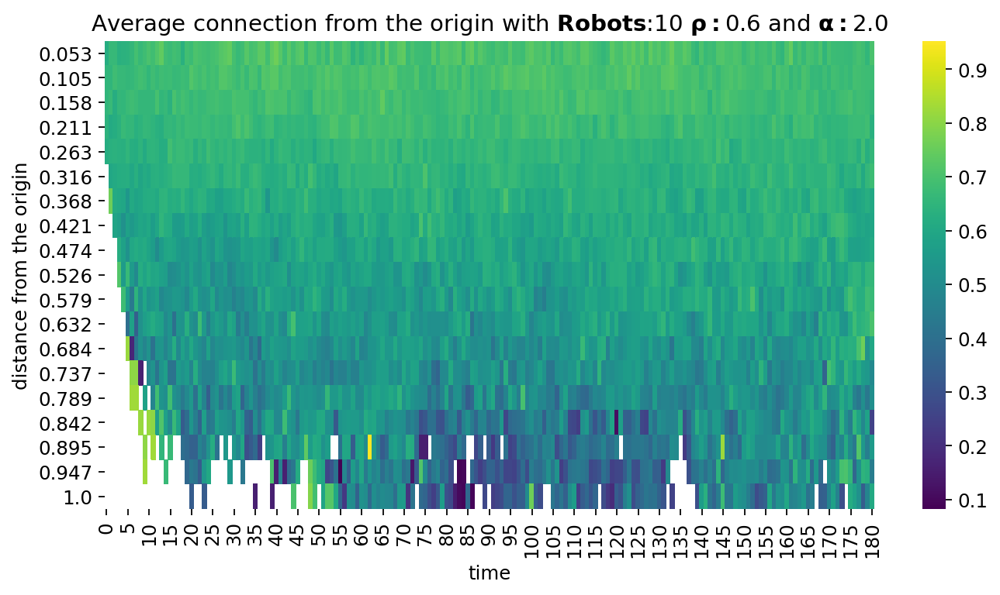

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.2_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.2.png


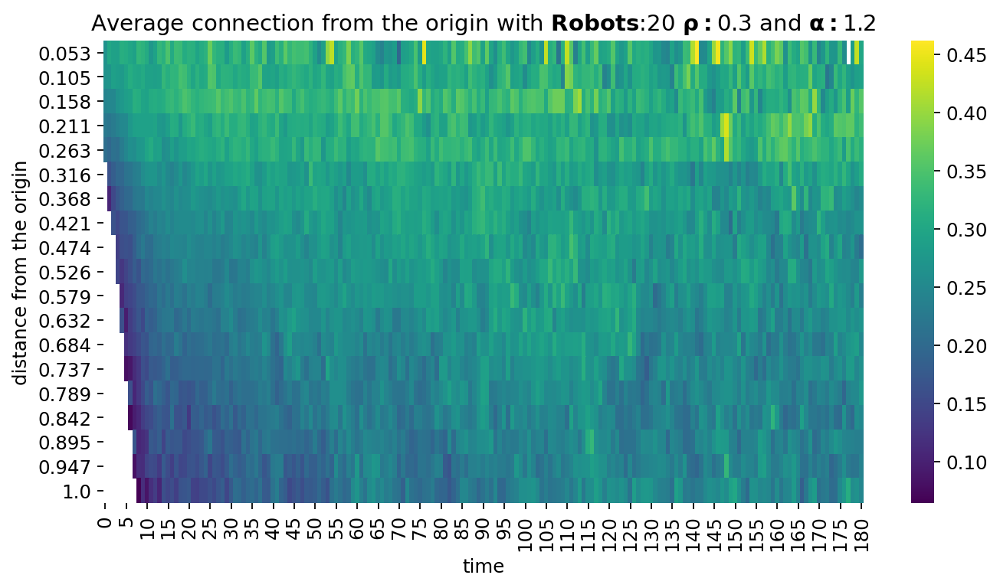

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.2_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.2.png


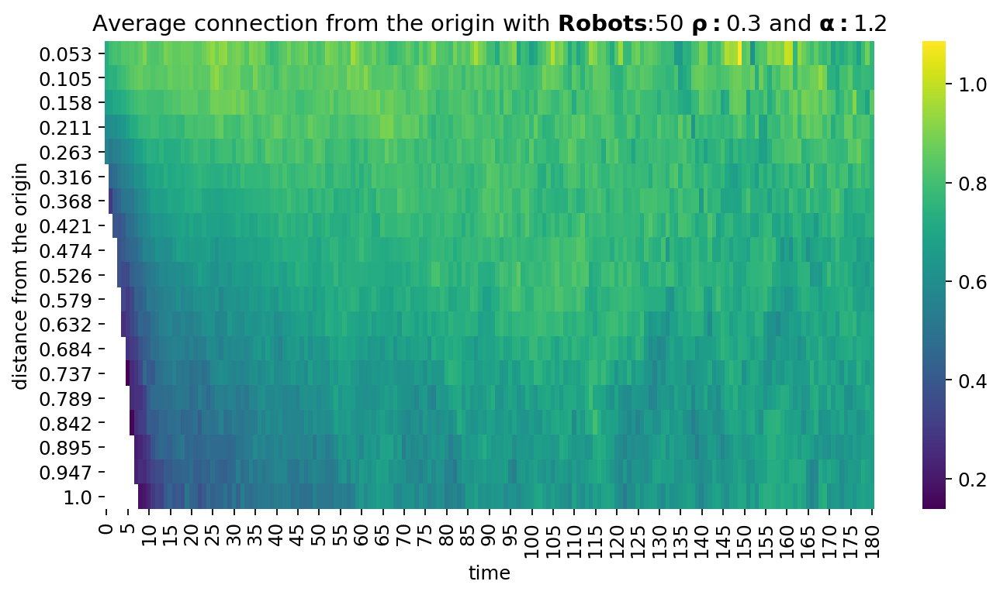

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#2.0_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_2.0.png


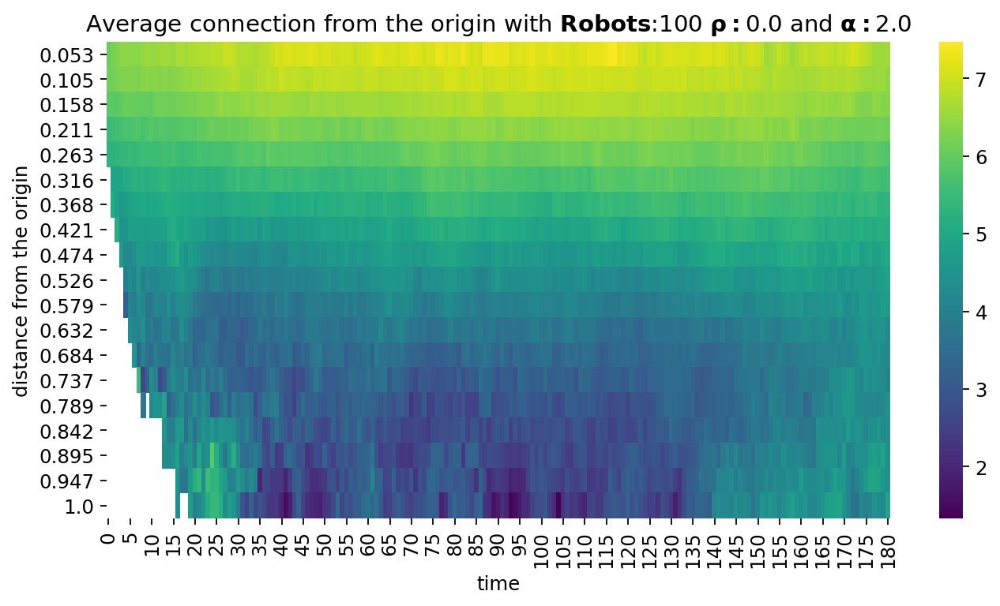

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.2_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.2.png


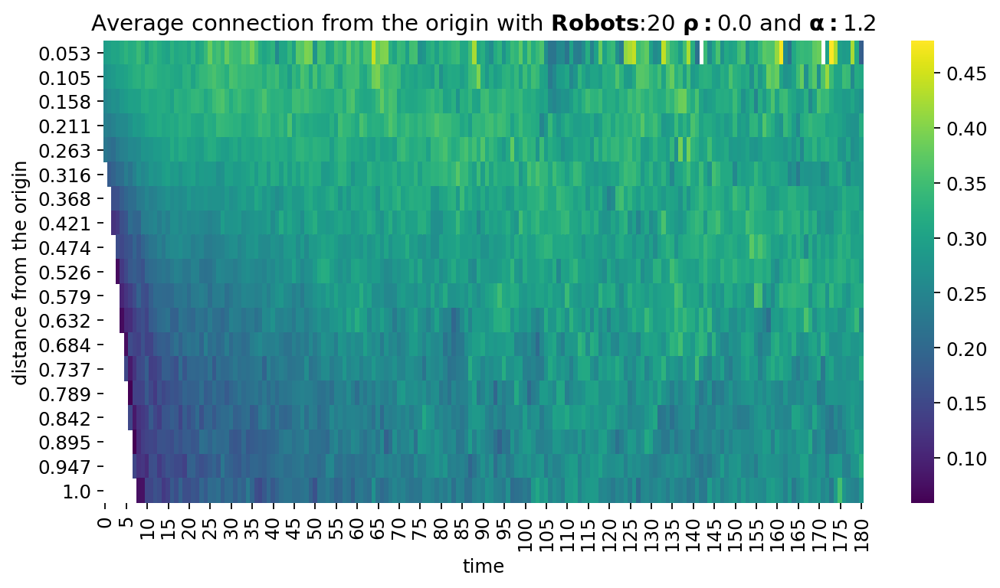

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.4.png


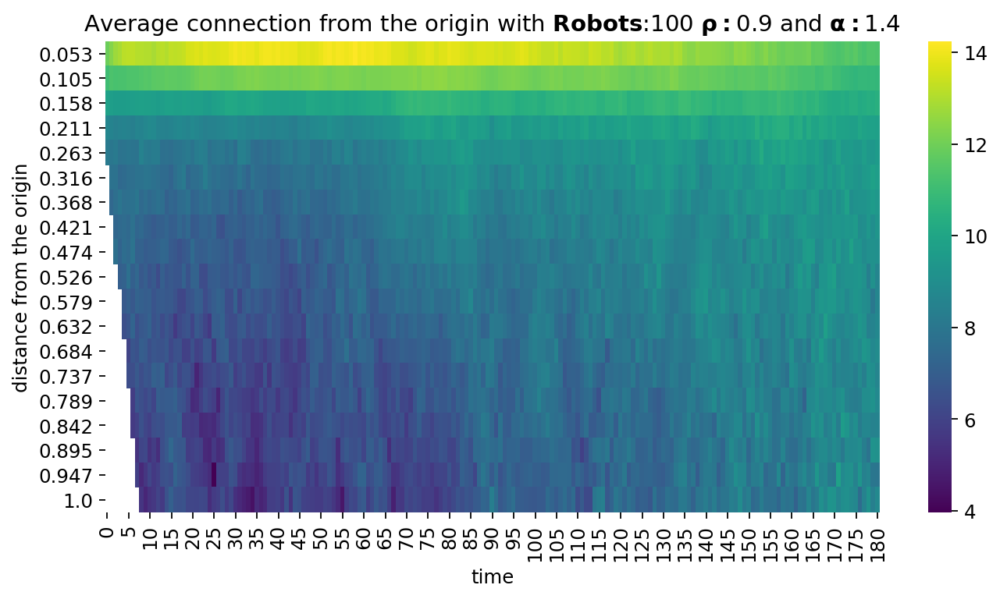

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#2.0_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_2.0.png


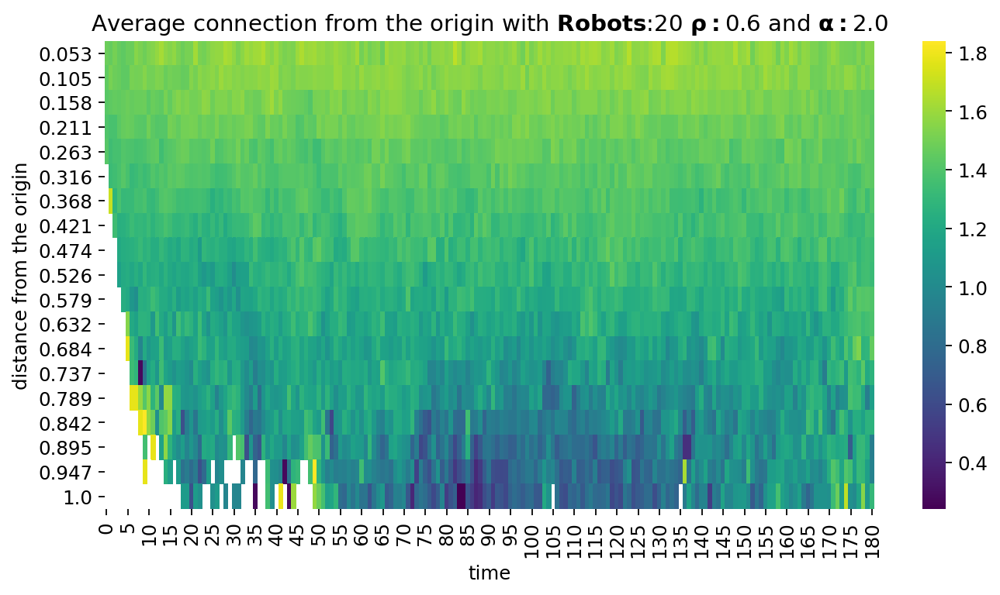

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.8.png


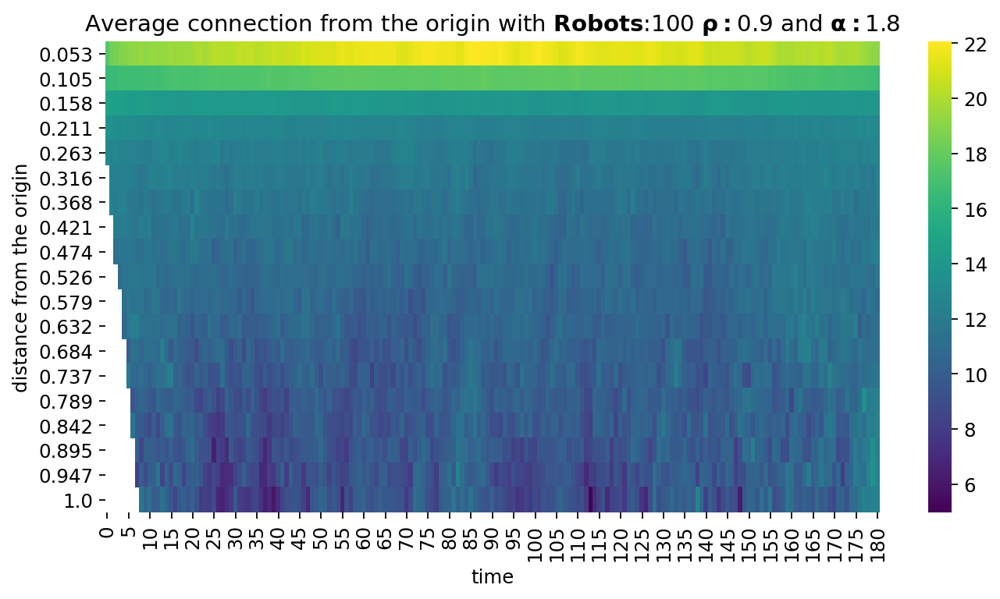

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.4.png


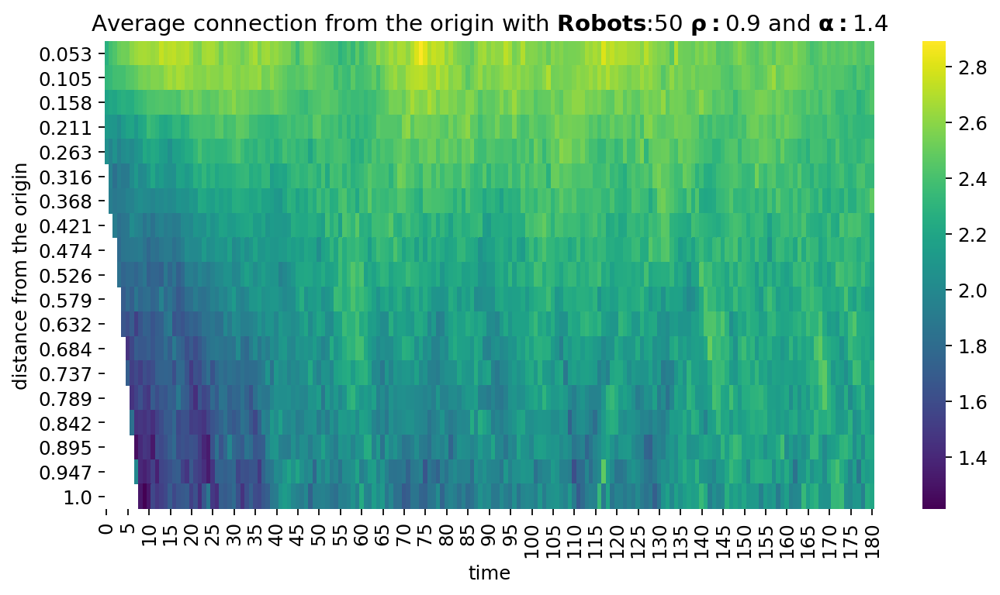

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.8.png


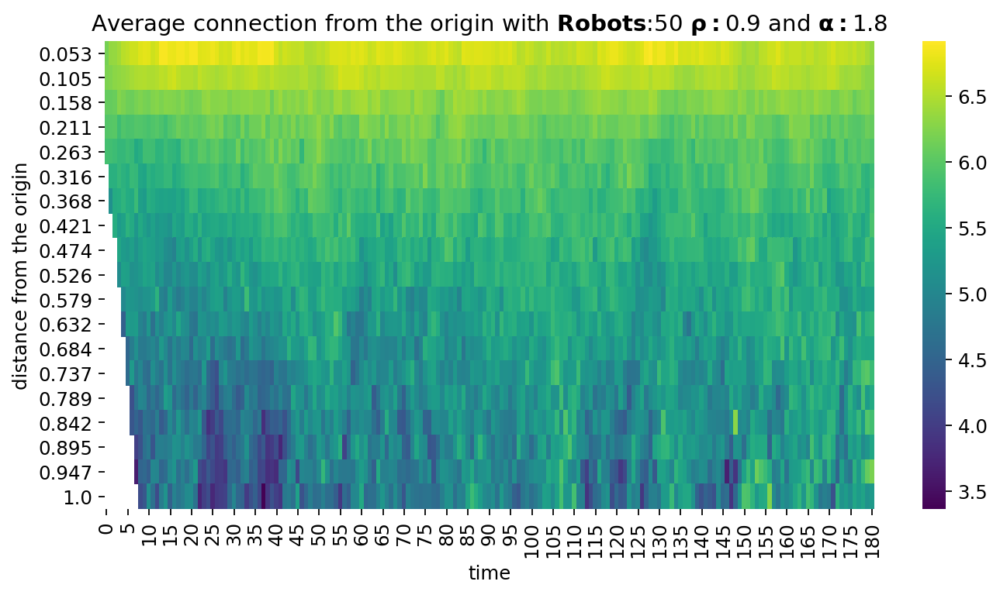

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.8.png


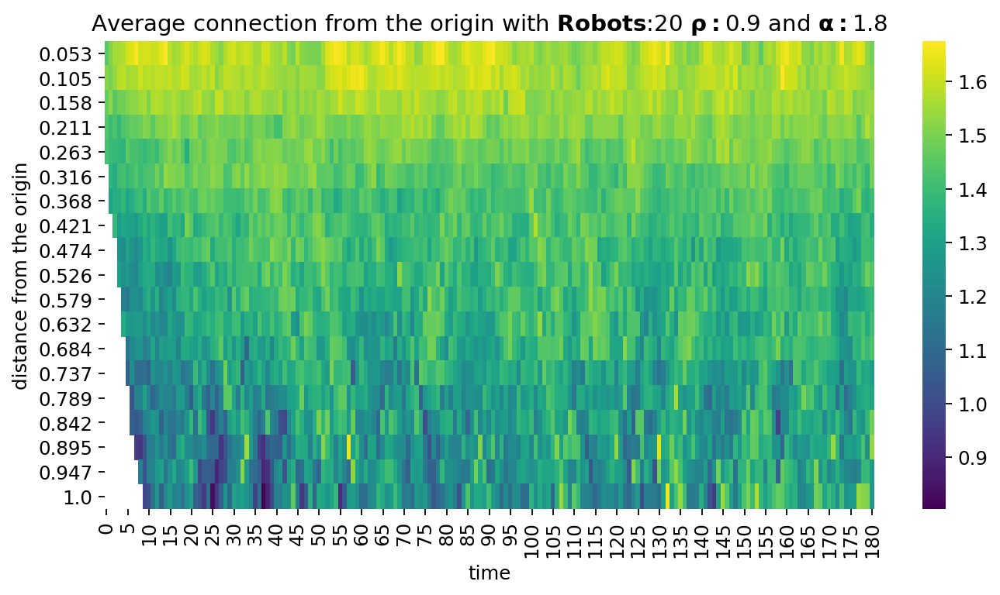

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.2_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.2.png


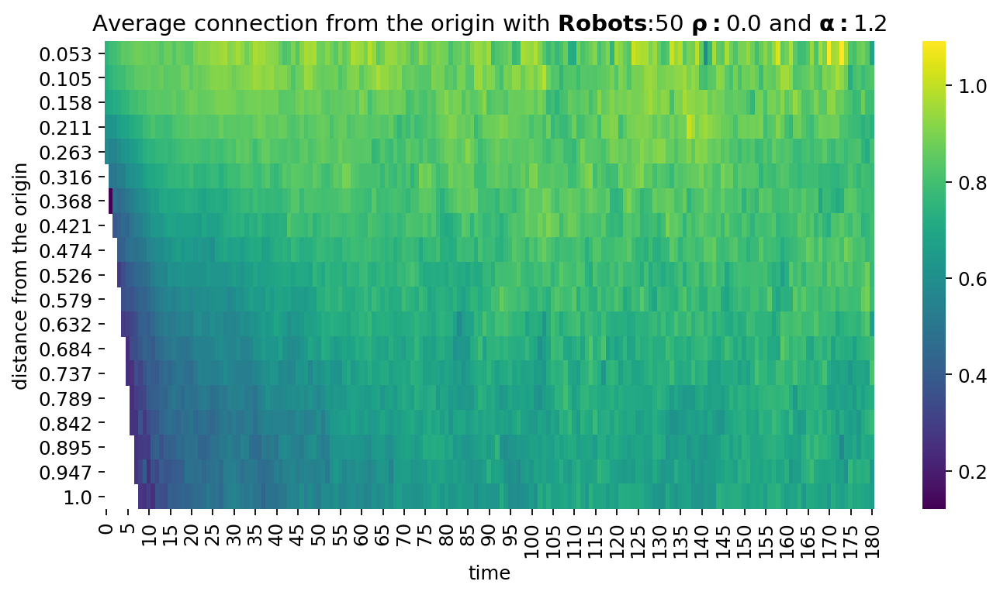

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#2.0_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_2.0.png


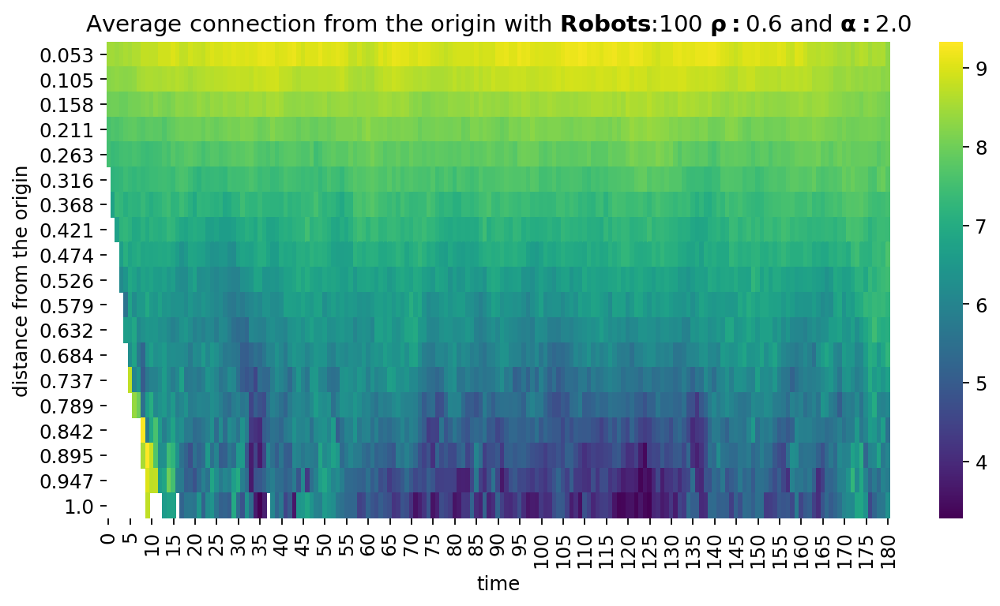

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.6_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.6.png


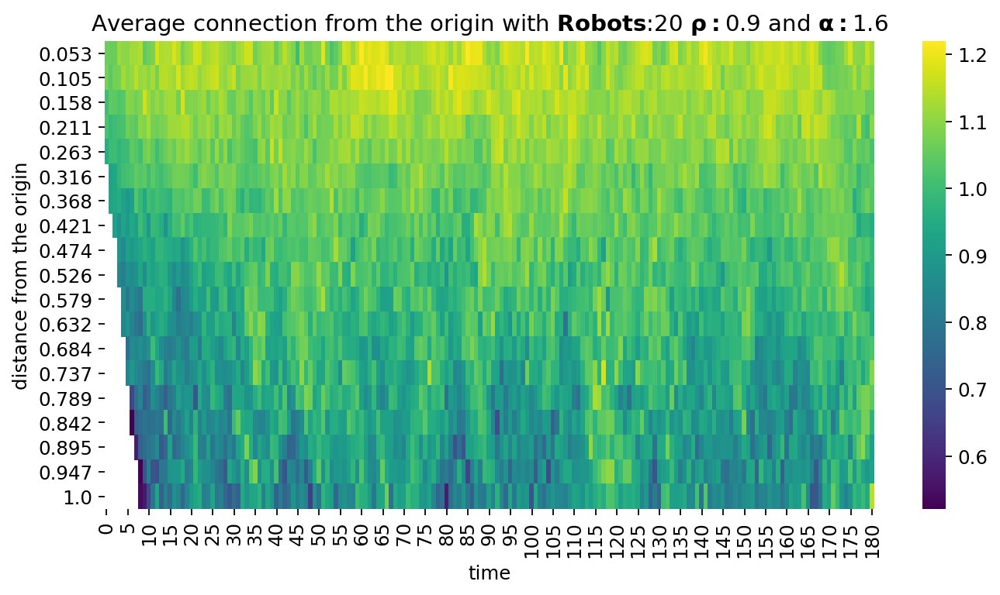

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#2.0_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_2.0.png


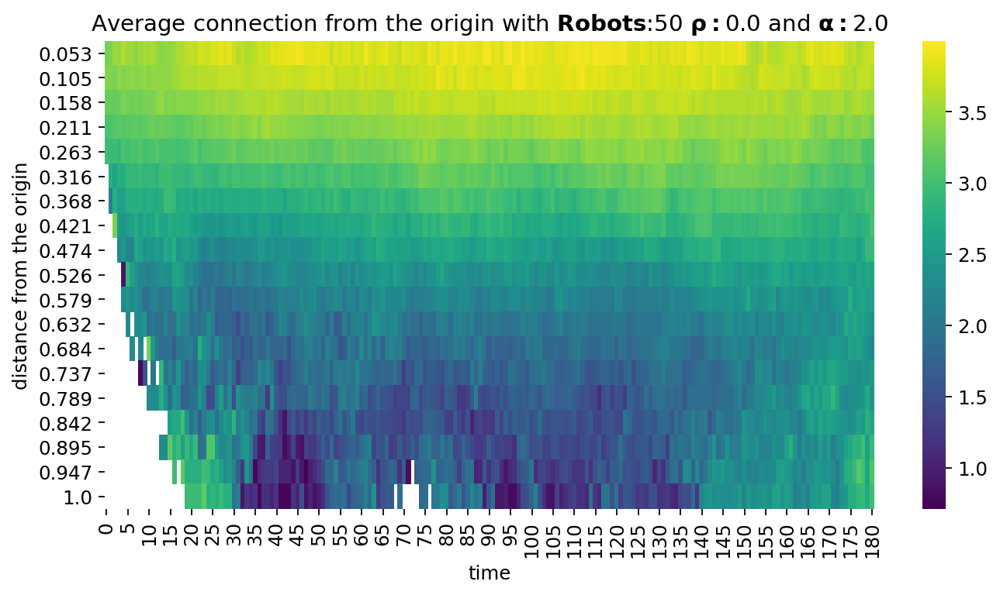

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#2.0_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_2.0.png


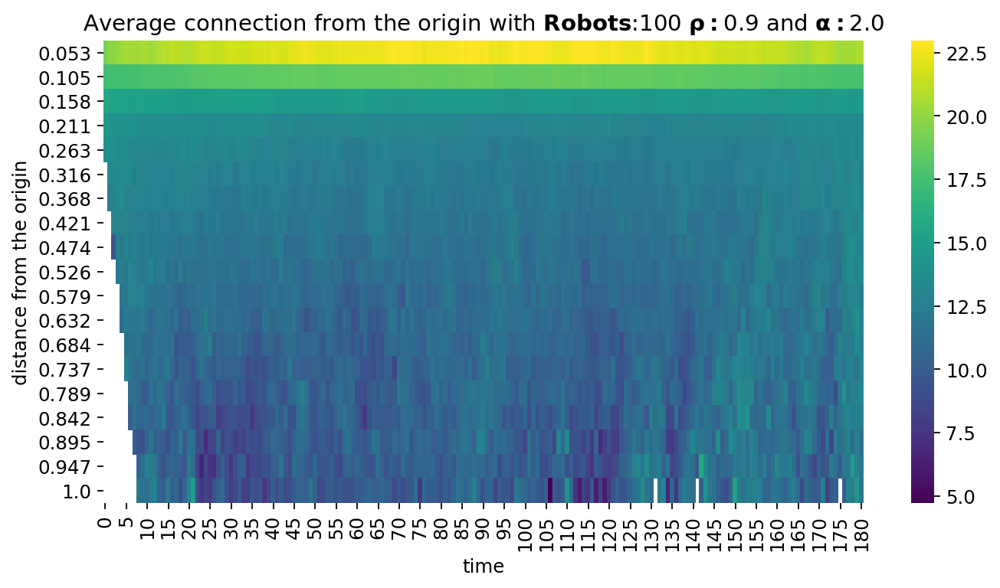

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#2.0_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_2.0.png


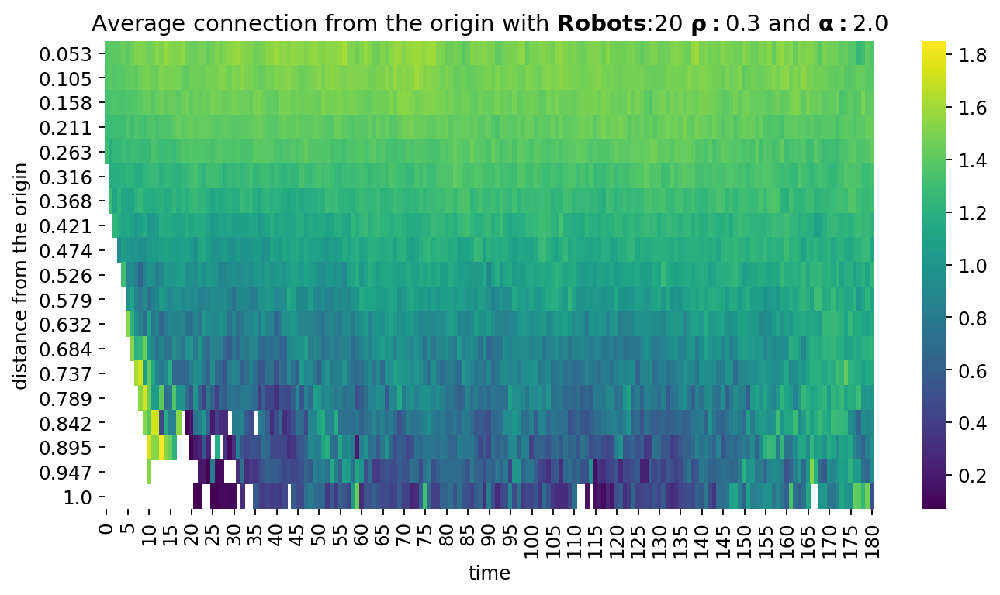

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.6_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.6.png


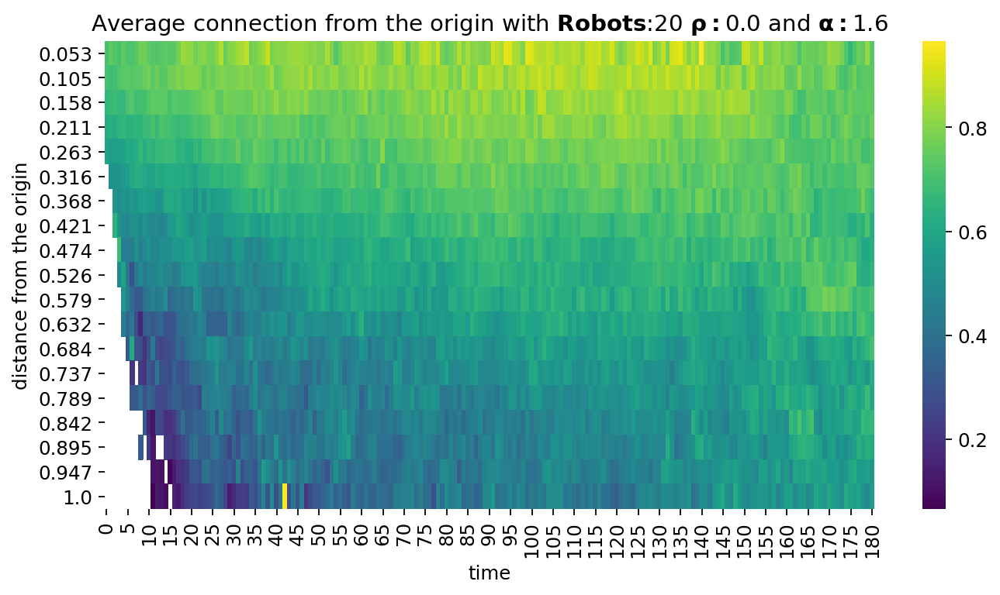

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.6_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.6.png


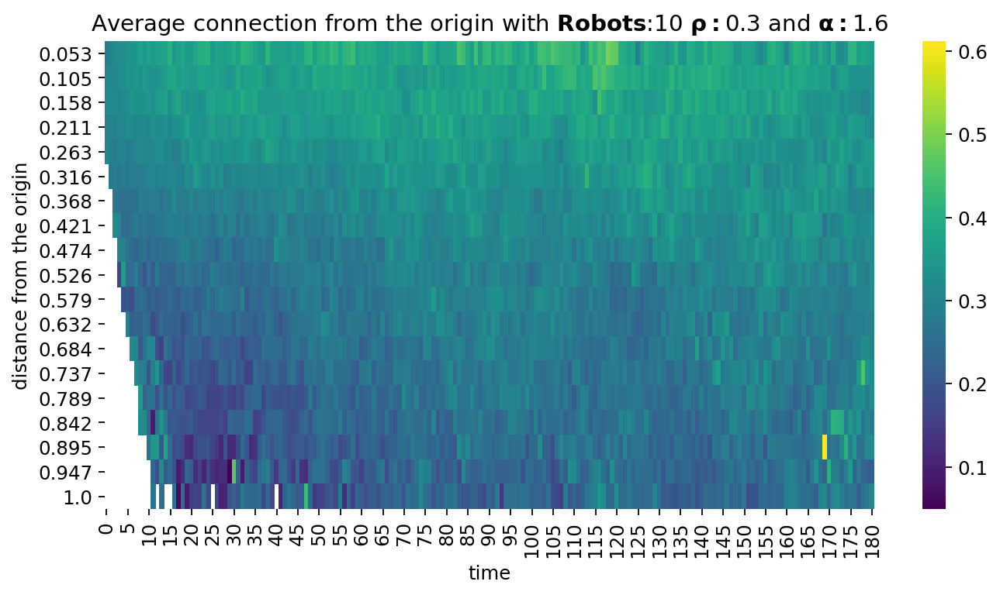

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.2_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.2.png


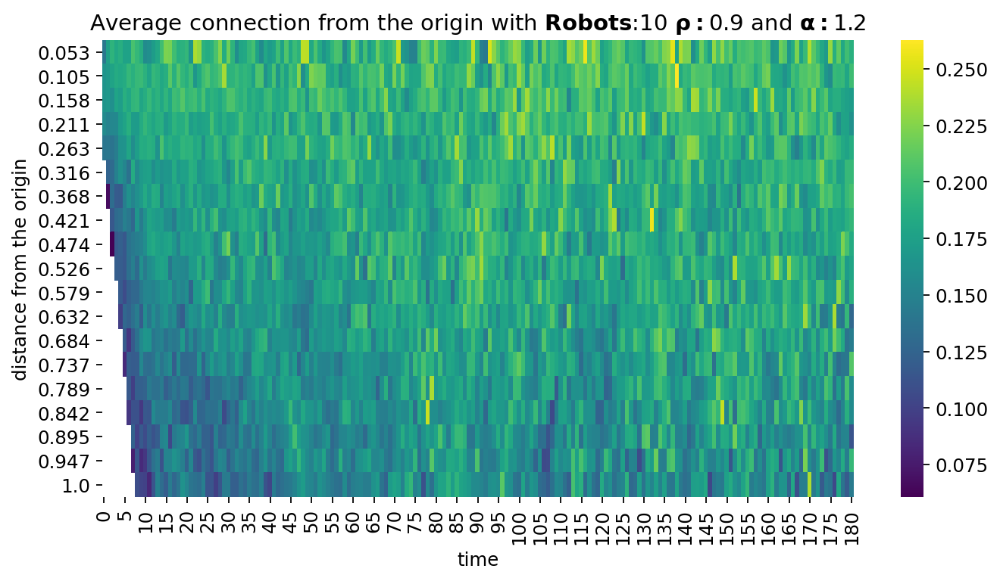

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.6_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.6.png


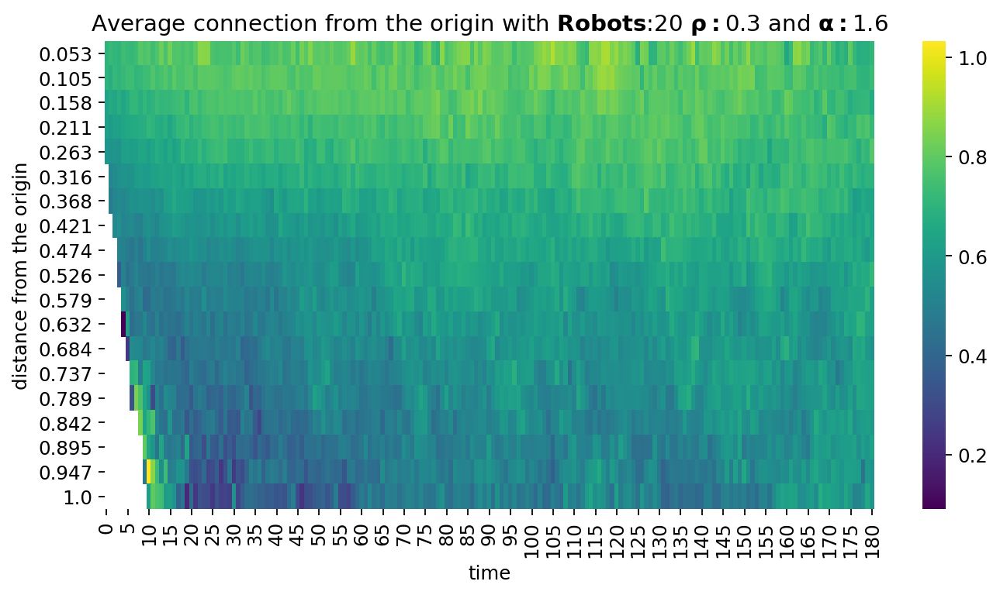

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.6_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.6.png


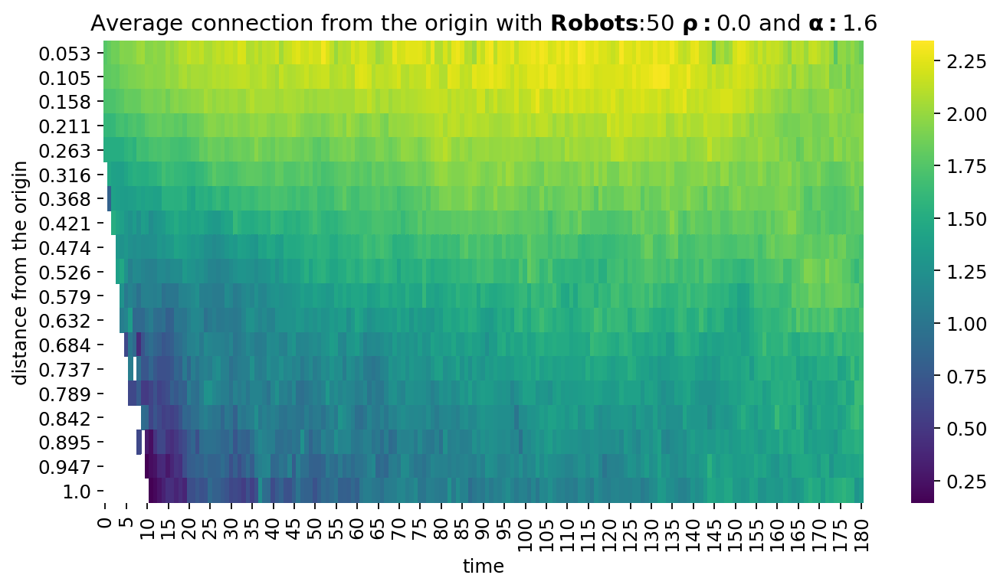

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.6_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.6.png


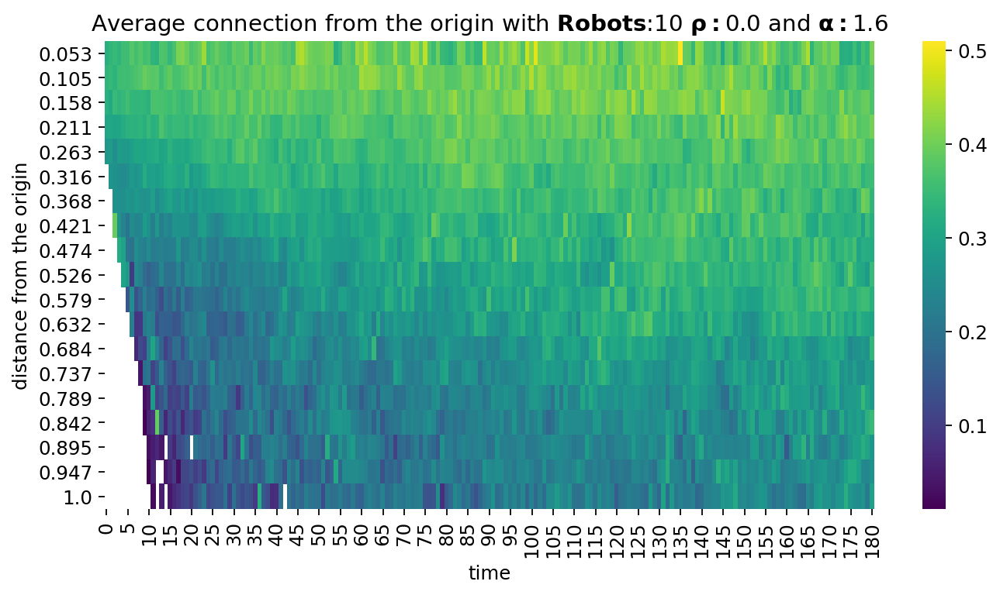

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.6_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.6.png


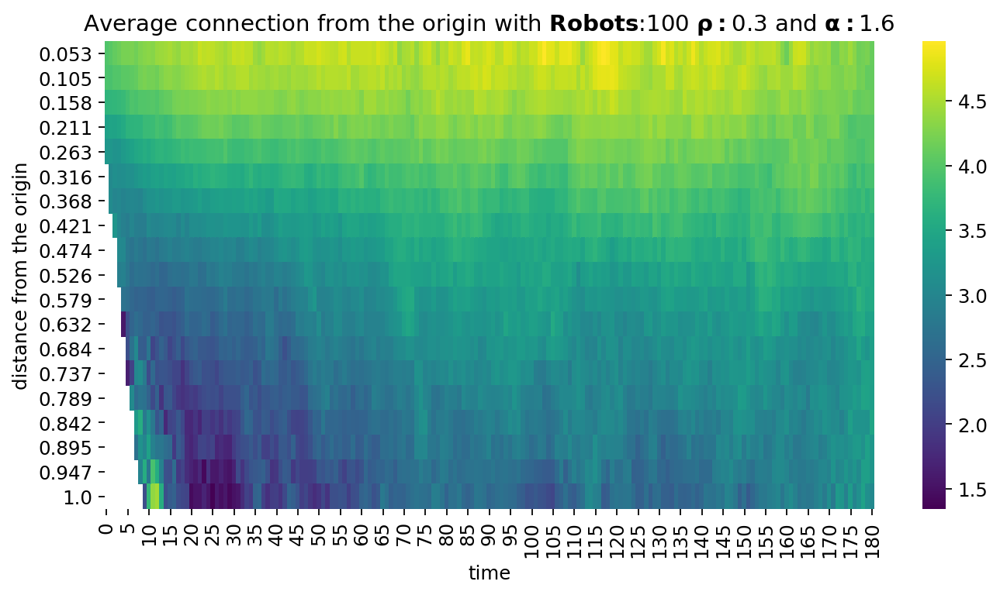

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_1.4.png


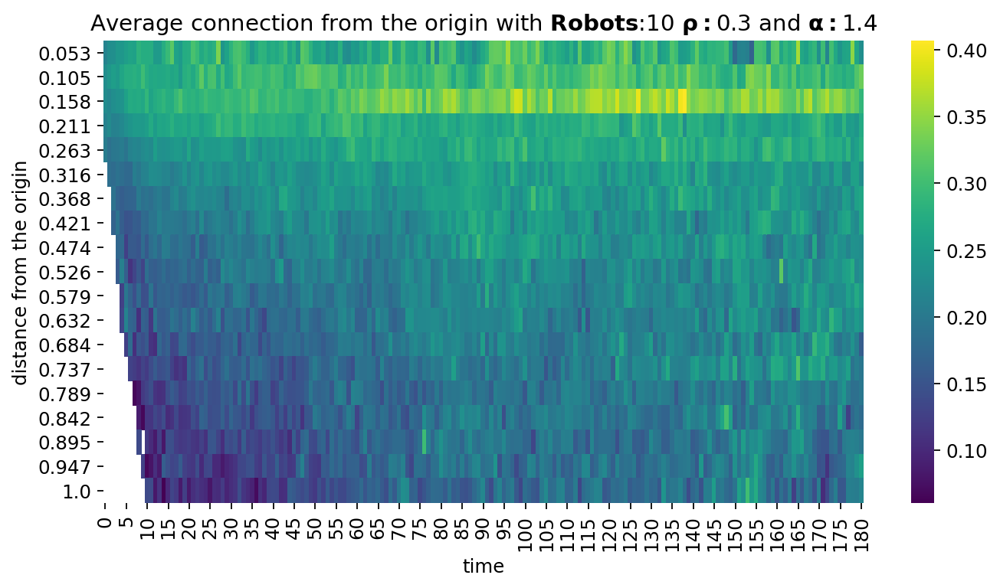

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.2_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.2.png


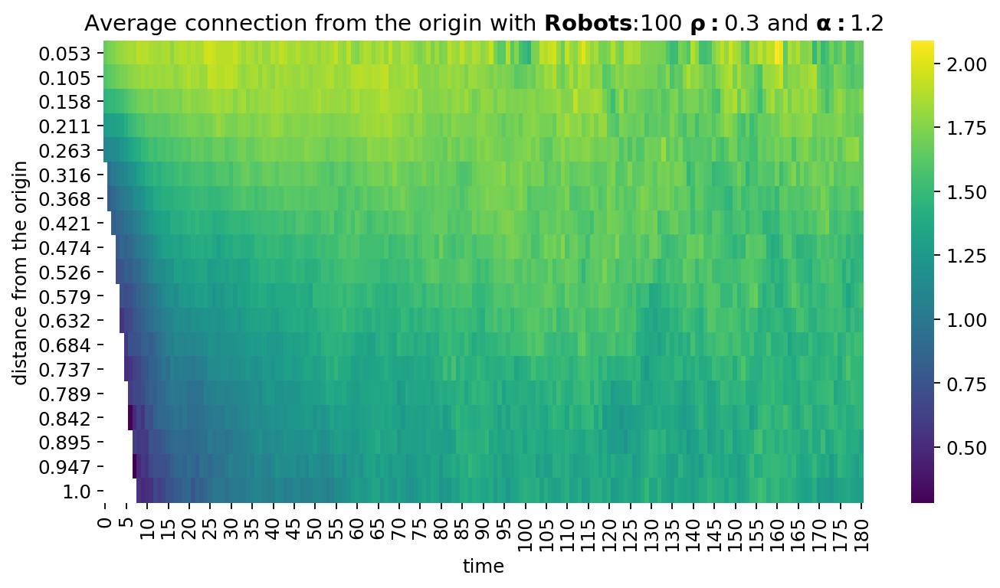

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.8.png


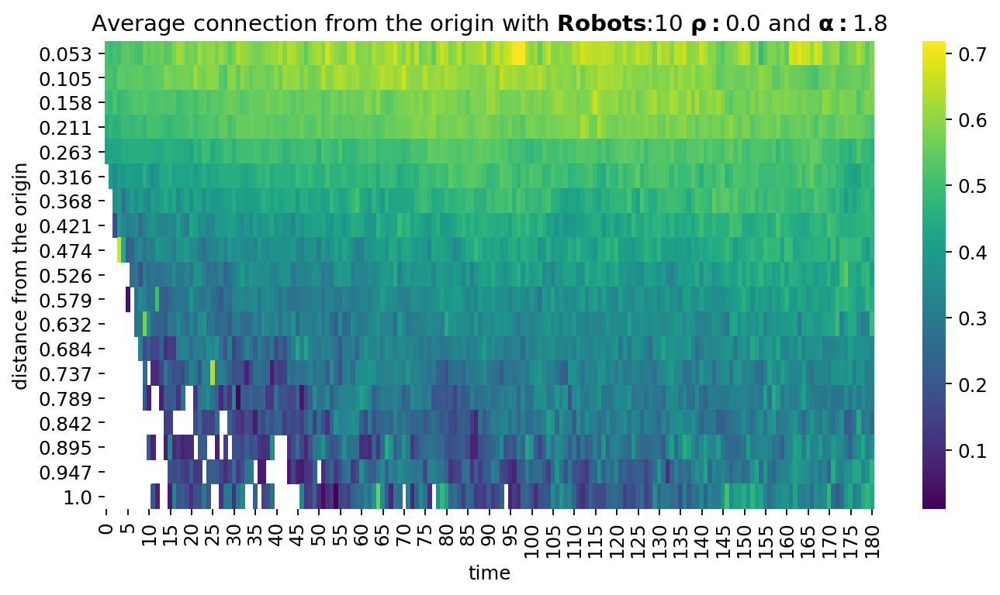

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.6_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.6.png


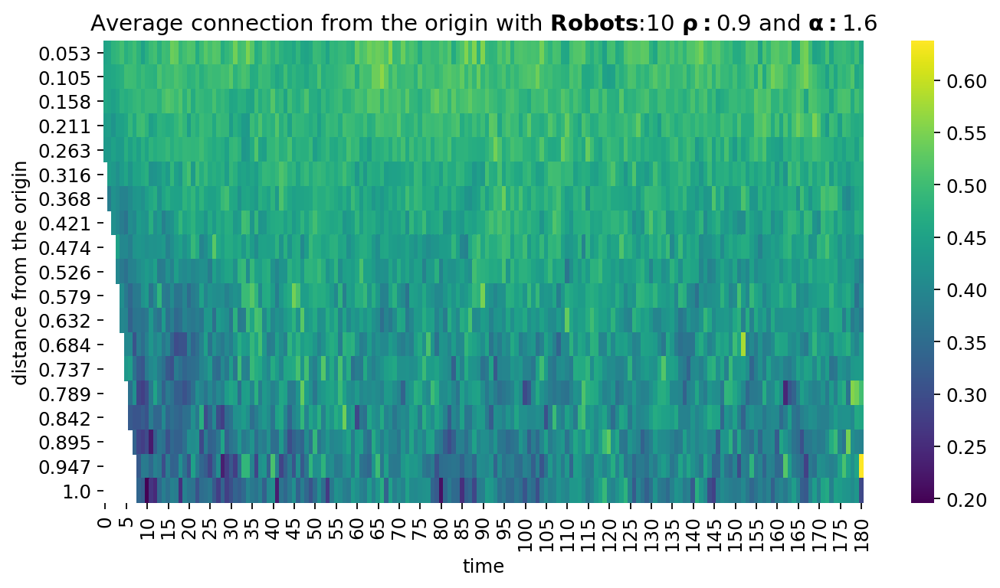

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.2_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.2.png


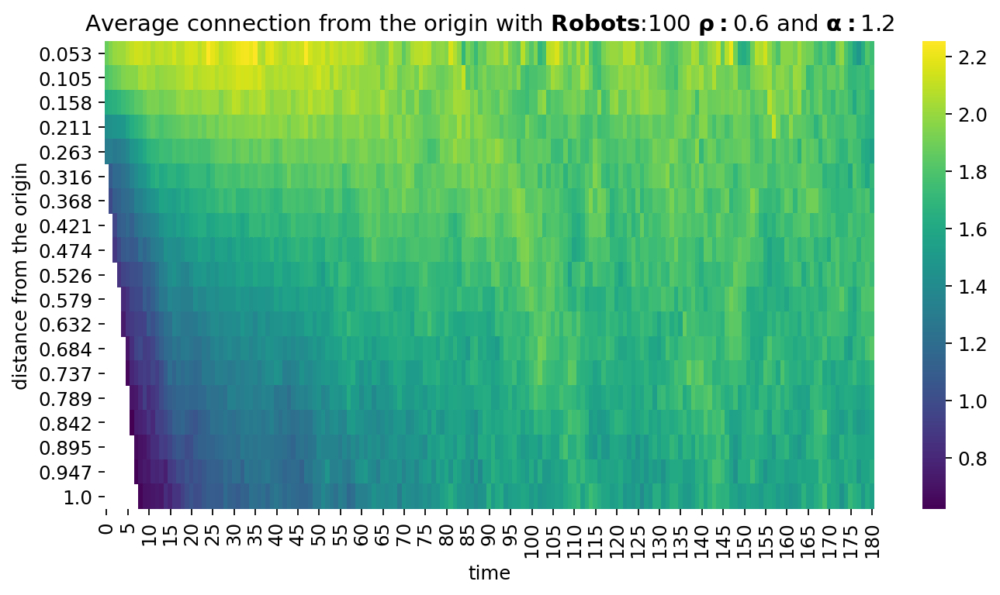

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_1.8.png


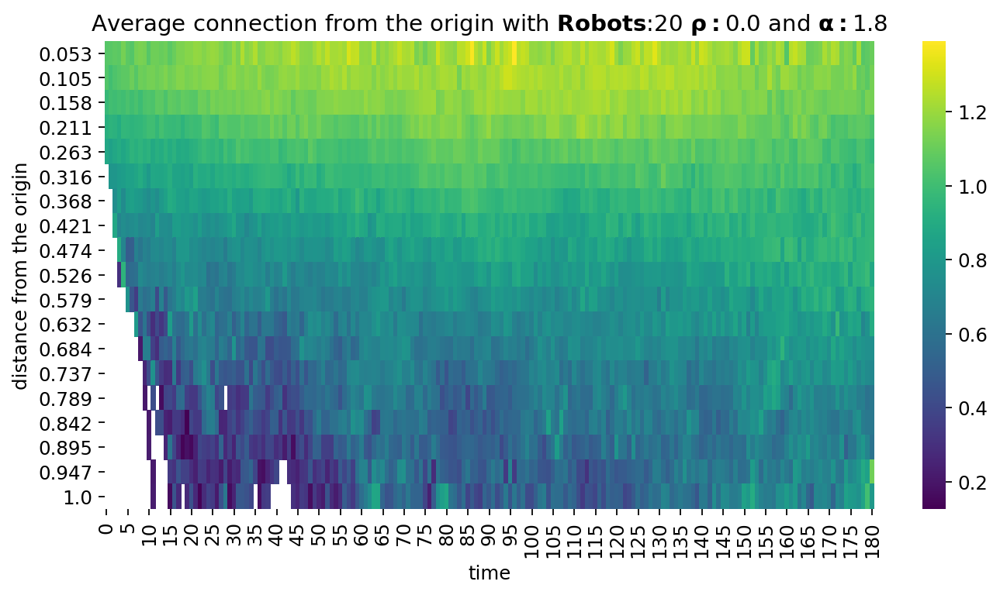

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.8.png


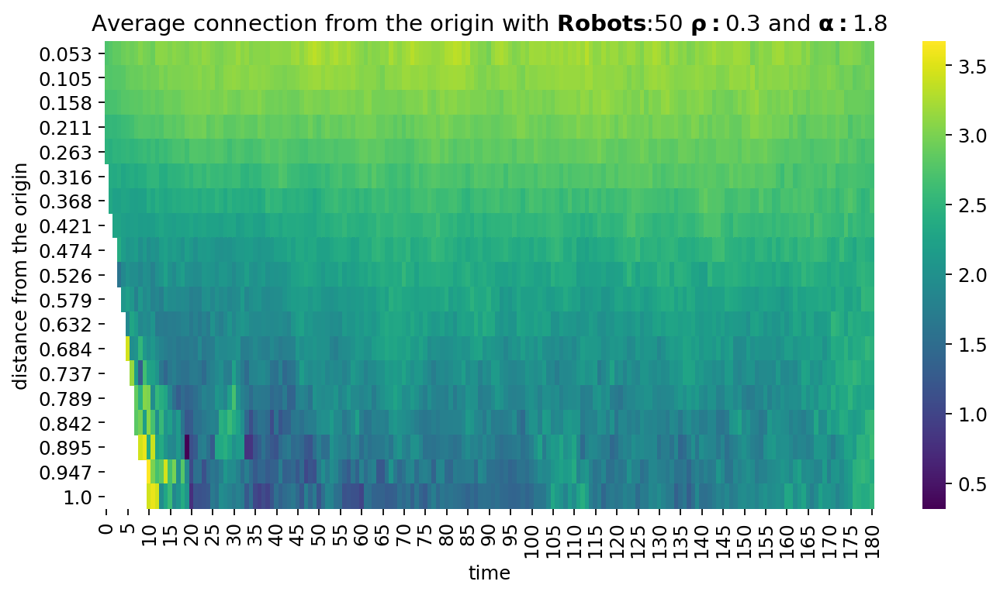

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.8_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.8.png


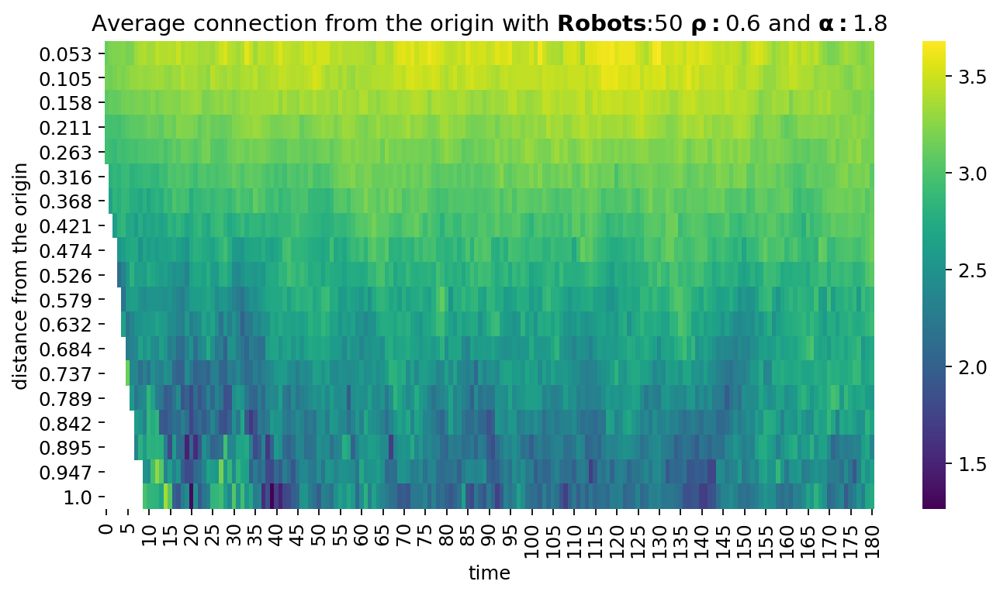

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.4.png


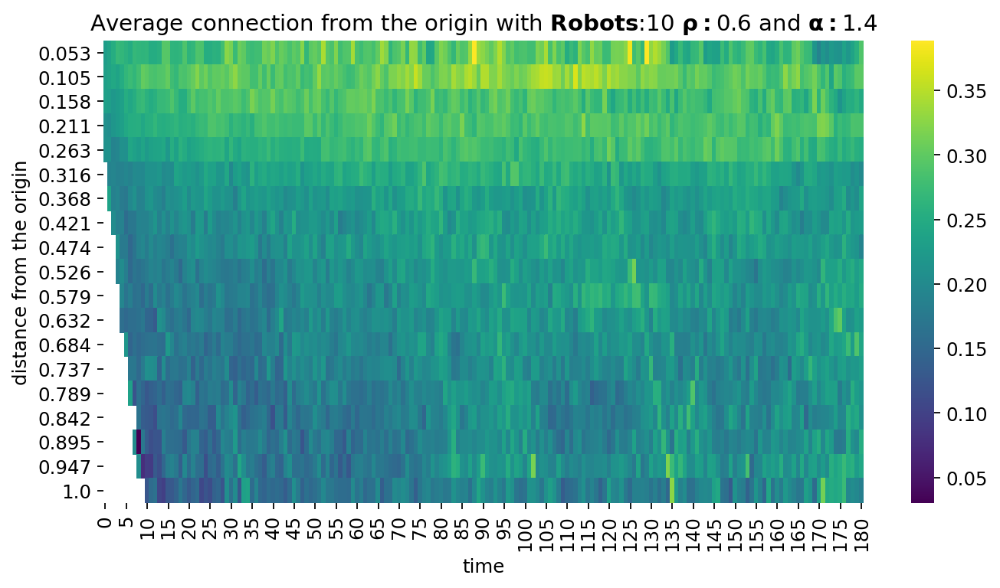

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.3_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.3_alpha_1.8.png


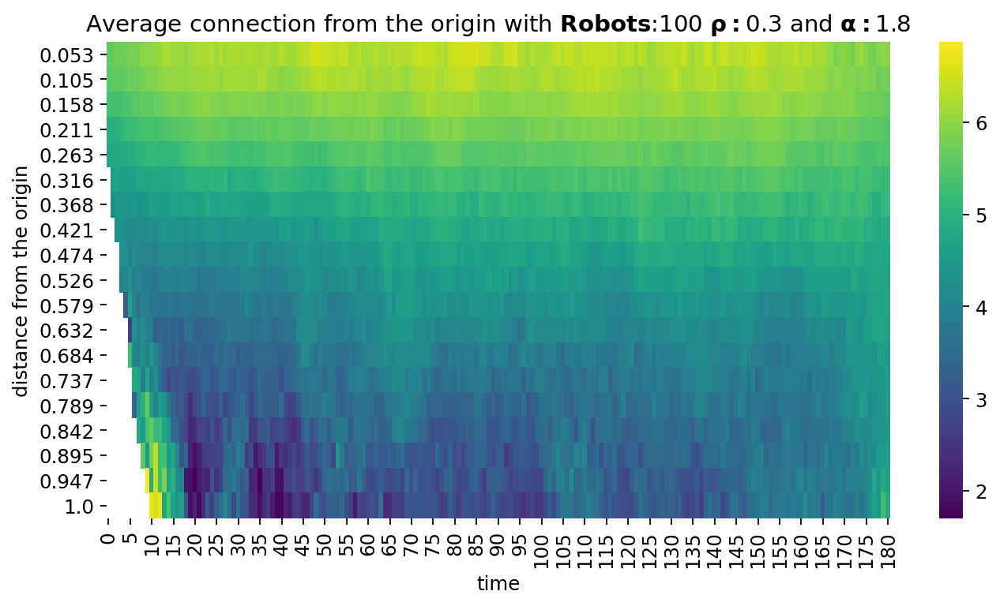

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.4_rho#0.6_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.6_alpha_1.4.png


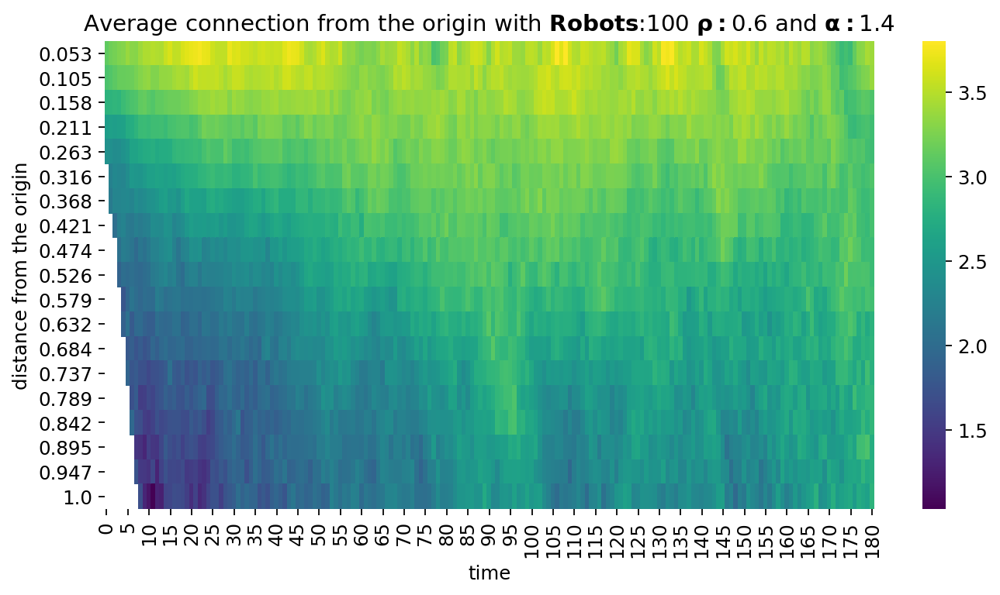

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.6_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.6.png


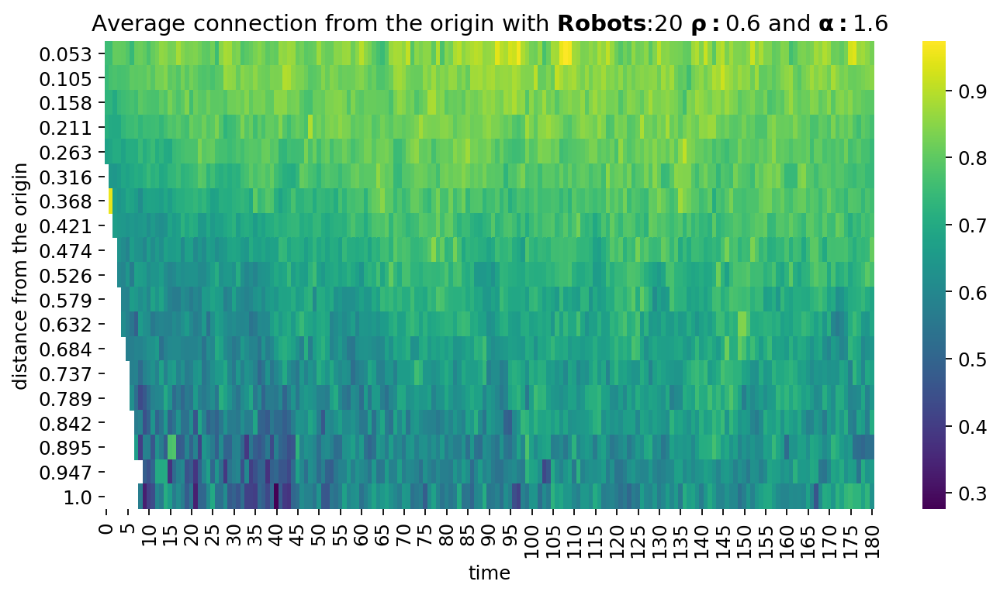

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.4.png


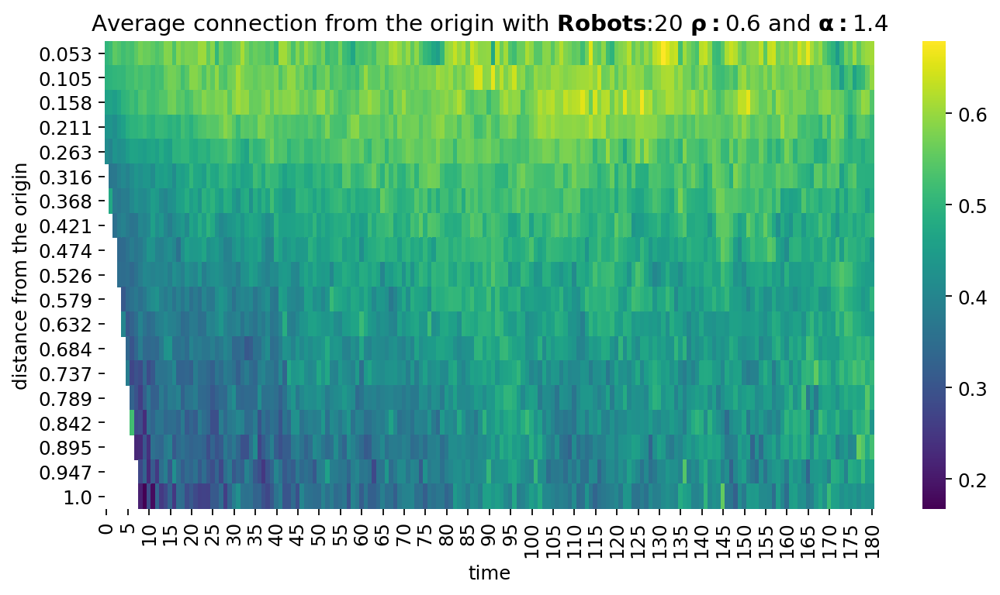

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.2_rho#0.0_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.0_alpha_1.2.png


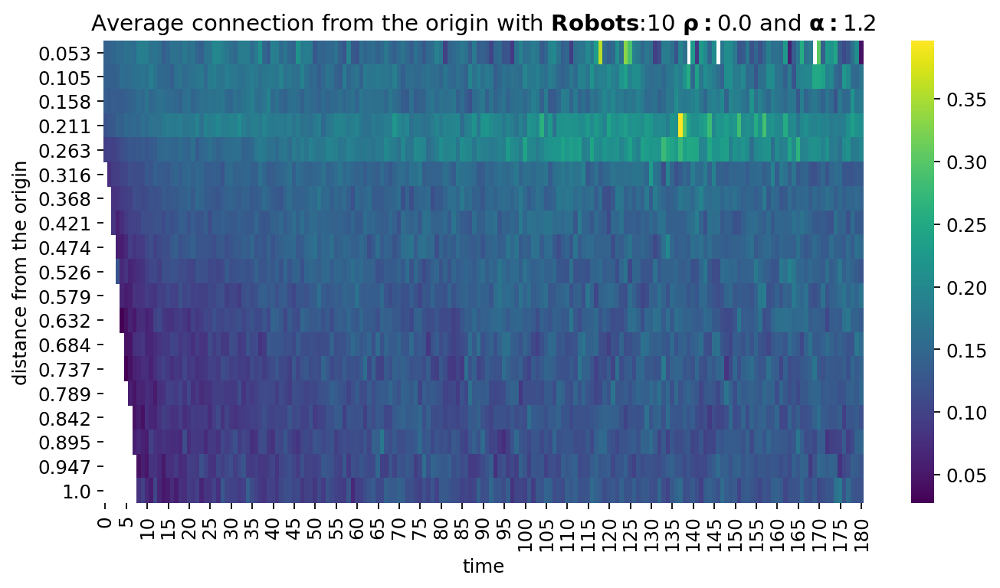

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.8.png


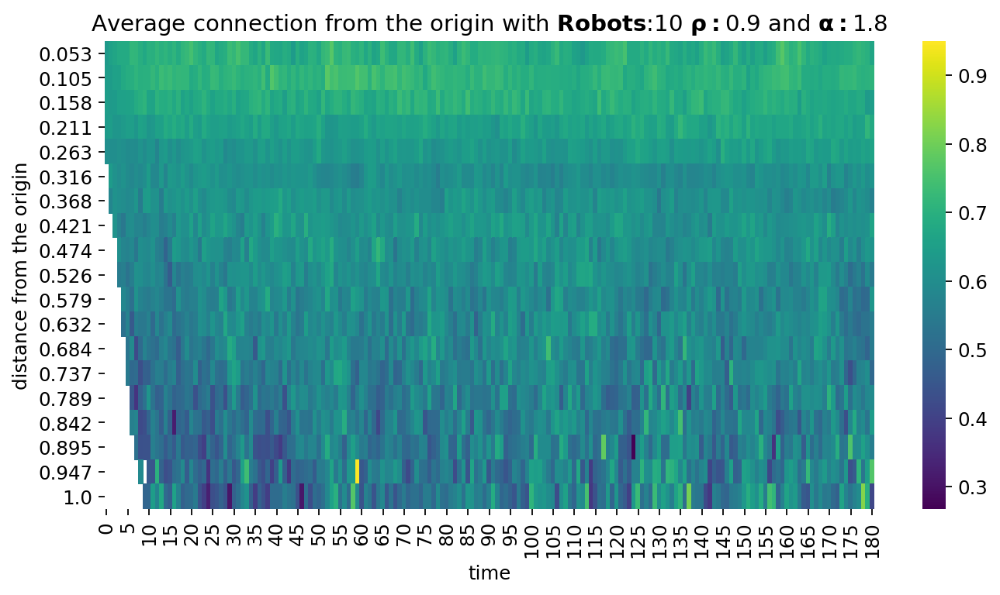

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.2_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.2.png


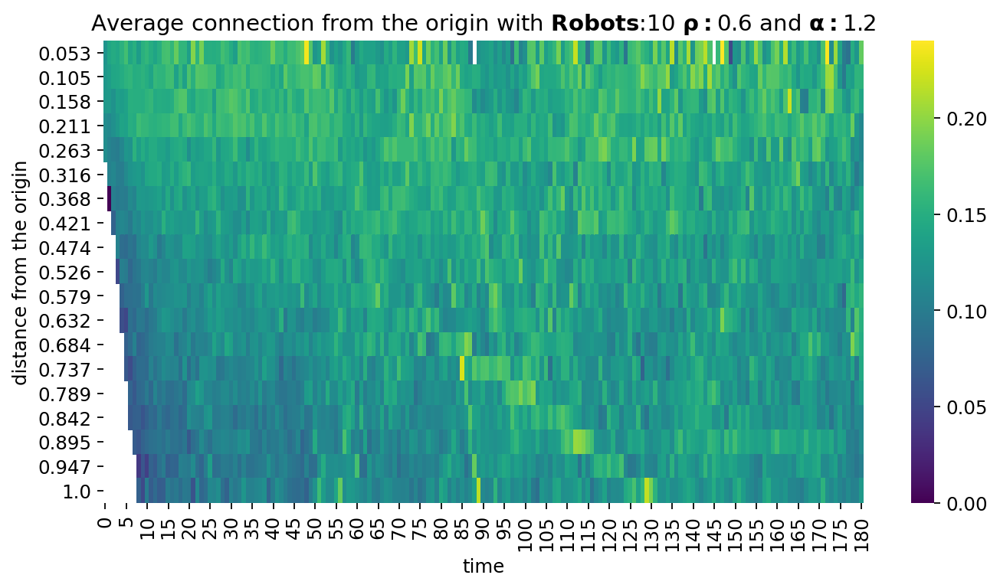

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#2.0_rho#0.0_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.0_alpha_2.0.png


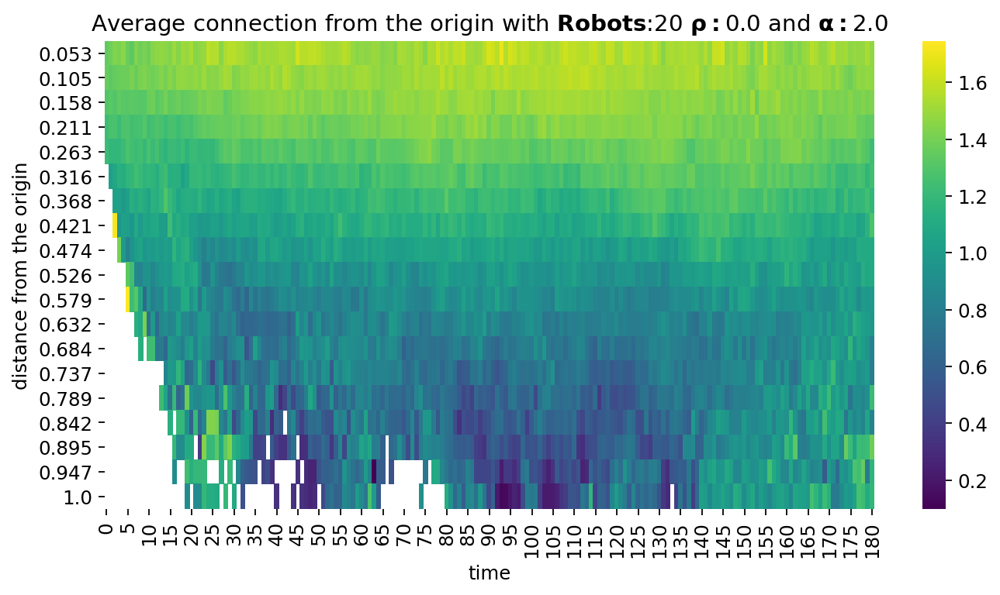

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.2_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.2.png


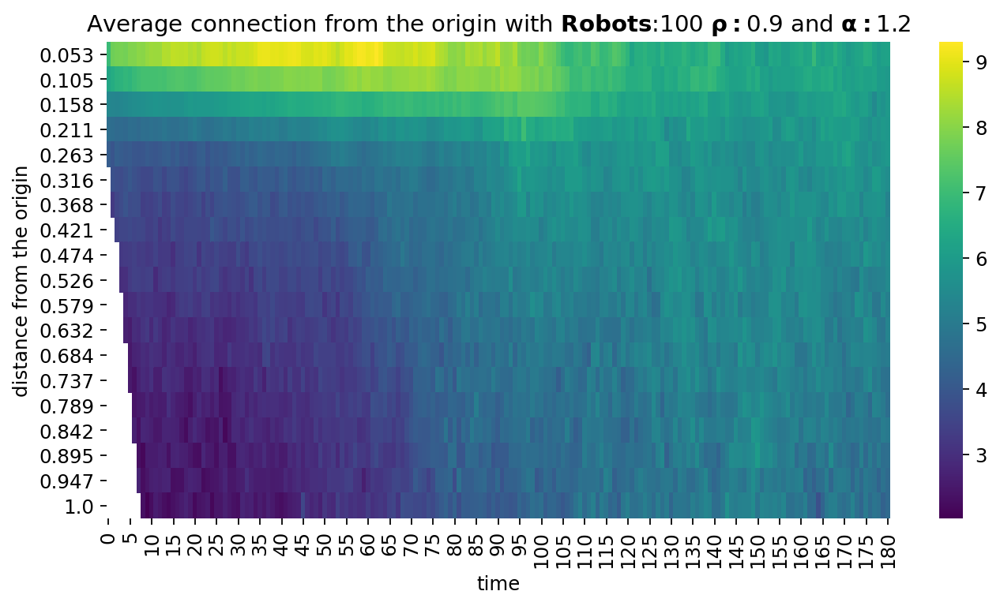

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#100_alpha#1.8_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.8.png


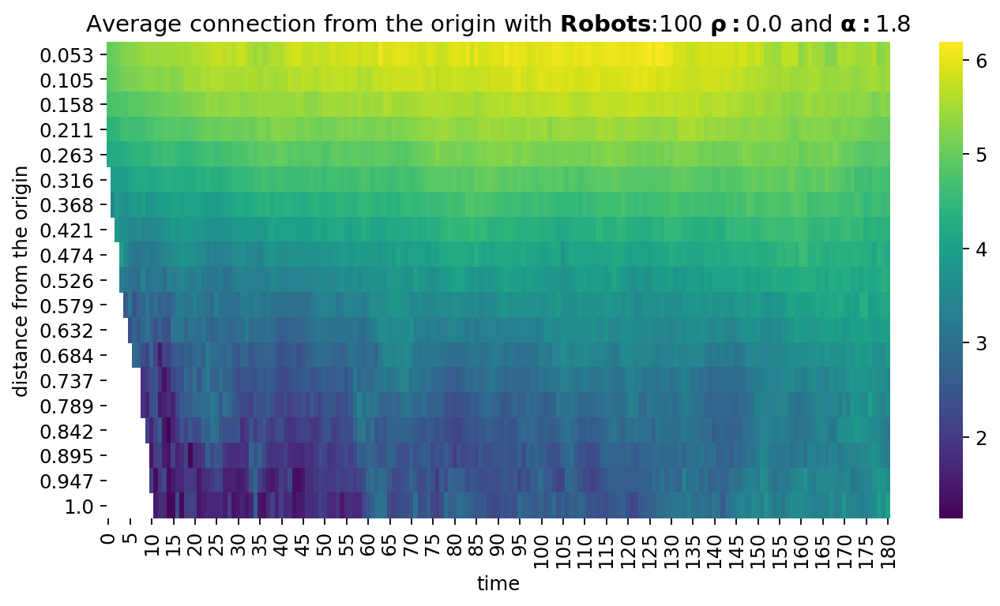

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.4_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.4.png


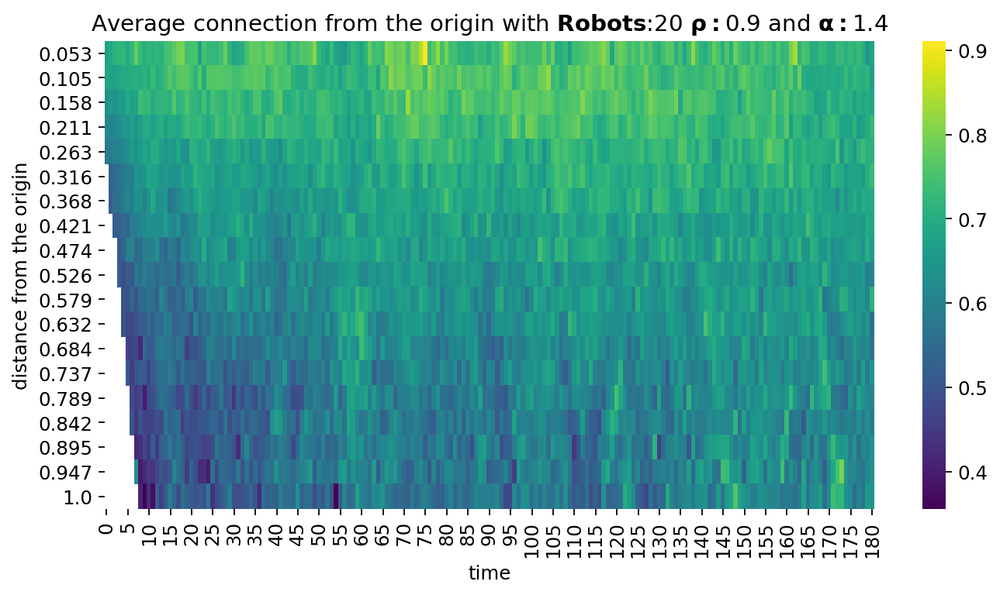

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.6_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.6.png


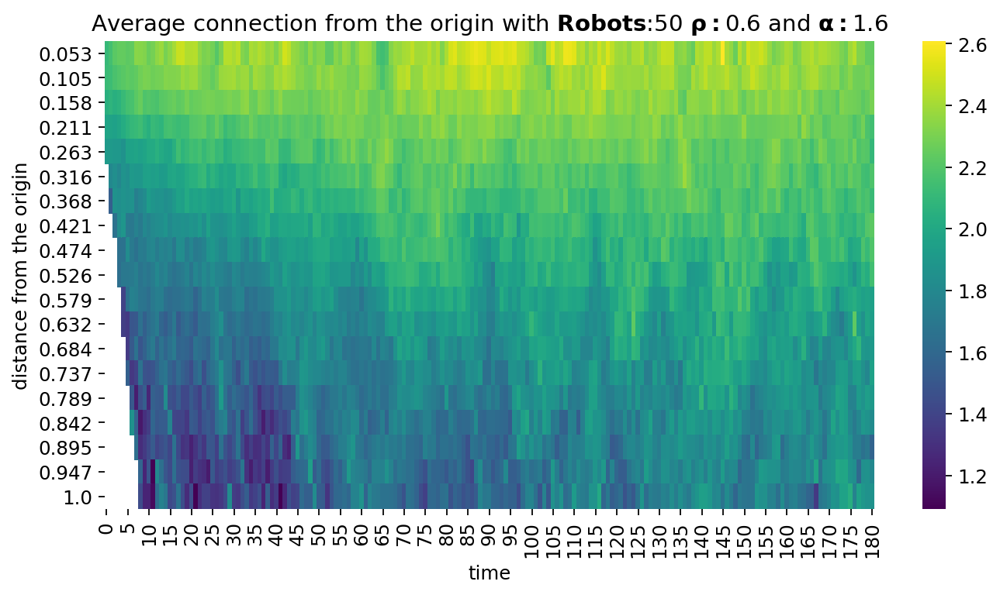

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#2.0_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_2.0.png


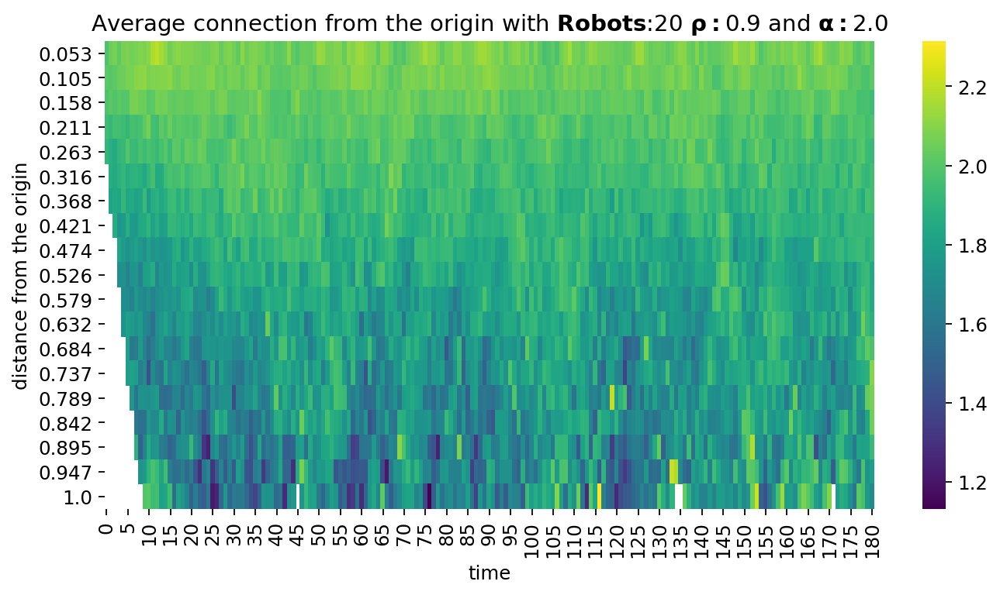

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.2_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.2.png


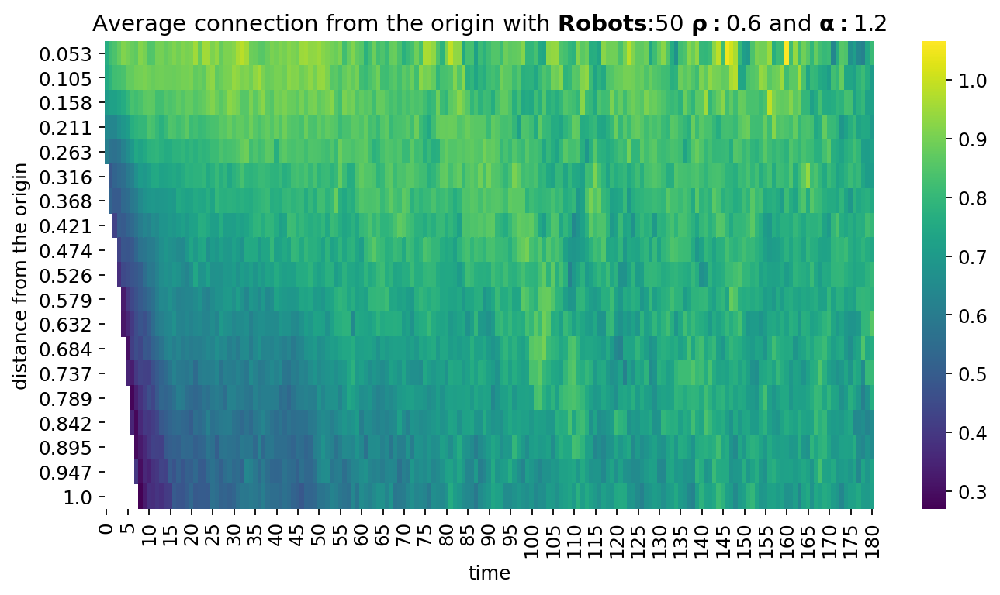

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.0_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.0_alpha_1.4.png


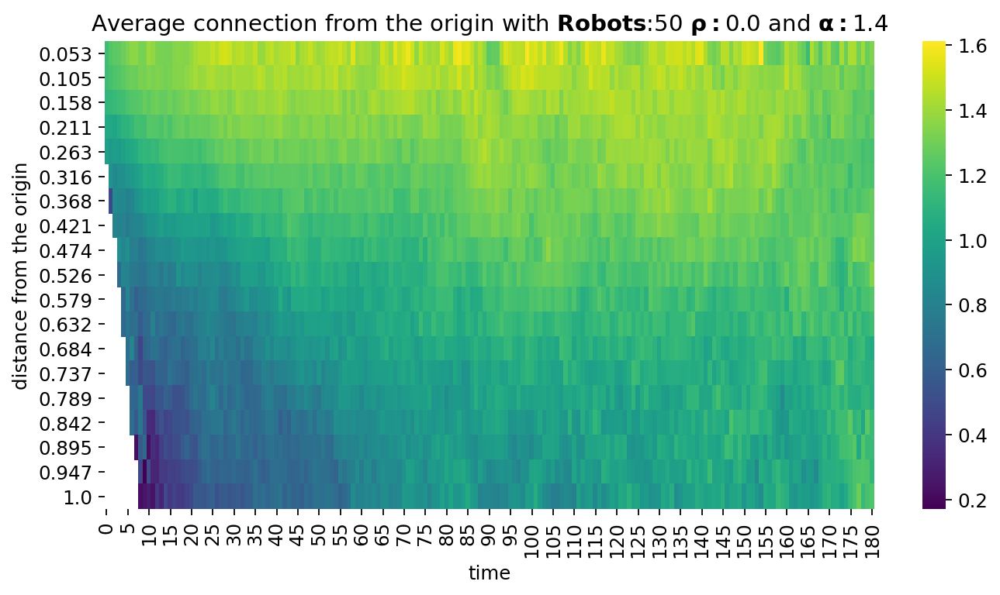

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#1.6_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.6.png


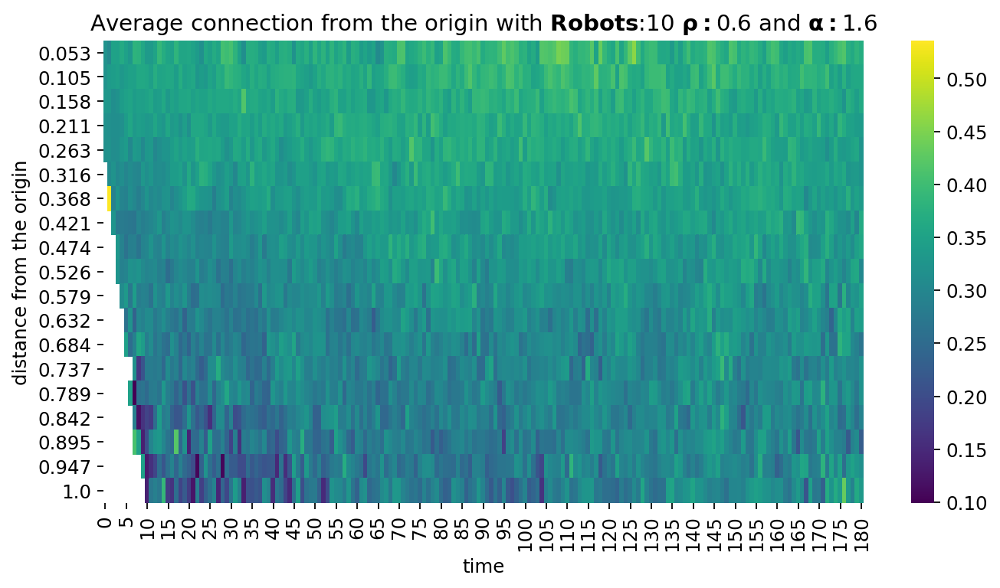

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#2.0_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_2.0.png


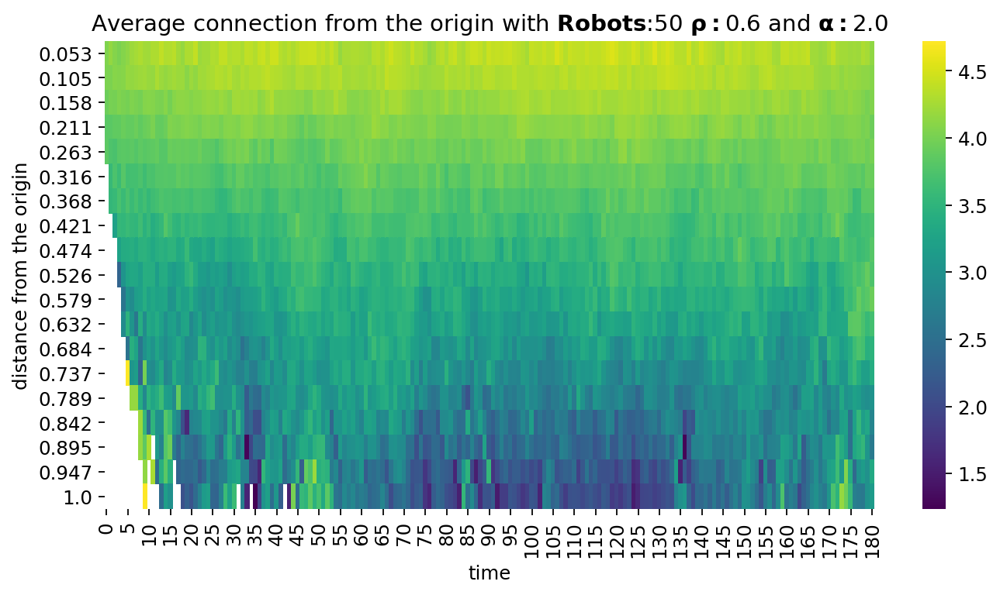

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.2_rho#0.9_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.9_alpha_1.2.png


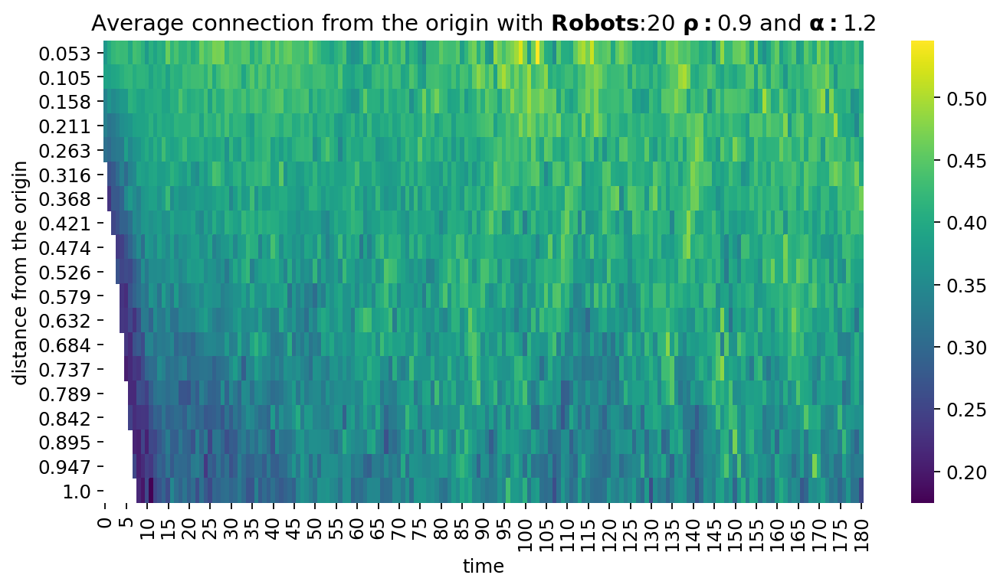

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.6_rho#0.0_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.0_alpha_1.6.png


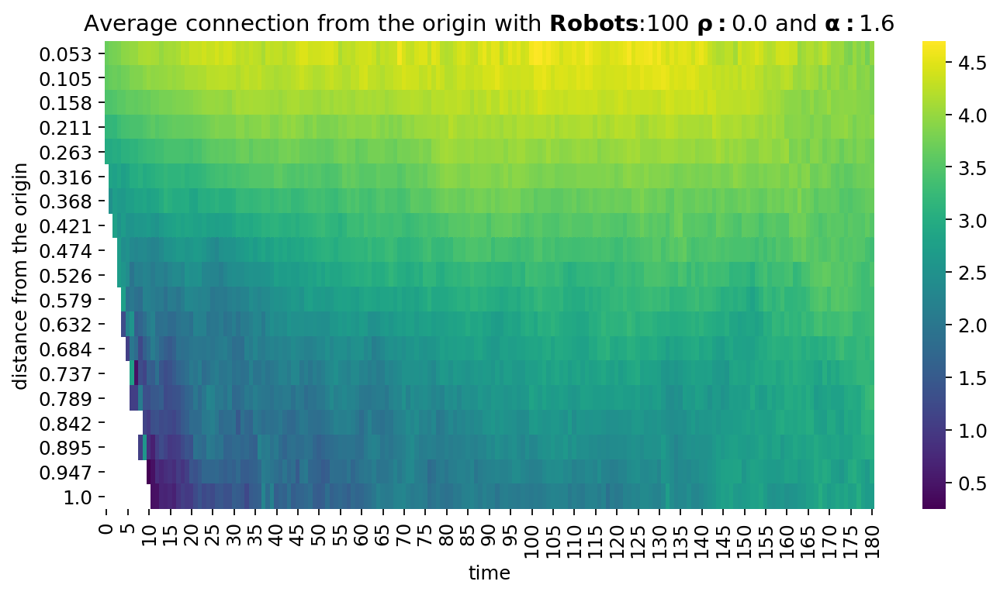

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#2.0_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_2.0.png


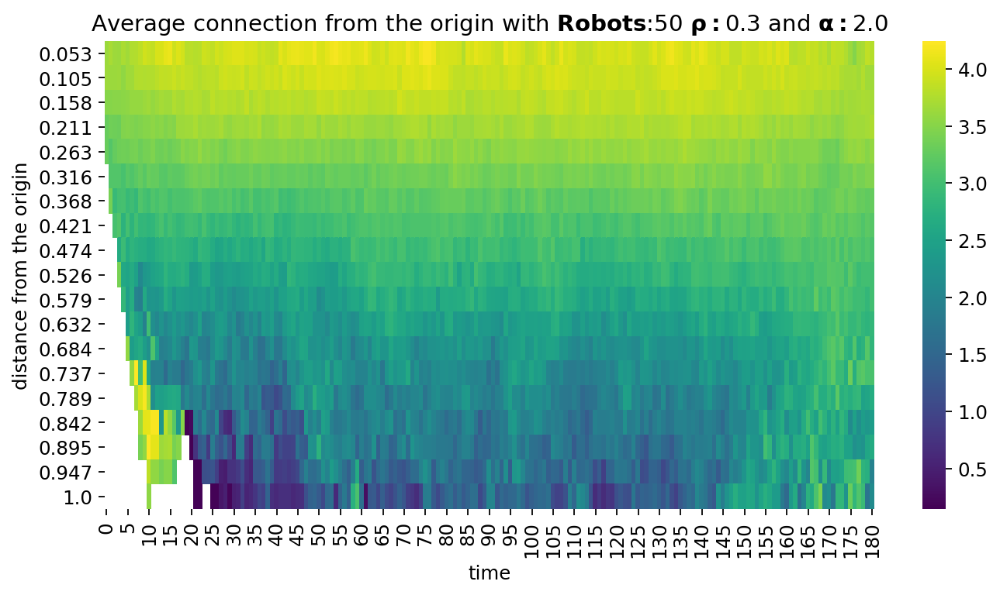

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#2.0_rho#0.3_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.3_alpha_2.0.png


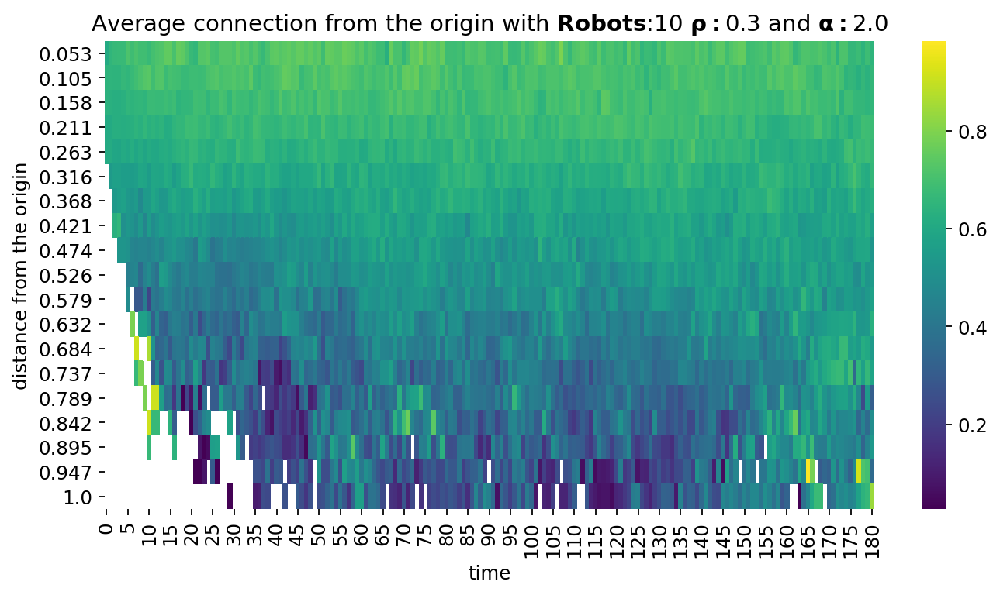

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.6_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.6_alpha_1.4.png


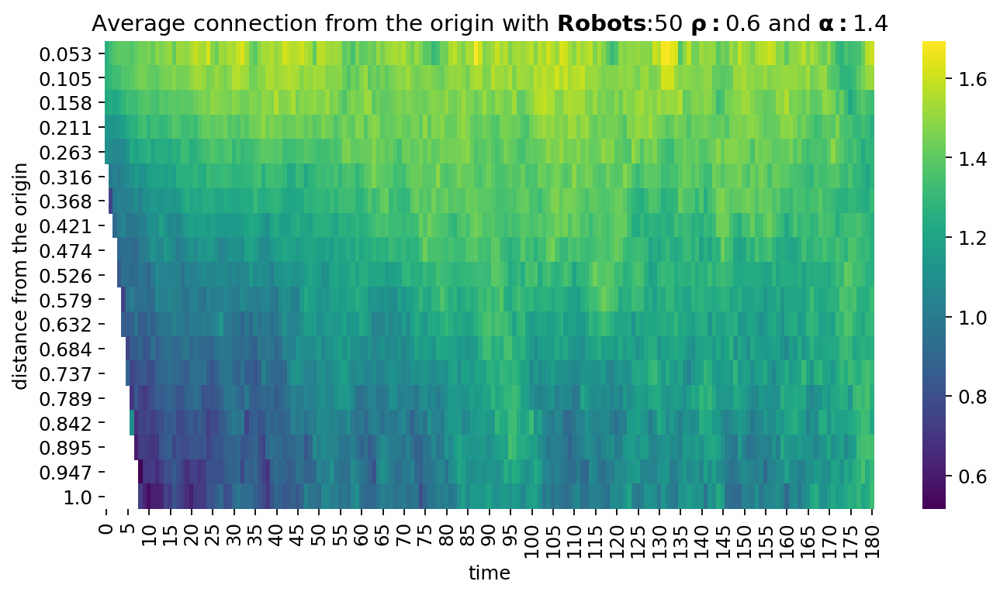

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#10_alpha#2.0_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_2.0.png


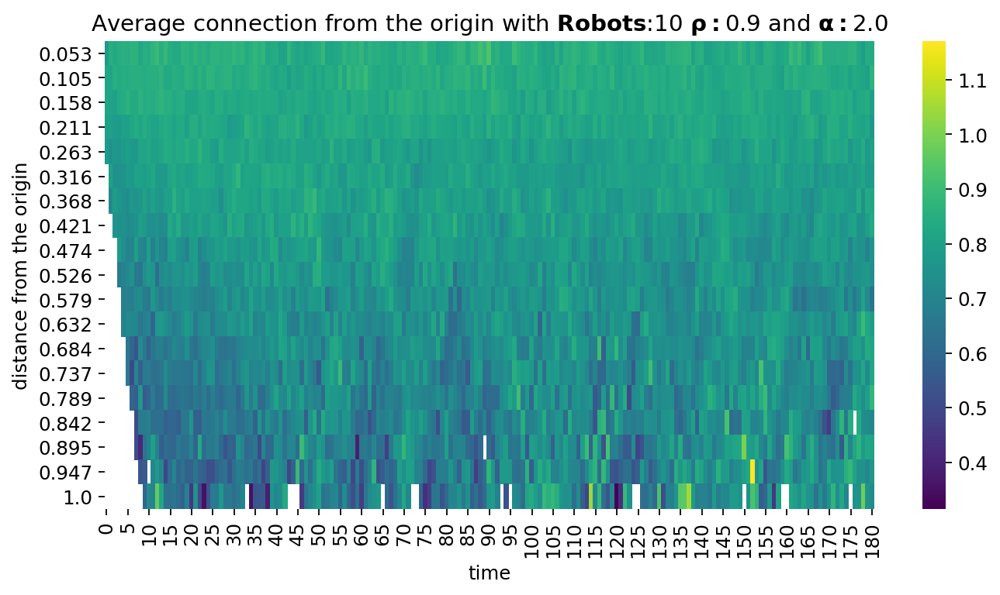

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.4_rho#0.9_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.9_alpha_1.4.png


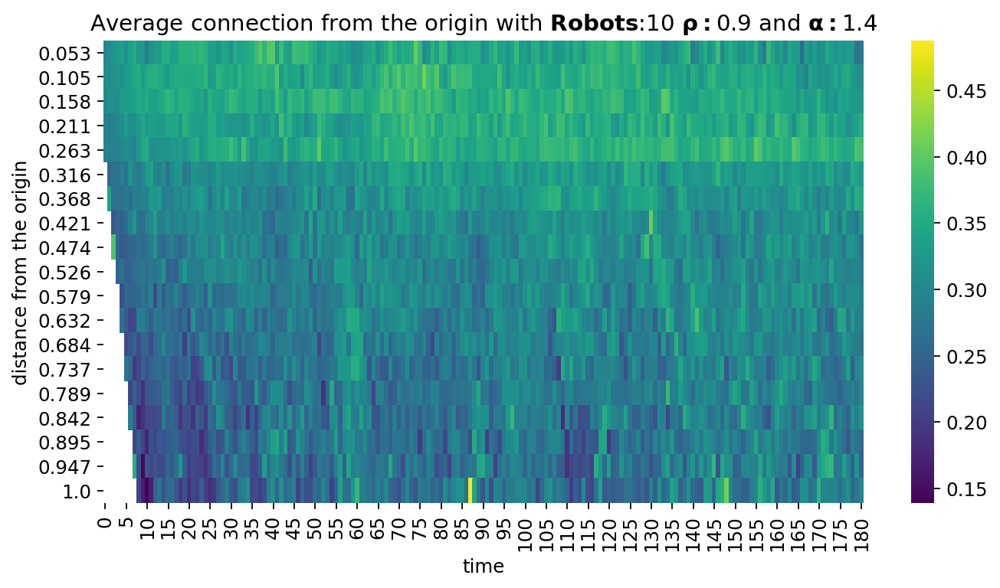

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#2.0_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_2.0.png


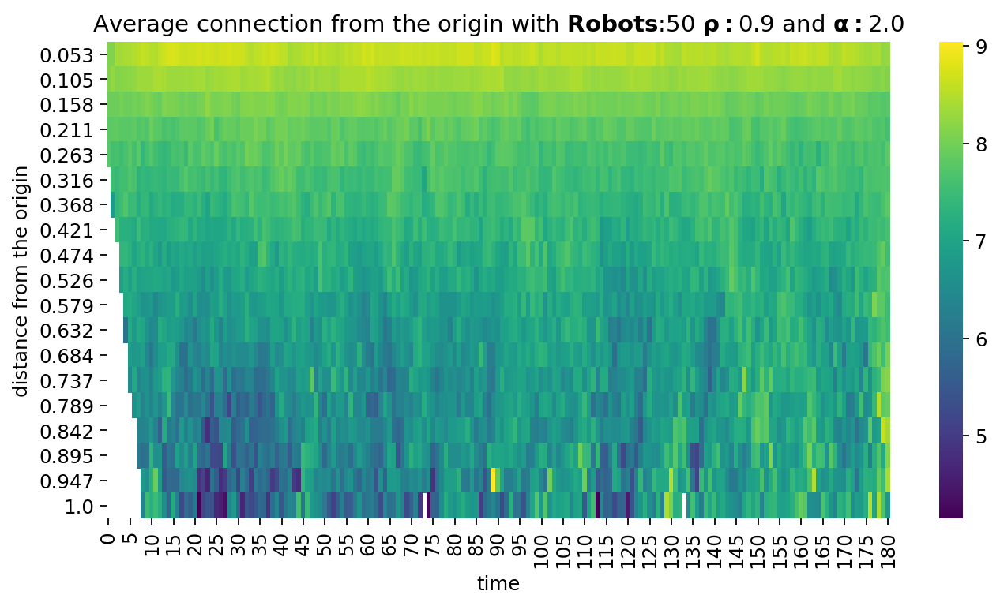

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#50_alpha#1.4_rho#0.3_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.3_alpha_1.4.png


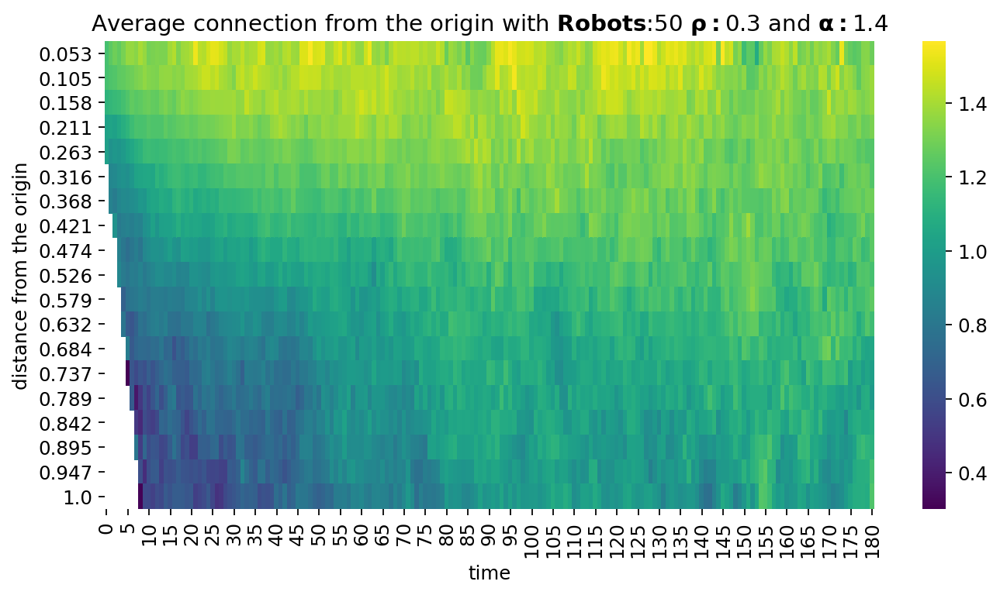

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#100_alpha#1.6_rho#0.9_1800
(10000, 181)
	 df_values.shape: (10000, 181, 2)
distances shape (181, 10000)
origin_distance.shape (10000, 181)
origin_distance.T.shape (181, 10000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_100_rho_0.9_alpha_1.6.png


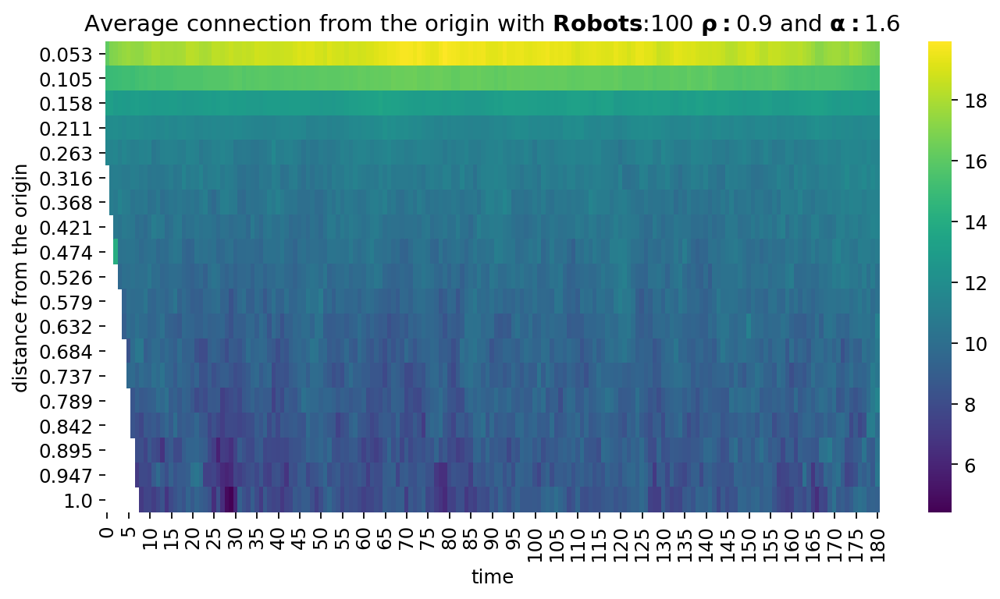

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#50_alpha#1.6_rho#0.9_1800
(5000, 181)
	 df_values.shape: (5000, 181, 2)
distances shape (181, 5000)
origin_distance.shape (5000, 181)
origin_distance.T.shape (181, 5000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_50_rho_0.9_alpha_1.6.png


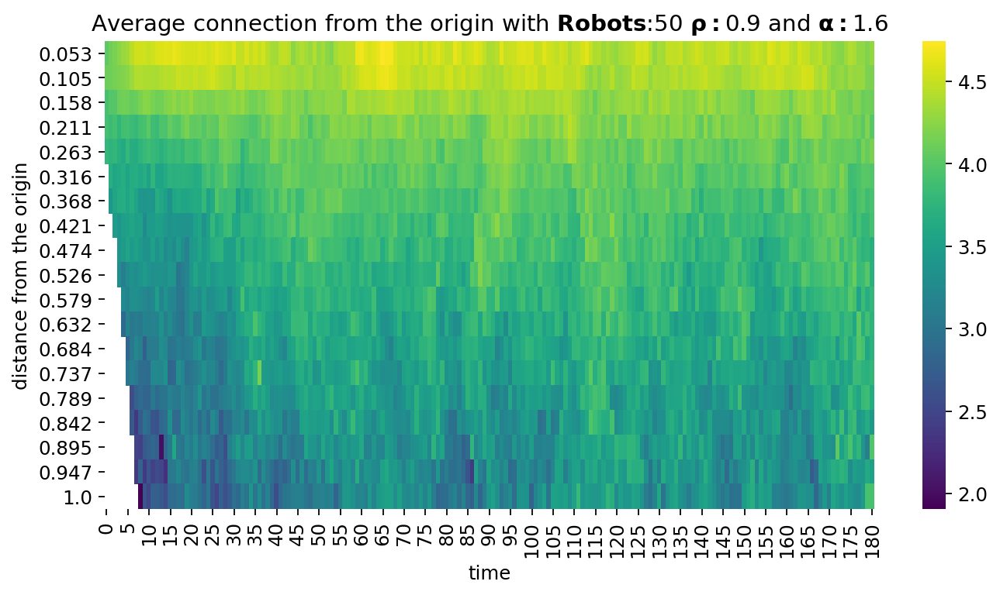

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#20_alpha#1.8_rho#0.3_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.3_alpha_1.8.png


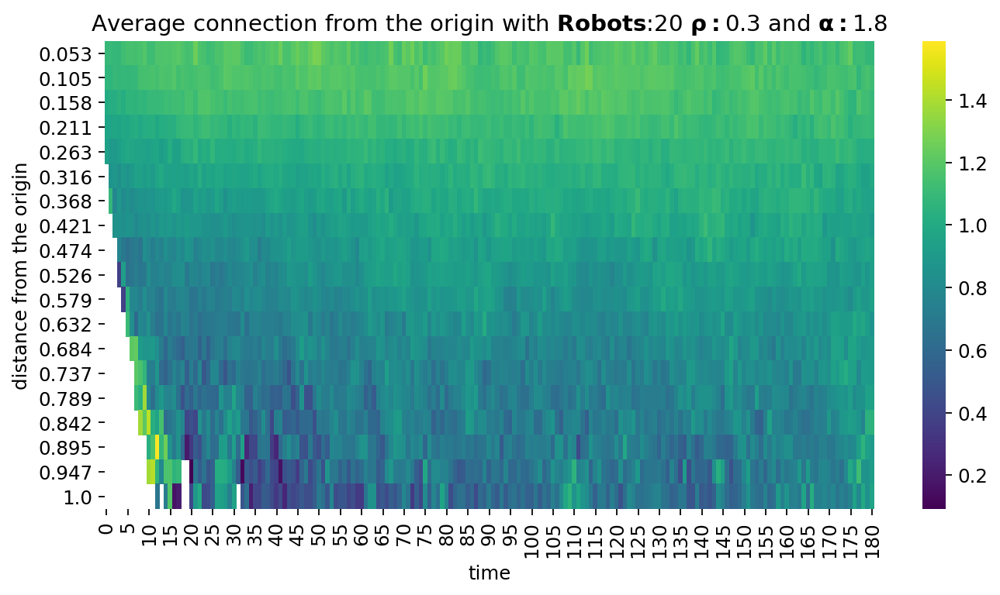

./results/ALL/Simulated/bias_experiment_100_runs/2020-07-09_robots#20_alpha#1.2_rho#0.6_1800
(2000, 181)
	 df_values.shape: (2000, 181, 2)
distances shape (181, 2000)
origin_distance.shape (2000, 181)
origin_distance.T.shape (181, 2000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_20_rho_0.6_alpha_1.2.png


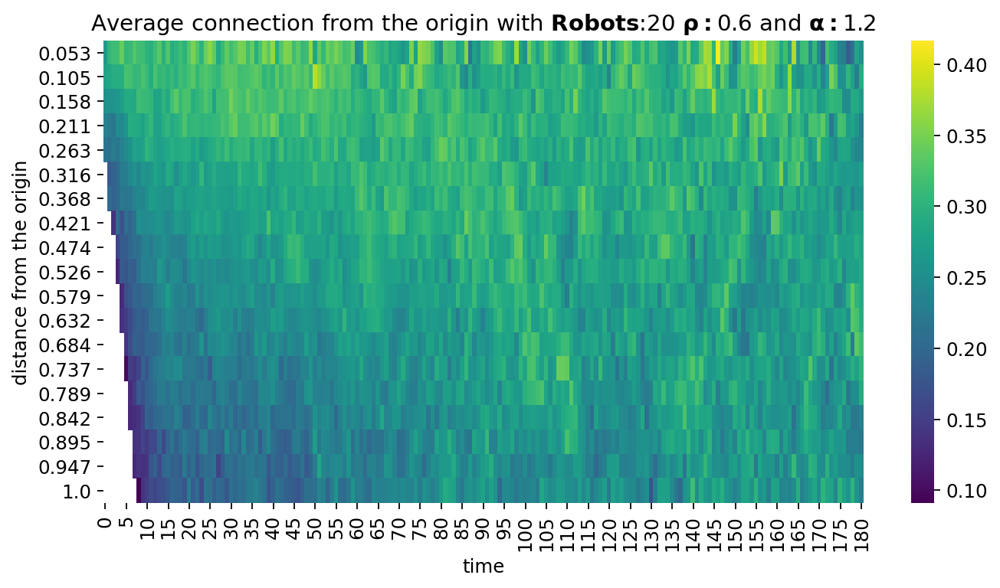

./results/ALL/Simulated/bias_experiment_100_runs/2021-09-22_robots#10_alpha#1.8_rho#0.6_1800
(1000, 181)
	 df_values.shape: (1000, 181, 2)
distances shape (181, 1000)
origin_distance.shape (1000, 181)
origin_distance.T.shape (181, 1000)


/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/luigi/venv/argos/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Saving fig: .//average_connection_heatmap_robots_10_rho_0.6_alpha_1.8.png


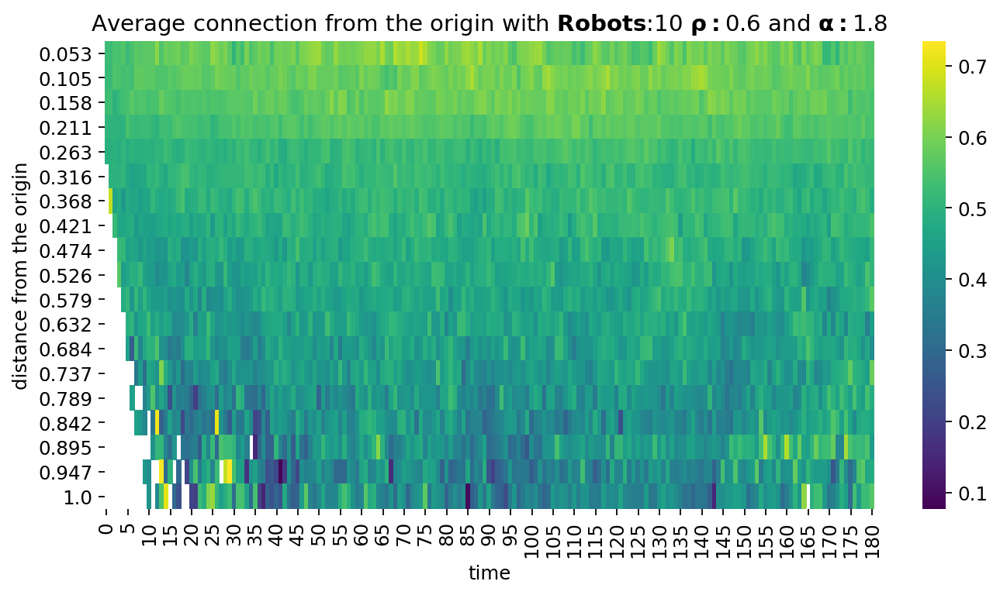

In [38]:
bin_edges = np.linspace(0, 1, 20)  # 20 bins from 0 to 1 meter
openSpace_folder = './results/ALL/Simulated/bias_experiment_100_runs'
avg_connection_degree_heatmap(openSpace_folder)